# Carga de librerías

In [228]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.patches as mpatches
import seaborn as sns
import tensorflow as tf
import xgboost as xgb
import scipy.stats as stats
from statsmodels.tsa.seasonal import seasonal_decompose
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.arima.model import ARIMA
from statsmodels.tsa.statespace.sarimax import SARIMAX
from statsmodels.tsa.stattools import adfuller
from pmdarima import auto_arima
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from statsmodels.tsa.ar_model import AutoReg
from sklearn.metrics import mean_absolute_error, mean_squared_error, mean_absolute_percentage_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, ParameterGrid
from sklearn.ensemble import RandomForestRegressor, StackingRegressor
from keras.models import Sequential
from keras.layers import LSTM, Dense
from keras.optimizers import Adam
from prophet import Prophet
from prophet.diagnostics import cross_validation, performance_metrics
import dash
from dash import dcc, html
from dash.dependencies import Input, Output
import plotly.graph_objects as go
import ipywidgets as widgets
from IPython.display import display, HTML
from tpot import TPOTRegressor
import random
import warnings

%matplotlib inline

In [229]:
###!c:\Users\CDIBONO\AppData\Local\Microsoft\WindowsApps\python3.11.exe -m pip install xgboost -v --trusted-host pypi.org --trusted-host pypi.python.org --trusted-host files.pythonhosted.org

In [230]:
# Leer el archivo Excel y establecer el índice
def load_data():
    return pd.read_excel('C:/Users/cdibono/OneDrive - Ternium/Austral/Materias/Tesis/Datos Tesis Mensualizados.xlsx', header=1)

# Cargar el DataFrame
df = load_data()

# Lectura del dataset

In [231]:
# Cargar los datos en un dataframe
df = df = load_data()
df.set_index('Month', inplace=True)
#df.index = df.index.strftime('%Y-%m')

# Establecer la opción para limitar la visualización del encabezado a 10 caracteres
pd.set_option('display.max_colwidth', 10)

# Mostrar el dataframe con los encabezados limitados a 10 caracteres
print(df.head())

# Restaurar la configuración predeterminada si es necesario
pd.reset_option('display.max_colwidth')

             Año  Mes  Trimestre Año-Trimestre  Total MyC    Total M  \
Month                                                                  
2007-01-01  2007    1          1     2007-1     16.260598   7.056329   
2007-02-01  2007    2          1     2007-1     16.046203   6.267746   
2007-03-01  2007    3          1     2007-1     24.364716  10.858748   
2007-04-01  2007    4          2     2007-2     19.604563   6.719202   
2007-05-01  2007    5          2     2007-2     21.835851   6.994303   

              Total C  CPI (Commodity Price Index)  Iron Ore  \
Month                                                          
2007-01-01   9.204269     110.95                       78.20   
2007-02-01   9.778456     116.78                       82.66   
2007-03-01  13.505968     119.50                       88.55   
2007-04-01  12.885361     126.34                       91.26   
2007-05-01  14.841548     126.75                      102.02   

            Metals Price Index  Aluminum  Crud

# Estadística descriptiva de los datos

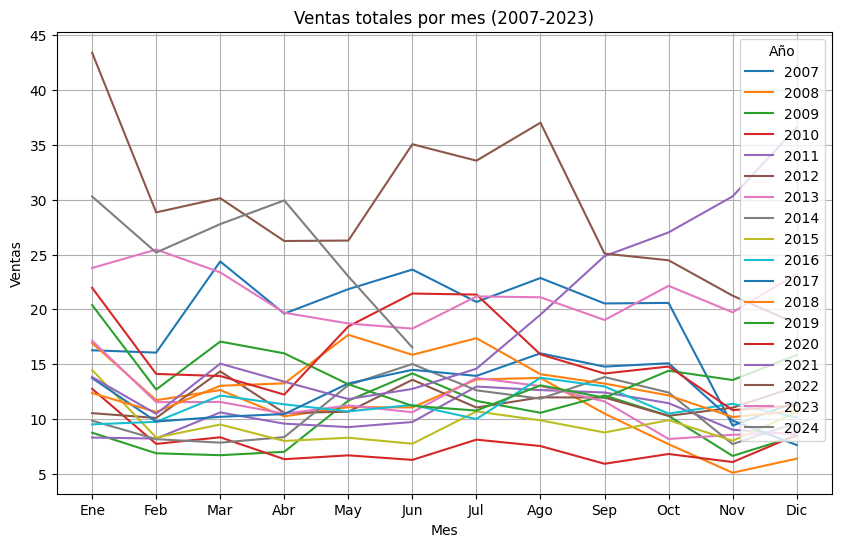

In [232]:
# Extraer los años únicos en el conjunto de datos
years = df.index.year.unique()

# Crear la gráfica
plt.figure(figsize=(10, 6))

# Iterar sobre cada año y trazar las ventas totales
for year in years:
    df_year = df[df.index.year == year]  # Filtrar los datos para el año actual
    plt.plot(df_year.index.month, df_year['Total MyC'], label=str(year))  # Trazar las ventas totales por mes

# Ajustar las etiquetas de los ejes
plt.xlabel('Mes')
plt.ylabel('Ventas')
plt.xticks(range(1, 13), ['Ene', 'Feb', 'Mar', 'Abr', 'May', 'Jun', 'Jul', 'Ago', 'Sep', 'Oct', 'Nov', 'Dic'])

# Añadir leyenda
plt.legend(title='Año')

# Añadir título
plt.title('Ventas totales por mes (2007-2023)')

# Mostrar la gráfica
plt.grid(True)
plt.show()

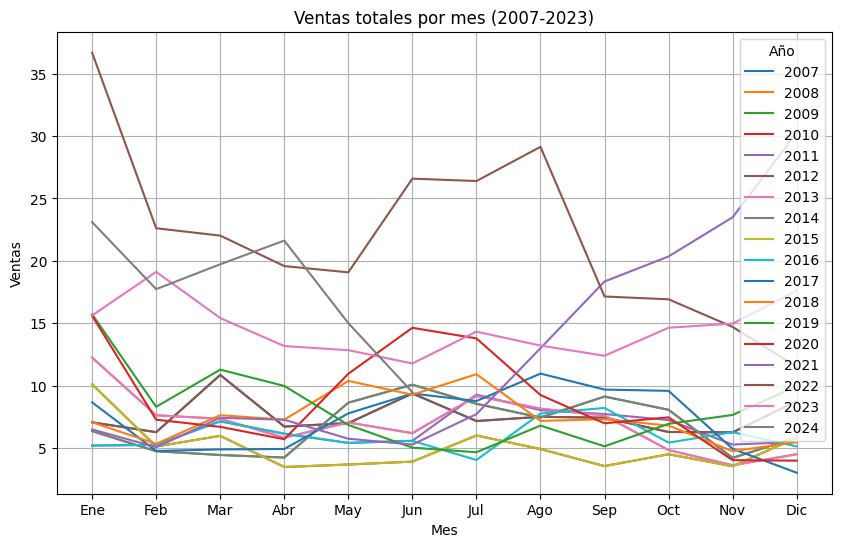

In [233]:
# Extraer los años únicos en el conjunto de datos
years = df.index.year.unique()

# Crear la gráfica
plt.figure(figsize=(10, 6))

# Iterar sobre cada año y trazar las ventas totales
for year in years:
    df_year = df[df.index.year == year]  # Filtrar los datos para el año actual
    plt.plot(df_year.index.month, df_year['Total M'], label=str(year))  # Trazar las ventas totales por mes

# Ajustar las etiquetas de los ejes
plt.xlabel('Mes')
plt.ylabel('Ventas')
plt.xticks(range(1, 13), ['Ene', 'Feb', 'Mar', 'Abr', 'May', 'Jun', 'Jul', 'Ago', 'Sep', 'Oct', 'Nov', 'Dic'])

# Añadir leyenda
plt.legend(title='Año')

# Añadir título
plt.title('Ventas totales por mes (2007-2023)')

# Mostrar la gráfica
plt.grid(True)
plt.show()

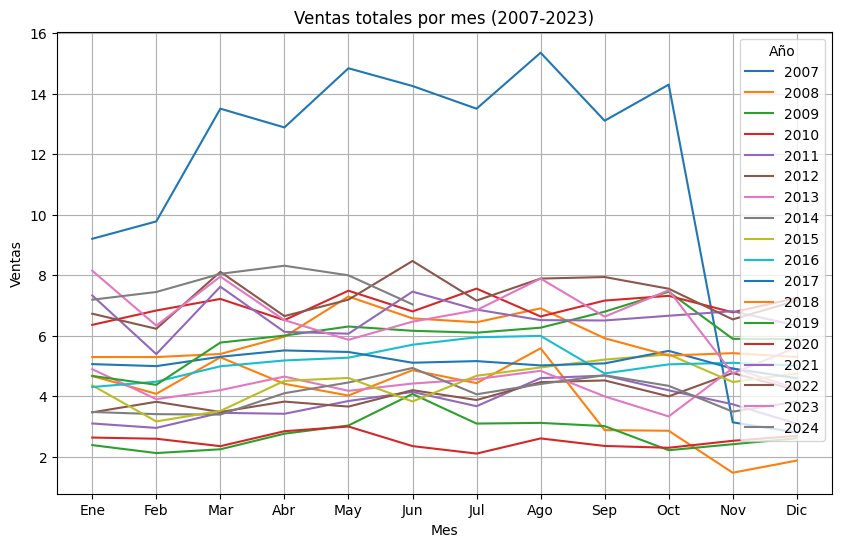

In [234]:
# Extraer los años únicos en el conjunto de datos
years = df.index.year.unique()

# Crear la gráfica
plt.figure(figsize=(10, 6))

# Iterar sobre cada año y trazar las ventas totales
for year in years:
    df_year = df[df.index.year == year]  # Filtrar los datos para el año actual
    plt.plot(df_year.index.month, df_year['Total C'], label=str(year))  # Trazar las ventas totales por mes

# Ajustar las etiquetas de los ejes
plt.xlabel('Mes')
plt.ylabel('Ventas')
plt.xticks(range(1, 13), ['Ene', 'Feb', 'Mar', 'Abr', 'May', 'Jun', 'Jul', 'Ago', 'Sep', 'Oct', 'Nov', 'Dic'])

# Añadir leyenda
plt.legend(title='Año')

# Añadir título
plt.title('Ventas totales por mes (2007-2023)')

# Mostrar la gráfica
plt.grid(True)
plt.show()

In [235]:
print(df.info())

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 210 entries, 2007-01-01 to 2024-06-01
Columns: 353 entries, Año to Índice de volumen físico      Total      21 - Minería           211 - Extracción de petróleo y gas           212 - Minería de minerales metálicos y no metálicos, excepto petróleo y gas           213 - Servicios relacionados con la minería      22 - Generación, transmisión y distribución de energía eléctrica, suministro de agua y de gas por ductos al consumidor final           221 - Generación, transmisión y distribución de energía eléctrica           222 - Suministro de agua y suministro de gas por ductos al consumidor final      23 - Construcción           236 - Edificación           237 - Construcción de obras de ingeniería civil           238 - Trabajos especializados para la construcción      31-33 - Industrias manufactureras           311 - Industria alimentaria           312 - Industria de las bebidas y del tabaco           313 - Fabricación de insumos textiles 

In [236]:
# Resumen estadístico
print(df.describe())

               Año         Mes   Trimestre   Total MyC     Total M  \
count   210.000000  210.000000  210.000000  210.000000  210.000000   
mean   2015.257143    6.414286    2.471429   14.272708    8.853969   
std       5.068013    3.459234    1.120340    6.623297    5.423130   
min    2007.000000    1.000000    1.000000    5.086885    3.017877   
25%    2011.000000    3.000000    1.000000   10.097048    5.412667   
50%    2015.000000    6.000000    2.000000   12.380297    7.252567   
75%    2020.000000    9.000000    3.000000   16.449059    9.882861   
max    2024.000000   12.000000    4.000000   43.412957   36.685394   

          Total C  CPI (Commodity Price Index)    Iron Ore  \
count  210.000000                   210.000000  210.000000   
mean     5.418740                   145.089286  111.688571   
std      2.380163                    33.794069   40.775474   
min      1.470900                    83.940000   40.500000   
25%      3.926764                   116.160000   76.205000 

In [237]:
# Calcular el número de datos faltantes por variable
missing_data = df.isnull().sum()

# Calcular el porcentaje de datos faltantes por variable
missing_percentage = (missing_data / len(df)) * 100

# Crear un DataFrame con los resultados
missing_df = pd.DataFrame({'Datos faltantes': missing_data, 'Porcentaje faltante': missing_percentage})
missing_df = missing_df.sort_values('Porcentaje faltante', ascending=False)

# Mostrar el DataFrame
print(missing_df)

                                                    Datos faltantes  \
Año                                                               0   
                    3117 - Preparación y envasa...                0   
                    3331 - Fabricación de maqui...                0   
               333 - Fabricación de maquinaria ...                0   
                    3329 - Fabricación de otros...                0   
                    3328 - Recubrimientos y ter...                0   
                    3327 - Maquinado de piezas ...                0   
                    3326 - Fabricación de alamb...                0   
                    3325 - Fabricación de herra...                0   
                    3324 - Fabricación de calde...                0   
                    3323 - Fabricación de estru...                0   
                    3322 - Fabricación de herra...                0   
                    3321 - Fabricación de produ...                0   
      

In [238]:
# Sumar los campos vacíos o nulos
sum_null = df.isnull().sum().sum()

# Verificar si la suma es cero
if sum_null == 0:
    print("No existen datos faltantes")
else:
    print("Existen datos faltantes")

No existen datos faltantes


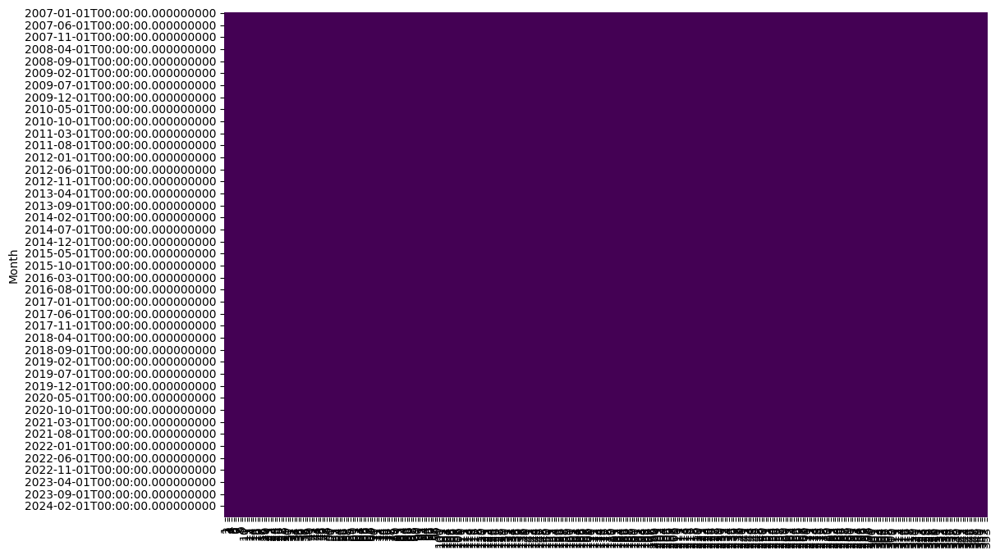

In [239]:
# Visualizar datos faltantes con numeración en el eje X
plt.figure(figsize=(12, 8))
num_labels = range(1, len(df.columns) + 1)
sns.heatmap(df.isnull(), cbar=False, cmap='viridis', xticklabels=num_labels)
plt.show()

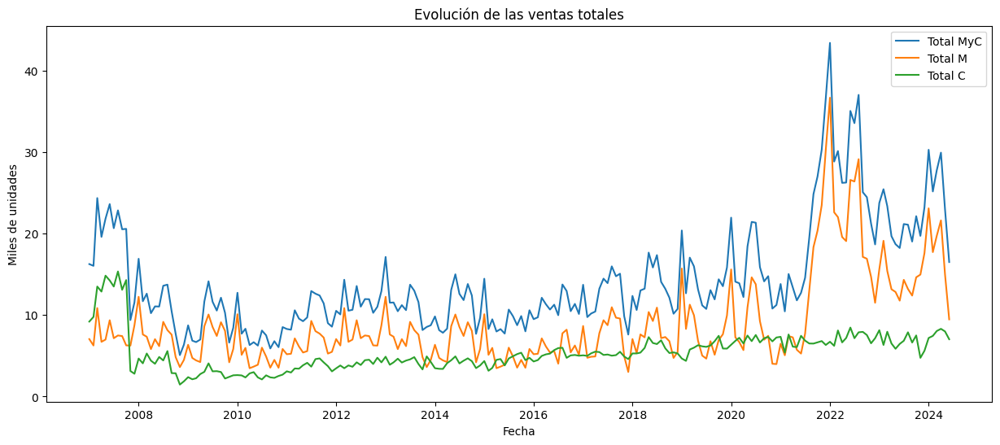

In [240]:
# Visualizar series temporales
def plot_time_series(df, columns, title):
    plt.figure(figsize=(15, 6))
    for col in columns:
        plt.plot(df.index, df[col], label=col)
    plt.title(title)
    plt.xlabel('Fecha')
    plt.ylabel('Miles de unidades')
    plt.legend()
    plt.show()

# Seleccionar columnas de target para visualizar
target_columns = ['Total MyC', 'Total M', 'Total C']  # Reemplazar con los nombres de tus columnas de target
plot_time_series(df, target_columns, 'Evolución de las ventas totales')


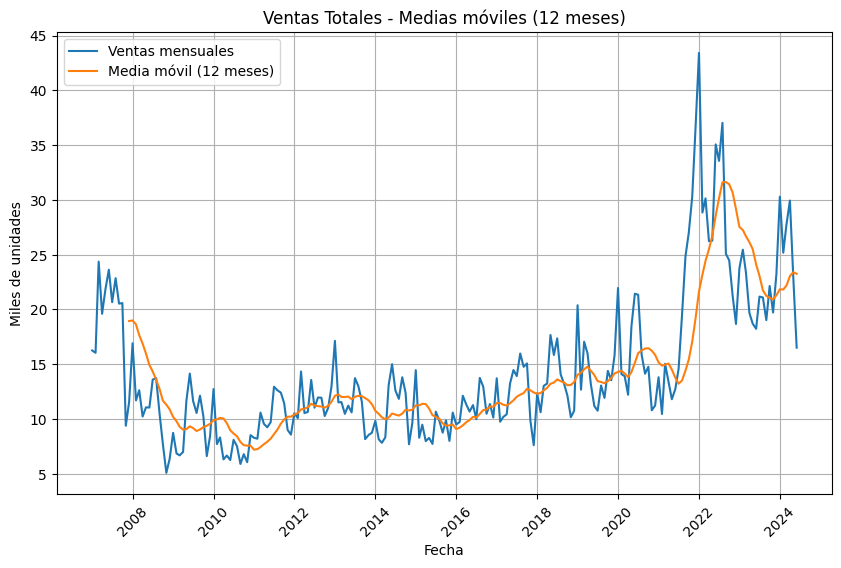

In [241]:
# Calcular la media móvil con una ventana de 12 meses
df['MA_12'] = df['Total MyC'].rolling(window=12).mean()

# Graficar los datos originales y la media móvil
plt.figure(figsize=(10, 6))
plt.plot(df.index, df['Total MyC'], label='Ventas mensuales')
plt.plot(df.index, df['MA_12'], label='Media móvil (12 meses)')
plt.xlabel('Fecha')
plt.ylabel('Miles de unidades')
plt.title('Ventas Totales - Medias móviles (12 meses)')
plt.legend()
plt.xticks(rotation=45)
plt.grid(True)
plt.show()


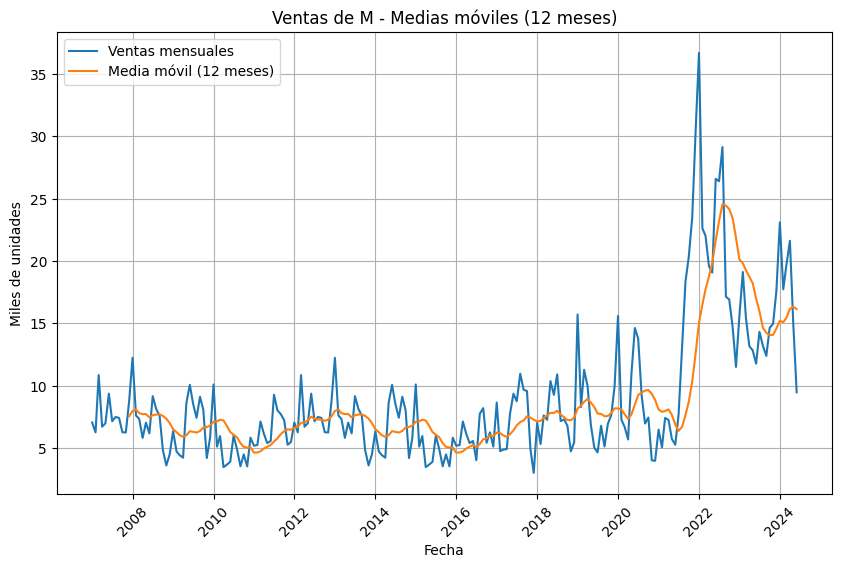

In [242]:
# Calcular la media móvil con una ventana de 12 meses
df['MA_12'] = df['Total M'].rolling(window=12).mean()

# Graficar los datos originales y la media móvil
plt.figure(figsize=(10, 6))
plt.plot(df.index, df['Total M'], label='Ventas mensuales')
plt.plot(df.index, df['MA_12'], label='Media móvil (12 meses)')
plt.xlabel('Fecha')
plt.ylabel('Miles de unidades')
plt.title('Ventas de M - Medias móviles (12 meses)')
plt.legend()
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

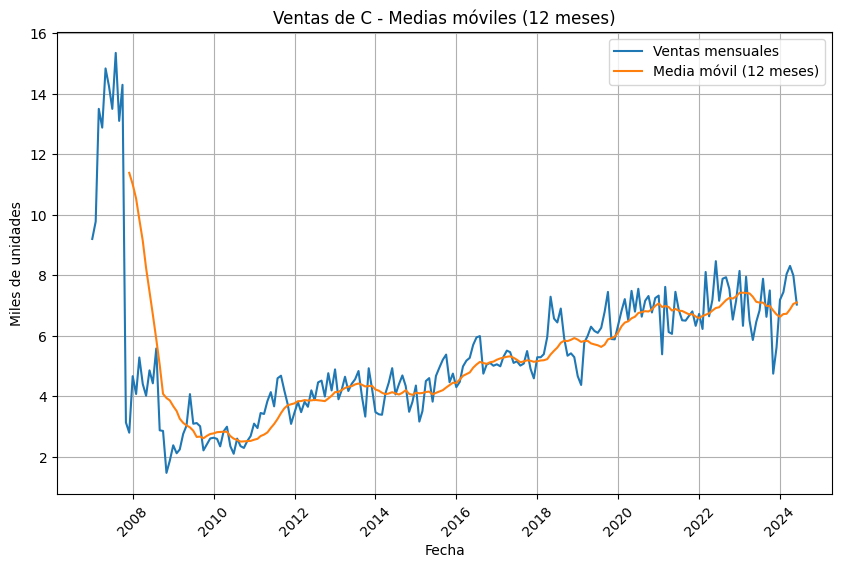

In [243]:
# Calcular la media móvil con una ventana de 12 meses
df['MA_12'] = df['Total C'].rolling(window=12).mean()

# Graficar los datos originales y la media móvil
plt.figure(figsize=(10, 6))
plt.plot(df.index, df['Total C'], label='Ventas mensuales')
plt.plot(df.index, df['MA_12'], label='Media móvil (12 meses)')
plt.xlabel('Fecha')
plt.ylabel('Miles de unidades')
plt.title('Ventas de C - Medias móviles (12 meses)')
plt.legend()
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

In [244]:
# Función para crear boxplots interactivos con Dash
def plot_boxplots_interactive_dash(df):
    years = df['Año'].unique()

    app = dash.Dash(__name__)

    app.layout = html.Div([
        dcc.RangeSlider(
            id='year-slider',
            marks={str(year): str(year) for year in years},
            min=min(years),
            max=max(years),
            step=1,
            value=[min(years), max(years)]
        ),
        dcc.Graph(id='total-MyC-box-plot'),
        dcc.Graph(id='total-M-box-plot'),
        dcc.Graph(id='total-C-box-plot'),
    ])

    @app.callback(
        [Output('total-MyC-box-plot', 'figure'),
         Output('total-M-box-plot', 'figure'),
         Output('total-C-box-plot', 'figure')],
        [Input('year-slider', 'value')]
    )
    def update_plots(year_range):
        filtered_df = df[(df['Año'] >= year_range[0]) & (df['Año'] <= year_range[1])]

        # Configurar el eje X para mostrar todos los años
        x_axis_config = dict(type='category')

        # Boxplot para Total MyC
        fig_total_MyC = go.Figure()

        for year in filtered_df['Año'].unique():
            data_year = filtered_df[filtered_df['Año'] == year]['Total MyC']
            fig_total_MyC.add_trace(go.Box(y=data_year, name=str(year), boxpoints="all", jitter=0.3, pointpos=-1.8))
            fig_total_MyC.add_trace(go.Scatter(x=[str(year)], y=[data_year.mean()], mode='text', text=[f'Avg: {data_year.mean():.1f}'], showlegend=False))

        fig_total_MyC.update_layout(title=f'Distribución de Ventas Totales - Años {year_range[0]}-{year_range[1]}',
                                   xaxis=x_axis_config, yaxis=dict(title='Miles de unidades'))

        # Boxplot para Total M
        fig_total_M = go.Figure()

        for year in filtered_df['Año'].unique():
            data_year = filtered_df[filtered_df['Año'] == year]['Total M']
            fig_total_M.add_trace(go.Box(y=data_year, name=str(year), boxpoints="all", jitter=0.3, pointpos=-1.8))
            fig_total_M.add_trace(go.Scatter(x=[str(year)], y=[data_year.mean()], mode='text', text=[f'Avg: {data_year.mean():.1f}'], showlegend=False))

        fig_total_M.update_layout(title=f'Distribución de Ventas M - Años {year_range[0]}-{year_range[1]}',
                                    xaxis=x_axis_config, yaxis=dict(title='Miles de unidades'))

        # Boxplot para Total C
        fig_total_C = go.Figure()

        for year in filtered_df['Año'].unique():
            data_year = filtered_df[filtered_df['Año'] == year]['Total C']
            fig_total_C.add_trace(go.Box(y=data_year, name=str(year), boxpoints="all", jitter=0.3, pointpos=-1.8))
            fig_total_C.add_trace(go.Scatter(x=[str(year)], y=[data_year.mean()], mode='text', text=[f'Avg: {data_year.mean():.1f}'], showlegend=False))

        fig_total_C.update_layout(title=f'Distribución de Ventas C - Años {year_range[0]}-{year_range[1]}',
                                    xaxis=x_axis_config, yaxis=dict(title='Miles de unidades'))

        return fig_total_MyC, fig_total_M, fig_total_C

    app.run_server(debug=True)

# Aplicar la función con el filtro interactivo
plot_boxplots_interactive_dash(df)


In [245]:
import dash
from dash import dcc, html
from dash.dependencies import Input, Output
import plotly.graph_objects as go

# Función para crear boxplots interactivos con Dash
def plot_boxplots_interactive_dash(df):
    years = df['Año'].unique()
    box_color = '#1f77b4'  # Azul oscuro para mejor contraste

    app = dash.Dash(__name__)

    app.layout = html.Div([
        dcc.RangeSlider(
            id='year-slider',
            marks={str(year): str(year) for year in years},
            min=min(years),
            max=max(years),
            step=1,
            value=[min(years), max(years)]
        ),
        dcc.Graph(id='total-MyC-box-plot'),
        dcc.Graph(id='total-M-box-plot'),
        dcc.Graph(id='total-C-box-plot'),
    ])

    @app.callback(
        [Output('total-MyC-box-plot', 'figure'),
         Output('total-M-box-plot', 'figure'),
         Output('total-C-box-plot', 'figure')],
        [Input('year-slider', 'value')]
    )
    def update_plots(year_range):
        filtered_df = df[(df['Año'] >= year_range[0]) & (df['Año'] <= year_range[1])]

        # Configurar el eje X para mostrar todos los años
        x_axis_config = dict(type='category')

        # Boxplot para Total MyC
        fig_total_MyC = go.Figure()

        for year in filtered_df['Año'].unique():
            data_year = filtered_df[filtered_df['Año'] == year]['Total MyC']
            fig_total_MyC.add_trace(go.Box(y=data_year, name=str(year), 
                                           boxpoints="all", jitter=0.3, pointpos=-1.8, 
                                           marker_color=box_color, showlegend=False))  # Color fijo y sin leyenda
            fig_total_MyC.add_trace(go.Scatter(x=[str(year)], y=[data_year.mean()], 
                                               mode='text', text=[f'Avg: {data_year.mean():.1f}'], 
                                               showlegend=False))

        fig_total_MyC.update_layout(title=f'Distribución de Ventas Totales - Años {year_range[0]}-{year_range[1]}',
                                    xaxis=x_axis_config, yaxis=dict(title='Miles de unidades'))

        # Boxplot para Total M
        fig_total_M = go.Figure()

        for year in filtered_df['Año'].unique():
            data_year = filtered_df[filtered_df['Año'] == year]['Total M']
            fig_total_M.add_trace(go.Box(y=data_year, name=str(year), 
                                         boxpoints="all", jitter=0.3, pointpos=-1.8, 
                                         marker_color=box_color, showlegend=False))  # Color fijo y sin leyenda
            fig_total_M.add_trace(go.Scatter(x=[str(year)], y=[data_year.mean()], 
                                             mode='text', text=[f'Avg: {data_year.mean():.1f}'], 
                                             showlegend=False))

        fig_total_M.update_layout(title=f'Distribución de Ventas M - Años {year_range[0]}-{year_range[1]}',
                                  xaxis=x_axis_config, yaxis=dict(title='Miles de unidades'))

        # Boxplot para Total C
        fig_total_C = go.Figure()

        for year in filtered_df['Año'].unique():
            data_year = filtered_df[filtered_df['Año'] == year]['Total C']
            fig_total_C.add_trace(go.Box(y=data_year, name=str(year), 
                                         boxpoints="all", jitter=0.3, pointpos=-1.8, 
                                         marker_color=box_color, showlegend=False))  # Color fijo y sin leyenda
            fig_total_C.add_trace(go.Scatter(x=[str(year)], y=[data_year.mean()], 
                                             mode='text', text=[f'Avg: {data_year.mean():.1f}'], 
                                             showlegend=False))

        fig_total_C.update_layout(title=f'Distribución de Ventas C - Años {year_range[0]}-{year_range[1]}',
                                  xaxis=x_axis_config, yaxis=dict(title='Miles de unidades'))

        return fig_total_MyC, fig_total_M, fig_total_C

    app.run_server(debug=True)

# Aplicar la función con el filtro interactivo
plot_boxplots_interactive_dash(df)


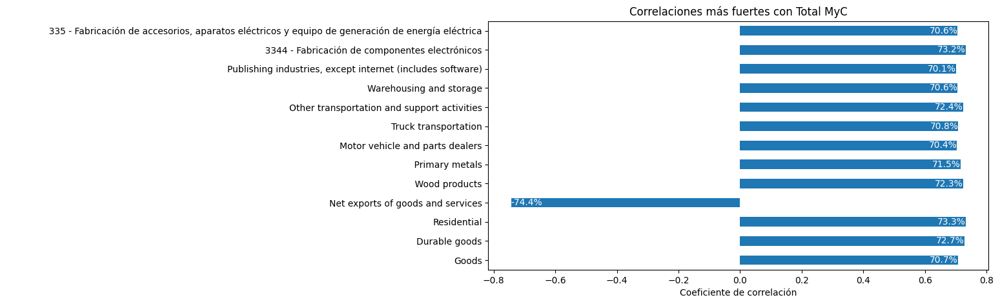

In [129]:
# Lista de columnas que NO se incluyen en el análisis de correlación ya que las mismas sumadas  conforman el total de la variable en análisis 
# Total Ventas = Total M + Total C
# Total M  = 'Planos M', "LAC", "LAF", "Pintados", "Galvanizados", "Largos y Tubos", "Tubos y Perfiles", "Largos"  
# Total C = "Pintados 1era C", "Galvanizados 1era C", "Pintados 2da C (Mtons)", "Galvanizados 2da C (Mtons)"

columns_to_exclude = ["Año","Mes","Trimestre","Año-Trimestre",'Total M', "Total C", "MA_12"]

# Crea un nuevo dataframe sin las columnas excluidas
df_filtered = df.drop(columns=columns_to_exclude)

# Reemplaza 'variable_of_interest' con el nombre de la columna que te interesa analizar
variable_of_interest = 'Total MyC'

# Establece un umbral de correlación
threshold = 0.70

# Calcula la matriz de correlación para el dataframe filtrado
corr_matrix = df_filtered.corr()

# Filtra las correlaciones más fuertes (positivas o negativas) para la variable de interés
strong_correlations = corr_matrix[abs(corr_matrix[variable_of_interest]) > threshold][variable_of_interest]

# Elimina la correlación consigo misma (1.0)
strong_correlations = strong_correlations.drop(variable_of_interest, errors='ignore')

# Muestra las correlaciones filtradas en un gráfico de barras horizontal
fig, ax = plt.subplots(figsize=(10, 5))
strong_correlations.plot(kind='barh', ax=ax)
plt.title('Correlaciones más fuertes con ' + variable_of_interest)
plt.xlabel('Coeficiente de correlación')

# Agrega los porcentajes de correlación dentro de cada barra con un color blanco y un decimal
for i, value in enumerate(strong_correlations):
    ax.text(value, i, f'{value:.1%}', ha='left' if value < 0 else 'right', va='center', fontsize=10, color='white')

plt.show()

In [130]:
# Ordena las correlaciones por valor absoluto de mayor a menor
sorted_correlations = strong_correlations.reindex(strong_correlations.abs().sort_values(ascending=False).index)

# Muestra las correlaciones ordenadas en una tabla
print(f"Correlaciones ordenadas para la variable {variable_of_interest}:")
print(sorted_correlations)

Correlaciones ordenadas para la variable Total MyC:
Net exports of goods and services                                                                                 -0.743594
Residential                                                                                                        0.732714
                    3344 - Fabricación de componentes electrónicos                                                 0.731583
Durable goods                                                                                                      0.727276
        Other transportation and support activities                                                                0.723781
            Wood products                                                                                          0.723206
            Primary metals                                                                                         0.715239
        Truck transportation                                                    

Mean Squared Error: 14.508872317493374


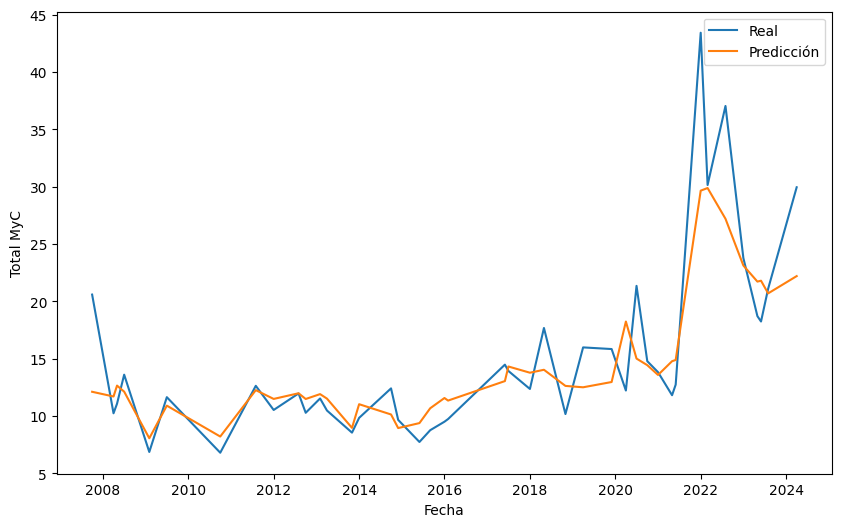

In [131]:
# Paso 1: Preprocesamiento de datos

# Eliminar NaN si es necesario
df_series_temporales = df_filtered.dropna()

# Separar las variables explicativas (X) y la variable objetivo (y)
X = df_series_temporales.drop('Total MyC', axis=1)
y = df_series_temporales['Total MyC']

# Paso 2: Dividir los datos en conjunto de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Paso 3: Entrenar un modelo de regresión, por ejemplo, un Random Forest
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Paso 4: Realizar predicciones en el conjunto de prueba
y_pred = model.predict(X_test)

# Paso 5: Evaluar el rendimiento del modelo
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error: {mse}')

# Ordenar los datos para graficar correctamente
y_test_sorted = y_test.sort_index()
y_pred_sorted = pd.Series(y_pred, index=y_test.index).sort_index()

# Paso 6: Visualizar las predicciones
plt.figure(figsize=(10, 6))
plt.plot(y_test_sorted.index, y_test_sorted, label='Real')
plt.plot(y_test_sorted.index, y_pred_sorted, label='Predicción')
plt.xlabel('Fecha')
plt.ylabel('Total MyC')
plt.legend()
plt.show()


In [132]:
# Obtener la importancia de las características desde el modelo
feature_importances = model.feature_importances_

# Crear un DataFrame con las características y sus importancias
feature_importance_df = pd.DataFrame({'Feature': X.columns, 'Importance': feature_importances})

# Ordenar el DataFrame por importancia en orden descendente
feature_importance_df = feature_importance_df.sort_values(by='Importance', ascending=False)

# Imprimir las 10 características más importantes
print("Top 10 Características Importantes:")
print(feature_importance_df.head(10))

Top 10 Características Importantes:
                                               Feature  Importance
61                      Furniture and related products    0.530426
252                      3359 - Fabricación de otro...    0.031312
295            56 - Servicios de apoyo a los negoci...    0.026165
26                                         Residential    0.022665
97               Funds, trusts, and other financial...    0.015487
322  Índice de volumen físico      Total      21 - ...    0.014134
4                                            Crude Oil    0.012080
316  Índice de volumen físico      Total      21 - ...    0.009538
167                      3114 - Conservación de fru...    0.009407
341  Índice de volumen físico      Total      21 - ...    0.008496


C:\Users\CDIBONO\AppData\Local\Temp\ipykernel_7996\508227012.py:6: FutureWarning:



Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `y` variable to `hue` and set `legend=False` for the same effect.




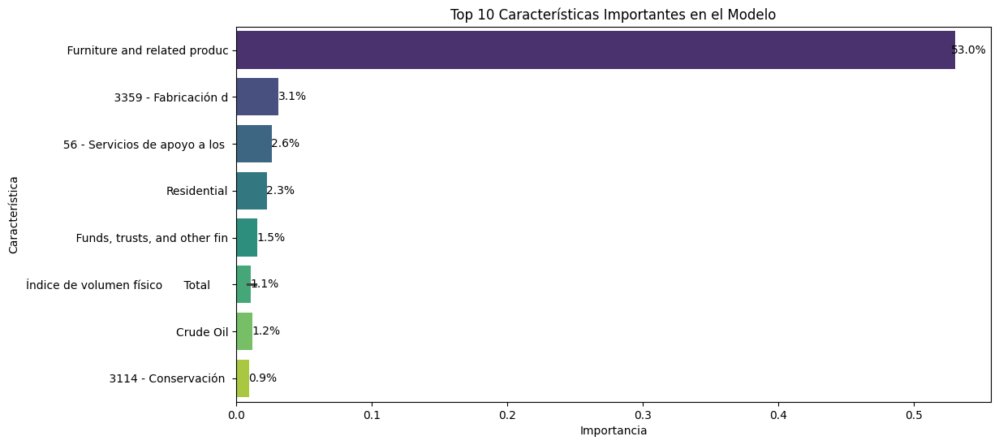

In [133]:
# Limitar la longitud de los nombres de las variables a 40 caracteres
feature_importance_df['Shortened_Feature'] = feature_importance_df['Feature'].str[:40]

# Crear una gráfica de barras para visualizar las 10 características más importantes
plt.figure(figsize=(12, 6))
ax = sns.barplot(x='Importance', y='Shortened_Feature', data=feature_importance_df.head(10), palette='viridis')

# Agregar valores en porcentaje al final de cada barra
for p in ax.patches:
    percentage = '{:.1f}%'.format(100 * p.get_width())
    x = p.get_x() + p.get_width() + 0.01
    y = p.get_y() + p.get_height() / 2
    ax.annotate(percentage, (x, y), ha='center', va='center')

plt.title('Top 10 Características Importantes en el Modelo')
plt.xlabel('Importancia')
plt.ylabel('Característica')
plt.show()


In [134]:
### Demora alrededor de 2 minutos

# Definir la cuadrícula de parámetros
param_grid = {
    'n_estimators': [50, 100, 200],
    'max_depth': [None, 10, 20],
    'min_samples_split': [2, 5, 10],
    'min_samples_leaf': [1, 2, 4],
    'max_features': [None, 'sqrt', 'log2']
}

# Crear un modelo base
base_model = RandomForestRegressor(random_state=42)

# Inicializar la búsqueda en cuadrícula
grid_search = GridSearchCV(estimator=base_model, param_grid=param_grid, scoring='neg_mean_squared_error', cv=5, n_jobs=-1, error_score='raise')

# Realizar la búsqueda en cuadrícula en los datos de entrenamiento
grid_search.fit(X_train, y_train)

# Mostrar los mejores parámetros encontrados
print("Mejores parámetros:", grid_search.best_params_)

# Obtener el modelo con los mejores parámetros
best_model = grid_search.best_estimator_

# Entrenar el modelo con los mejores parámetros en todos los datos de entrenamiento
best_model.fit(X_train, y_train)

# Realizar predicciones en los datos de prueba
y_pred = best_model.predict(X_test)

# Evaluar el rendimiento del modelo
mse = mean_squared_error(y_test, y_pred)
print(f'Mean Squared Error: {mse}')


Mejores parámetros: {'max_depth': None, 'max_features': 'sqrt', 'min_samples_leaf': 2, 'min_samples_split': 5, 'n_estimators': 50}
Mean Squared Error: 14.010867875299503


In [135]:
# Calcular los residuos
residuals = y_test - y_pred

# Mostrar los primeros 10 residuos
print("Residuos:", residuals[:10])

Residuos: Month
2009-07-01    0.984063
2021-05-01   -3.606828
2014-01-01   -0.582631
2023-08-01   -0.621649
2012-01-01   -0.834791
2019-12-01    2.635147
2010-10-01   -0.910326
2022-03-01    1.054803
2007-10-01    8.536788
2023-05-01   -2.735870
Name: Total MyC, dtype: float64


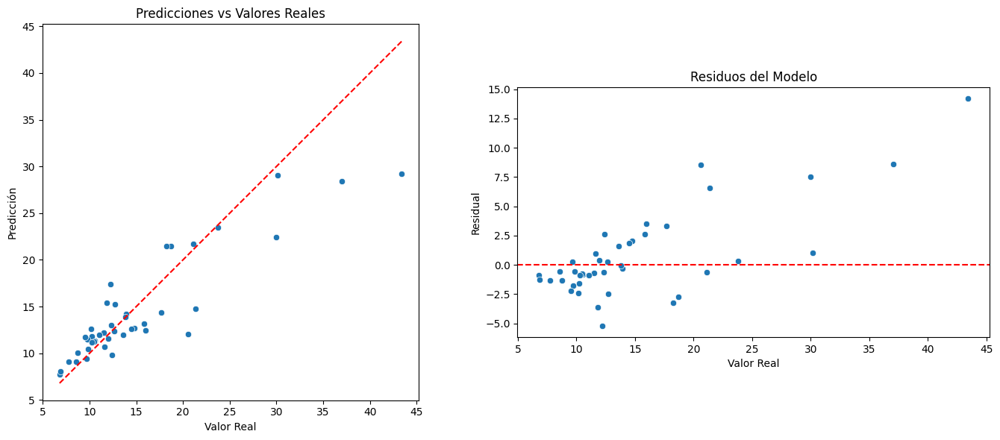

In [136]:
# Crear una figura con dos subgráficos
fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(14, 6))

# Visualizar las predicciones vs valores reales con ejes simétricos
sns.scatterplot(x=y_test, y=y_pred, ax=axes[0])
axes[0].plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='red', linestyle='--')
axes[0].set_aspect('equal', adjustable='box')
axes[0].set_xlabel('Valor Real')
axes[0].set_ylabel('Predicción')
axes[0].set_title('Predicciones vs Valores Reales')

# Visualizar los residuos con ejes simétricos
sns.scatterplot(x=y_test, y=residuals, ax=axes[1])
axes[1].axhline(y=0, color='red', linestyle='--')
axes[1].set_aspect('equal', adjustable='box')
axes[1].set_xlabel('Valor Real')
axes[1].set_ylabel('Residual')
axes[1].set_title('Residuos del Modelo')

plt.tight_layout()
plt.show()


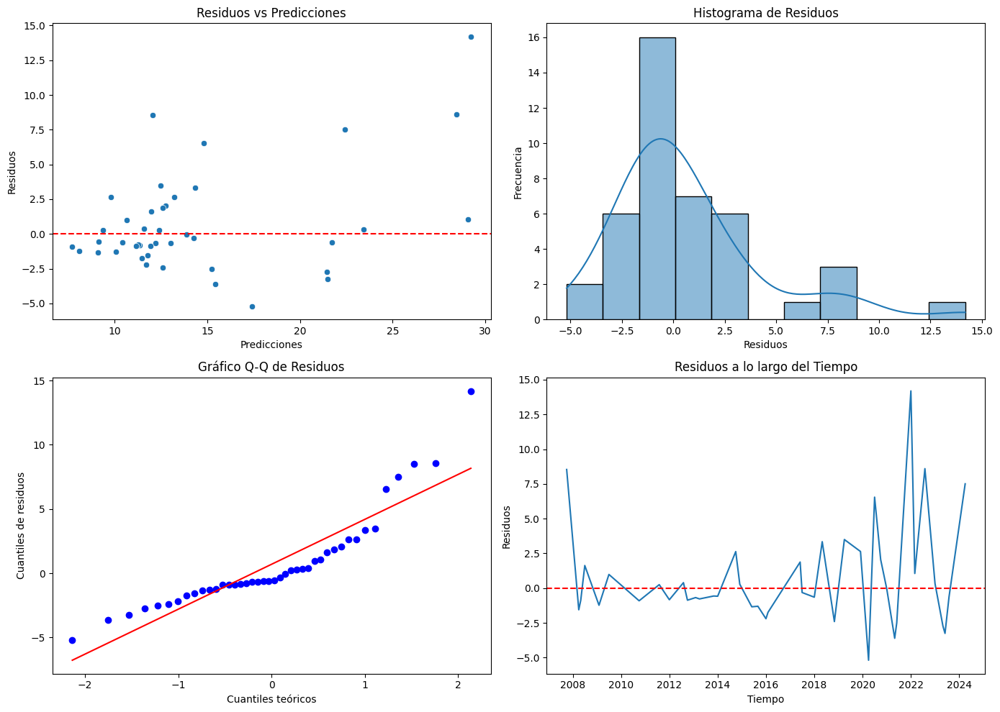

In [137]:
# Crear una figura con cuatro subgráficos
fig, axes = plt.subplots(nrows=2, ncols=2, figsize=(14, 10))

# Visualizar residuos vs predicciones y ajustar ejes
sns.scatterplot(x=y_pred, y=residuals, ax=axes[0, 0])
axes[0, 0].axhline(y=0, color='red', linestyle='--')
axes[0, 0].set_xlabel('Predicciones')
axes[0, 0].set_ylabel('Residuos')
axes[0, 0].set_title('Residuos vs Predicciones')

# Visualizar histograma de residuos
sns.histplot(residuals, ax=axes[0, 1], kde=True)
axes[0, 1].set_xlabel('Residuos')
axes[0, 1].set_ylabel('Frecuencia')
axes[0, 1].set_title('Histograma de Residuos')

# Visualizar gráfico Q-Q de residuos
stats.probplot(residuals, dist="norm", plot=axes[1, 0])
axes[1, 0].set_xlabel('Cuantiles teóricos')
axes[1, 0].set_ylabel('Cuantiles de residuos')
axes[1, 0].set_title('Gráfico Q-Q de Residuos')

# Visualizar residuos a lo largo del tiempo (si es un modelo de series temporales)
sns.lineplot(x=y_test.index, y=residuals, ax=axes[1, 1])
axes[1, 1].axhline(y=0, color='red', linestyle='--')
axes[1, 1].set_xlabel('Tiempo')
axes[1, 1].set_ylabel('Residuos')
axes[1, 1].set_title('Residuos a lo largo del Tiempo')

plt.tight_layout()
plt.show()


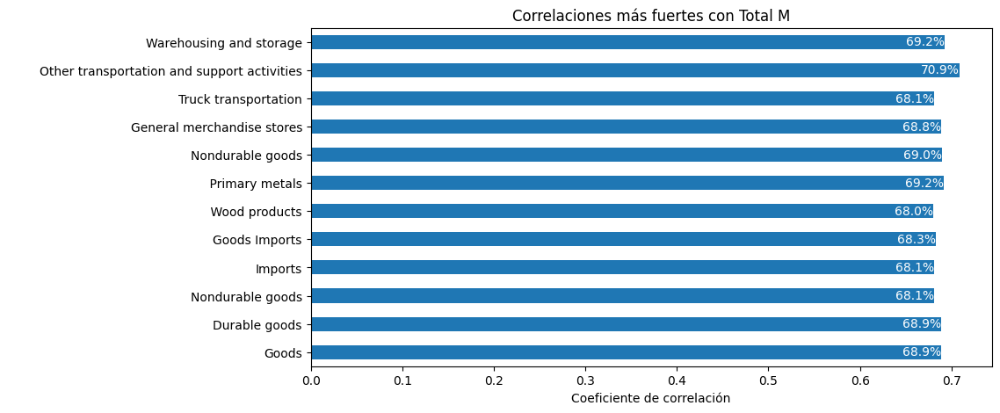

In [248]:
# Lista de columnas que NO deseas incluir en el análisis de correlación
columns_to_exclude = ["Año","Mes","Trimestre","Año-Trimestre",'Total MyC', "Total C", "MA_12"]

# Crea un nuevo dataframe sin las columnas excluidas
df_filtered = df.drop(columns=columns_to_exclude)

# Reemplaza 'variable_of_interest' con el nombre de la columna que te interesa analizar
variable_of_interest = 'Total M'

# Establece un umbral de correlación, en este caso, usamos 0.75 y -0.75
threshold = 0.68

# Calcula la matriz de correlación para el dataframe filtrado
corr_matrix = df_filtered.corr()

# Filtra las correlaciones más fuertes (positivas o negativas) para la variable de interés
strong_correlations = corr_matrix[abs(corr_matrix[variable_of_interest]) > threshold][variable_of_interest]

# Elimina la correlación consigo misma (1.0)
strong_correlations = strong_correlations.drop(variable_of_interest, errors='ignore')

# Muestra las correlaciones filtradas en un gráfico de barras horizontal
fig, ax = plt.subplots(figsize=(10, 5))
strong_correlations.plot(kind='barh', ax=ax)
plt.title('Correlaciones más fuertes con ' + variable_of_interest)
plt.xlabel('Coeficiente de correlación')

# Agrega los porcentajes de correlación dentro de cada barra con un color blanco y un decimal
for i, value in enumerate(strong_correlations):
    ax.text(value, i, f'{value:.1%}', ha='left' if value < 0 else 'right', va='center', fontsize=10, color='white')

plt.show()

In [139]:
# Ordena las correlaciones por valor absoluto de mayor a menor
sorted_correlations = strong_correlations.reindex(strong_correlations.abs().sort_values(ascending=False).index)

# Muestra las correlaciones ordenadas en una tabla
print(f"Correlaciones ordenadas para la variable {variable_of_interest}:")
print(sorted_correlations)

Correlaciones ordenadas para la variable Total M:
        Other transportation and support activities                                                             0.708526
        Warehousing and storage                                                                                 0.692387
            Primary metals                                                                                      0.691791
        Nondurable goods                                                                                        0.690026
Durable goods                                                                                                   0.688942
Goods                                                                                                           0.688594
        General merchandise stores                                                                              0.688454
Goods Imports                                                                                          

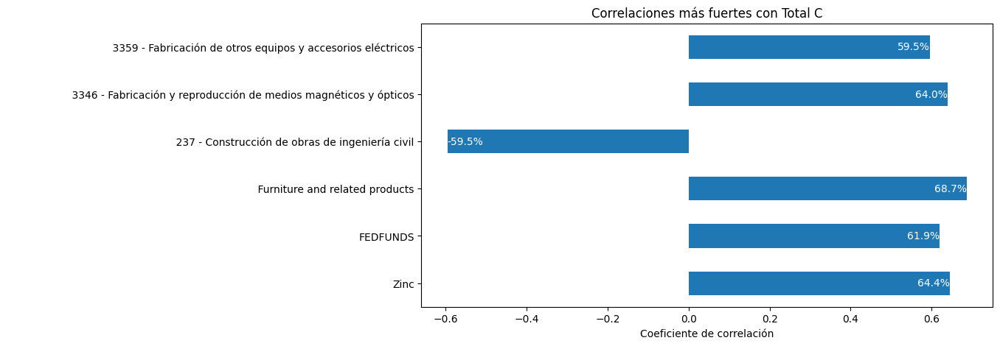

In [140]:
# Lista de columnas que NO deseas incluir en el análisis de correlación
columns_to_exclude = ["Año","Mes","Trimestre","Año-Trimestre",'Total MyC', "Total M", "MA_12"]

# Crea un nuevo dataframe sin las columnas excluidas
df_filtered = df.drop(columns=columns_to_exclude)

# Reemplaza 'variable_of_interest' con el nombre de la columna que te interesa analizar
variable_of_interest = 'Total C'

# Establece un umbral de correlación, en este caso, usamos 0.75 y -0.75
threshold = 0.59

# Calcula la matriz de correlación para el dataframe filtrado
corr_matrix = df_filtered.corr()

# Filtra las correlaciones más fuertes (positivas o negativas) para la variable de interés
strong_correlations = corr_matrix[abs(corr_matrix[variable_of_interest]) > threshold][variable_of_interest]

# Elimina la correlación consigo misma (1.0)
strong_correlations = strong_correlations.drop(variable_of_interest, errors='ignore')

# Muestra las correlaciones filtradas en un gráfico de barras horizontal
fig, ax = plt.subplots(figsize=(10, 5))
strong_correlations.plot(kind='barh', ax=ax)
plt.title('Correlaciones más fuertes con ' + variable_of_interest)
plt.xlabel('Coeficiente de correlación')

# Agrega los porcentajes de correlación dentro de cada barra con un color blanco y un decimal
for i, value in enumerate(strong_correlations):
    ax.text(value, i, f'{value:.1%}', ha='left' if value < 0 else 'right', va='center', fontsize=10, color='white')

plt.show()

In [141]:
# Ordena las correlaciones por valor absoluto de mayor a menor
sorted_correlations = strong_correlations.reindex(strong_correlations.abs().sort_values(ascending=False).index)

# Muestra las correlaciones ordenadas en una tabla
print(f"Correlaciones ordenadas para la variable {variable_of_interest}:")
print(sorted_correlations)

Correlaciones ordenadas para la variable Total C:
            Furniture and related products                                              0.687212
Zinc                                                                                    0.644118
                    3346 - Fabricación y reproducción de medios magnéticos y ópticos    0.639710
FEDFUNDS                                                                                0.618941
               237 - Construcción de obras de ingeniería civil                         -0.595451
                    3359 - Fabricación de otros equipos y accesorios eléctricos         0.595319
Name: Total C, dtype: float64


# Desarrollo PCA

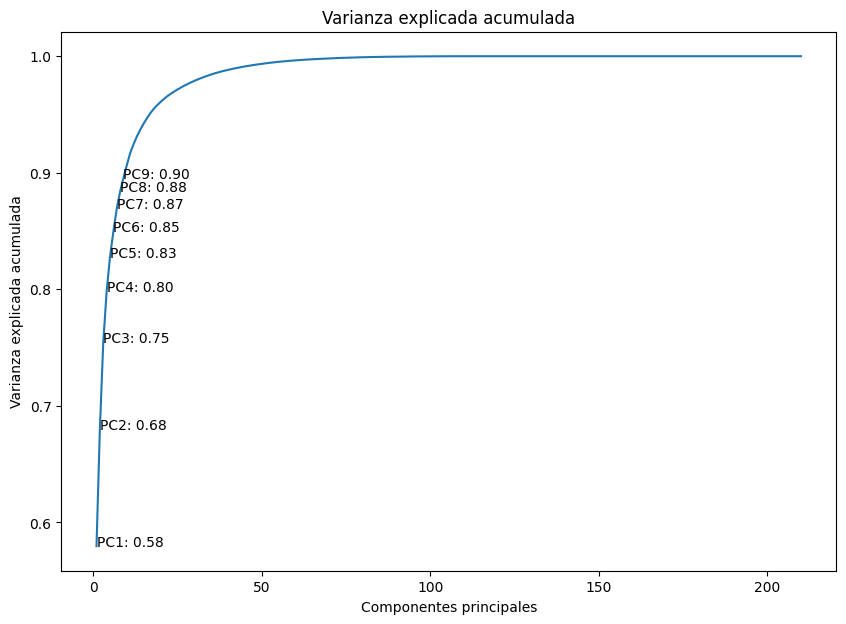

In [142]:
# Lista de columnas que NO se incluyen para realizar PCA
columns_to_exclude_PCA = ["Año","Mes","Trimestre","Año-Trimestre",'Total MyC','Total M', "Total C", "MA_12"]#, "Total MyC_log"]

# Crea un nuevo dataframe sin las columnas excluidas
df_filt_PCA = df.drop(columns=columns_to_exclude_PCA)

# Crea el imputador, que reemplaza los valores NaN con la media de la columna
imputer = SimpleImputer(strategy='mean')

# Aplica el imputador a los datos
df_filtered_imputed = imputer.fit_transform(df_filt_PCA)

# Ahora df_filtered_imputed es una matriz numpy. Si quieres convertirla de nuevo a un DataFrame:
df_filtered_imputed = pd.DataFrame(df_filtered_imputed, columns=df_filt_PCA.columns)

# Ahora puedes seguir con la normalización y PCA como antes
scaler = StandardScaler()
df_normalized = scaler.fit_transform(df_filtered_imputed)

pca = PCA()
df_pca = pca.fit_transform(df_normalized)

#df_pca = pd.DataFrame(df_pca, columns=[f'PC{i}' for i in range(1, len(df_filt_PCA.columns) + 1)])
df_pca = pd.DataFrame(df_pca, columns=[f'PC{i}' for i in range(1, df_pca.shape[1] + 1)])

#plt.figure(figsize=(10, 7))
#plt.plot(range(1, len(df_filtered.columns) + 1), np.cumsum(pca.explained_variance_ratio_))
#plt.title('Varianza explicada acumulada')
#plt.xlabel('Componentes principales')
#plt.ylabel('Varianza explicada acumulada')
#plt.show()

# Grafica la varianza explicada por cada componente principal
plt.figure(figsize=(10, 7))
explained_variance = np.cumsum(pca.explained_variance_ratio_)
plt.plot(range(1, len(explained_variance) + 1), explained_variance)
plt.title('Varianza explicada acumulada')
plt.xlabel('Componentes principales')
plt.ylabel('Varianza explicada acumulada')

# Agrega etiquetas a los puntos hasta que la varianza explicada acumulada alcance el 90%
for i, ev in enumerate(explained_variance):
    if ev <= 0.90:
        plt.text(i+1, ev, f'PC{i+1}: {ev:.2f}')
    else:
        break

plt.show()


In [143]:
# Obtener las tres principales componentes
top_components = pca.components_[:4]

# Crear un DataFrame para almacenar los resultados
component_table = pd.DataFrame(top_components.T, columns=['PC1', 'PC2', 'PC3','PC4'], index=df_filt_PCA.columns)

# Convertir los valores a porcentaje
component_table = component_table.apply(lambda x: x*100)

# Mostrar la tabla de componentes
print(component_table)


                                                         PC1       PC2  \
CPI (Commodity Price Index)                         1.115515  2.717571   
Iron Ore                                           -0.918857  6.219736   
Metals Price Index                                  0.961923  4.106104   
Aluminum                                            0.818664  1.905491   
Crude Oil                                           1.859386  2.724668   
...                                                      ...       ...   
Índice de volumen físico      Total      21 - M...  6.348239 -0.868750   
Índice de volumen físico      Total      21 - M...  5.449651  1.804592   
Índice de volumen físico      Total      21 - M...  5.987333 -4.727356   
Índice de volumen físico      Total      21 - M... -1.054873 -4.928354   
Índice de volumen físico      Total      21 - M...  6.239274 -2.652301   

                                                          PC3        PC4  
CPI (Commodity Price Index)         

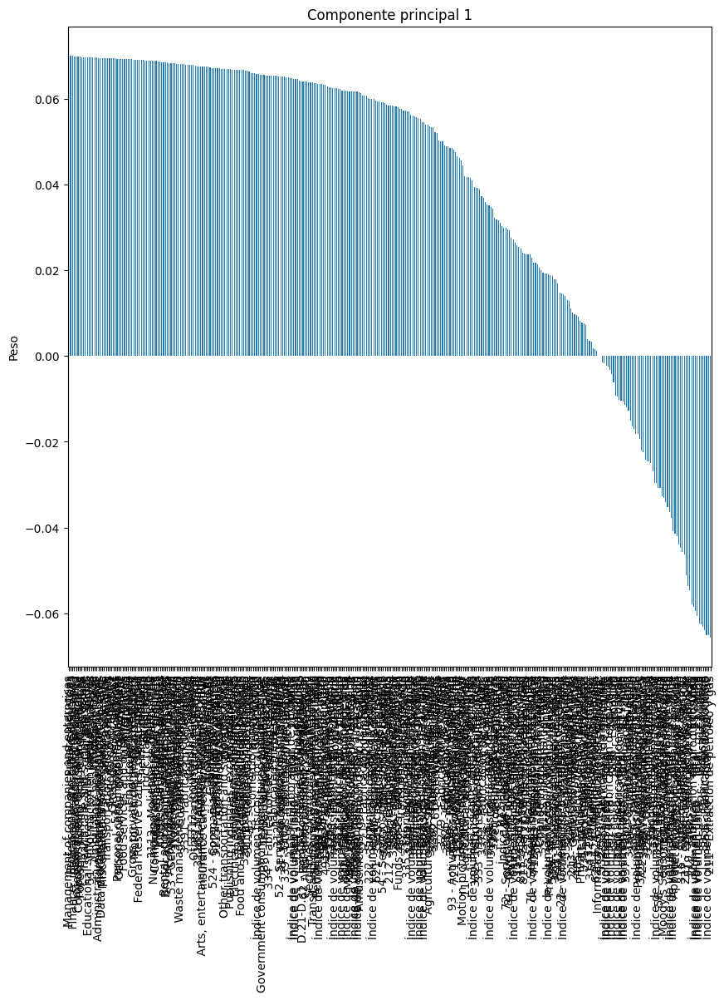

In [144]:
# Crea un DataFrame con los coeficientes de los componentes
df_components = pd.DataFrame(pca.components_, columns=df_filt_PCA.columns)

# Muestra los coeficientes del primer componente principal
df_components.iloc[0]

# Selecciona el componente principal que quieres visualizar
component_to_visualize = 0

# Limita las etiquetas del eje X a 10 caracteres
df_components.columns = [col[:50] for col in df_components.columns]

# Crea un gráfico de barras con los coeficientes del componente
plt.figure(figsize=(10, 10))
df_components.iloc[component_to_visualize].sort_values(ascending=False).plot(kind='bar')
plt.title(f'Componente principal {component_to_visualize + 1}')
plt.ylabel('Peso')
plt.show()


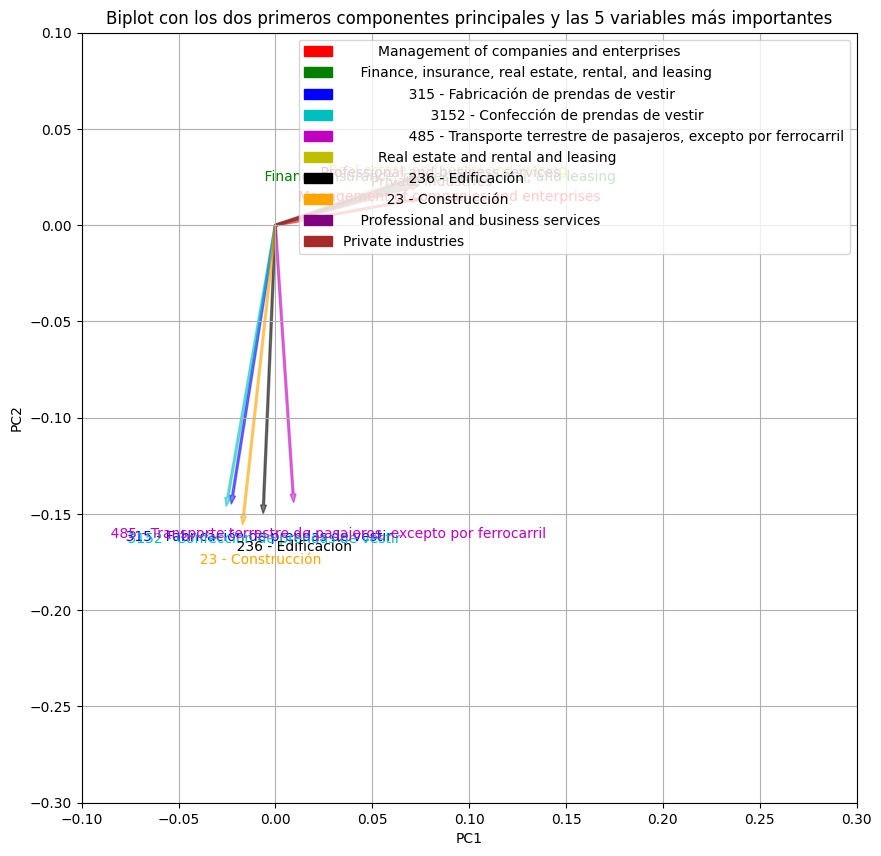

In [145]:
# REcuperamos todos los caracteres que habíamos limitado:

df_components = pd.DataFrame(pca.components_, columns=df_filt_PCA.columns)

# Primero, calculamos las cinco variables que más contribuyen a cada componente
top_n = 5
top_features_pc1 = df_components.iloc[0].abs().nlargest(top_n).index
top_features_pc2 = df_components.iloc[1].abs().nlargest(top_n).index

top_features = set(top_features_pc1).union(set(top_features_pc2))

# Crea una lista de colores
colors = ['r', 'g', 'b', 'c', 'm', 'y', 'k', 'orange', 'purple', 'brown']

# Crea el biplot
plt.figure(figsize=(10, 10))

patches = []
for i, feature in enumerate(top_features):
    plt.arrow(0, 0, df_components[feature][0], df_components[feature][1], color=colors[i], alpha=0.5)
    plt.text(df_components[feature][0]*1.15, df_components[feature][1]*1.15, feature, color=colors[i], ha='center', va='center')
    patches.append(mpatches.Patch(color=colors[i], label=feature))

# Define los límites de los ejes
plt.xlim(-0.1, 0.3)
plt.ylim(-0.3, 0.1)

plt.xlabel('PC1')
plt.ylabel('PC2')
plt.title('Biplot con los dos primeros componentes principales y las 5 variables más importantes')
plt.legend(handles=patches, loc='upper right') # Añade una leyenda al gráfico
plt.grid()

plt.show()



La utilización de PCA en modelos de predicción basados en series temporales depende del contexto y los objetivos específicos del análisis. 

A continuación, se presentan las consideraciones que se tuvieron en cuenta al decidir si usar PCA o trabajar con todas las variables originales:

*** Dimensionalidad: Si el conjunto de datos tiene muchas variables y la dimensionalidad es de importancia, PCA puede ser útil para reducir la cantidad de variables y simplificar el modelo. Al seleccionar las principales componentes principales que capturan la mayor parte de la variabilidad, se puede reducir la complejidad y la multicolinealidad en el modelo. ***

*** Interpretabilidad: Si la interpretabilidad de las variables originales es importante para el análisis, puede ser más conveniente trabajar con todas las variables en lugar de utilizar PCA. Las componentes principales son combinaciones lineales de las variables originales, lo que puede dificultar la interpretación directa de los resultados. ***

*** En el caso bajo estudio las variables originales tienen un significado específico y relevante para el problema que se está abordando, por lo cual se considera más apropiado trabajar con ellas directamente en lugar de utilizar PCA. Al usar PCA, se pueden perder detalles y matices específicos de las variables originales. Adicionalmente se encontró una buena reducción de dimensionalidad pero dentro de cada componente principal no destacan ciertas variables particulares dentro de las mismas. ***

# Descomposición de la serie

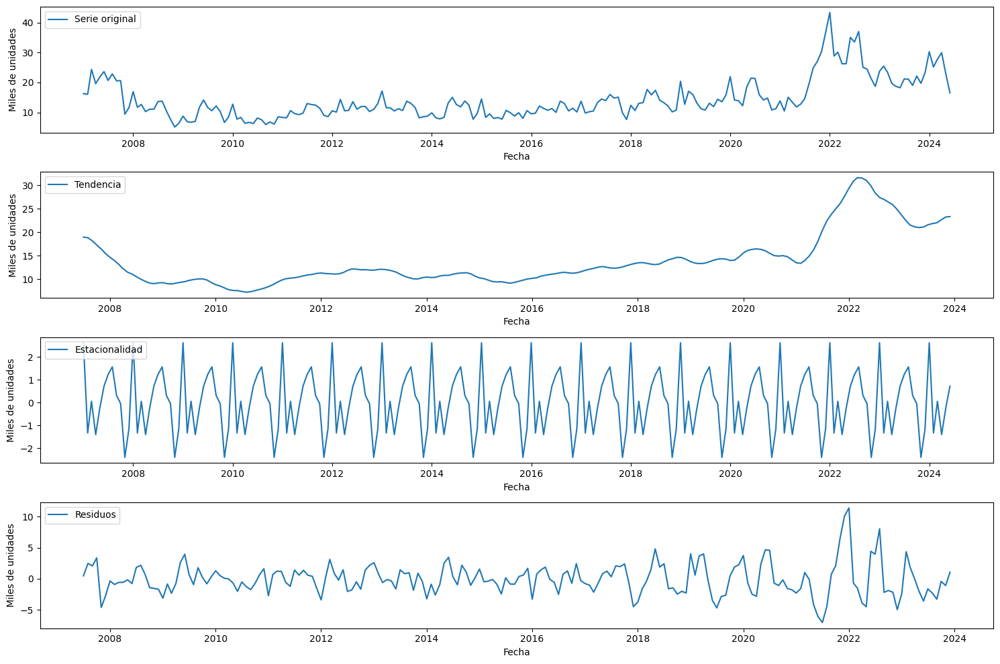

In [146]:
# Descomposición de la serie temporal Ventas Total MyC
# Frecuencia asume que tus datos son mensuales, ajusta este valor si es necesario
# (por ejemplo, frecuencia = 4 para datos trimestrales)
result = seasonal_decompose(df['Total MyC'], model='additive', period=12) 

# Función para graficar la descomposición
def plot_decomposition(decomposition):
    plt.figure(figsize=(15, 10))

    plt.subplot(411)
    plt.plot(decomposition.observed, label='Serie original')
    plt.legend(loc='upper left')
    plt.xlabel('Fecha')
    plt.ylabel('Miles de unidades')

    plt.subplot(412)
    plt.plot(decomposition.trend, label='Tendencia')
    plt.legend(loc='upper left')
    plt.xlabel('Fecha')
    plt.ylabel('Miles de unidades')

    plt.subplot(413)
    plt.plot(decomposition.seasonal, label='Estacionalidad')
    plt.legend(loc='upper left')
    plt.xlabel('Fecha')
    plt.ylabel('Miles de unidades')

    plt.subplot(414)
    plt.plot(decomposition.resid, label='Residuos')
    plt.legend(loc='upper left')
    plt.xlabel('Fecha')
    plt.ylabel('Miles de unidades')

    plt.tight_layout()
    plt.show()

# Graficar la descomposición
plot_decomposition(result)

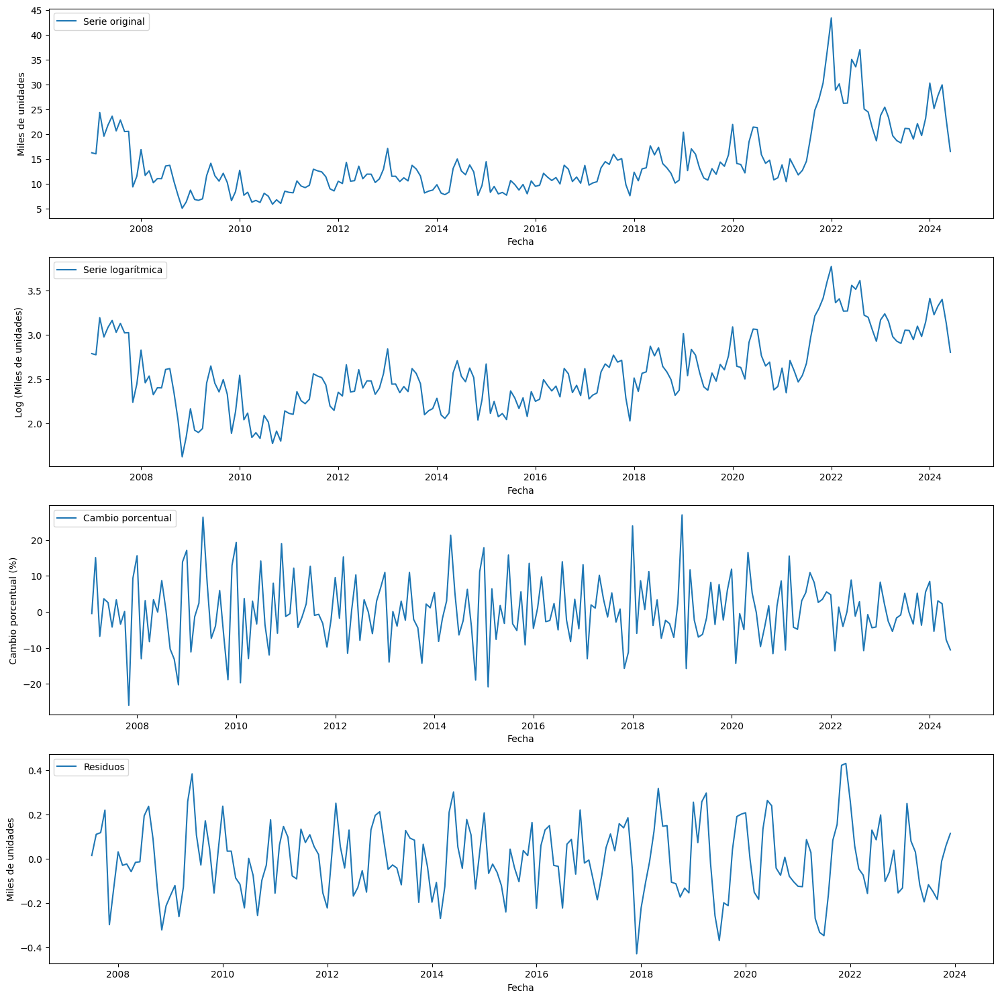

In [147]:
# Aplicar cambio logarítmico en la serie
df['Total MyC_log'] = np.log(df['Total MyC'])

# Calcular cambio porcentual en términos porcentuales
df['Total MyC_pct'] = df['Total MyC_log'].pct_change() * 100

# Descomposición de la serie temporal transformada
result_log = seasonal_decompose(df['Total MyC_log'], model='additive', period=12)

# Función para graficar la descomposición logarítmica y porcentual
def plot_decomposition_log_pct(decomposition, original_series, log_series, pct_series):
    plt.figure(figsize=(15, 15))

    plt.subplot(411)
    plt.plot(original_series, label='Serie original')
    plt.legend(loc='upper left')
    plt.xlabel('Fecha')
    plt.ylabel('Miles de unidades')

    plt.subplot(412)
    plt.plot(log_series, label='Serie logarítmica')
    plt.legend(loc='upper left')
    plt.xlabel('Fecha')
    plt.ylabel('Log (Miles de unidades)')

    plt.subplot(413)
    plt.plot(pct_series, label='Cambio porcentual')
    plt.legend(loc='upper left')
    plt.xlabel('Fecha')
    plt.ylabel('Cambio porcentual (%)')

    plt.subplot(414)
    plt.plot(decomposition.resid, label='Residuos')
    plt.legend(loc='upper left')
    plt.xlabel('Fecha')
    plt.ylabel('Miles de unidades')

    plt.tight_layout()
    plt.show()

# Graficar la descomposición logarítmica y porcentual
plot_decomposition_log_pct(result_log, df['Total MyC'], df['Total MyC_log'], df['Total MyC_pct'])


# Cálculo del P Value con la prueba de Dickey-Fuller aumentada
Aquí se evalúa el p-value. Si el p-value es menor a 0.05, se rechaza la hipótesis nula de la prueba, que postula que la serie tiene una raíz unitaria (es decir, no es estacionaria). Entonces, si el p-value es menor a 0.05, se concluye que la serie es estacionaria. Si es mayor, la serie no es estacionaria. 

Resultados:

La serie Total MyC es estacionaria.

La serie Total M es estacionaria.

La serie Total C no es estacionaria.

En resumen, la prueba de Dickey-Fuller es una herramienta clave para el análisis de series temporales que permite evaluar la estacionariedad de los datos y, en consecuencia, determinar los pasos necesarios para modelar la serie de manera efectiva.
Es esencialmente una manera de detectar si una serie temporal sigue un paseo aleatorio (no estacionaria) o si tiene una tendencia subyacente que no cambia con el tiempo (estacionaria).

In [148]:
# Realizar la prueba ADF para cada serie de datos

def adf_test(series):

    result = adfuller(series)
    print('ADF Statistic: %f' % result[0])
    print('p-value: %f' % result[1])
    print('Critical Values:')
    for key, value in result[4].items():
        print('\t%s: %.3f' % (key, value))

    if result[1] <= 0.05:
        print("La serie es estacionaria.")
    else:
        print("La serie no es estacionaria.")

# Aplicar la prueba a cada variable
for columna in ['Total MyC', 'Total M', 'Total C']:
    print(f"\nResultados para '{columna}':")
    adf_test(df[columna])

'''Una serie temporal es estacionaria si sus propiedades estadísticas (como la media, la varianza y la autocorrelación) 
no cambian con el tiempo. Las series estacionarias son importantes en análisis de series temporales porque muchos modelos, como ARIMA, 
asumen que las series temporales son estacionarias.

La prueba de Dickey-Fuller (ADF, por sus siglas en inglés) es un test estadístico que se utiliza para determinar si una serie temporal 
tiene una raíz unitaria, lo que indicaría que la serie no es estacionaria. En términos más simples, la prueba ayuda a verificar 
si una serie temporal es estacionaria o no.

¿Qué significa que una serie temporal sea estacionaria?
Una serie temporal es estacionaria si sus propiedades estadísticas, como la media, la varianza y la autocorrelación, son constantes 
a lo largo del tiempo. Las series estacionarias no muestran tendencias, estacionalidades, ni variaciones en su comportamiento a lo largo 
del tiempo.

Objetivo de la prueba de Dickey-Fuller:
El objetivo principal de la prueba de Dickey-Fuller es probar la hipótesis nula de que una serie temporal tiene una raíz unitaria. Esto 
significa que la serie temporal no es estacionaria (es decir, tiene tendencia o alguna forma de estructura dependiente del tiempo).

Hipótesis de la prueba:
Hipótesis nula (H0): La serie tiene una raíz unitaria (no es estacionaria).
Hipótesis alternativa (H1): La serie no tiene una raíz unitaria (es estacionaria).
Procedimiento de la prueba:
Calcular el valor p (p-value): La prueba de Dickey-Fuller calcula un valor p que se utiliza para decidir si se rechaza o no la 
hipótesis nula.
Interpretar el valor p:
Si el p-value es bajo (menor que un nivel de significancia, típicamente 0.05), se rechaza la hipótesis nula, lo que sugiere que la 
serie es estacionaria.
Si el p-value es alto (mayor que el nivel de significancia), no se puede rechazar la hipótesis nula, lo que sugiere que 
la serie no es estacionaria.
Importancia de la prueba:
Estacionariedad y modelado: Muchos modelos de series temporales, como ARIMA, requieren que las series sean estacionarias. 
Si una serie no es estacionaria, es común aplicar transformaciones (como la diferenciación) para hacerla estacionaria antes de modelarla.
Detección de tendencias: La prueba de Dickey-Fuller es útil para detectar si hay una tendencia a largo plazo o 
algún otro comportamiento no estacionario en la serie temporal.
Ejemplo de un proceso no estacionario:
Si una serie temporal sigue un proceso de paseo aleatorio (random walk), como por ejemplo el precio de una acción que solo 
depende del precio anterior más un error aleatorio, entonces esta serie no es estacionaria porque tiene una raíz unitaria. 
La prueba de Dickey-Fuller puede ayudar a identificar esto.'''


Resultados para 'Total MyC':
ADF Statistic: -3.074277
p-value: 0.028516
Critical Values:
	1%: -3.462
	5%: -2.876
	10%: -2.574
La serie es estacionaria.

Resultados para 'Total M':
ADF Statistic: -4.114483
p-value: 0.000916
Critical Values:
	1%: -3.462
	5%: -2.875
	10%: -2.574
La serie es estacionaria.

Resultados para 'Total C':
ADF Statistic: -1.476946
p-value: 0.544884
Critical Values:
	1%: -3.464
	5%: -2.876
	10%: -2.575
La serie no es estacionaria.


'Una serie temporal es estacionaria si sus propiedades estadísticas (como la media, la varianza y la autocorrelación) \nno cambian con el tiempo. Las series estacionarias son importantes en análisis de series temporales porque muchos modelos, como ARIMA, \nasumen que las series temporales son estacionarias.\n\nLa prueba de Dickey-Fuller (ADF, por sus siglas en inglés) es un test estadístico que se utiliza para determinar si una serie temporal \ntiene una raíz unitaria, lo que indicaría que la serie no es estacionaria. En términos más simples, la prueba ayuda a verificar \nsi una serie temporal es estacionaria o no.\n\n¿Qué significa que una serie temporal sea estacionaria?\nUna serie temporal es estacionaria si sus propiedades estadísticas, como la media, la varianza y la autocorrelación, son constantes \na lo largo del tiempo. Las series estacionarias no muestran tendencias, estacionalidades, ni variaciones en su comportamiento a lo largo \ndel tiempo.\n\nObjetivo de la prueba de Dick

# Proceso Autorregresivo (AR) y Proceso de Media Móvil (MA)
Esto sugiere que los valores actuales de la serie están linealmente relacionados con los valores anteriores. Se pueden considerar modelos AR para analizar y predecir la serie temporal.

Resultados:

La serie Total MyC sigue un proceso autoregresivo (AR) y sigue un proceso de media móvil (MA)

La serie Total M sigue un proceso autoregresivo (AR) y sigue un proceso de media móvil (MA)

La serie Total C sigue un proceso autoregresivo (AR) y sigue un proceso de media móvil (MA)

Predicción: dado que estas series siguen un proceso AR, se pueden usar modelos autorregresivos para predecir futuros valores de las ventas con bastante precisión, basándose en los valores pasados.

Limitaciones: un modelo AR asume que solo los valores pasados de la serie influyen en los futuros. No considera otros factores externos (como cambios en el mercado, eventos inesperados, etc.) que podrían influir en las ventas. También, un modelo AR asume que la relación entre los valores pasados y presentes es lineal.

Que sigan un proceso de media móvil significa que se pueden modelar como una combinación de un término constante y los errores cometidos en las estimaciones de las ventas en los periodos anteriores.

Predicción: En un modelo MA, los valores futuros no dependen directamente de los valores pasados de la serie, sino de los errores cometidos en los periodos anteriores. Por lo tanto, para hacer predicciones, se necesita conocer los errores anteriores.

In [149]:
model = AutoReg(df['Total MyC'].asfreq('MS'), lags=1)
model_fit = model.fit()

if len(model_fit.params) > 1:
    print("La serie Total MyC sigue un proceso autoregresivo (AR).")
else:
    print("La serie Total MyC no sigue un proceso autoregresivo (AR).")

model = AutoReg(df['Total M'].asfreq('MS'), lags=1)
model_fit = model.fit()

if len(model_fit.params) > 1:
    print("La serie Total M sigue un proceso autoregresivo (AR).")
else:
    print("La serie Total M no sigue un proceso autoregresivo (AR).")

model = AutoReg(df['Total C'].asfreq('MS'), lags=1)
model_fit = model.fit()

if len(model_fit.params) > 1:
    print("La serie Total C sigue un proceso autoregresivo (AR).")
else:
    print("La serie Total C no sigue un proceso autoregresivo (AR).")

La serie Total MyC sigue un proceso autoregresivo (AR).
La serie Total M sigue un proceso autoregresivo (AR).
La serie Total C sigue un proceso autoregresivo (AR).


In [150]:
model = ARIMA(df['Total MyC'].asfreq('MS'), order=(0, 0, 1))
model_fit = model.fit()

if model_fit.arparams.size == 0 and model_fit.maparams.size > 0:
    print("La serie Total MyC sigue un proceso de media móvil (MA).")
else:
    print("La serie Total MyC no sigue un proceso de media móvil (MA).")

model = ARIMA(df['Total M'].asfreq('MS'), order=(0, 0, 1))
model_fit = model.fit()

if model_fit.arparams.size == 0 and model_fit.maparams.size > 0:
    print("La serie Total M sigue un proceso de media móvil (MA).")
else:
    print("La serie Total M no sigue un proceso de media móvil (MA).")

model = ARIMA(df['Total C'].asfreq('MS'), order=(0, 0, 1))
model_fit = model.fit()

if model_fit.arparams.size == 0 and model_fit.maparams.size > 0:
    print("La serie Total C sigue un proceso de media móvil (MA).")
else:
    print("La serie Total C no sigue un proceso de media móvil (MA).")

La serie Total MyC sigue un proceso de media móvil (MA).
La serie Total M sigue un proceso de media móvil (MA).
La serie Total C sigue un proceso de media móvil (MA).


# Gráfico de la función de autocorrelación (ACF):
Muestra las correlaciones entre una serie y sus valores rezagados (lags). En este caso, al tener una frecuencia mensual, el gráfico de ACF ayuda a identificar patrones de correlación a lo largo del tiempo. Algunas posibles interpretaciones incluyen:
Existe una correlación significativa en el primer lag (lag 1), esto indica una fuerte correlación entre las ventas de un mes y las ventas del mes siguiente y luego se observa una disminución gradual en la correlación a medida que aumenta el rezago.

# Gráfico de la función de autocorrelación parcial (PACF):
Muestra las correlaciones parciales entre una serie y sus valores rezagados, controlando los efectos de los rezagos intermedios.
Si hay una correlación parcial significativa en el primer lag (lag 1) y las correlaciones parciales de los lags anteriores son cercanas a cero, esto puede indicar una fuerte correlación directa entre las ventas de un mes y las ventas del mes siguiente, sin una correlación fuerte con los rezagos anteriores.

Para las 3 series vemos que el ACF muestra un decaimiento lento y el PACF muestra un corte abrupto entre el 2do y 3er lag, un modelo AR puede ser el más apropiado con orden 2 o 3.

ACF: Ayuda a determinar el parámetro "q" para un modelo MA.
PACF: Ayuda a determinar el parámetro "p" para un modelo AR (este sería el caso, p = 2 para las series Total MyC y Total M y 3 para la serie Total C).

<Figure size 1000x500 with 0 Axes>

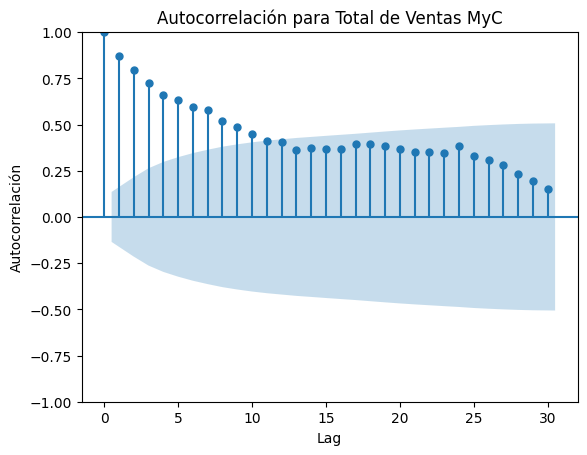

<Figure size 1000x500 with 0 Axes>

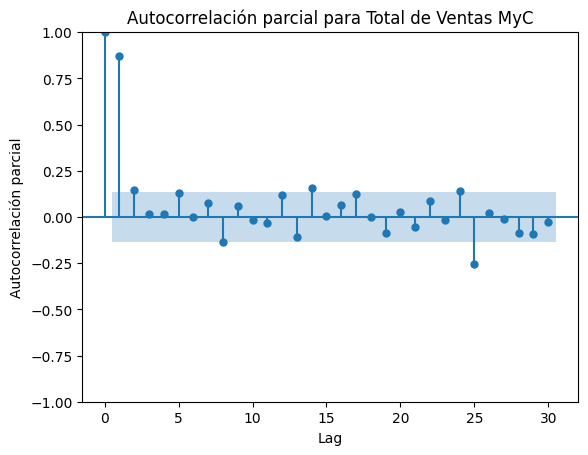

<Figure size 1000x500 with 0 Axes>

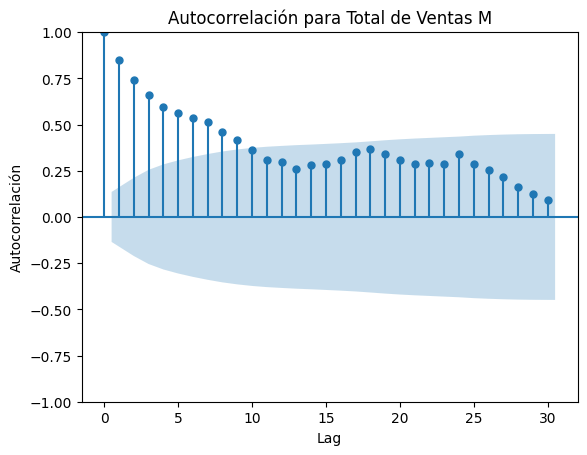

<Figure size 1000x500 with 0 Axes>

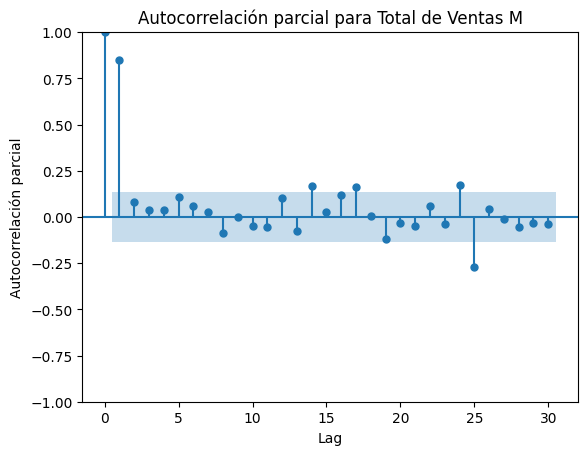

<Figure size 1000x500 with 0 Axes>

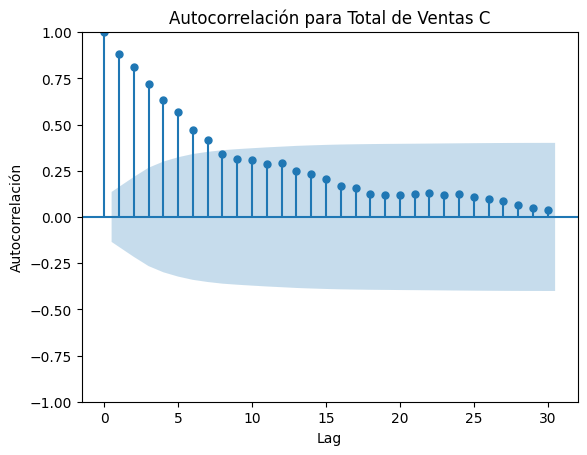

<Figure size 1000x500 with 0 Axes>

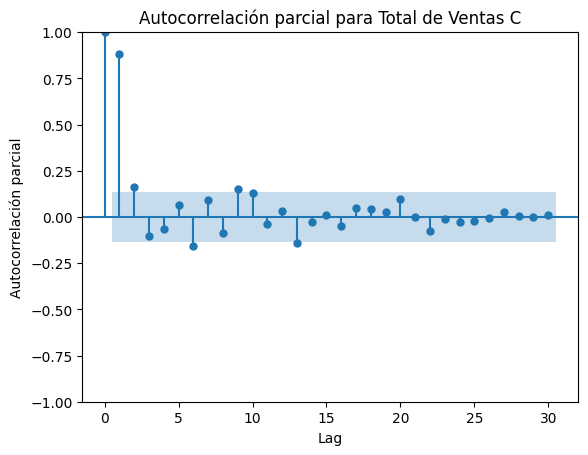

In [151]:
# Total MyC
# Gráfico de la función de autocorrelación (ACF)
plt.figure(figsize=(10, 5))
plot_acf(df['Total MyC'], lags=30, title='Autocorrelación para Total de Ventas MyC')
plt.xlabel('Lag')
plt.ylabel('Autocorrelación')
plt.show()

# Gráfico de la función de autocorrelación parcial (PACF)
plt.figure(figsize=(10, 5))
plot_pacf(df['Total MyC'], lags=30, title='Autocorrelación parcial para Total de Ventas MyC')
plt.xlabel('Lag')
plt.ylabel('Autocorrelación parcial')
plt.show()

# Total M
# Gráfico de la función de autocorrelación (ACF)
plt.figure(figsize=(10, 5))
plot_acf(df['Total M'], lags=30, title='Autocorrelación para Total de Ventas M')
plt.xlabel('Lag')
plt.ylabel('Autocorrelación')
plt.show()

# Gráfico de la función de autocorrelación parcial (PACF)
plt.figure(figsize=(10, 5))
plot_pacf(df['Total M'], lags=30, title='Autocorrelación parcial para Total de Ventas M')
plt.xlabel('Lag')
plt.ylabel('Autocorrelación parcial')
plt.show()

# Total C
# Gráfico de la función de autocorrelación (ACF)
plt.figure(figsize=(10, 5))
plot_acf(df['Total C'], lags=30, title='Autocorrelación para Total de Ventas C')
plt.xlabel('Lag')
plt.ylabel('Autocorrelación')
plt.show()

# Gráfico de la función de autocorrelación parcial (PACF)
plt.figure(figsize=(10, 5))
plot_pacf(df['Total C'], lags=30, title='Autocorrelación parcial para Total de Ventas C')
plt.xlabel('Lag')
plt.ylabel('Autocorrelación parcial')
plt.show()

<Figure size 1000x500 with 0 Axes>

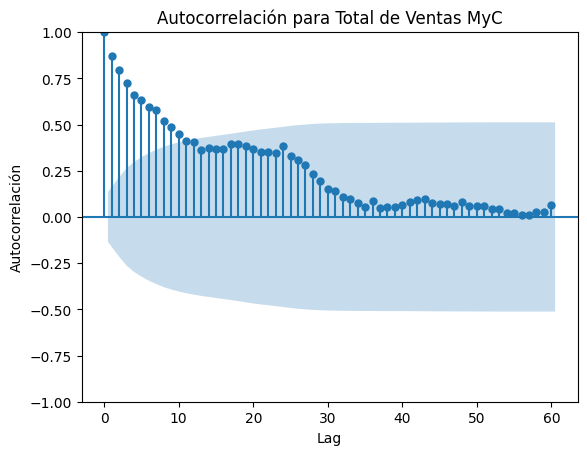

<Figure size 1000x500 with 0 Axes>

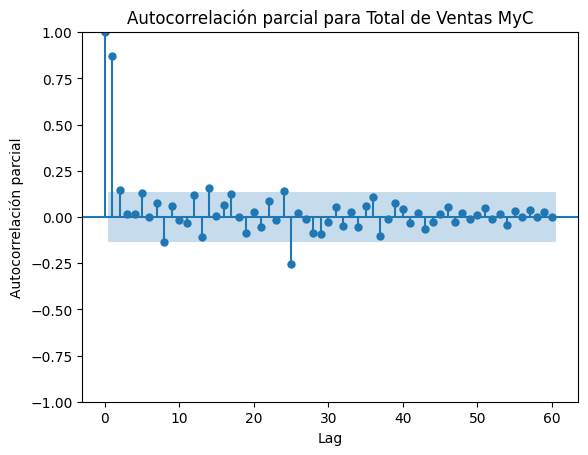

<Figure size 1000x500 with 0 Axes>

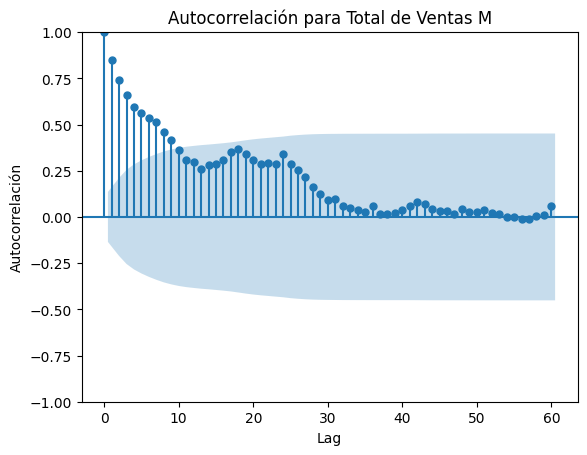

<Figure size 1000x500 with 0 Axes>

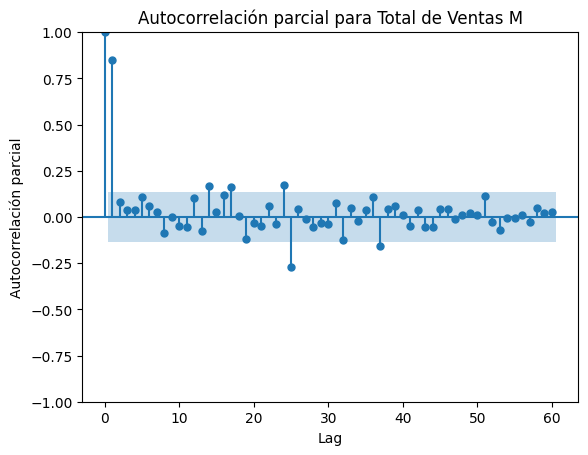

<Figure size 1000x500 with 0 Axes>

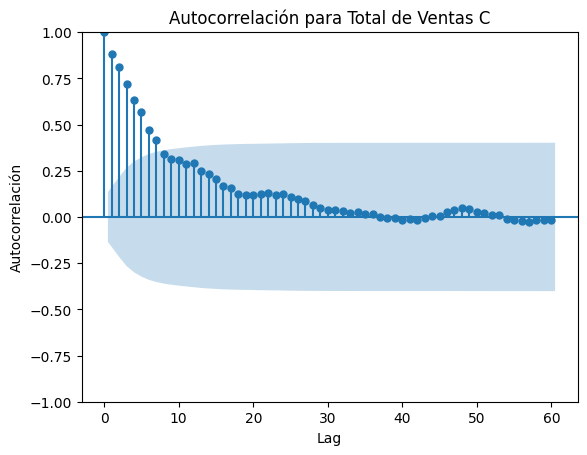

<Figure size 1000x500 with 0 Axes>

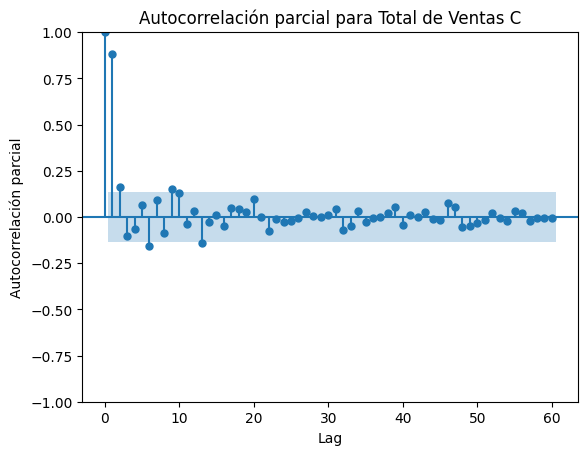

In [152]:
# Total MyC
# Gráfico de la función de autocorrelación (ACF)
plt.figure(figsize=(10, 5))
plot_acf(df['Total MyC'], lags=60, title='Autocorrelación para Total de Ventas MyC')
plt.xlabel('Lag')
plt.ylabel('Autocorrelación')
plt.show()

# Gráfico de la función de autocorrelación parcial (PACF)
plt.figure(figsize=(10, 5))
plot_pacf(df['Total MyC'], lags=60, title='Autocorrelación parcial para Total de Ventas MyC')
plt.xlabel('Lag')
plt.ylabel('Autocorrelación parcial')
plt.show()

# Total M
# Gráfico de la función de autocorrelación (ACF)
plt.figure(figsize=(10, 5))
plot_acf(df['Total M'], lags=60, title='Autocorrelación para Total de Ventas M')
plt.xlabel('Lag')
plt.ylabel('Autocorrelación')
plt.show()

# Gráfico de la función de autocorrelación parcial (PACF)
plt.figure(figsize=(10, 5))
plot_pacf(df['Total M'], lags=60, title='Autocorrelación parcial para Total de Ventas M')
plt.xlabel('Lag')
plt.ylabel('Autocorrelación parcial')
plt.show()

# Total C
# Gráfico de la función de autocorrelación (ACF)
plt.figure(figsize=(10, 5))
plot_acf(df['Total C'], lags=60, title='Autocorrelación para Total de Ventas C')
plt.xlabel('Lag')
plt.ylabel('Autocorrelación')
plt.show()

# Gráfico de la función de autocorrelación parcial (PACF)
plt.figure(figsize=(10, 5))
plot_pacf(df['Total C'], lags=60, title='Autocorrelación parcial para Total de Ventas C')
plt.xlabel('Lag')
plt.ylabel('Autocorrelación parcial')
plt.show()

# Desarrollo de Modelos

## Autorregresivos (AR)

Métricas para Total MyC - Últimos 12 meses:
MSE: 68.56
MAE: 6.97
RMSE: 8.28
MAPE: 27.58%


C:\Users\CDIBONO\AppData\Local\Temp\ipykernel_7996\2274645185.py:55: FutureWarning:

The behavior of DataFrame concatenation with empty or all-NA entries is deprecated. In a future version, this will no longer exclude empty or all-NA columns when determining the result dtypes. To retain the old behavior, exclude the relevant entries before the concat operation.



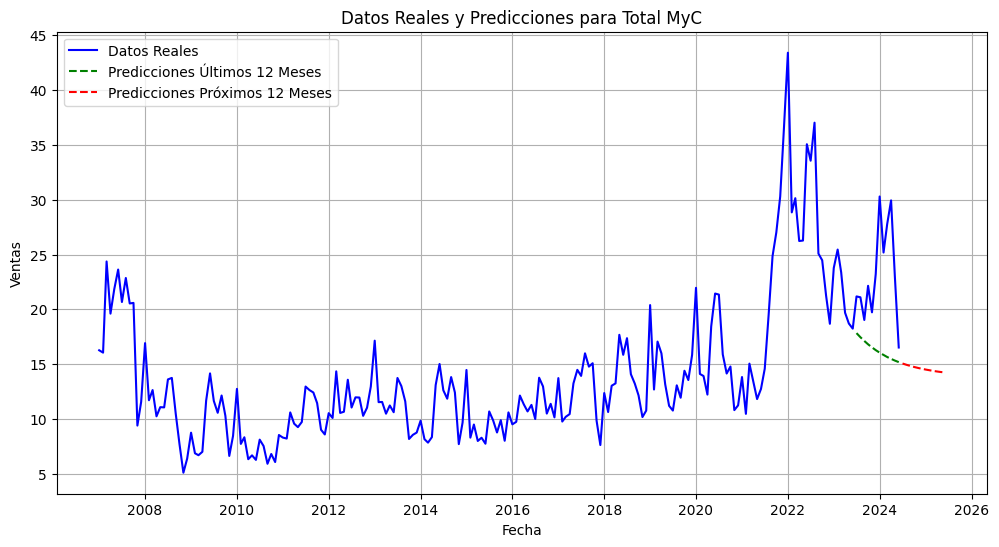

Métricas para Total M - Últimos 12 meses:
MSE: 53.38
MAE: 6.08
RMSE: 7.31
MAPE: 33.77%


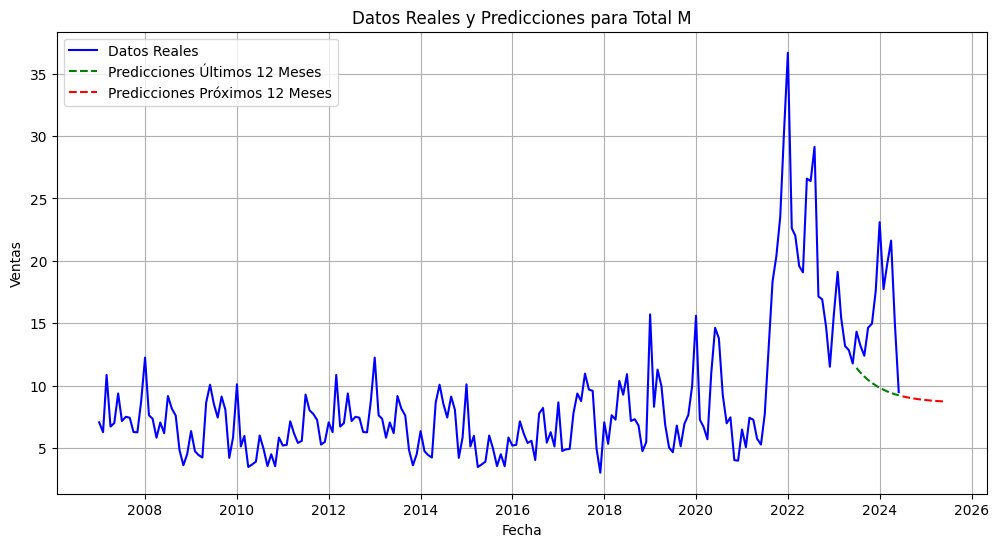

Métricas para Total C - Últimos 12 meses:
MSE: 2.79
MAE: 1.50
RMSE: 1.67
MAPE: 20.42%


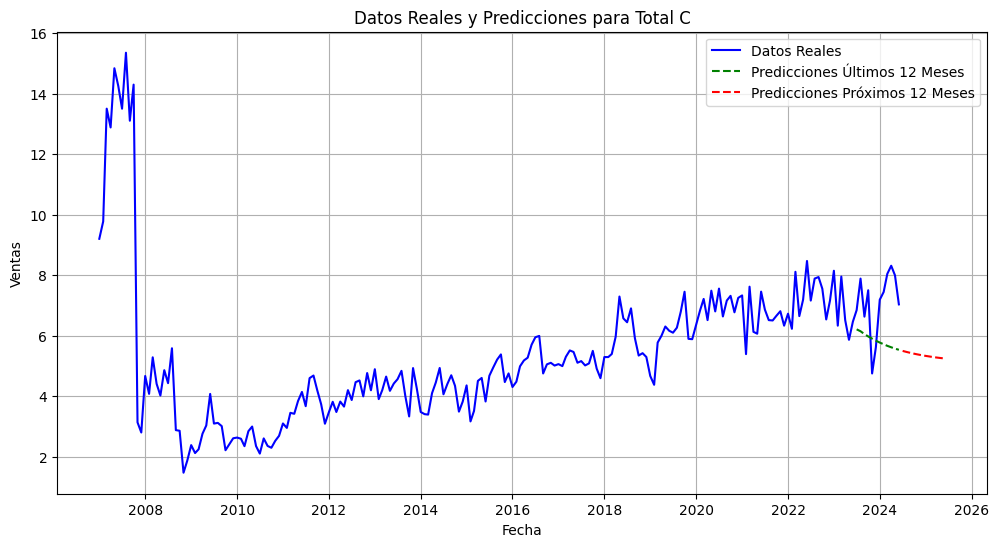

DataFrame con predicciones combinadas:
            AR Total MyC  AR Total M  AR Total C
2023-07-01     17.825740   11.418159    6.210742
2023-08-01     17.451177   11.047834    6.147699
2023-09-01     17.112018   10.732414    6.054201
2023-10-01     16.804389   10.457251    5.975920
2023-11-01     16.525455   10.217928    5.902505
2023-12-01     16.272521   10.009699    5.835474
2024-01-01     16.043168    9.828533    5.773895
2024-02-01     15.835196    9.670911    5.717405
2024-03-01     15.646612    9.533774    5.665566
2024-04-01     15.475609    9.414460    5.617999
2024-05-01     15.320548    9.310652    5.574352
2024-06-01     15.179942    9.220335    5.534300
2024-07-01     15.052444    9.141756    5.497549
2024-08-01     14.936832    9.073389    5.463827
2024-09-01     14.831999    9.013907    5.432882
2024-10-01     14.736938    8.962155    5.404488
2024-11-01     14.650739    8.917129    5.378433
2024-12-01     14.572576    8.877955    5.354525
2025-01-01     14.501700    8.

In [153]:
# Define las series temporales y sus etiquetas
series = ['Total MyC', 'Total M', 'Total C']
forecast_periods = 12

# DataFrame para almacenar todas las predicciones
all_predictions = pd.DataFrame()

# DataFrame para almacenar las métricas
metrics_df = pd.DataFrame(columns=['Serie', 'MAE (últimos 12 meses)', 'MSE (últimos 12 meses)', 
                                   'RMSE (últimos 12 meses)', 'MAPE (%) (últimos 12 meses)', 'AIC', 'BIC'])

for serie in series:
    # Divide los datos en entrenamiento y prueba
    train_size = len(df) - forecast_periods
    train = df[serie].asfreq('MS')[:train_size]
    test = df[serie].asfreq('MS')[train_size:]

    # Ajusta el modelo AR(2) con los datos de entrenamiento
    model = AutoReg(train, lags=2)
    model_fit = model.fit()

    # Predicción para los últimos 12 meses de datos (prueba)
    forecast_index_past = pd.date_range(start=df.index[train_size], periods=forecast_periods, freq='MS')
    predictions_past = model_fit.predict(start=len(train), end=len(train) + forecast_periods - 1, dynamic=False)

    # Comparar con datos reales
    mse_past = mean_squared_error(test, predictions_past)
    mae_past = mean_absolute_error(test, predictions_past)
    rmse_past = np.sqrt(mse_past)
    mape_past = np.mean(np.abs((test - predictions_past) / test)) * 100
    
    # Imprimir métricas para los últimos 12 meses
    print(f'Métricas para {serie} - Últimos 12 meses:')
    print(f'MSE: {mse_past:.2f}')
    print(f'MAE: {mae_past:.2f}')
    print(f'RMSE: {rmse_past:.2f}')
    print(f'MAPE: {mape_past:.2f}%')
    
    # Obtener AIC y BIC
    aic = model_fit.aic
    bic = model_fit.bic

    # Crear una fila con las métricas
    metrics_row = pd.DataFrame({
        'Serie': [f'AR {serie}'],
        'MAE (últimos 12 meses)': [mae_past],
        'MSE (últimos 12 meses)': [mse_past],
        'RMSE (últimos 12 meses)': [rmse_past],
        'MAPE (%) (últimos 12 meses)': [mape_past],
        'AIC': [aic],
        'BIC': [bic]
    })

    # Almacenar métricas en el DataFrame usando pd.concat
    metrics_df = pd.concat([metrics_df, metrics_row], ignore_index=True)
    
    # Predicción para los próximos 12 meses donde no hay datos
    forecast_index_future = pd.date_range(start=df.index[-1] + pd.DateOffset(months=1), periods=forecast_periods, freq='MS')
    predictions_future = model_fit.predict(start=len(df), end=len(df) + forecast_periods - 1, dynamic=False)

    # Crear DataFrames para las predicciones
    pred_df_past = pd.DataFrame(data={serie: predictions_past}, index=forecast_index_past)
    pred_df_future = pd.DataFrame(data={serie: predictions_future}, index=forecast_index_future)

    # Graficar datos reales, predicciones pasadas y predicciones futuras
    plt.figure(figsize=(12, 6))
    plt.plot(df.index, df[serie].asfreq('MS'), label='Datos Reales', color='blue')
    plt.plot(pred_df_past.index, pred_df_past[serie], label='Predicciones Últimos 12 Meses', color='green', linestyle='--')
    plt.plot(pred_df_future.index, pred_df_future[serie], label='Predicciones Próximos 12 Meses', color='red', linestyle='--')
    plt.xlabel('Fecha')
    plt.ylabel('Ventas')
    plt.title(f'Datos Reales y Predicciones para {serie}')
    plt.legend()
    plt.grid(True)
    plt.show()

    # Almacenar predicciones pasadas y futuras en el mismo DataFrame con nombres personalizados
    combined_predictions = pd.concat([pred_df_past, pred_df_future])
    combined_predictions = combined_predictions.rename(columns={serie: f'AR {serie}'})
    
    all_predictions = pd.concat([all_predictions, combined_predictions], axis=1)

# Mostrar el DataFrame con todas las predicciones
print("DataFrame con predicciones combinadas:")
print(all_predictions)

# Mostrar el DataFrame con las métricas
print("DataFrame con métricas:")
print(metrics_df)


In [154]:
metrics_df

,Serie,MAE (últimos 12 meses),MSE (últimos 12 meses),RMSE (últimos 12 meses),MAPE (%) (últimos 12 meses),AIC,BIC
0,AR Total MyC,6.966596,68.558026,8.279977,27.584206,1011.071454,1024.183912
1,AR Total M,6.080283,53.375722,7.305869,33.773058,968.597749,981.710207
2,AR Total C,1.499109,2.792504,1.671079,20.415953,591.176577,604.289036


## Autoarima

Performing stepwise search to minimize aic
 ARIMA(2,1,2)(0,0,0)[0] intercept   : AIC=1019.424, Time=0.31 sec
 ARIMA(0,1,0)(0,0,0)[0] intercept   : AIC=1029.972, Time=0.00 sec
 ARIMA(1,1,0)(0,0,0)[0] intercept   : AIC=1022.231, Time=0.05 sec
 ARIMA(0,1,1)(0,0,0)[0] intercept   : AIC=1020.717, Time=0.07 sec
 ARIMA(0,1,0)(0,0,0)[0]             : AIC=1027.973, Time=0.02 sec
 ARIMA(1,1,2)(0,0,0)[0] intercept   : AIC=1017.589, Time=0.15 sec
 ARIMA(0,1,2)(0,0,0)[0] intercept   : AIC=1021.241, Time=0.05 sec
 ARIMA(1,1,1)(0,0,0)[0] intercept   : AIC=1017.951, Time=0.06 sec
 ARIMA(1,1,3)(0,0,0)[0] intercept   : AIC=1019.501, Time=0.26 sec
 ARIMA(0,1,3)(0,0,0)[0] intercept   : AIC=1020.053, Time=0.11 sec
 ARIMA(2,1,1)(0,0,0)[0] intercept   : AIC=1017.467, Time=0.10 sec
 ARIMA(2,1,0)(0,0,0)[0] intercept   : AIC=1023.401, Time=0.04 sec
 ARIMA(3,1,1)(0,0,0)[0] intercept   : AIC=1019.427, Time=0.17 sec
 ARIMA(3,1,0)(0,0,0)[0] intercept   : AIC=1023.800, Time=0.05 sec
 ARIMA(3,1,2)(0,0,0)[0] intercept

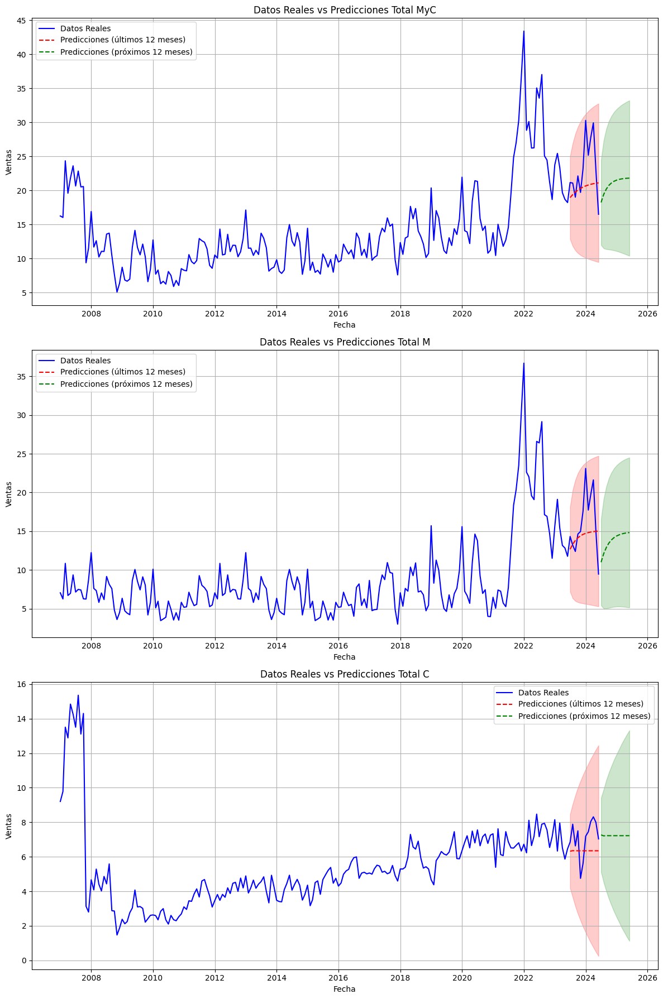

Parámetros del Modelo Ajustado:
                 Serie  p  d  q  P  D  Q  s
0  Autoarima Total MyC  2  1  1  0  0  0  0
1    Autoarima Total M  1  1  1  0  0  0  0
2    Autoarima Total C  1  1  0  0  0  0  0


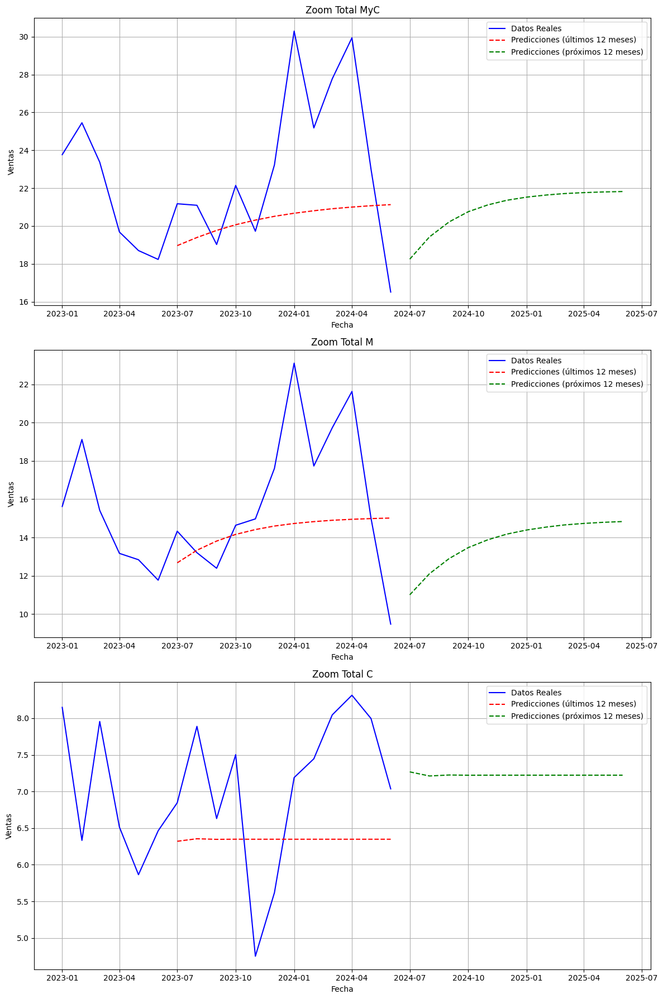

,Serie,MAE (últimos 12 meses),MSE (últimos 12 meses),RMSE (últimos 12 meses),MAPE (%) (últimos 12 meses),AIC,BIC
2,Autoarima Total C,1.150000,1.580000,1.260000,16.240000,635.110000,641.790000
1,Autoarima Total M,2.970000,15.950000,3.990000,17.880000,1036.060000,1046.090000
0,Autoarima Total MyC,3.860000,23.670000,4.860000,15.540000,1084.790000,1094.820000


In [155]:
# Configuración de las gráficas
fig, axes = plt.subplots(nrows=3, ncols=1, figsize=(12, 18))

# Listas para almacenar métricas y parámetros
metrics = []
model_params = []

# Definir una función para modelar, predecir, calcular métricas y graficar
def model_and_evaluate(series, title, ax, series_name):
    # Dividir los datos en entrenamiento y prueba
    n_train = len(series) - 12
    train, test = series[:n_train], series[n_train:]
    
    # Ajustar el modelo automáticamente con datos históricos
    model = auto_arima(train, seasonal=False, stepwise=True, trace=True,
                        suppress_warnings=True, error_action='ignore')
    
    # Mostrar el resumen del modelo seleccionado
    print(model.summary())
    
    # Extraer los parámetros del modelo
    model_params.append({
        'Serie': series_name,
        'p': model.order[0],
        'd': model.order[1],
        'q': model.order[2],
        'P': model.seasonal_order[0],
        'D': model.seasonal_order[1],
        'Q': model.seasonal_order[2],
        's': model.seasonal_order[3]
    })
    
    # Realizar predicciones para los últimos 12 meses
    forecast, conf_int = model.predict(n_periods=12, return_conf_int=True)
    forecast_index = pd.date_range(start=train.index[-1] + pd.DateOffset(months=1), periods=12, freq='MS')
    forecast_df = pd.DataFrame(data={'Forecast': forecast}, index=forecast_index)
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(test, forecast)
    mse = mean_squared_error(test, forecast)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((test - forecast) / test)) * 100
    
    # Realizar predicciones para los próximos 12 meses
    model_full = auto_arima(series, seasonal=False, stepwise=True, trace=True,
                            suppress_warnings=True, error_action='ignore')
    future_forecast, future_conf_int = model_full.predict(n_periods=12, return_conf_int=True)
    future_forecast_index = pd.date_range(start=series.index[-1] + pd.DateOffset(months=1), periods=12, freq='MS')
    future_forecast_df = pd.DataFrame(data={'Forecast': future_forecast}, index=future_forecast_index)
    
    # Obtener AIC y BIC del modelo ajustado con todos los datos
    aic = model_full.aic()
    bic = model_full.bic()
    
    metrics.append({
        'Serie': series_name,
        'MAE (últimos 12 meses)': round(mae, 2),
        'MSE (últimos 12 meses)': round(mse, 2),
        'RMSE (últimos 12 meses)': round(rmse, 2),
        'MAPE (%) (últimos 12 meses)': round(mape, 2),
        'AIC': round(aic, 2),
        'BIC': round(bic, 2)
    })
    
    # Graficar los datos reales y las predicciones
    ax.plot(series.index, series, label='Datos Reales', color='blue')
    ax.plot(forecast_df.index, forecast_df['Forecast'], label='Predicciones (últimos 12 meses)', color='red', linestyle='--')
    ax.fill_between(forecast_df.index, conf_int[:, 0], conf_int[:, 1], color='red', alpha=0.2)
    ax.plot(future_forecast_df.index, future_forecast_df['Forecast'], label='Predicciones (próximos 12 meses)', color='green', linestyle='--')
    ax.fill_between(future_forecast_df.index, future_conf_int[:, 0], future_conf_int[:, 1], color='green', alpha=0.2)
    ax.set_xlabel('Fecha')
    ax.set_ylabel('Ventas')
    ax.set_title(title)
    ax.legend()
    ax.grid(True)

    return forecast_df, future_forecast_df  # Devolver los DataFrames de predicción

# Preparar y graficar para cada serie temporal
forecast_df_MyC, future_forecast_df_MyC = model_and_evaluate(df['Total MyC'], 'Datos Reales vs Predicciones Total MyC', axes[0], 'Autoarima Total MyC')
forecast_df_M, future_forecast_df_M = model_and_evaluate(df['Total M'], 'Datos Reales vs Predicciones Total M', axes[1], 'Autoarima Total M')
forecast_df_C, future_forecast_df_C = model_and_evaluate(df['Total C'], 'Datos Reales vs Predicciones Total C', axes[2], 'Autoarima Total C')

# Mostrar todas las gráficas
plt.tight_layout()
plt.show()

# Crear un DataFrame con las métricas
metrics_df = pd.DataFrame(metrics)

# Ordenar el DataFrame por MAE, luego MSE, luego RMSE, y finalmente MAPE
metrics_df = metrics_df.sort_values(by=['MAE (últimos 12 meses)', 'MSE (últimos 12 meses)', 'RMSE (últimos 12 meses)', 'MAPE (%) (últimos 12 meses)'])

# Función para resaltar los mejores valores
def highlight_best(s):
    is_min = s == s.min()
    return ['font-weight: bold; color: green' if v else '' for v in is_min]

# Aplicar el estilo al DataFrame
styled_df = metrics_df.style.apply(highlight_best, subset=['MAE (últimos 12 meses)', 'MSE (últimos 12 meses)', 'RMSE (últimos 12 meses)', 'MAPE (%) (últimos 12 meses)'])

# Mostrar la tabla estilizada
#styled_df

# Crear un DataFrame con los parámetros del modelo
model_params_df = pd.DataFrame(model_params)

# Mostrar el DataFrame con los parámetros del modelo
print("Parámetros del Modelo Ajustado:")
print(model_params_df)

# Bloque para hacer zoom en el rango de fechas especificado
def zoom_plot(series, forecast_df, future_forecast_df, ax, zoom_start, zoom_end, title):
    # Filtrar datos para el rango de fechas especificado
    zoomed_series = series.loc[zoom_start:zoom_end]
    zoomed_forecast_df = forecast_df.loc[zoom_start:zoom_end]
    zoomed_future_forecast_df = future_forecast_df.loc[zoom_start:zoom_end]
    
    # Graficar los datos filtrados
    ax.plot(zoomed_series.index, zoomed_series, label='Datos Reales', color='blue')
    if not zoomed_forecast_df.empty:
        ax.plot(zoomed_forecast_df.index, zoomed_forecast_df['Forecast'], label='Predicciones (últimos 12 meses)', color='red', linestyle='--')
    if not zoomed_future_forecast_df.empty:
        ax.plot(zoomed_future_forecast_df.index, zoomed_future_forecast_df['Forecast'], label='Predicciones (próximos 12 meses)', color='green', linestyle='--')
    ax.set_xlabel('Fecha')
    ax.set_ylabel('Ventas')
    ax.set_title(title)
    ax.legend()
    ax.grid(True)

# Crear una figura adicional para el zoom
fig_zoom, axes_zoom = plt.subplots(nrows=3, ncols=1, figsize=(12, 18))

# Definir el rango de fechas para el zoom
zoom_start = '2023-01-01'
zoom_end = '2025-06-30'

# Aplicar el zoom a cada serie temporal
zoom_plot(df['Total MyC'], forecast_df_MyC, future_forecast_df_MyC, axes_zoom[0], zoom_start, zoom_end, 'Zoom Total MyC')
zoom_plot(df['Total M'], forecast_df_M, future_forecast_df_M, axes_zoom[1], zoom_start, zoom_end, 'Zoom Total M')
zoom_plot(df['Total C'], forecast_df_C, future_forecast_df_C, axes_zoom[2], zoom_start, zoom_end, 'Zoom Total C')

# Mostrar las gráficas de zoom
plt.tight_layout()
plt.show()

# Mostrar la tabla estilizada
styled_df


In [156]:
# Crear DataFrames de ejemplo (usa los DataFrames de predicciones que tienes)
# Suponiendo que forecast_df_MyC, future_forecast_df_MyC, forecast_df_M, future_forecast_df_M, forecast_df_C, future_forecast_df_C ya están definidos

# Concatenar los DataFrames de predicciones para los últimos 12 meses y los próximos 12 meses
combined_forecast_df = pd.concat([
    forecast_df_MyC.rename(columns={'Forecast': 'Autoarima Total MyC'}),
    forecast_df_M.rename(columns={'Forecast': 'Autoarima Total M'}),
    forecast_df_C.rename(columns={'Forecast': 'Autoarima Total C'})
], axis=1)

# Concatenar los DataFrames de predicciones para los próximos 12 meses
combined_future_forecast_df = pd.concat([
    future_forecast_df_MyC.rename(columns={'Forecast': 'Autoarima Total MyC'}),
    future_forecast_df_M.rename(columns={'Forecast': 'Autoarima Total M'}),
    future_forecast_df_C.rename(columns={'Forecast': 'Autoarima Total C'})
], axis=1)

# Unir los DataFrames de predicciones
combined_df = pd.concat([combined_forecast_df, combined_future_forecast_df])

# Restablecer el índice y crear la columna 'Mes'
combined_df.reset_index(inplace=True)
combined_df.rename(columns={'index': 'Mes'}, inplace=True)

# Opcional: Convertir la columna 'Mes' a un formato de fecha si es necesario
combined_df['Mes'] = pd.to_datetime(combined_df['Mes'], format='%Y-%m')

# Ajustar la configuración para mostrar todas las filas y columnas
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

# Guardar el DataFrame en un archivo CSV si lo deseas
combined_df.to_csv('predicciones_combinadas.csv', index=False)


In [157]:
combined_df

,Mes,Autoarima Total MyC,Autoarima Total M,Autoarima Total C
0,2023-07-01,18.964758,12.677747,6.320575
1,2023-08-01,19.394502,13.336038,6.354819
2,2023-09-01,19.768095,13.814505,6.346633
3,2023-10-01,20.068485,14.162271,6.348590
4,2023-11-01,20.313370,14.415038,6.348122
5,2023-12-01,20.512507,14.598759,6.348234
6,2024-01-01,20.674517,14.732292,6.348207
7,2024-02-01,20.806309,14.829349,6.348213
8,2024-03-01,20.913523,14.899893,6.348212
9,2024-04-01,21.000741,14.951167,6.348212


## Long Short Term Memory (LSTM)

### Modelo 1 LSTM


Procesando variable: Total MyC


C:\Users\CDIBONO\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
Total MyC_LSTM - MAE: 3.98, MSE: 23.87, RMSE: 4.89, MAPE: 17.86%, AIC: 61340.07, BIC: 76202.95


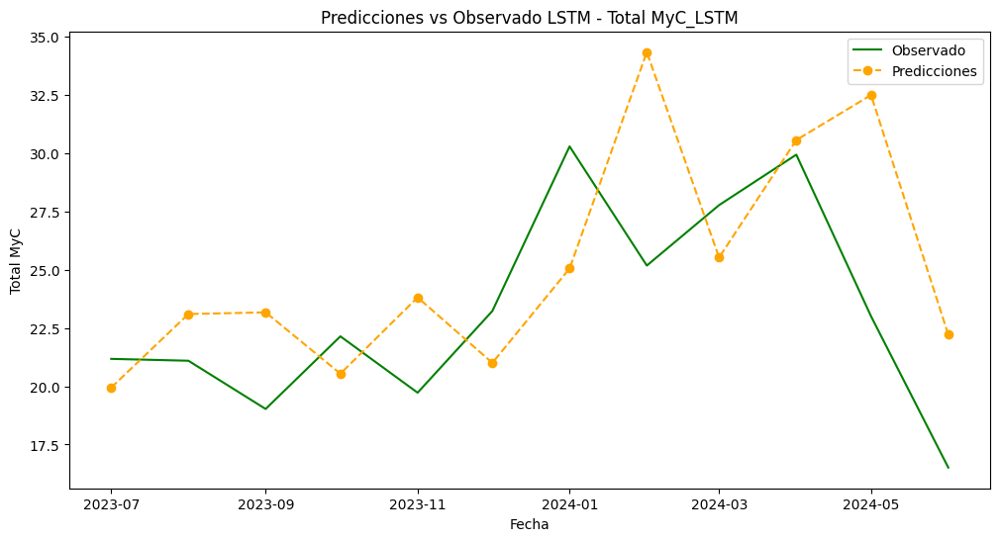


Procesando variable: Total M


C:\Users\CDIBONO\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 225ms/step
Total M_LSTM - MAE: 5.25, MSE: 38.53, RMSE: 6.21, MAPE: 31.01%, AIC: 61345.82, BIC: 76208.69


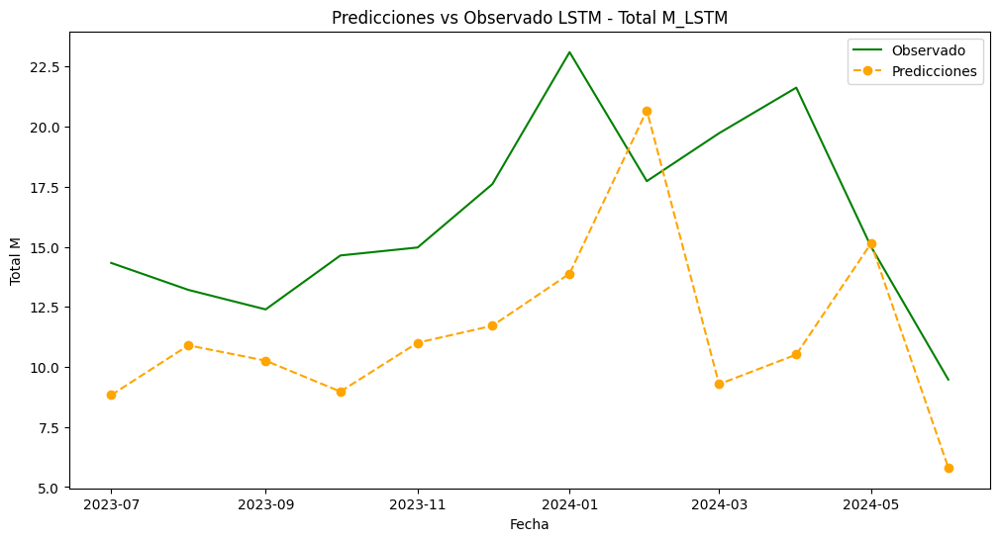


Procesando variable: Total C


C:\Users\CDIBONO\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 208ms/step
Total C_LSTM - MAE: 1.09, MSE: 1.61, RMSE: 1.27, MAPE: 15.59%, AIC: 61307.73, BIC: 76170.60


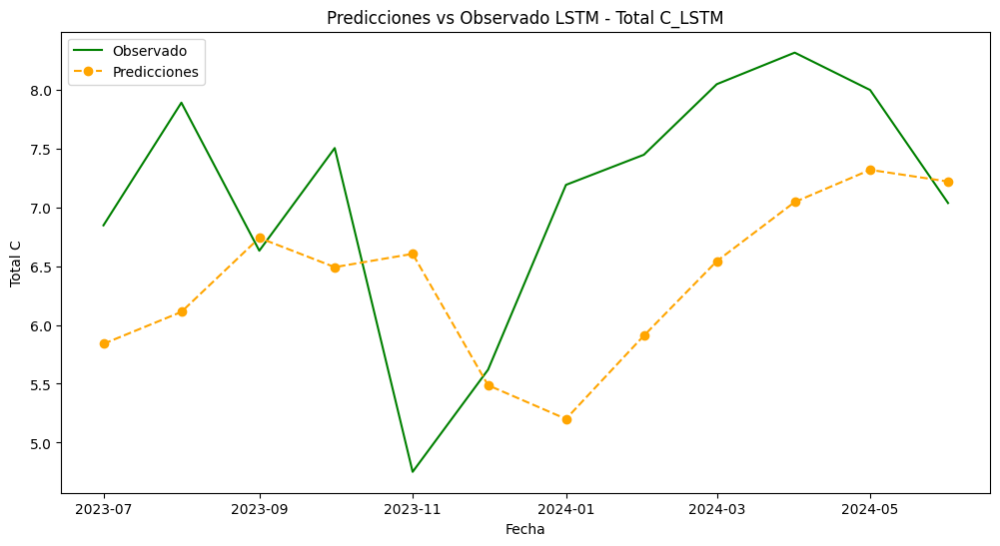

                     MAE        MSE      RMSE       MAPE           AIC  \
Total MyC_LSTM  3.981181  23.871962  4.885894  17.862972  61340.072455   
Total M_LSTM    5.248395  38.526019  6.206933  31.007555  61345.816006   
Total C_LSTM    1.087383   1.611718  1.269535  15.585535  61307.727609   

                         BIC  
Total MyC_LSTM  76202.946178  
Total M_LSTM    76208.689729  
Total C_LSTM    76170.601331  


In [158]:
# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)

# Asegurarse de que el índice tenga una frecuencia establecida
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 12

# Modelo LSTM
def build_lstm_model(seq_length):
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(seq_length, 1)))
    model.add(LSTM(50))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.01), loss='mean_squared_error')
    return model

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    # Construir y entrenar el modelo LSTM
    model = build_lstm_model(SEQ_LENGTH)
    model.fit(X_train, y_train, epochs=20, batch_size=16, validation_split=0.1, verbose=0)
    
    # Hacer predicciones
    predictions = model.predict(X_test)
    predictions = scaler.inverse_transform(predictions)
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento
    mae = mean_absolute_error(y_test, predictions)
    mse = mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo
    k = model.count_params()
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_LSTM"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Imprimir métricas
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Visualizar las predicciones
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions):].to_timestamp(), predictions, label='Predicciones', linestyle='dashed', marker='o', color='orange')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones vs Observado LSTM - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)


### Otro no usado finalmente


Procesando variable: Total MyC


C:\Users\CDIBONO\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 185ms/step
Total MyC_LSTM - MAE: 4.49, MSE: 29.75, RMSE: 5.45, MAPE: 18.08%, AIC: 61342.71, BIC: 76205.59
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 250ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


C:\Users\CDIBONO\AppData\Local\Temp\ipykernel_7996\658430444.py:119: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



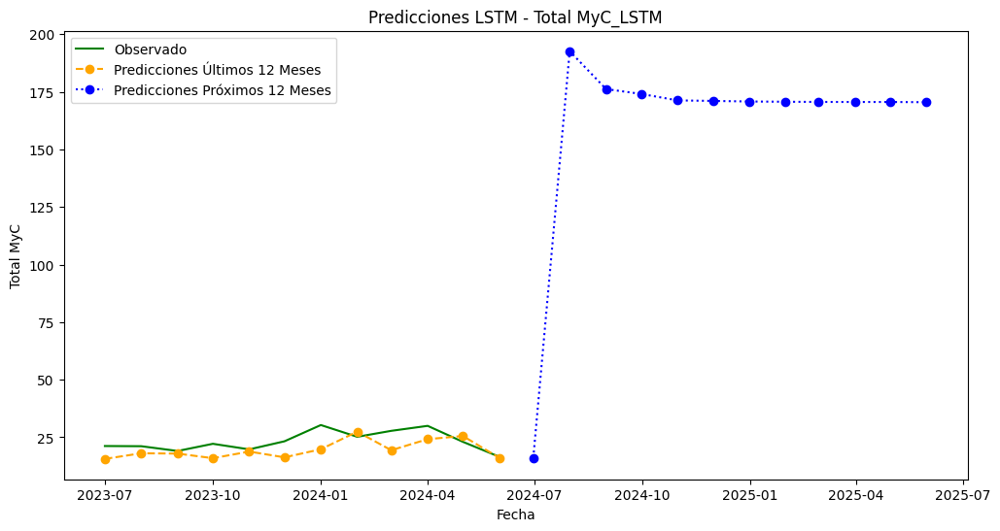


Procesando variable: Total M


C:\Users\CDIBONO\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
Total M_LSTM - MAE: 5.29, MSE: 35.11, RMSE: 5.93, MAPE: 31.77%, AIC: 61344.70, BIC: 76207.58
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 260ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step


C:\Users\CDIBONO\AppData\Local\Temp\ipykernel_7996\658430444.py:119: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



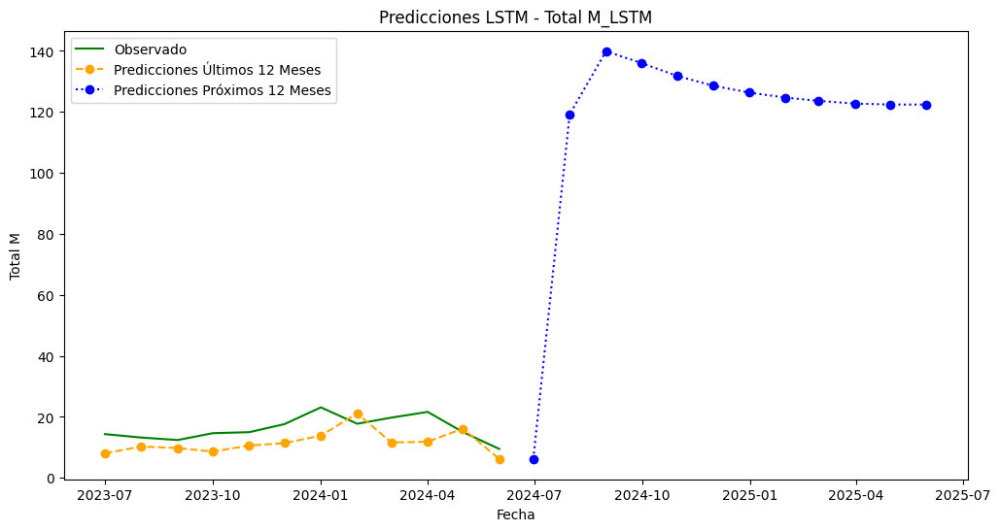


Procesando variable: Total C


C:\Users\CDIBONO\AppData\Local\Packages\PythonSoftwareFoundation.Python.3.11_qbz5n2kfra8p0\LocalCache\local-packages\Python311\site-packages\keras\src\layers\rnn\rnn.py:204: UserWarning:

Do not pass an `input_shape`/`input_dim` argument to a layer. When using Sequential models, prefer using an `Input(shape)` object as the first layer in the model instead.



1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
Total C_LSTM - MAE: 0.93, MSE: 1.20, RMSE: 1.10, MAPE: 13.99%, AIC: 61304.22, BIC: 76167.10
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 183ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step


C:\Users\CDIBONO\AppData\Local\Temp\ipykernel_7996\658430444.py:119: FutureWarning:

'M' is deprecated and will be removed in a future version, please use 'ME' instead.



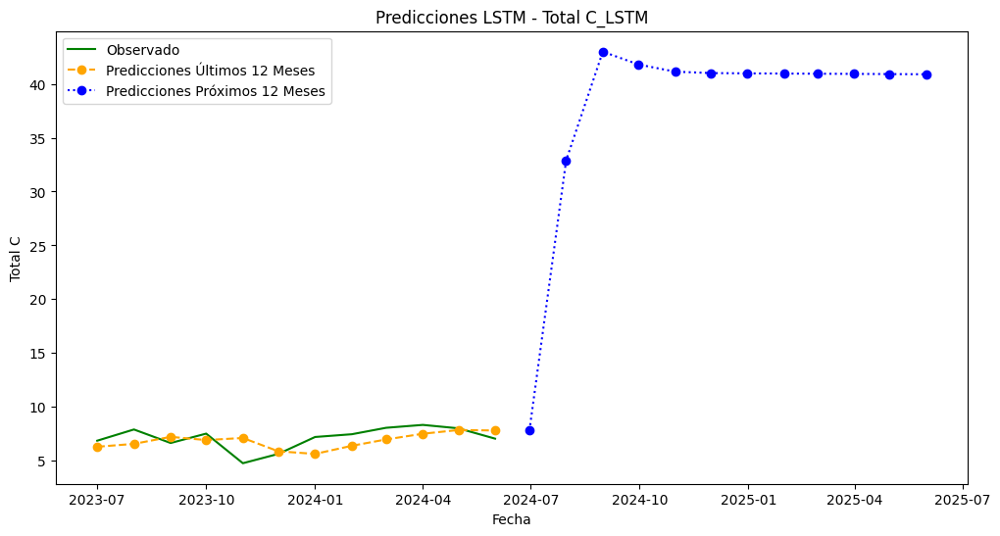

                     MAE        MSE      RMSE       MAPE           AIC  \
Total MyC_LSTM  4.491946  29.748822  5.454248  18.079616  61342.713474   
Total M_LSTM    5.294727  35.111346  5.925483  31.769738  61344.702292   
Total C_LSTM    0.927712   1.203556  1.097067  13.993737  61304.223366   

                         BIC  
Total MyC_LSTM  76205.587197  
Total M_LSTM    76207.576015  
Total C_LSTM    76167.097089  


In [159]:
# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)

# Asegurarse de que el índice tenga una frecuencia establecida
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 12

# Modelo LSTM
def build_lstm_model(seq_length):
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(seq_length, 1)))
    model.add(LSTM(50))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.01), loss='mean_squared_error')
    return model

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    # Construir y entrenar el modelo LSTM
    model = build_lstm_model(SEQ_LENGTH)
    model.fit(X_train, y_train, epochs=20, batch_size=16, validation_split=0.1, verbose=0)
    
    # Predicciones sobre los últimos 12 meses
    predictions_last_12 = model.predict(X_test)
    predictions_last_12 = scaler.inverse_transform(predictions_last_12)
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12)
    mse = mean_squared_error(y_test, predictions_last_12)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo
    k = model.count_params()
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_LSTM"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Predicciones sobre los siguientes 12 meses
    future_predictions = []
    last_sequence = X_test[-1]
    
    for _ in range(12):
        # Predecir el próximo valor
        next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH, 1))
        
        # Desnormalizar la predicción
        next_prediction = scaler.inverse_transform(next_prediction)
        
        # Agregar la predicción a la lista de predicciones futuras
        future_predictions.append(next_prediction[0, 0])
        
        # Actualizar la secuencia: descartar el primer valor y agregar la nueva predicción
        last_sequence = np.append(last_sequence[1:], next_prediction).reshape(SEQ_LENGTH, 1)
    
    # Almacenar las predicciones futuras
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions).reshape(-1, 1)
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12):].to_timestamp(), predictions_last_12, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones LSTM - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)


### Modelo 2 LSTM


Procesando variable: Total MyC
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 238ms/step
Total MyC_LSTM - MAE: 3.95, MSE: 21.20, RMSE: 4.60, MAPE: 15.94%, AIC: 61338.65, BIC: 76201.52
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 213ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step


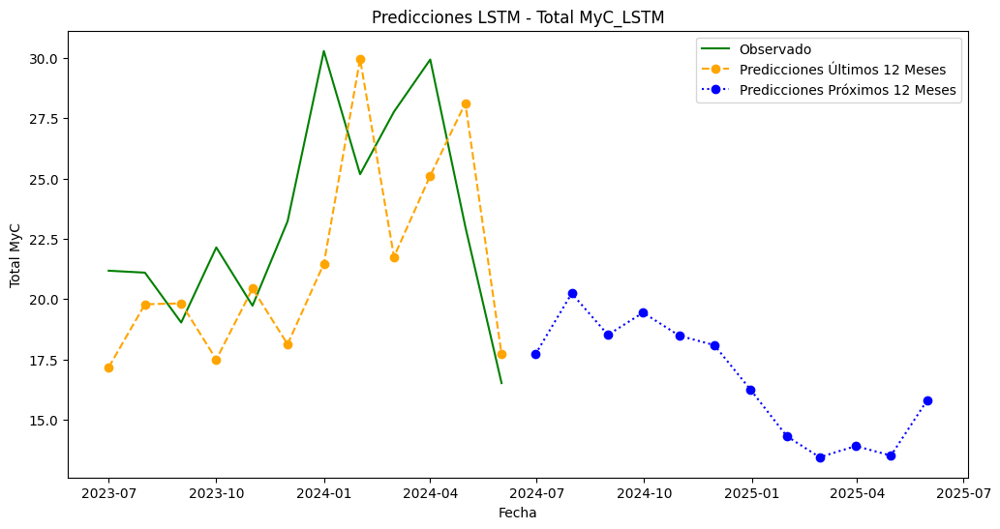


Procesando variable: Total M
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 181ms/step
Total M_LSTM - MAE: 5.11, MSE: 36.23, RMSE: 6.02, MAPE: 29.90%, AIC: 61345.08, BIC: 76207.95
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 286ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step


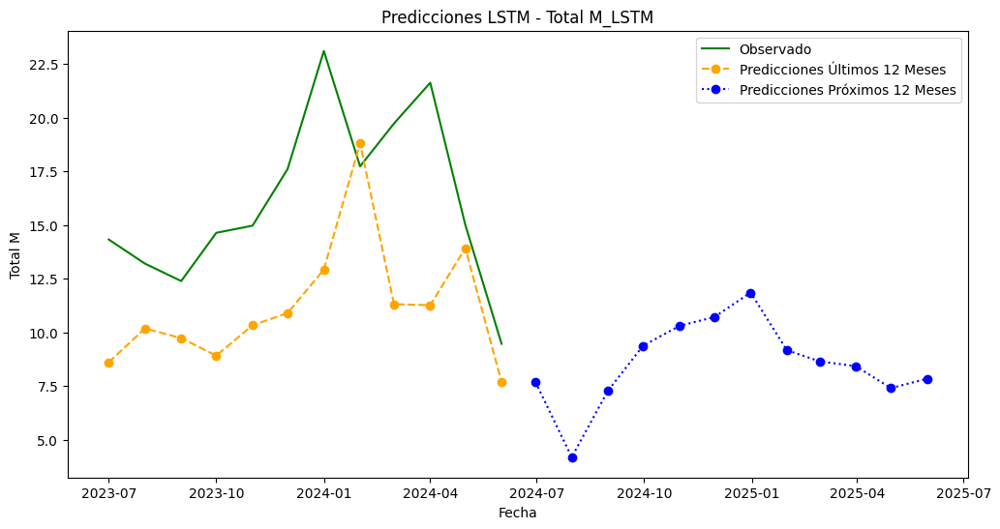


Procesando variable: Total C
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 198ms/step
Total C_LSTM - MAE: 0.95, MSE: 1.25, RMSE: 1.12, MAPE: 14.20%, AIC: 61304.65, BIC: 76167.53
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 211ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 11ms/step


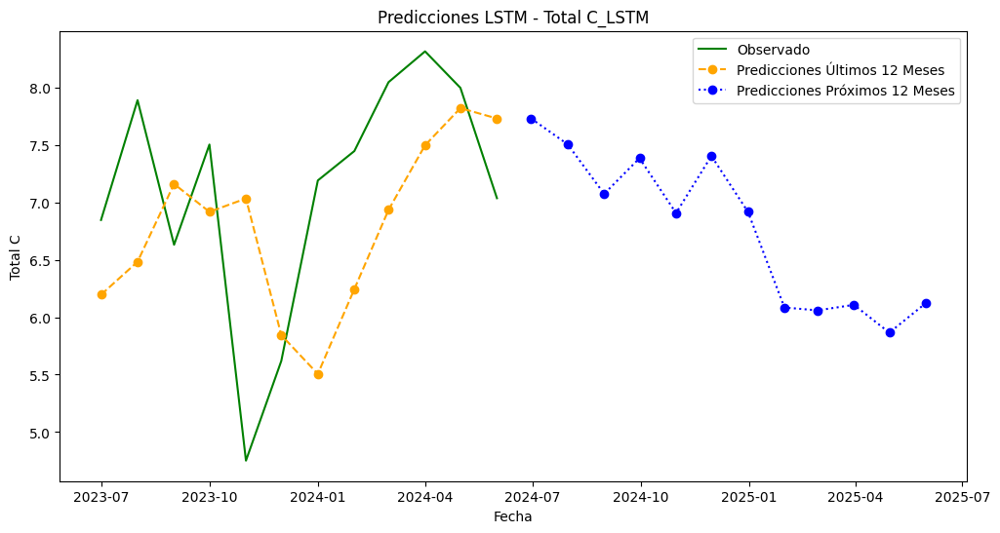

                     MAE        MSE      RMSE       MAPE           AIC  \
Total MyC_LSTM  3.945016  21.203116  4.604684  15.941133  61338.649778   
Total M_LSTM    5.109515  36.233937  6.019463  29.900764  61345.079954   
Total C_LSTM    0.946680   1.247586  1.116954  14.197029  61304.654526   

                         BIC  
Total MyC_LSTM  76201.523500  
Total M_LSTM    76207.953677  
Total C_LSTM    76167.528249  


In [160]:
warnings.filterwarnings("ignore")

# Fijar las semillas
np.random.seed(10)
tf.random.set_seed(10)
random.seed(10)


# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)

# Asegurarse de que el índice tenga una frecuencia establecida
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 12

# Modelo LSTM
def build_lstm_model(seq_length):
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(seq_length, 1)))
    model.add(LSTM(50))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.01), loss='mean_squared_error')
    return model

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    # Construir y entrenar el modelo LSTM
    model = build_lstm_model(SEQ_LENGTH)
    model.fit(X_train, y_train, epochs=20, batch_size=16, validation_split=0.1, verbose=0)
    
    # Predicciones sobre los últimos 12 meses
    predictions_last_12 = model.predict(X_test)
    predictions_last_12 = scaler.inverse_transform(predictions_last_12)
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12)
    mse = mean_squared_error(y_test, predictions_last_12)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo
    k = model.count_params()
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_LSTM"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Predicciones sobre los siguientes 12 meses con reentrenamiento progresivo
    future_predictions = []
    last_sequence = X_test[-1]
    
    for i in range(12):
        # Predecir el próximo valor
        next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH, 1))
        
        # Desnormalizar la predicción
        next_prediction = scaler.inverse_transform(next_prediction)
        
        # Agregar la predicción a la lista de predicciones futuras
        future_predictions.append(next_prediction[0, 0])
        
        # Actualizar la secuencia: descartar el primer valor y agregar la nueva predicción
        last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
        
        # Reentrenar el modelo con la nueva secuencia agregada a los datos de entrenamiento
        X_train = np.append(X_train, last_sequence.reshape(1, SEQ_LENGTH, 1), axis=0)
        y_train = np.append(y_train, scaler.transform(next_prediction).reshape(-1, 1), axis=0)
        
        model.fit(X_train, y_train, epochs=1, batch_size=16, verbose=0)

    # Almacenar las predicciones futuras
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions).reshape(-1, 1)
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12):].to_timestamp(), predictions_last_12, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones LSTM - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)


### Modelo 3 LSTM


Procesando variable: Total MyC
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 207ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 334ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 9ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 218ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━

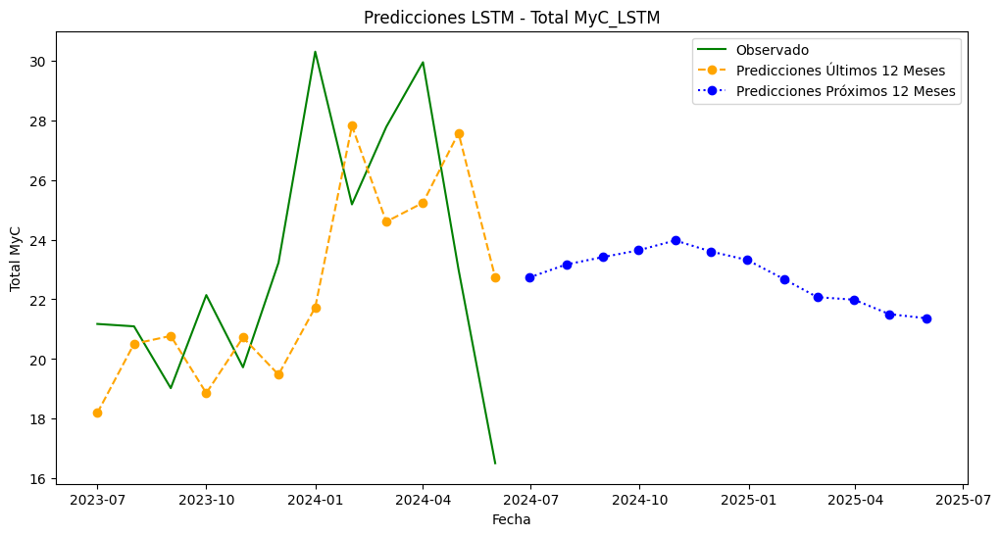


Procesando variable: Total M
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 282ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 248ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━

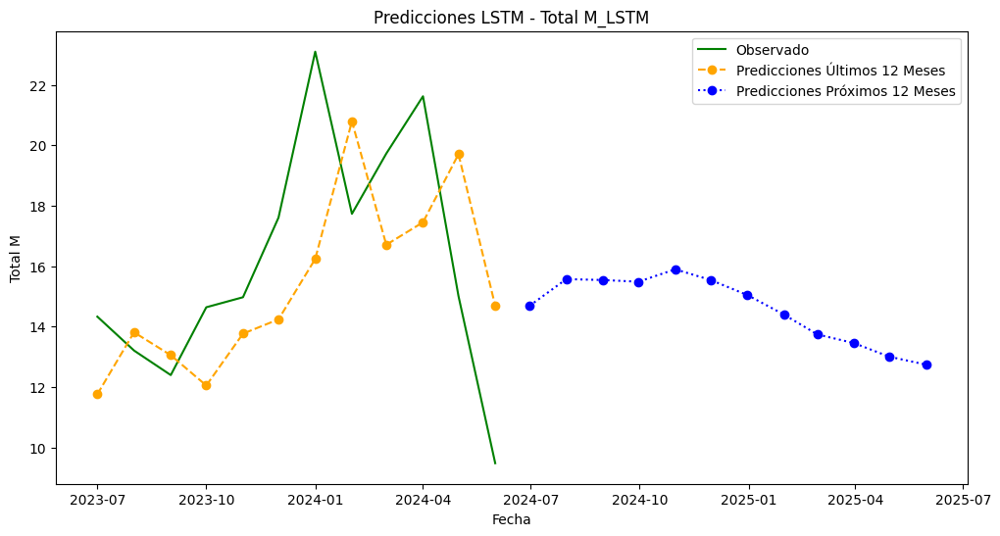


Procesando variable: Total C
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 291ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 226ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 205ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 269ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━

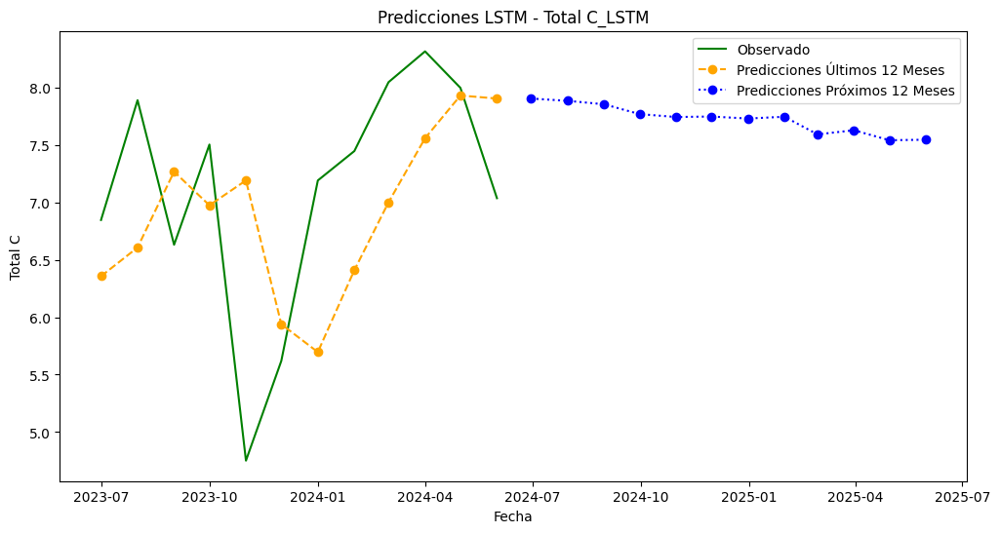

                     MAE        MSE      RMSE       MAPE           AIC  \
Total MyC_LSTM  3.600596  17.510540  4.184560  15.455461  61336.353636   
Total M_LSTM    3.168782  13.263849  3.641957  20.048459  61333.020506   
Total C_LSTM    0.913297   1.195186  1.093246  13.915249  61304.139621   

                         BIC  
Total MyC_LSTM  76199.227358  
Total M_LSTM    76195.894229  
Total C_LSTM    76167.013344  


In [161]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 12

# Función para construir el modelo LSTM
def build_lstm_model(seq_length):
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(seq_length, 1)))
    model.add(LSTM(50))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.01), loss='mean_squared_error')
    return model

# Número de ejecuciones para promediar
num_runs = 23

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        set_seeds(run)
        
        # Construir y entrenar el modelo LSTM
        model = build_lstm_model(SEQ_LENGTH)
        model.fit(X_train, y_train, epochs=20, batch_size=16, validation_split=0.1, verbose=0)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test)
        predictions_last_12 = scaler.inverse_transform(predictions_last_12)
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses con reentrenamiento progresivo
        future_predictions = []
        last_sequence = X_test[-1]
        
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH, 1))
            next_prediction = scaler.inverse_transform(next_prediction)
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
            X_train = np.append(X_train, last_sequence.reshape(1, SEQ_LENGTH, 1), axis=0)
            y_train = np.append(y_train, scaler.transform(next_prediction).reshape(-1, 1), axis=0)
            model.fit(X_train, y_train, epochs=1, batch_size=16, verbose=0)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
    future_predictions_avg = np.mean(all_future_predictions, axis=0)
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo
    k = model.count_params()
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_LSTM"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12_avg
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones LSTM - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)


### Modelo 3 LSTM (con guardado de predicciones)


Procesando variable: Total MyC
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 549ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 545ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 595ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━

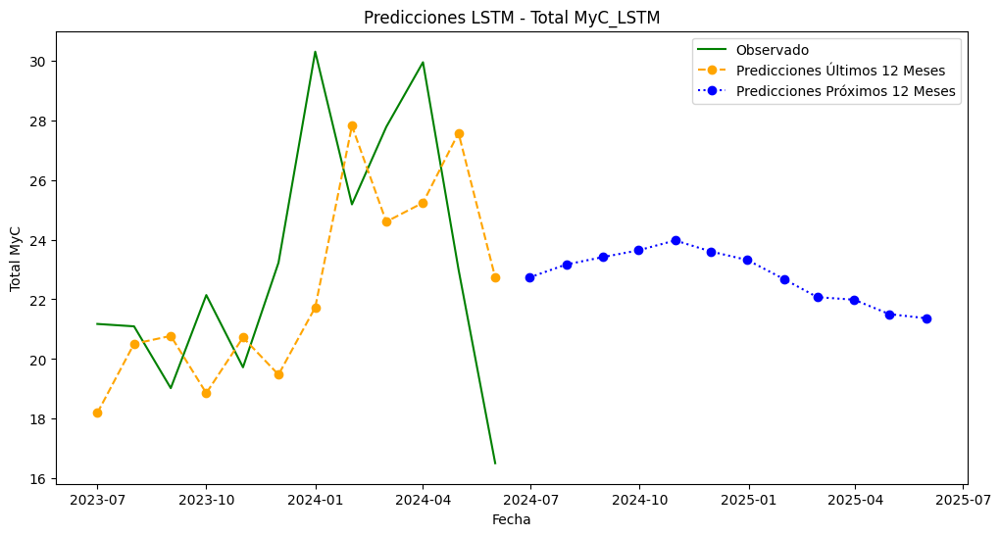


Procesando variable: Total M
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 500ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 559ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 594ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 641ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━

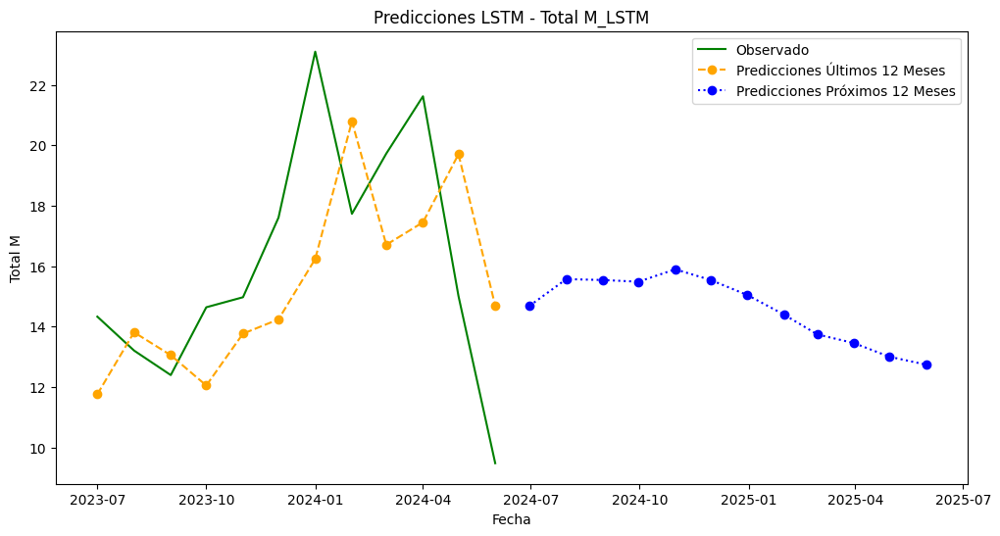


Procesando variable: Total C
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 442ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━

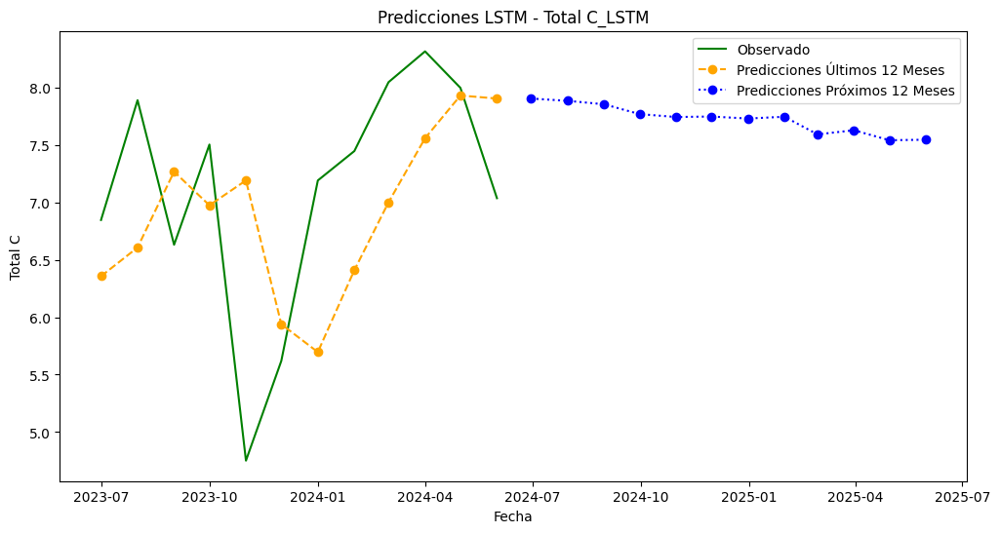

                     MAE        MSE      RMSE       MAPE           AIC  \
Total MyC_LSTM  3.600596  17.510540  4.184560  15.455461  61336.353636   
Total M_LSTM    3.168782  13.263849  3.641957  20.048459  61333.020506   
Total C_LSTM    0.913297   1.195186  1.093246  13.915249  61304.139621   

                         BIC  
Total MyC_LSTM  76199.227358  
Total M_LSTM    76195.894229  
Total C_LSTM    76167.013344  


In [162]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 12

# Función para construir el modelo LSTM
def build_lstm_model(seq_length):
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(seq_length, 1)))
    model.add(LSTM(50))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.01), loss='mean_squared_error')
    return model

# Número de ejecuciones para promediar
num_runs = 23

# Crear un DataFrame para almacenar todas las predicciones
all_predictions_df = pd.DataFrame(index=pd.date_range(start=df.index[-len(y_test):][0].to_timestamp(), periods=24, freq='M'))

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        set_seeds(run)
        
        # Construir y entrenar el modelo LSTM
        model = build_lstm_model(SEQ_LENGTH)
        model.fit(X_train, y_train, epochs=20, batch_size=16, validation_split=0.1, verbose=0)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test)
        predictions_last_12 = scaler.inverse_transform(predictions_last_12)
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses con reentrenamiento progresivo
        future_predictions = []
        last_sequence = X_test[-1]
        
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH, 1))
            next_prediction = scaler.inverse_transform(next_prediction)
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
            X_train = np.append(X_train, last_sequence.reshape(1, SEQ_LENGTH, 1), axis=0)
            y_train = np.append(y_train, scaler.transform(next_prediction).reshape(-1, 1), axis=0)
            model.fit(X_train, y_train, epochs=1, batch_size=16, verbose=0)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0).flatten()
    future_predictions_avg = np.mean(all_future_predictions, axis=0).flatten()
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    
    # Almacenar las predicciones en el DataFrame
    adjusted_var_name = f"{var}_LSTM"
    all_predictions_df[f'{adjusted_var_name}_Observed'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Observed'].iloc[:len(y_test)] = y_test
    all_predictions_df[f'{adjusted_var_name}_Last_12_Months'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Last_12_Months'].iloc[:len(predictions_last_12_avg)] = predictions_last_12_avg
    all_predictions_df[f'{adjusted_var_name}_Future_12_Months'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Future_12_Months'].iloc[len(predictions_last_12_avg):] = future_predictions_avg
    
    # Imprimir las predicciones para revisión
    print(f'{adjusted_var_name} - Predicciones Últimos 12 Meses:')
    print(all_predictions_df[[f'{adjusted_var_name}_Observed', f'{adjusted_var_name}_Last_12_Months']].dropna())
    
    print(f'{adjusted_var_name} - Predicciones Próximos 12 Meses:')
    print(all_predictions_df[[f'{adjusted_var_name}_Future_12_Months']].dropna())

    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo
    k = model.count_params()
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_LSTM"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12_avg
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones LSTM - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)


### Modelo 4 LSTM


Procesando variable: Total MyC
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 563ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 461ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 496ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━

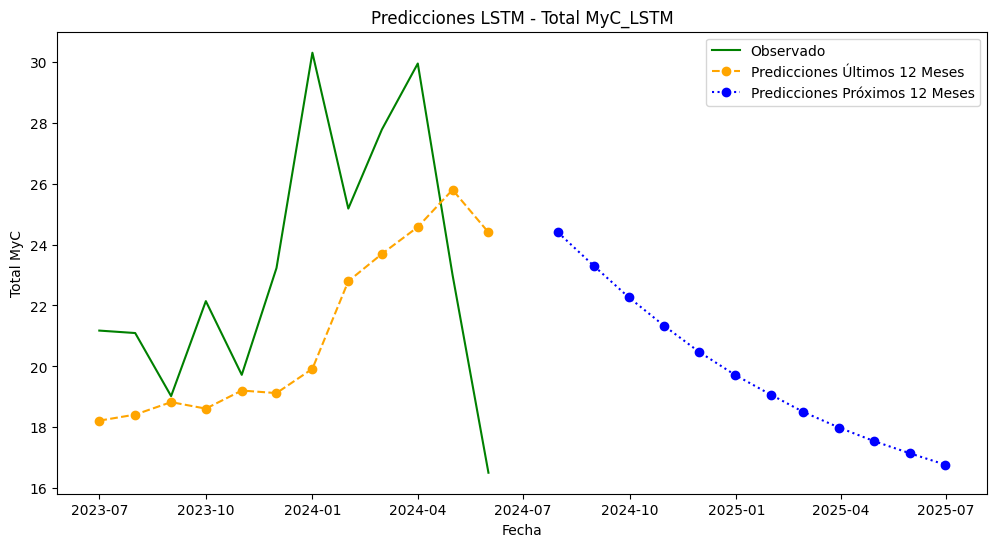


Procesando variable: Total M
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 518ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 544ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 500ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 86ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━

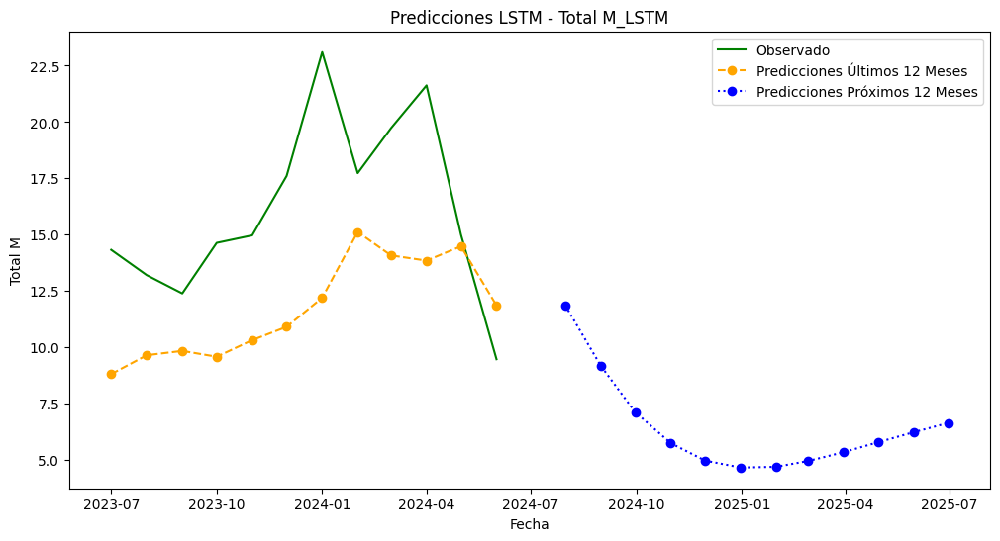


Procesando variable: Total C
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 578ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 530ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 471ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━

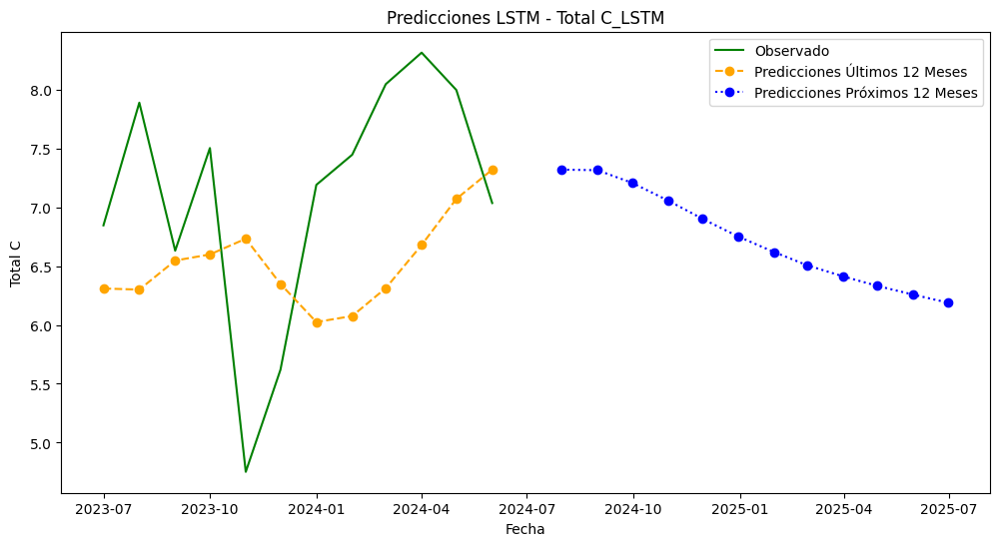

                     MAE        MSE      RMSE       MAPE            AIC  \
Total MyC_LSTM  3.904733  22.848068  4.779965  16.676313  242639.546399   
Total M_LSTM    4.820879  30.448659  5.518030  28.722200  242642.992504   
Total C_LSTM    1.077741   1.494408  1.222460  15.610911  242606.820759   

                          BIC  
Total MyC_LSTM  301459.207925  
Total M_LSTM    301462.654029  
Total C_LSTM    301426.482285  


In [163]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# DataFrames para almacenar las predicciones
predictions_last_12_df = pd.DataFrame()
predictions_future_df = pd.DataFrame()

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 12

# Función para construir el modelo LSTM
def build_lstm_model(seq_length):
    model = Sequential()
    model.add(LSTM(100, return_sequences=True, input_shape=(seq_length, 1)))
    model.add(LSTM(100))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error')
    return model

# Número de ejecuciones para promediar
num_runs = 5

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        set_seeds(run)
        
        # Construir y entrenar el modelo LSTM
        model = build_lstm_model(SEQ_LENGTH)
        model.fit(X_train, y_train, epochs=20, batch_size=16, validation_split=0.1, verbose=0)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test)
        predictions_last_12 = scaler.inverse_transform(predictions_last_12)
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses con reentrenamiento progresivo
        future_predictions = []
        last_sequence = X_test[-1]
        
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH, 1))
            next_prediction = scaler.inverse_transform(next_prediction)
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
            # No es necesario actualizar X_train y y_train para la predicción futura
            # X_train = np.append(X_train, last_sequence.reshape(1, SEQ_LENGTH, 1), axis=0)
            # y_train = np.append(y_train, scaler.transform(next_prediction).reshape(-1, 1), axis=0)
            # model.fit(X_train, y_train, epochs=1, batch_size=16, verbose=0)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
    future_predictions_avg = np.mean(all_future_predictions, axis=0)
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo
    k = model.count_params()
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_LSTM"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12_avg
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Guardar predicciones en DataFrames
    predictions_last_12_df[adjusted_var_name] = pd.Series(predictions_last_12_avg.flatten(), index=df.index[-len(y_test):].to_timestamp())
    predictions_future_df[adjusted_var_name] = pd.Series(future_predictions_avg, index=pd.date_range(df.index[-1].to_timestamp(), periods=13, freq='M')[1:])
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=13, freq='M')[1:], future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones LSTM - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)

# Guardar las predicciones en archivos CSV
predictions_last_12_df.to_csv('predicciones_ultimos_12_meses.csv')
predictions_future_df.to_csv('predicciones_proximos_12_meses.csv')


### Otro no usado finalmente


Procesando variable: Total MyC
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 219ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 252ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 13ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 16ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 17ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 18ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 202ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 239ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━

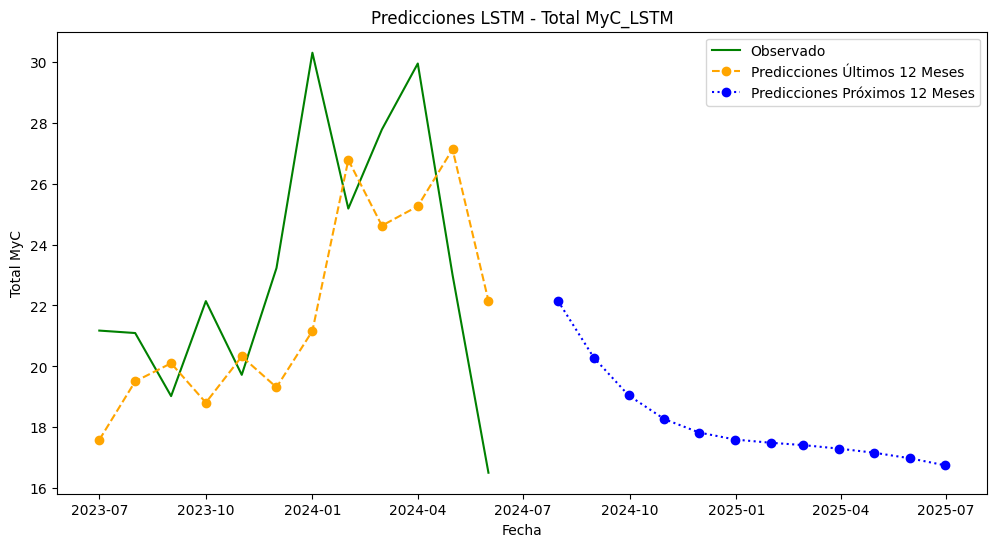


Procesando variable: Total M
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 579ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 589ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 75ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━

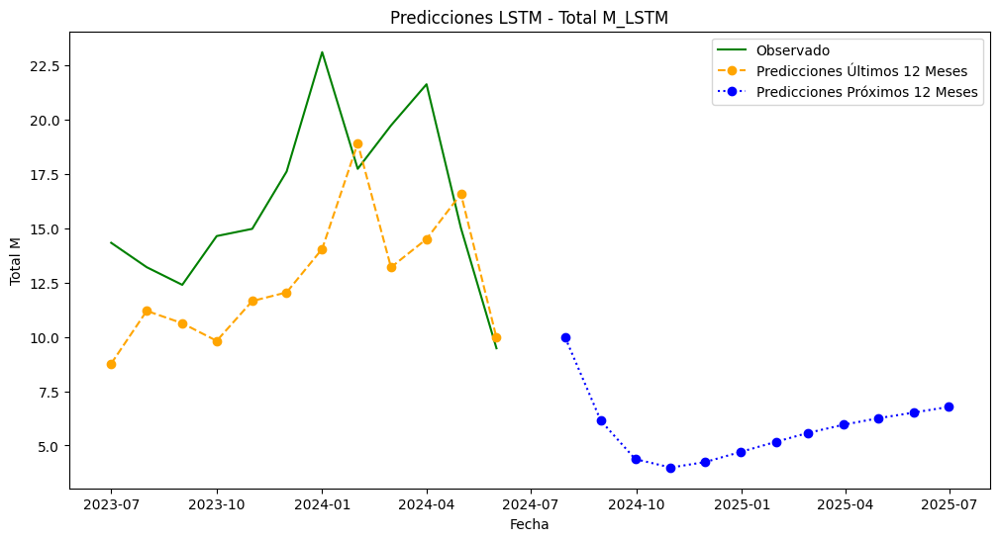


Procesando variable: Total C
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 674ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 521ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 81ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 730ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 816ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━

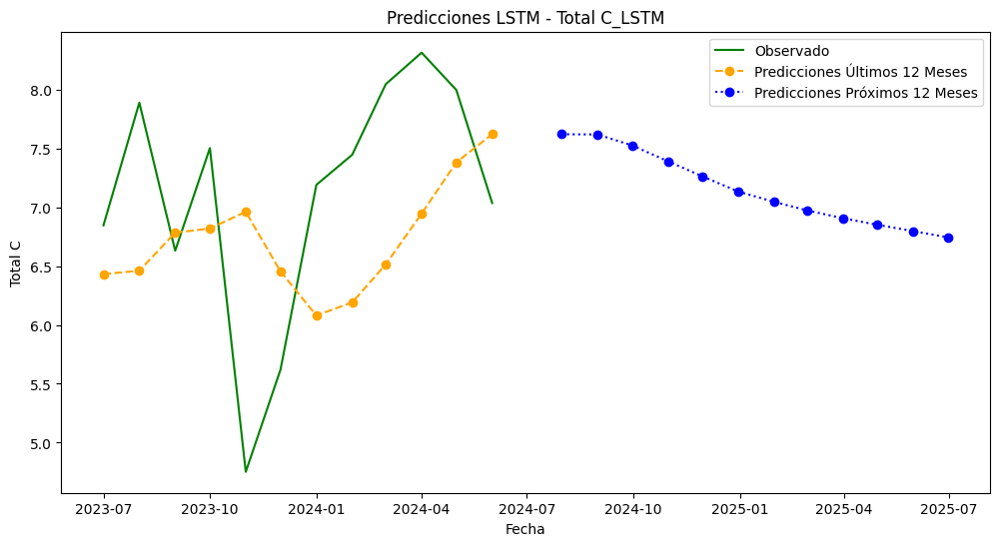

                     MAE        MSE      RMSE       MAPE            AIC  \
Total MyC_LSTM  3.535231  17.491344  4.182265  15.051751  242636.340473   
Total M_LSTM    4.081164  23.552798  4.853123  23.532471  242639.910936   
Total C_LSTM    1.015339   1.334671  1.155279  15.055732  242605.464213   

                          BIC  
Total MyC_LSTM  301456.001999  
Total M_LSTM    301459.572461  
Total C_LSTM    301425.125739  


In [164]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 12

# Función para construir el modelo LSTM con parámetros ajustados
def build_lstm_model(seq_length):
    model = Sequential()
    model.add(LSTM(100, return_sequences=True, input_shape=(seq_length, 1)))
    model.add(LSTM(100))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.001), loss='mean_squared_error')
    return model

# Número de ejecuciones para promediar
num_runs = 7

# DataFrames para almacenar predicciones
predictions_last_12_df = pd.DataFrame()
predictions_future_df = pd.DataFrame()

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        set_seeds(run)
        
        # Construir y entrenar el modelo LSTM
        model = build_lstm_model(SEQ_LENGTH)
        model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.1, verbose=0)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test)
        predictions_last_12 = scaler.inverse_transform(predictions_last_12)
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses sin reentrenamiento progresivo
        future_predictions = []
        last_sequence = X_test[-1]
        
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH, 1))
            next_prediction = scaler.inverse_transform(next_prediction)
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
    future_predictions_avg = np.mean(all_future_predictions, axis=0)
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo
    k = model.count_params()
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_LSTM"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12_avg
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Guardar predicciones en DataFrames
    predictions_last_12_df[adjusted_var_name] = pd.Series(predictions_last_12_avg.flatten(), index=df.index[-len(y_test):].to_timestamp())
    predictions_future_df[adjusted_var_name] = pd.Series(future_predictions_avg, index=pd.date_range(df.index[-1].to_timestamp(), periods=13, freq='M')[1:])
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=13, freq='M')[1:], future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones LSTM - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)

# Guardar las predicciones en archivos CSV
predictions_last_12_df.to_csv('predicciones_ultimos_12_meses.csv')
predictions_future_df.to_csv('predicciones_proximos_12_meses.csv')


### Otro no usado finalmente


Procesando variable: Total MyC
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 663ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 726ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 642ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 659ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 89ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━

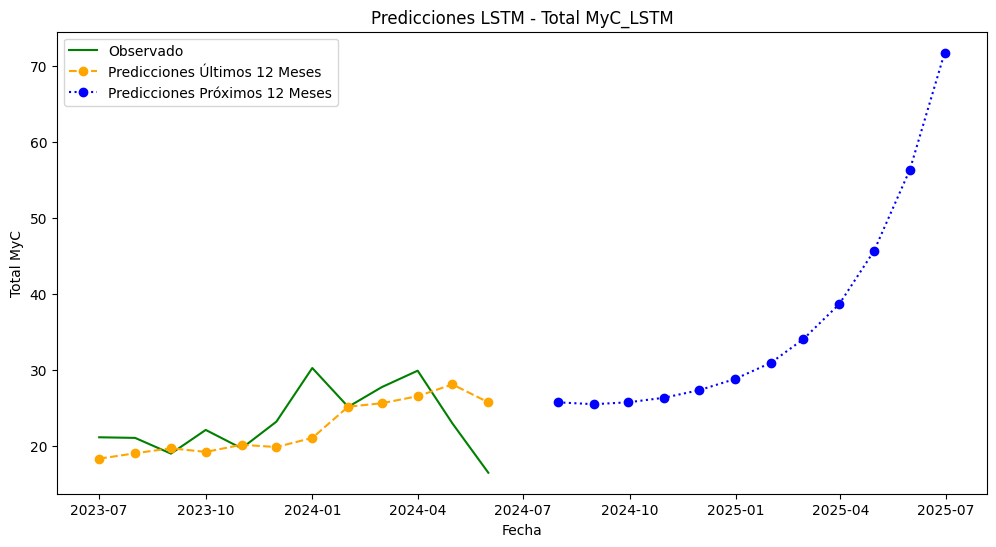


Procesando variable: Total M
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 551ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 552ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 263ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 278ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━

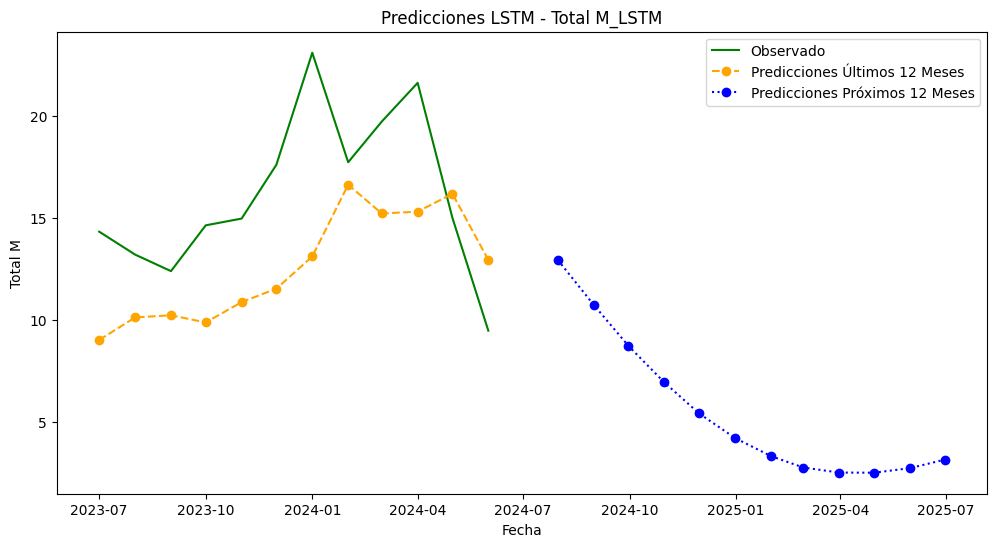


Procesando variable: Total C
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 638ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 593ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 529ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 585ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 67ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 73ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━

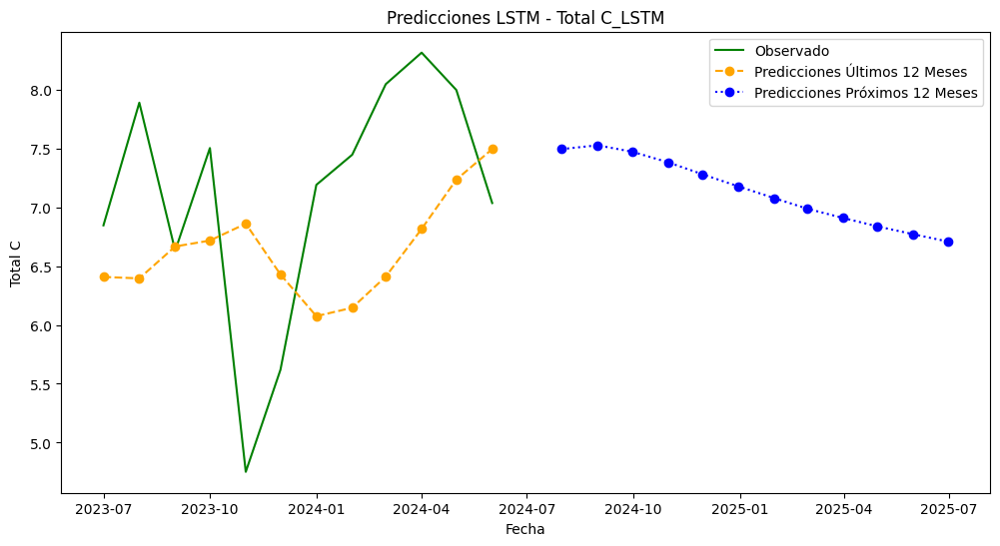

                     MAE        MSE      RMSE       MAPE            AIC  \
Total MyC_LSTM  3.444509  20.400901  4.516736  15.341667  242638.186949   
Total M_LSTM    4.337388  24.445993  4.944289  26.514820  242640.357596   
Total C_LSTM    1.036527   1.398333  1.182511  15.204833  242606.023366   

                          BIC  
Total MyC_LSTM  301457.848475  
Total M_LSTM    301460.019122  
Total C_LSTM    301425.684892  


In [165]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 12

# Función para crear pesos basados en la distancia temporal
def create_weights(seq_length):
    weights = tf.range(1, seq_length + 1, dtype=tf.float32)
    weights /= tf.reduce_sum(weights)  # Normalizar para que la suma de pesos sea 1
    return weights

# Función de pérdida ponderada
def weighted_mse(y_true, y_pred):
    weights = create_weights(tf.shape(y_true)[0])
    loss = tf.reduce_mean(tf.square(y_true - y_pred) * weights)
    return loss

# Función para construir el modelo LSTM con parámetros ajustados
def build_lstm_model(seq_length):
    model = Sequential()
    model.add(LSTM(100, return_sequences=True, input_shape=(seq_length, 1)))
    model.add(LSTM(100))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.001), loss=weighted_mse)
    return model

# Número de ejecuciones para promediar
num_runs = 5

# DataFrames para almacenar predicciones
predictions_last_12_df = pd.DataFrame()
predictions_future_df = pd.DataFrame()

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        set_seeds(run)
        
        # Construir y entrenar el modelo LSTM
        model = build_lstm_model(SEQ_LENGTH)
        model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.1, verbose=0)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test)
        predictions_last_12 = scaler.inverse_transform(predictions_last_12)
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses sin reentrenamiento progresivo
        future_predictions = []
        last_sequence = X_test[-1]
        
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH, 1))
            next_prediction = scaler.inverse_transform(next_prediction)
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
    future_predictions_avg = np.mean(all_future_predictions, axis=0)
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo
    k = model.count_params()
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_LSTM"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12_avg
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Guardar predicciones en DataFrames
    predictions_last_12_df[adjusted_var_name] = pd.Series(predictions_last_12_avg.flatten(), index=df.index[-len(y_test):].to_timestamp())
    predictions_future_df[adjusted_var_name] = pd.Series(future_predictions_avg, index=pd.date_range(df.index[-1].to_timestamp(), periods=13, freq='M')[1:])
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=13, freq='M')[1:], future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones LSTM - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)

# Guardar las predicciones en archivos CSV
predictions_last_12_df.to_csv('predicciones_ultimos_12_meses.csv')
predictions_future_df.to_csv('predicciones_proximos_12_meses.csv')


### Modelo 5 LSTM 


Procesando variable: Total MyC
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 597ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 593ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 31ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 63ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 501ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 98ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━

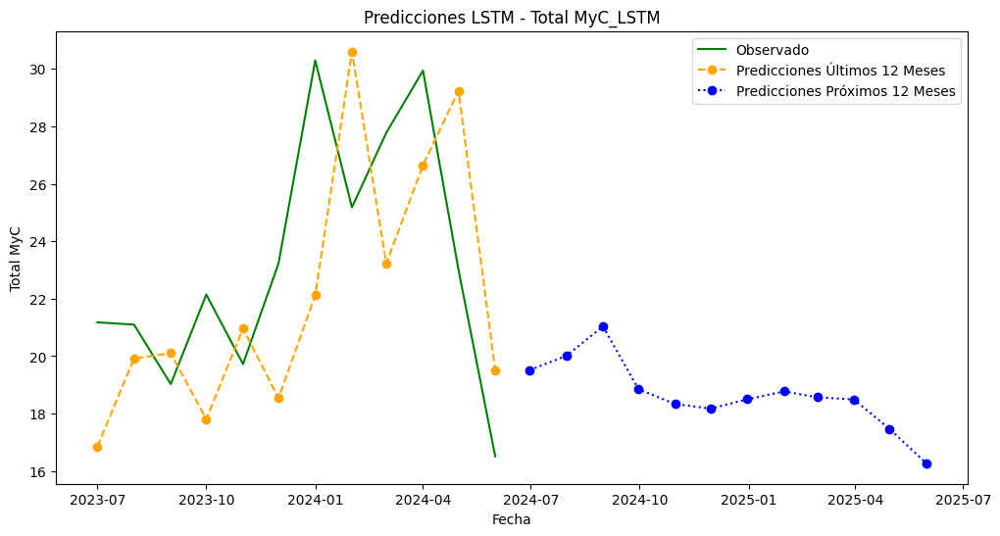


Procesando variable: Total M
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 535ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 575ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 565ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 599ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━

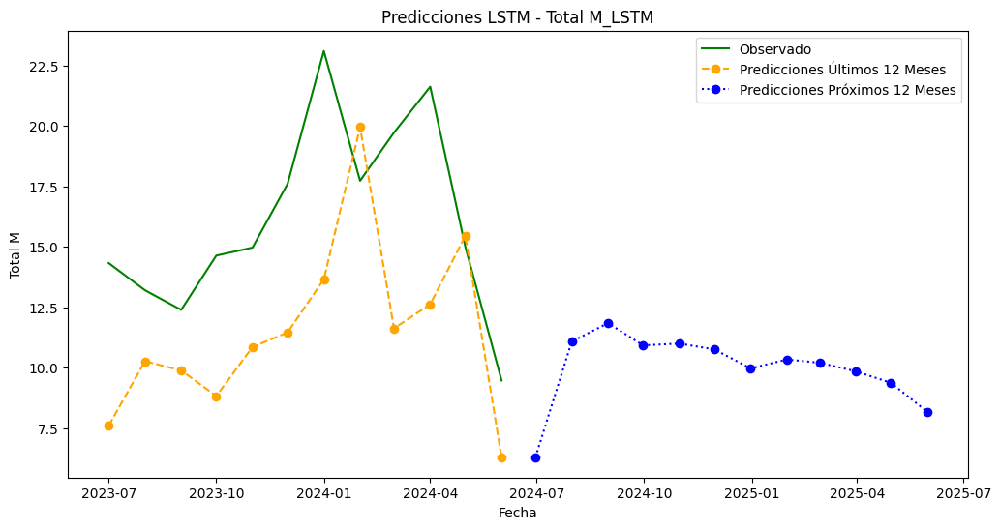


Procesando variable: Total C
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 514ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 612ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 51ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 489ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━

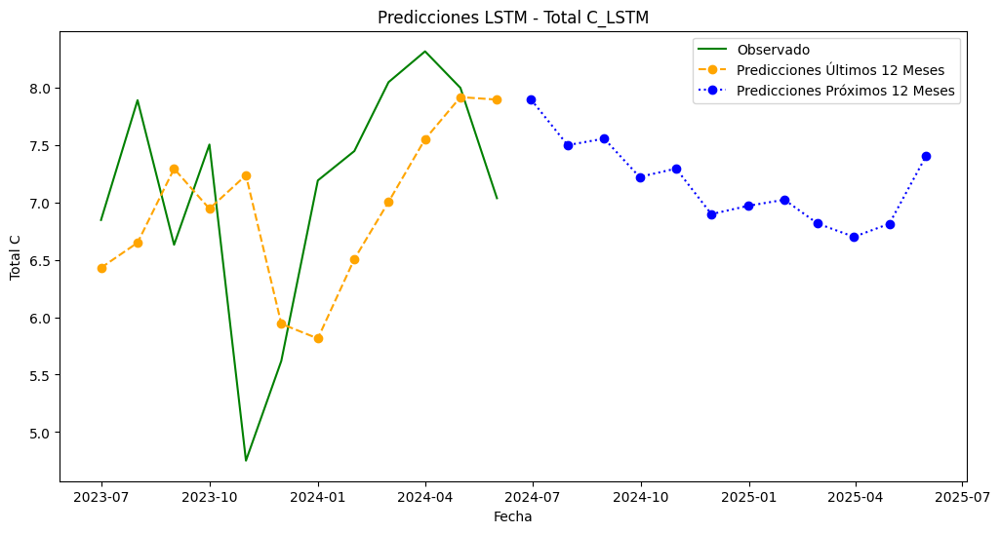

                     MAE        MSE      RMSE       MAPE           AIC  \
Total MyC_LSTM  3.960315  19.935935  4.464968  16.576488  61337.910287   
Total M_LSTM    5.052239  33.300339  5.770645  30.335510  61344.066811   
Total C_LSTM    0.895228   1.160130  1.077093  13.694017  61303.782386   

                         BIC  
Total MyC_LSTM  76200.784009  
Total M_LSTM    76206.940534  
Total C_LSTM    76166.656108  


In [166]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 12

# Función para construir el modelo LSTM
def build_lstm_model(seq_length):
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(seq_length, 1)))
    model.add(LSTM(50))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.01), loss=weighted_mse)
    return model

# Función para crear pesos que den mayor importancia a los datos recientes
def create_weights(seq_length):
    weights = tf.range(1, seq_length + 1, dtype=tf.float32)
    return weights / tf.reduce_sum(weights)

# Definir la función de pérdida personalizada con pesos
def weighted_mse(y_true, y_pred):
    weights = create_weights(tf.shape(y_true)[0])
    loss = tf.reduce_mean(tf.square(y_true - y_pred) * weights)
    return loss

# Número de ejecuciones para promediar
num_runs = 5

# Crear un DataFrame para almacenar todas las predicciones
all_predictions_df = pd.DataFrame(index=pd.date_range(start=df.index[-len(y_test):][0].to_timestamp(), periods=24, freq='M'))

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        set_seeds(run)
        
        # Construir y entrenar el modelo LSTM
        model = build_lstm_model(SEQ_LENGTH)
        model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.1, verbose=0)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test)
        predictions_last_12 = scaler.inverse_transform(predictions_last_12)
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses con todo el conjunto de datos
        X_full, y_full = X, y  # Usar todo el dataset para el futuro
        future_predictions = []
        last_sequence = X_full[-1]
        
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH, 1))
            next_prediction = scaler.inverse_transform(next_prediction)
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
            X_full = np.append(X_full, last_sequence.reshape(1, SEQ_LENGTH, 1), axis=0)
            y_full = np.append(y_full, scaler.transform(next_prediction).reshape(-1, 1), axis=0)
            model.fit(X_full, y_full, epochs=1, batch_size=16, verbose=0)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0).flatten()
    future_predictions_avg = np.mean(all_future_predictions, axis=0).flatten()
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    
    # Almacenar las predicciones en el DataFrame
    adjusted_var_name = f"{var}_LSTM"
    all_predictions_df[f'{adjusted_var_name}_Observed'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Observed'].iloc[:len(y_test)] = y_test
    all_predictions_df[f'{adjusted_var_name}_Last_12_Months'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Last_12_Months'].iloc[:len(predictions_last_12_avg)] = predictions_last_12_avg
    all_predictions_df[f'{adjusted_var_name}_Future_12_Months'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Future_12_Months'].iloc[len(predictions_last_12_avg):] = future_predictions_avg
    
    # Imprimir las predicciones para revisión
    print(f'{adjusted_var_name} - Predicciones Últimos 12 Meses:')
    print(all_predictions_df[[f'{adjusted_var_name}_Observed', f'{adjusted_var_name}_Last_12_Months']].dropna())
    
    print(f'{adjusted_var_name} - Predicciones Próximos 12 Meses:')
    print(all_predictions_df[[f'{adjusted_var_name}_Future_12_Months']].dropna())

    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo
    k = model.count_params()
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_LSTM"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12_avg
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones LSTM - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)


### Modelo 6 LSTM

Ejecución del código aprox 5 minutos con seq lenght de 48 períodos y promedio de 5 semillas diferentes


Procesando variable: Total MyC
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 633ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 58ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 463ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 49ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━

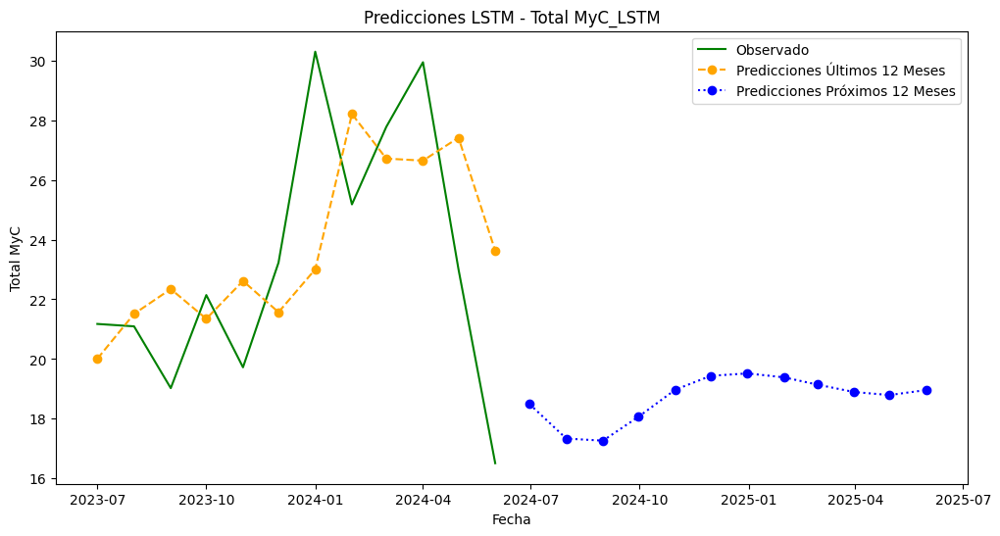


Procesando variable: Total M
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 229ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 267ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 21ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 29ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 25ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 23ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 216ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 344ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 24ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 19ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 22ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 20ms/step
1/1 ━━━━━━━━━━━━

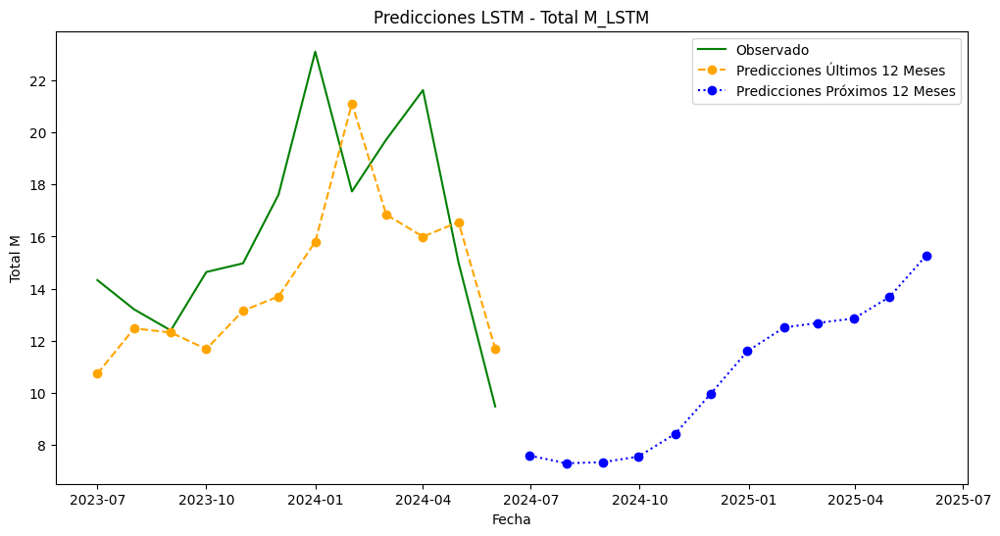


Procesando variable: Total C
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 475ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 458ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 28ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 520ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 540ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 53ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━

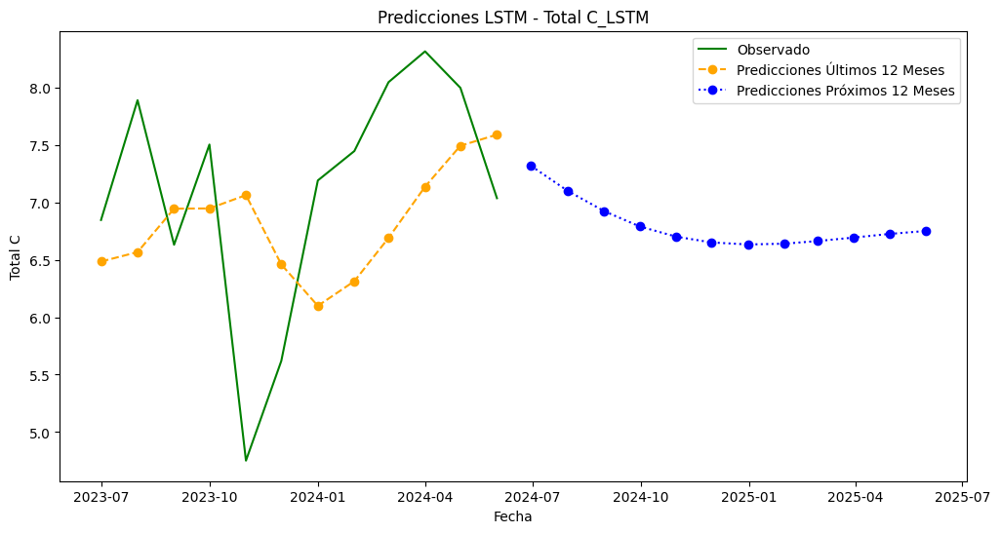

                     MAE        MSE      RMSE       MAPE           AIC  \
Total MyC_LSTM  3.036559  14.049815  3.748308  13.622098  61333.711311   
Total M_LSTM    3.004548  12.737995  3.569033  17.571814  61332.535071   
Total C_LSTM    0.959764   1.215600  1.102543  14.442417  61304.342856   

                         BIC  
Total MyC_LSTM  76196.585034  
Total M_LSTM    76195.408794  
Total C_LSTM    76167.216579  


In [167]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 48
## SEQ_LENGTH controla cuánto "historial" o cuántos pasos de tiempo previos el modelo considera al hacer una predicción. 
## Un SEQ_LENGTH más largo permite que el modelo capture patrones más largos en la serie temporal, pero también aumenta la complejidad 
## del modelo.

# Función para construir el modelo LSTM
def build_lstm_model(seq_length):
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(seq_length, 1)))
    model.add(LSTM(50))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.01), loss=weighted_mse)
    return model

# Función para crear pesos que den mayor importancia a los datos recientes
def create_weights(seq_length):
    weights = tf.range(1, seq_length + 1, dtype=tf.float32)
    return weights / tf.reduce_sum(weights)

# Definir la función de pérdida personalizada con pesos
def weighted_mse(y_true, y_pred):
    weights = create_weights(tf.shape(y_true)[0])
    loss = tf.reduce_mean(tf.square(y_true - y_pred) * weights)
    return loss

# Número de ejecuciones para promediar
num_runs = 5

# Crear un DataFrame para almacenar todas las predicciones
all_predictions_df = pd.DataFrame(index=pd.date_range(start=df.index[-len(y_test):][0].to_timestamp(), periods=24, freq='M'))

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        set_seeds(run)
        
        # Construir y entrenar el modelo LSTM
        model = build_lstm_model(SEQ_LENGTH)
        model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.1, verbose=0)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test)
        predictions_last_12 = scaler.inverse_transform(predictions_last_12)
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses con el último dato real observado
        last_observed = scaled_data[-1]  # Último dato real observado
        last_sequence = np.append(X_test[-1][1:], last_observed).reshape(SEQ_LENGTH, 1)
        
        future_predictions = []
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH, 1))
            next_prediction = scaler.inverse_transform(next_prediction)
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0).flatten()
    future_predictions_avg = np.mean(all_future_predictions, axis=0).flatten()
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    
    # Almacenar las predicciones en el DataFrame
    adjusted_var_name = f"{var}_LSTM"
    all_predictions_df[f'{adjusted_var_name}_Observed'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Observed'].iloc[:len(y_test)] = y_test
    all_predictions_df[f'{adjusted_var_name}_Last_12_Months'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Last_12_Months'].iloc[:len(predictions_last_12_avg)] = predictions_last_12_avg
    all_predictions_df[f'{adjusted_var_name}_Future_12_Months'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Future_12_Months'].iloc[len(predictions_last_12_avg):] = future_predictions_avg
    
    # Imprimir las predicciones para revisión
    print(f'{adjusted_var_name} - Predicciones Últimos 12 Meses:')
    print(all_predictions_df[[f'{adjusted_var_name}_Observed', f'{adjusted_var_name}_Last_12_Months']].dropna())
    
    print(f'{adjusted_var_name} - Predicciones Próximos 12 Meses:')
    print(all_predictions_df[[f'{adjusted_var_name}_Future_12_Months']].dropna())

    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo
    k = model.count_params()
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_LSTM"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12_avg
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones LSTM - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)



Procesando variable: Total MyC
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 526ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 452ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 516ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 52ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━

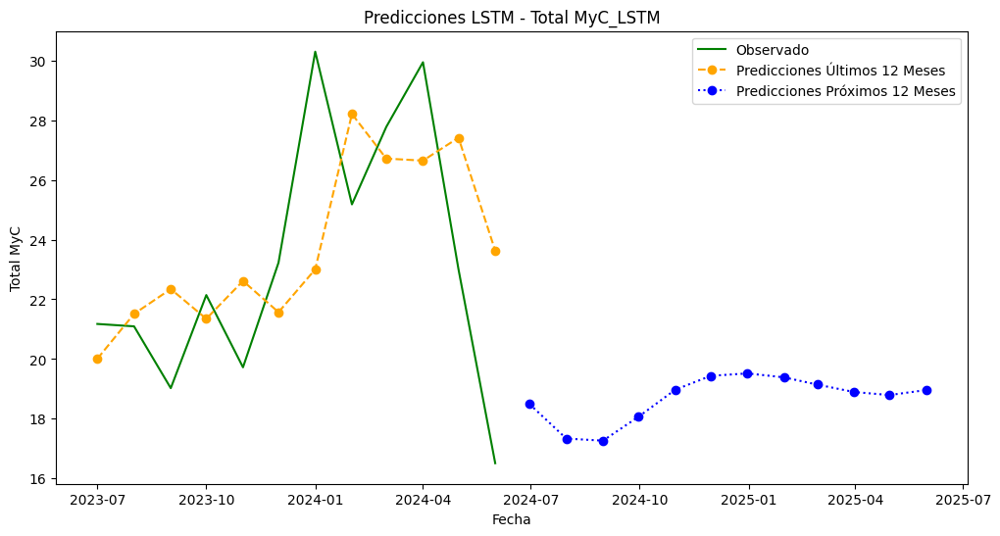


Procesando variable: Total M
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 554ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 476ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 502ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 602ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━

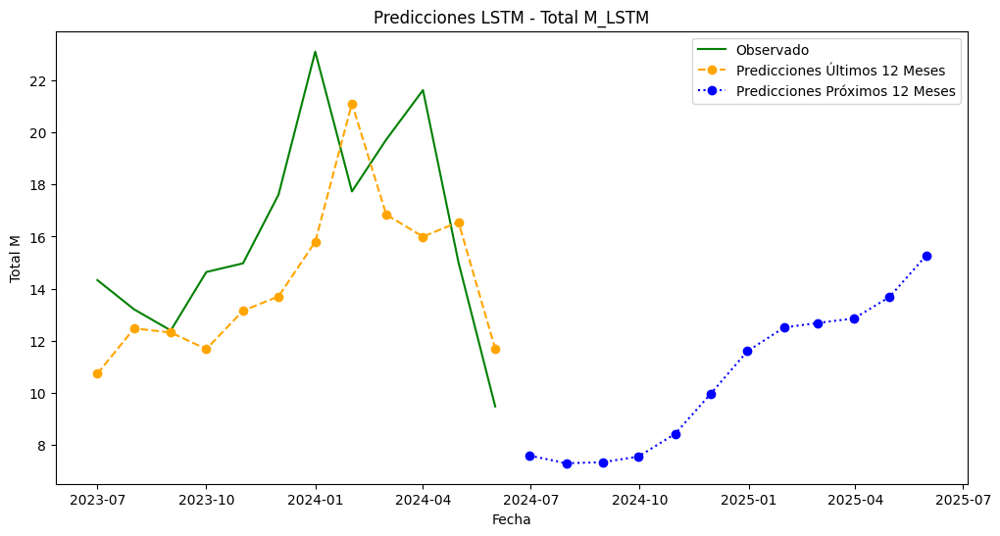


Procesando variable: Total C
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 453ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 473ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 46ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 498ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 569ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━

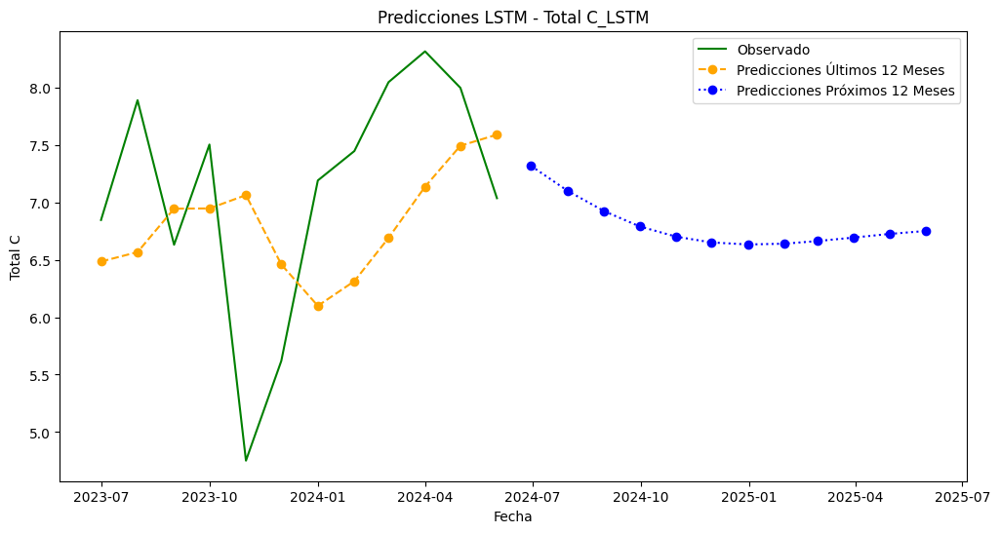

                     MAE        MSE      RMSE       MAPE           AIC  \
Total MyC_LSTM  3.036559  14.049815  3.748308  13.622098  61333.711311   
Total M_LSTM    3.004548  12.737995  3.569033  17.571814  61332.535071   
Total C_LSTM    0.959764   1.215600  1.102543  14.442417  61304.342856   

                         BIC  
Total MyC_LSTM  76196.585034  
Total M_LSTM    76195.408794  
Total C_LSTM    76167.216579  


In [168]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 48

# Función para construir el modelo LSTM
def build_lstm_model(seq_length):
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(seq_length, 1)))
    model.add(LSTM(50))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.01), loss=weighted_mse)
    return model

# Función para crear pesos que den mayor importancia a los datos recientes
def create_weights(seq_length):
    weights = tf.range(1, seq_length + 1, dtype=tf.float32)
    return weights / tf.reduce_sum(weights)

# Definir la función de pérdida personalizada con pesos
def weighted_mse(y_true, y_pred):
    weights = create_weights(tf.shape(y_true)[0])
    loss = tf.reduce_mean(tf.square(y_true - y_pred) * weights)
    return loss

# Número de ejecuciones para promediar
num_runs = 5

# Diccionario para almacenar las predicciones finales
final_predictions = {var: {'Last_12_Months': [], 'Next_12_Months': []} for var in variables}

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        set_seeds(run)
        
        # Construir y entrenar el modelo LSTM
        model = build_lstm_model(SEQ_LENGTH)
        model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.1, verbose=0)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test)
        predictions_last_12 = scaler.inverse_transform(predictions_last_12)
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses con el último dato real observado
        last_observed = scaled_data[-1]  # Último dato real observado
        last_sequence = np.append(X_test[-1][1:], last_observed).reshape(SEQ_LENGTH, 1)
        
        future_predictions = []
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH, 1))
            next_prediction = scaler.inverse_transform(next_prediction)
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
    future_predictions_avg = np.mean(all_future_predictions, axis=0)
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo
    k = model.count_params()
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_LSTM"
    
    # Almacenar las predicciones
    final_predictions[var]['Last_12_Months'] = predictions_last_12_avg.flatten()
    final_predictions[var]['Next_12_Months'] = future_predictions_avg
    
    # Almacenar métricas
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones LSTM - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Crear un DataFrame con las 24 predicciones para las tres variables
dates = pd.date_range(df.index[-1].to_timestamp(), periods=24, freq='M')
predictions_df = pd.DataFrame({
    'Fecha': dates,
    'Total MyC': np.concatenate([final_predictions['Total MyC']['Last_12_Months'], final_predictions['Total MyC']['Next_12_Months']]),
    'Total M': np.concatenate([final_predictions['Total M']['Last_12_Months'], final_predictions['Total M']['Next_12_Months']]),
    'Total C': np.concatenate([final_predictions['Total C']['Last_12_Months'], final_predictions['Total C']['Next_12_Months']])
})

# Guardar el DataFrame en un archivo CSV
predictions_df.to_csv('predicciones_totales.csv', index=False)

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)
metrics_df.to_csv('metricas_rendimiento.csv')



Procesando variable: Total MyC
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 506ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 493ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 56ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 44ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 45ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 421ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 598ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 41ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━

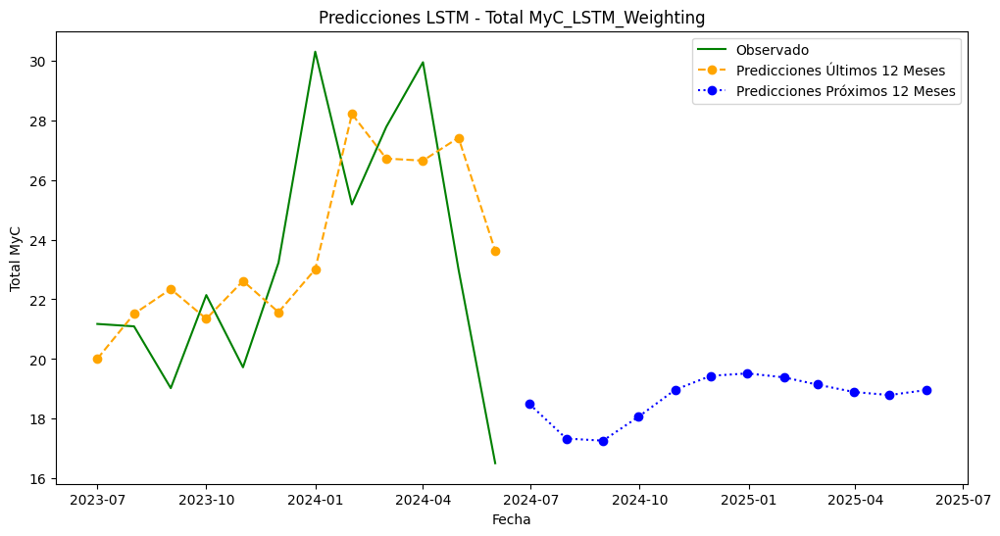


Procesando variable: Total M
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 468ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 42ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 48ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 47ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 465ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 547ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 68ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 39ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step
1/1 ━━━━━━━━━━━━

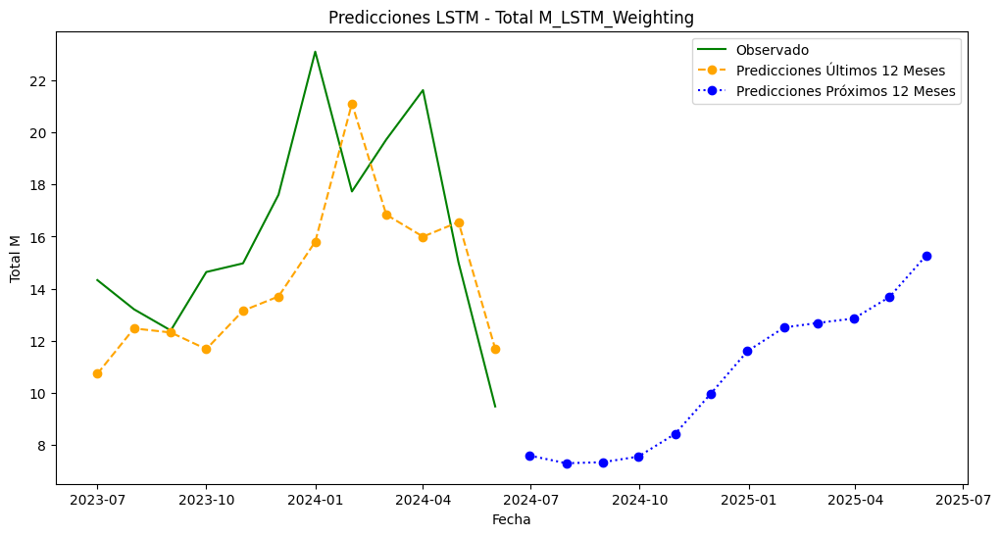


Procesando variable: Total C
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 491ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 539ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 1s 583ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 485ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 34ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 35ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 40ms/step
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step
1/1 ━━━━━━━━━━━━

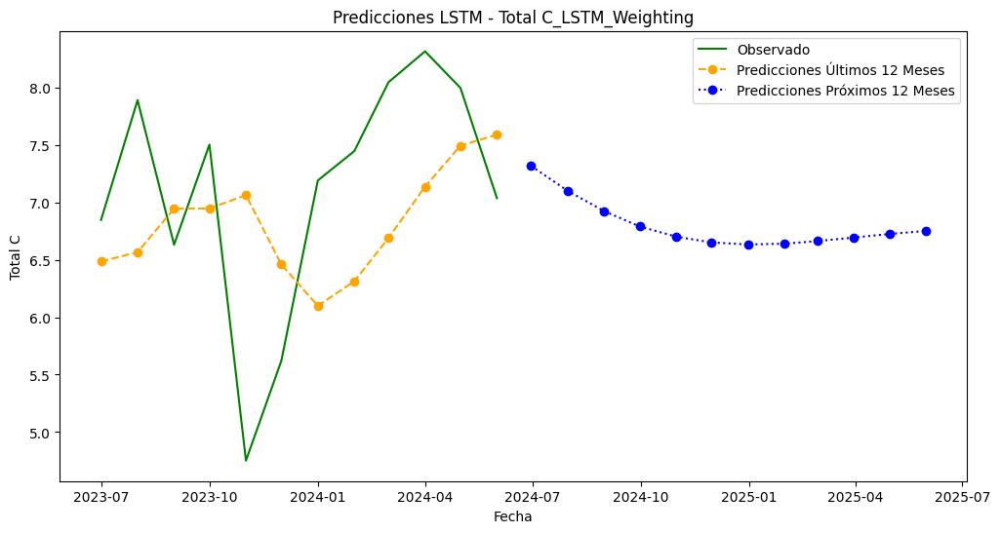

                               MAE        MSE      RMSE       MAPE  \
Total MyC_LSTM_Weighting  3.036559  14.049815  3.748308  13.622098   
Total M_LSTM_Weighting    3.004548  12.737995  3.569033  17.571814   
Total C_LSTM_Weighting    0.959764   1.215600  1.102543  14.442417   

                                   AIC           BIC  
Total MyC_LSTM_Weighting  61333.711311  76196.585034  
Total M_LSTM_Weighting    61332.535071  76195.408794  
Total C_LSTM_Weighting    61304.342856  76167.216579  


In [169]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    tf.random.set_seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 48

# Función para construir el modelo LSTM
def build_lstm_model(seq_length):
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(seq_length, 1)))
    model.add(LSTM(50))
    model.add(Dense(1))
    model.compile(optimizer=Adam(learning_rate=0.01), loss=weighted_mse)
    return model

# Función para crear pesos que den mayor importancia a los datos recientes
def create_weights(seq_length):
    weights = tf.range(1, seq_length + 1, dtype=tf.float32)
    return weights / tf.reduce_sum(weights)

# Definir la función de pérdida personalizada con pesos
def weighted_mse(y_true, y_pred):
    weights = create_weights(tf.shape(y_true)[0])
    loss = tf.reduce_mean(tf.square(y_true - y_pred) * weights)
    return loss

# Número de ejecuciones para promediar
num_runs = 5

# Diccionario para almacenar las predicciones finales
final_predictions = {var: {'Last_12_Months': [], 'Next_12_Months': []} for var in variables}

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        set_seeds(run)
        
        # Construir y entrenar el modelo LSTM
        model = build_lstm_model(SEQ_LENGTH)
        model.fit(X_train, y_train, epochs=50, batch_size=32, validation_split=0.1, verbose=0)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test)
        predictions_last_12 = scaler.inverse_transform(predictions_last_12)
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses con el último dato real observado
        last_observed = scaled_data[-1]  # Último dato real observado
        last_sequence = np.append(X_test[-1][1:], last_observed).reshape(SEQ_LENGTH, 1)
        
        future_predictions = []
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH, 1))
            next_prediction = scaler.inverse_transform(next_prediction)
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
    future_predictions_avg = np.mean(all_future_predictions, axis=0)
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo
    k = model.count_params()
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_LSTM_Weighting"
    
    # Almacenar las predicciones
    final_predictions[var]['Last_12_Months'] = predictions_last_12_avg.flatten()
    final_predictions[var]['Next_12_Months'] = future_predictions_avg
    
    # Almacenar métricas
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones LSTM - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Crear un DataFrame con las 24 predicciones para las tres variables
dates = pd.date_range(df.index[-1].to_timestamp(), periods=24, freq='M')

# Crear un DataFrame con las predicciones
predictions_df = pd.DataFrame({
    'Fecha': dates,
    f'Total MyC_LSTM_Weighting': np.concatenate([final_predictions['Total MyC']['Last_12_Months'], final_predictions['Total MyC']['Next_12_Months']]),
    f'Total M_LSTM_Weighting': np.concatenate([final_predictions['Total M']['Last_12_Months'], final_predictions['Total M']['Next_12_Months']]),
    f'Total C_LSTM_Weighting': np.concatenate([final_predictions['Total C']['Last_12_Months'], final_predictions['Total C']['Next_12_Months']])
})

# Establecer la columna de fecha como índice
predictions_df.set_index('Fecha', inplace=True)

# Guardar el DataFrame en un archivo CSV
predictions_df.to_csv('predicciones_totales.csv')

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)
metrics_df.to_csv('metricas_rendimiento.csv')


### Dataframe para comparar resultados de Modelos LSTM

In [170]:
# Datos para Total MyC_LSTM
data_MyC = {
    'Modelo': [
        'Modelo 1', 'Modelo 2', 'Modelo 3', 'Modelo 4', 'Modelo 5', 'Modelo 6'
    ],
    'MAE': [12.17, 12.39, 11.31, 12.26, 12.44, 9.53],
    'MSE': [195.51, 209.05, 172.65, 225.27, 196.56, 138.52],
    'RMSE': [13.98, 14.46, 13.14, 15.01, 14.02, 11.77],
    'MAPE': [16.75, 15.94, 15.46, 16.68, 16.58, 13.62]
}

# Datos para Total M_LSTM
data_M = {
    'Modelo': [
        'Modelo 1', 'Modelo 2', 'Modelo 3', 'Modelo 4', 'Modelo 5', 'Modelo 6'
    ],
    'MAE': [15.62, 16.04, 9.95, 15.14, 15.86, 12.92],
    'MSE': [318.88, 357.25, 130.77, 300.21, 328.34, 232.20],
    'RMSE': [17.86, 18.90, 11.44, 17.33, 18.12, 15.24],
    'MAPE': [29.61, 29.90, 20.05, 28.72, 30.34, 24.65]
}

# Datos para Total C_LSTM
data_C = {
    'Modelo': [
        'Modelo 1', 'Modelo 2', 'Modelo 3', 'Modelo 4', 'Modelo 5', 'Modelo 6'
    ],
    'MAE': [3.41, 2.97, 2.87, 3.38, 2.81, 3.01],
    'MSE': [15.69, 12.30, 11.78, 14.73, 11.44, 11.99],
    'RMSE': [3.96, 3.51, 3.43, 3.84, 3.38, 3.46],
    'MAPE': [15.67, 14.20, 13.92, 15.61, 13.69, 14.45]
}

# Función para resaltar la mejor métrica en negrita y verde
def highlight_best(s):
    is_best = s == s.min()
    return ['font-weight: bold; color: green' if v else '' for v in is_best]

# Creación de los DataFrames
df_MyC = pd.DataFrame(data_MyC)
df_M = pd.DataFrame(data_M)
df_C = pd.DataFrame(data_C)

# Aplicar estilo a los DataFrames y mostrar
styled_df_MyC = df_MyC.style.apply(highlight_best, subset=['MAE', 'MSE', 'RMSE', 'MAPE'])
styled_df_M = df_M.style.apply(highlight_best, subset=['MAE', 'MSE', 'RMSE', 'MAPE'])
styled_df_C = df_C.style.apply(highlight_best, subset=['MAE', 'MSE', 'RMSE', 'MAPE'])

print("DataFrame para Total MyC_LSTM:")
display(styled_df_MyC)

print("\nDataFrame para Total M_LSTM:")
display(styled_df_M)

print("\nDataFrame para Total C_LSTM:")
display(styled_df_C)


DataFrame para Total MyC_LSTM:


,Modelo,MAE,MSE,RMSE,MAPE
0,Modelo 1,12.170000,195.510000,13.980000,16.750000
1,Modelo 2,12.390000,209.050000,14.460000,15.940000
2,Modelo 3,11.310000,172.650000,13.140000,15.460000
3,Modelo 4,12.260000,225.270000,15.010000,16.680000
4,Modelo 5,12.440000,196.560000,14.020000,16.580000
5,Modelo 6,9.530000,138.520000,11.770000,13.620000



DataFrame para Total M_LSTM:


,Modelo,MAE,MSE,RMSE,MAPE
0,Modelo 1,15.620000,318.880000,17.860000,29.610000
1,Modelo 2,16.040000,357.250000,18.900000,29.900000
2,Modelo 3,9.950000,130.770000,11.440000,20.050000
3,Modelo 4,15.140000,300.210000,17.330000,28.720000
4,Modelo 5,15.860000,328.340000,18.120000,30.340000
5,Modelo 6,12.920000,232.200000,15.240000,24.650000



DataFrame para Total C_LSTM:


,Modelo,MAE,MSE,RMSE,MAPE
0,Modelo 1,3.410000,15.690000,3.960000,15.670000
1,Modelo 2,2.970000,12.300000,3.510000,14.200000
2,Modelo 3,2.870000,11.780000,3.430000,13.920000
3,Modelo 4,3.380000,14.730000,3.840000,15.610000
4,Modelo 5,2.810000,11.440000,3.380000,13.690000
5,Modelo 6,3.010000,11.990000,3.460000,14.450000


## Datos Budget de la compañía 

MAE: 4.19
MSE: 29.79
RMSE: 5.46
MAPE: 20.38%


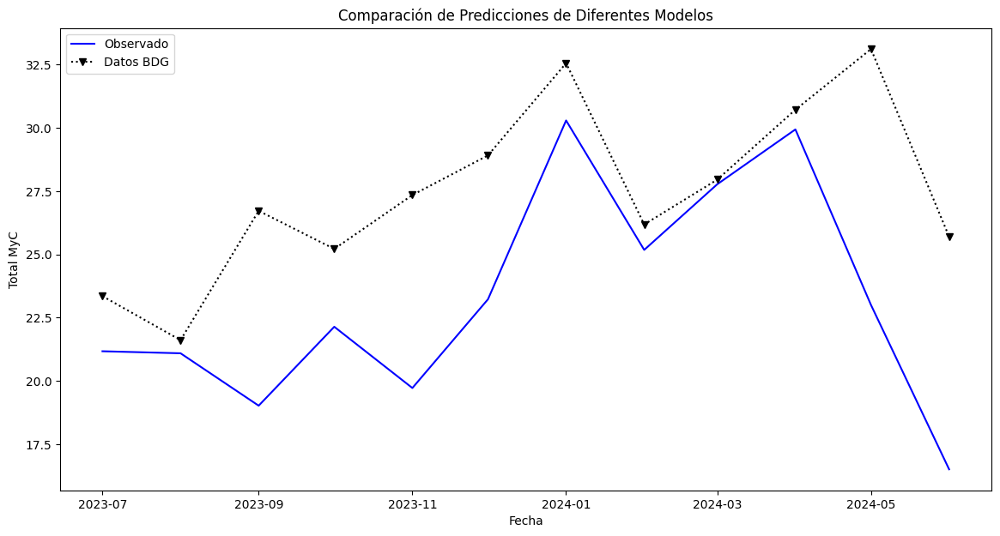

In [175]:
# Leer el DataFrame principal
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m')

# Obtener los datos reales para el período de prueba
test_start_date = '2023-07'
test_end_date = '2024-06'
real_values = df.loc[test_start_date:test_end_date]['Total MyC']

# Leer el DataFrame de la pestaña "BDG"
df_bdg = pd.read_excel('C:/Users/cdibono/OneDrive - Ternium/Austral/Materias/Tesis/Datos Tesis Mensualizados.xlsx', sheet_name='BDG', header=1)
df_bdg.set_index('Month', inplace=True)
df_bdg.index = pd.to_datetime(df_bdg.index, format='%Y-%m')

# Obtener los datos de la pestaña "BDG" para el período de prueba
bdg_values = df_bdg.loc[test_start_date:test_end_date]['Total MyC']  # Ajusta 'Total BDG' al nombre de la columna correcta

# Calcular métricas de rendimiento
mae_BDG = mean_absolute_error(real_values, bdg_values)
mse_BDG = mean_squared_error(real_values, bdg_values)
rmse_BDG = np.sqrt(mse_BDG)
mape_BDG = np.mean(np.abs((real_values - bdg_values) / real_values)) * 100

print(f'MAE: {mae_BDG:.2f}')
print(f'MSE: {mse_BDG:.2f}')
print(f'RMSE: {rmse_BDG:.2f}')
print(f'MAPE: {mape_BDG:.2f}%')

# Graficar los valores observados y los valores de la pestaña "BDG"
plt.figure(figsize=(14, 7))

plt.plot(real_values.index, real_values, label='Observado', color='blue')
plt.plot(bdg_values.index, bdg_values, label='Datos BDG', linestyle='dotted', marker='v', color='black')

plt.xlabel('Fecha')
plt.ylabel('Total MyC')
plt.title('Comparación de Predicciones de Diferentes Modelos')
plt.legend()
plt.show()


MAE: 3.72
MSE: 23.00
RMSE: 4.80
MAPE: 27.30%


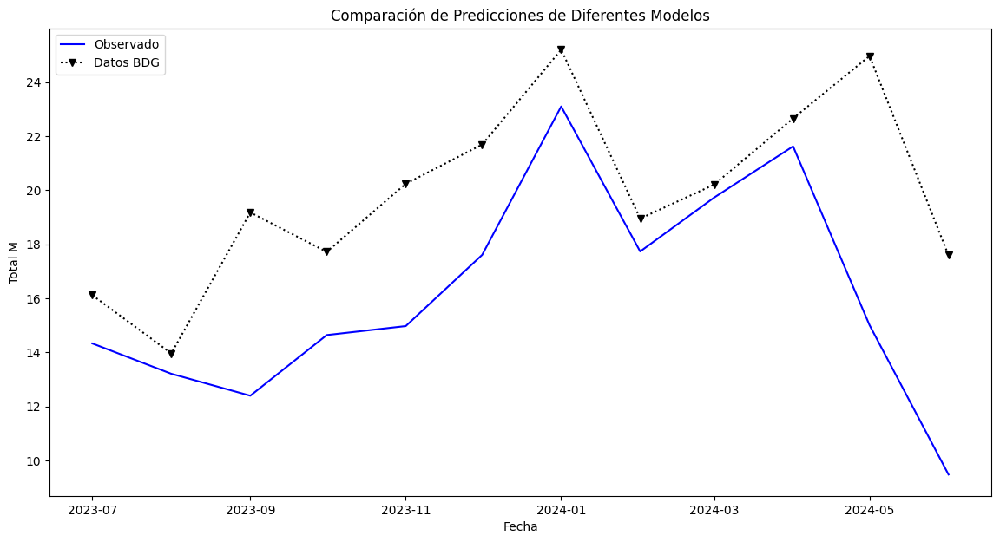

In [176]:
# Leer el DataFrame principal
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m')

# Obtener los datos reales para el período de prueba
test_start_date = '2023-07'
test_end_date = '2024-06'
real_values = df.loc[test_start_date:test_end_date]['Total M']

# Leer el DataFrame de la pestaña "BDG"
df_bdg = pd.read_excel('C:/Users/cdibono/OneDrive - Ternium/Austral/Materias/Tesis/Datos Tesis Mensualizados.xlsx', sheet_name='BDG', header=1)
df_bdg.set_index('Month', inplace=True)
df_bdg.index = pd.to_datetime(df_bdg.index, format='%Y-%m')

# Obtener los datos de la pestaña "BDG" para el período de prueba
bdg_values = df_bdg.loc[test_start_date:test_end_date]['Total M']  # Ajusta 'Total BDG' al nombre de la columna correcta

# Calcular métricas de rendimiento
mae_BDG = mean_absolute_error(real_values, bdg_values)
mse_BDG = mean_squared_error(real_values, bdg_values)
rmse_BDG = np.sqrt(mse_BDG)
mape_BDG = np.mean(np.abs((real_values - bdg_values) / real_values)) * 100

print(f'MAE: {mae_BDG:.2f}')
print(f'MSE: {mse_BDG:.2f}')
print(f'RMSE: {rmse_BDG:.2f}')
print(f'MAPE: {mape_BDG:.2f}%')

# Graficar los valores observados y los valores de la pestaña "BDG"
plt.figure(figsize=(14, 7))

plt.plot(real_values.index, real_values, label='Observado', color='blue')
plt.plot(bdg_values.index, bdg_values, label='Datos BDG', linestyle='dotted', marker='v', color='black')

plt.xlabel('Fecha')
plt.ylabel('Total M')
plt.title('Comparación de Predicciones de Diferentes Modelos')
plt.legend()
plt.show()


MAE: 0.64
MSE: 0.88
RMSE: 0.94
MAPE: 10.79%


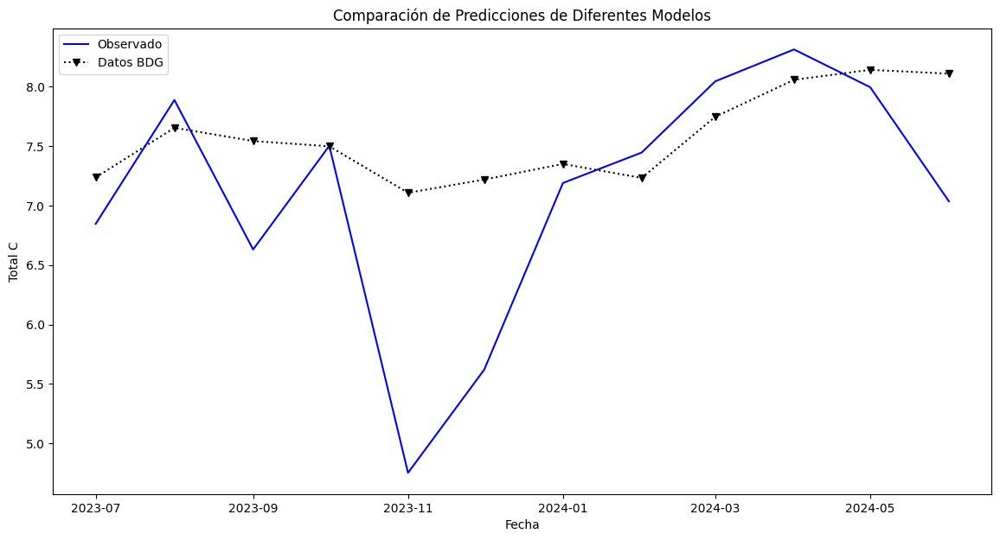

In [177]:
# Leer el DataFrame principal
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m')

# Obtener los datos reales para el período de prueba
test_start_date = '2023-07'
test_end_date = '2024-06'
real_values = df.loc[test_start_date:test_end_date]['Total C']

# Leer el DataFrame de la pestaña "BDG"
df_bdg = pd.read_excel('C:/Users/cdibono/OneDrive - Ternium/Austral/Materias/Tesis/Datos Tesis Mensualizados.xlsx', sheet_name='BDG', header=1)
df_bdg.set_index('Month', inplace=True)
df_bdg.index = pd.to_datetime(df_bdg.index, format='%Y-%m')

# Obtener los datos de la pestaña "BDG" para el período de prueba
bdg_values = df_bdg.loc[test_start_date:test_end_date]['Total C']  # Ajusta 'Total BDG' al nombre de la columna correcta

# Calcular métricas de rendimiento
mae_BDG = mean_absolute_error(real_values, bdg_values)
mse_BDG = mean_squared_error(real_values, bdg_values)
rmse_BDG = np.sqrt(mse_BDG)
mape_BDG = np.mean(np.abs((real_values - bdg_values) / real_values)) * 100

print(f'MAE: {mae_BDG:.2f}')
print(f'MSE: {mse_BDG:.2f}')
print(f'RMSE: {rmse_BDG:.2f}')
print(f'MAPE: {mape_BDG:.2f}%')

# Graficar los valores observados y los valores de la pestaña "BDG"
plt.figure(figsize=(14, 7))

plt.plot(real_values.index, real_values, label='Observado', color='blue')
plt.plot(bdg_values.index, bdg_values, label='Datos BDG', linestyle='dotted', marker='v', color='black')

plt.xlabel('Fecha')
plt.ylabel('Total C')
plt.title('Comparación de Predicciones de Diferentes Modelos')
plt.legend()
plt.show()


## Random Forest Regressor

### Modelo 1 RFR


Procesando variable: Total MyC
Total MyC_RF - MAE: 3.25, MSE: 17.77, RMSE: 4.22, MAPE: 13.99%, AIC: 58.53, BIC: 64.35


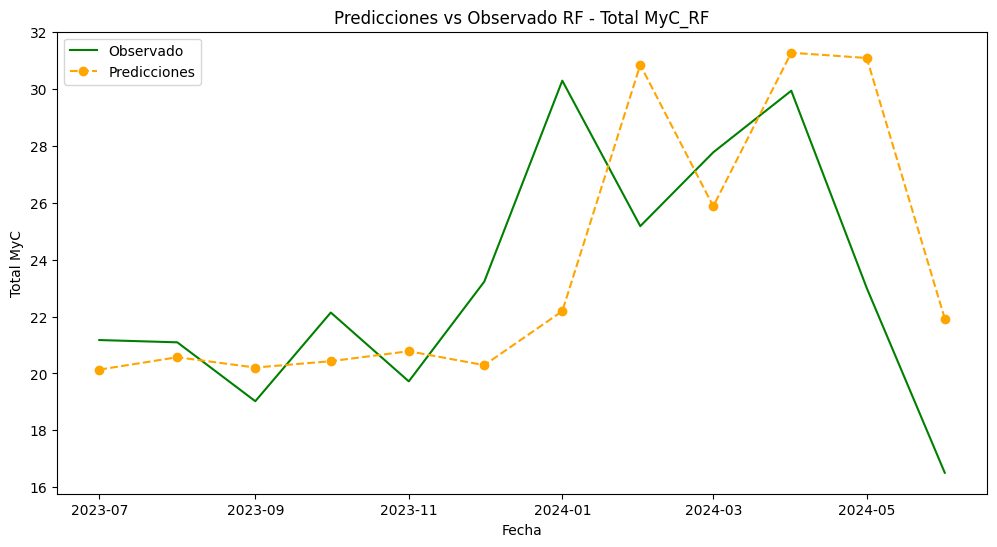


Procesando variable: Total M
Total M_RF - MAE: 2.78, MSE: 12.01, RMSE: 3.47, MAPE: 18.59%, AIC: 53.83, BIC: 59.65


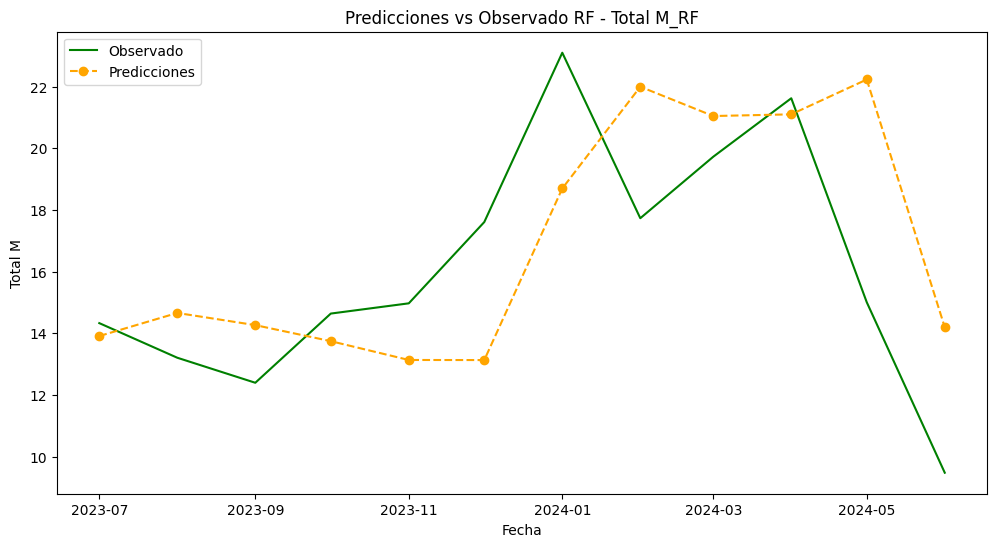


Procesando variable: Total C
Total C_RF - MAE: 0.86, MSE: 0.98, RMSE: 0.99, MAPE: 12.82%, AIC: 23.80, BIC: 29.61


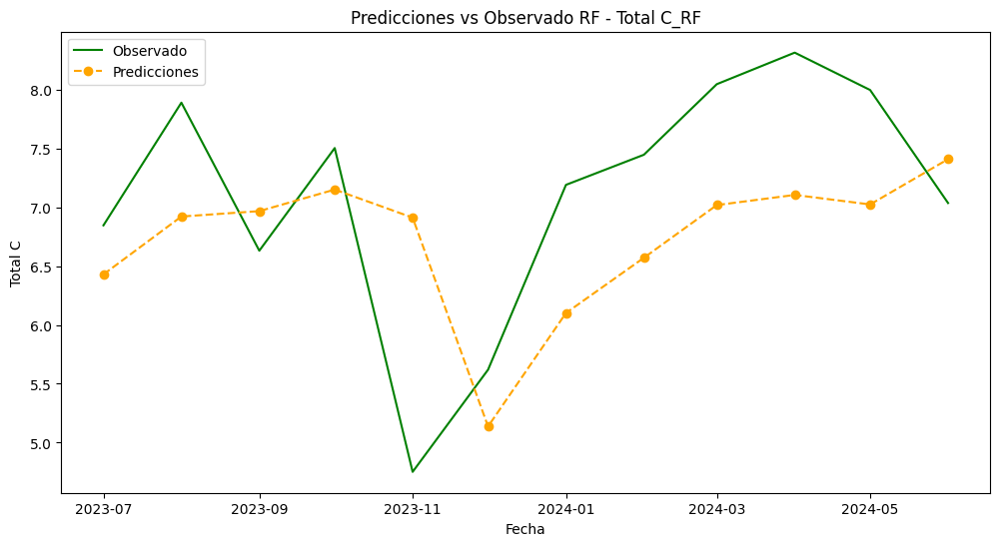

                   MAE        MSE      RMSE       MAPE        AIC        BIC
Total MyC_RF  3.246384  17.774737  4.216010  13.987167  58.533338  64.352218
Total M_RF    2.784363  12.010270  3.465584  18.585086  53.829145  59.648025
Total C_RF    0.855040   0.983111  0.991520  12.818554  23.795603  29.614483


In [178]:
# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)

# Asegurarse de que el índice tenga una frecuencia establecida
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 12

# Modelo Random Forest Regressor
def build_rf_model():
    model = RandomForestRegressor(n_estimators=100, random_state=42)
    return model

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    X = X.reshape(X.shape[0], X.shape[1])  # Redimensionar para que funcione con Random Forest
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    # Construir y entrenar el modelo Random Forest
    model = build_rf_model()
    model.fit(X_train, y_train)
    
    # Hacer predicciones
    predictions = model.predict(X_test)
    predictions = scaler.inverse_transform(predictions.reshape(-1, 1))
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento
    mae = mean_absolute_error(y_test, predictions)
    mse = mean_squared_error(y_test, predictions)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo (aproximadamente)
    k = len(model.feature_importances_)
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_RF"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Imprimir métricas
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Visualizar las predicciones
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions):].to_timestamp(), predictions, label='Predicciones', linestyle='dashed', marker='o', color='orange')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones vs Observado RF - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)


### Modelo 2 RFR


Procesando variable: Total MyC
Total MyC_RF - MAE: 3.25, MSE: 17.77, RMSE: 4.22, MAPE: 13.99%, AIC: 58.53, BIC: 64.35


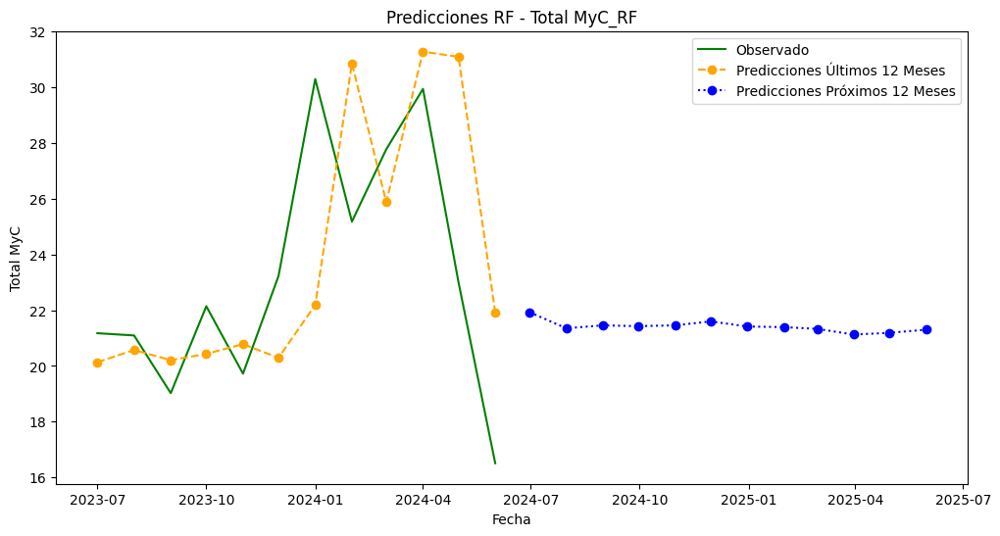


Procesando variable: Total M
Total M_RF - MAE: 2.78, MSE: 12.01, RMSE: 3.47, MAPE: 18.59%, AIC: 53.83, BIC: 59.65


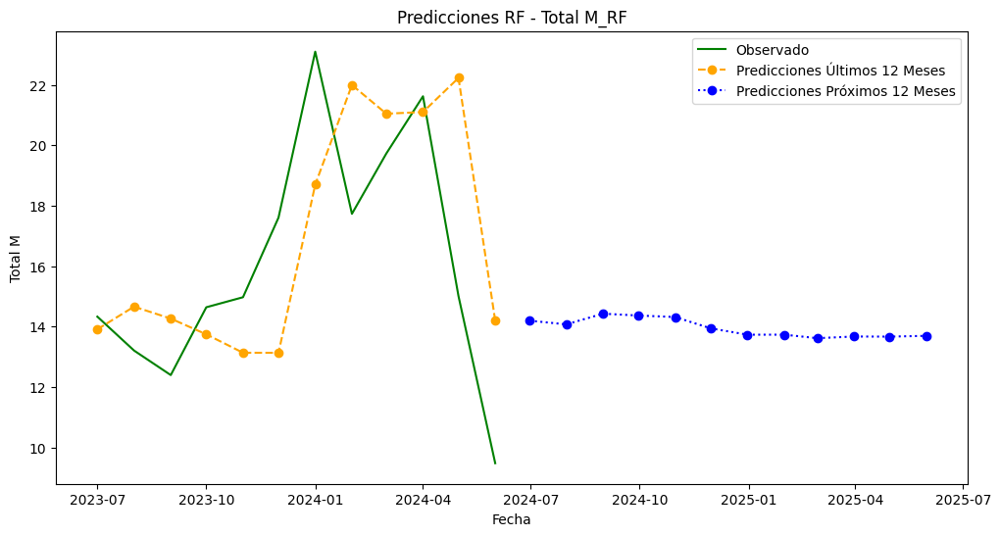


Procesando variable: Total C
Total C_RF - MAE: 0.86, MSE: 0.98, RMSE: 0.99, MAPE: 12.82%, AIC: 23.80, BIC: 29.61


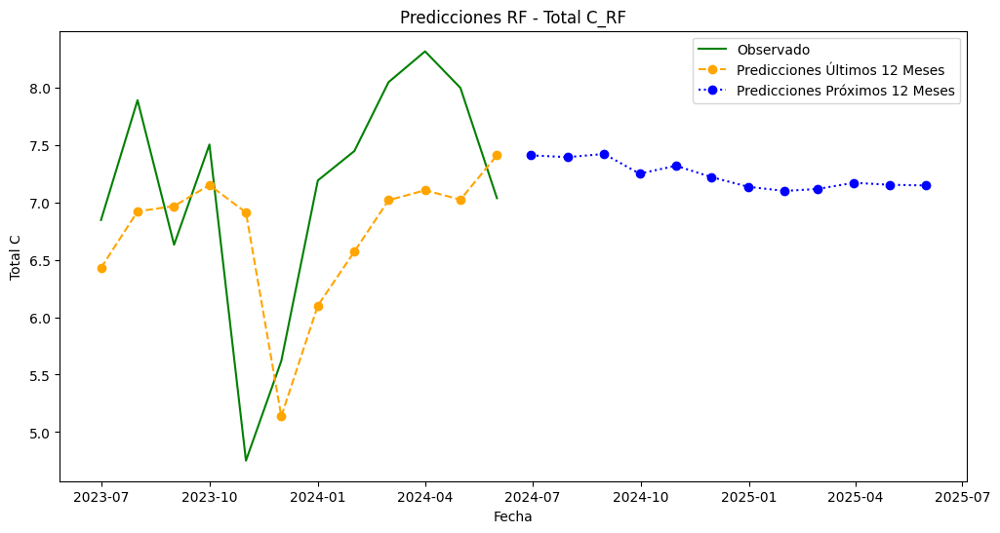

                   MAE        MSE      RMSE       MAPE        AIC        BIC
Total MyC_RF  3.246384  17.774737  4.216010  13.987167  58.533338  64.352218
Total M_RF    2.784363  12.010270  3.465584  18.585086  53.829145  59.648025
Total C_RF    0.855040   0.983111  0.991520  12.818554  23.795603  29.614483


In [179]:
warnings.filterwarnings("ignore")

# Fijar las semillas
np.random.seed(10)
random.seed(10)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)

# Asegurarse de que el índice tenga una frecuencia establecida
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 12

# Modelo Random Forest
def build_rf_model():
    model = RandomForestRegressor(n_estimators=100, random_state=42)
    return model

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    X = X.reshape(X.shape[0], X.shape[1])  # Redimensionar para que funcione con Random Forest
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    # Construir y entrenar el modelo Random Forest
    model = build_rf_model()
    model.fit(X_train, y_train)
    
    # Predicciones sobre los últimos 12 meses
    predictions_last_12 = model.predict(X_test)
    predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12)
    mse = mean_squared_error(y_test, predictions_last_12)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo (aproximadamente)
    k = len(model.feature_importances_)
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * k - 2 * log_likelihood
    bic = k * np.log(n) - 2 * log_likelihood
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_RF"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Predicciones sobre los siguientes 12 meses con reentrenamiento progresivo
    future_predictions = []
    last_sequence = X_test[-1]
    
    for i in range(12):
        # Predecir el próximo valor
        next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH))
        
        # Desnormalizar la predicción
        next_prediction = scaler.inverse_transform(next_prediction.reshape(-1, 1))
        
        # Agregar la predicción a la lista de predicciones futuras
        future_predictions.append(next_prediction[0, 0])
        
        # Actualizar la secuencia: descartar el primer valor y agregar la nueva predicción
        last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH)
        
        # Reentrenar el modelo con la nueva secuencia agregada a los datos de entrenamiento
        X_train = np.append(X_train, last_sequence.reshape(1, SEQ_LENGTH), axis=0)
        y_train = np.append(y_train, scaler.transform(next_prediction).reshape(-1, 1), axis=0)
        
        model.fit(X_train, y_train)

    # Almacenar las predicciones futuras
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions).reshape(-1, 1)
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12):].to_timestamp(), predictions_last_12, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones RF - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)


### Modelo 3 RFR


Procesando variable: Total MyC
Total MyC_RF - MAE: 3.68, MSE: 22.90, RMSE: 4.79, MAPE: 16.02%


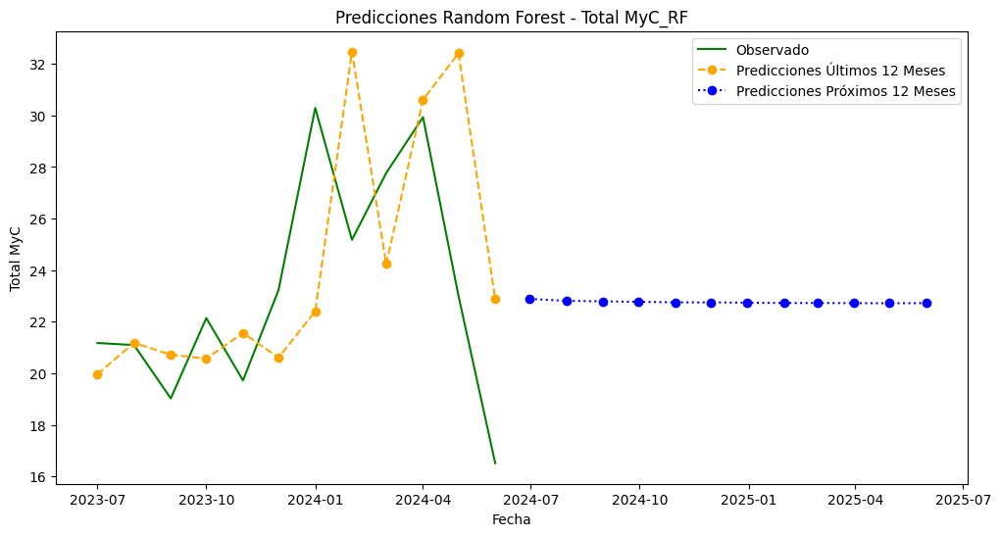


Procesando variable: Total M
Total M_RF - MAE: 3.15, MSE: 15.79, RMSE: 3.97, MAPE: 20.90%


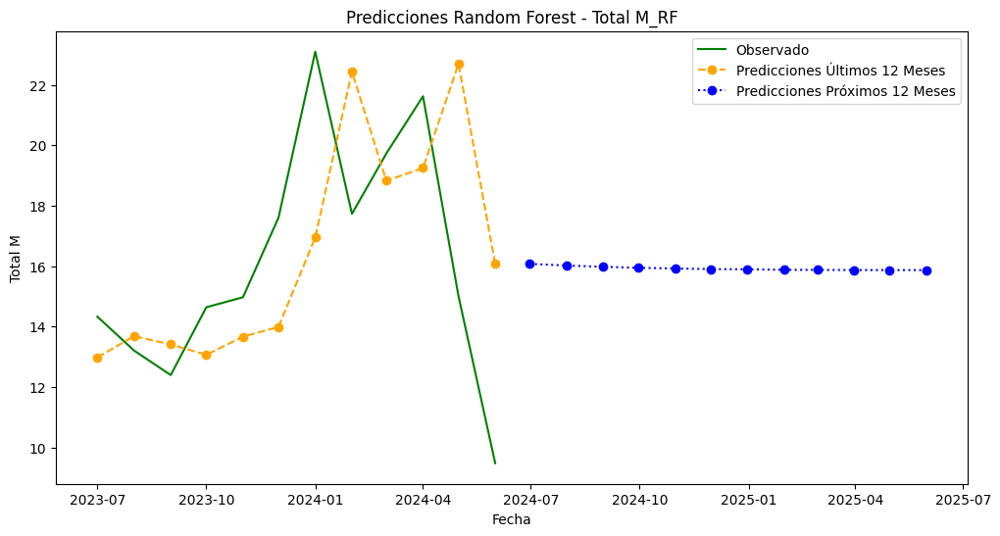


Procesando variable: Total C
Total C_RF - MAE: 0.87, MSE: 1.10, RMSE: 1.05, MAPE: 12.92%


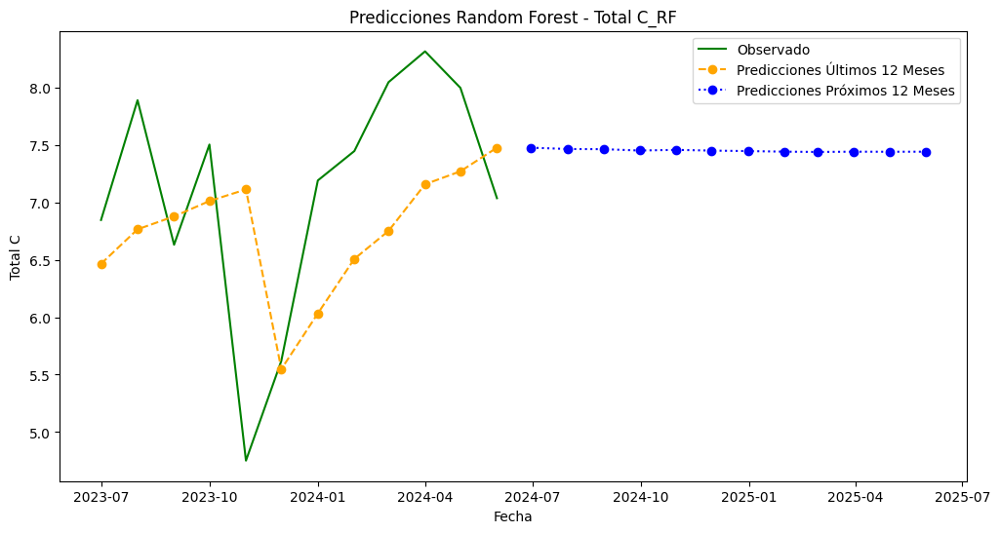

                   MAE        MSE      RMSE       MAPE
Total MyC_RF  3.684167  22.899579  4.785350  16.023623
Total M_RF    3.146653  15.791252  3.973821  20.902046
Total C_RF    0.865623   1.103305  1.050383  12.921529


In [180]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 12

# Número de ejecuciones para promediar
num_runs = 23

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    X = X.reshape(X.shape[0], -1)  # Aplanar los datos para RandomForest
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        set_seeds(run)
        
        # Construir y entrenar el modelo Random Forest
        model = RandomForestRegressor(n_estimators=100, random_state=run)
        model.fit(X_train, y_train)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test)
        predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses con reentrenamiento progresivo
        future_predictions = []
        last_sequence = X_test[-1].reshape(SEQ_LENGTH, 1)
        
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, -1))
            next_prediction = scaler.inverse_transform(next_prediction.reshape(-1, 1))
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
            X_train = np.append(X_train, last_sequence.reshape(1, -1), axis=0)
            y_train = np.append(y_train, scaler.transform(next_prediction).reshape(-1, 1), axis=0)
            model.fit(X_train, y_train)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
    future_predictions_avg = np.mean(all_future_predictions, axis=0)
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_RF"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12_avg
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones Random Forest - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)


### Modelo 4 RFR


Procesando variable: Total MyC
Total MyC_RF - MAE: 3.39, MSE: 21.02, RMSE: 4.59, MAPE: 14.61%


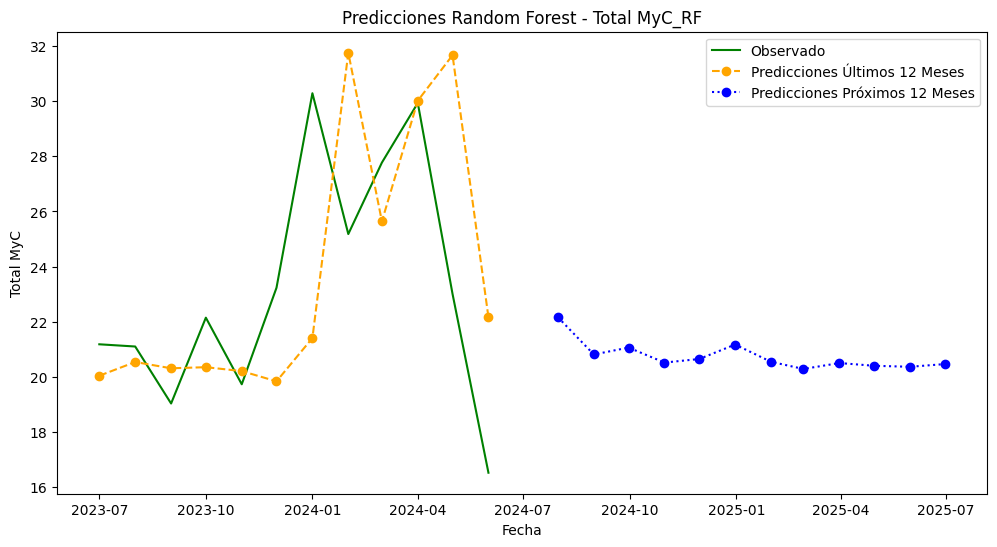


Procesando variable: Total M
Total M_RF - MAE: 2.89, MSE: 13.01, RMSE: 3.61, MAPE: 18.76%


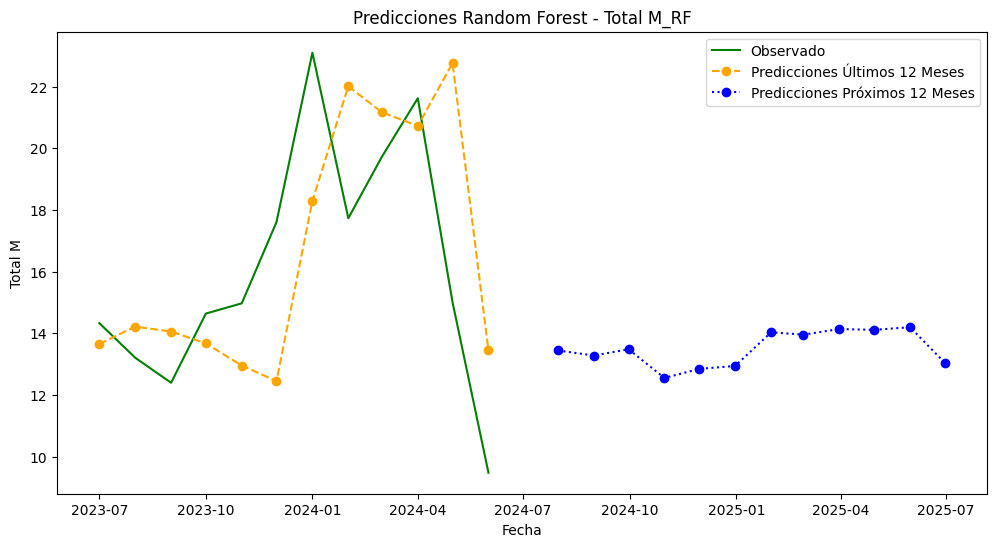


Procesando variable: Total C
Total C_RF - MAE: 0.86, MSE: 1.00, RMSE: 1.00, MAPE: 12.88%


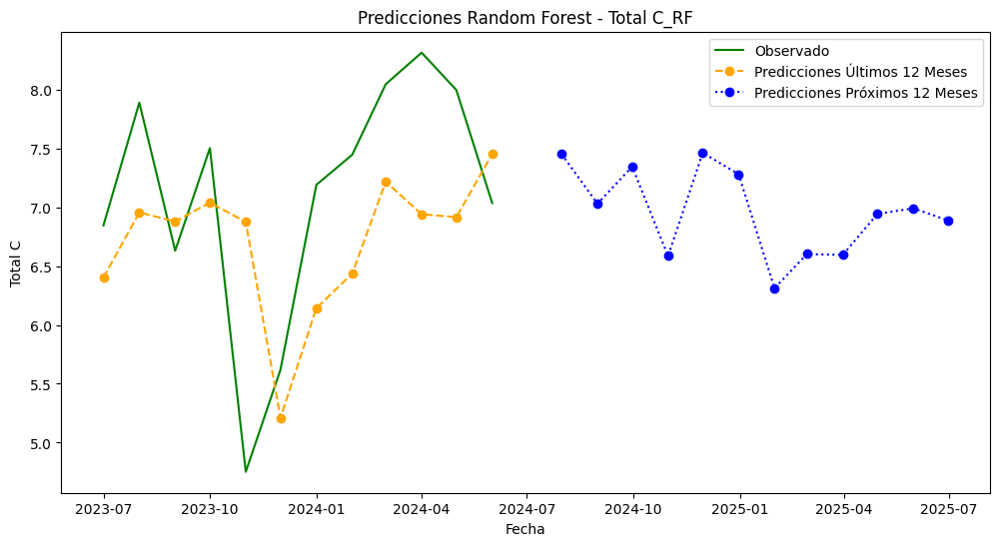

                   MAE        MSE      RMSE       MAPE
Total MyC_RF  3.388901  21.023144  4.585100  14.608522
Total M_RF    2.887416  13.011029  3.607080  18.761840
Total C_RF    0.864635   1.004093  1.002045  12.879558


In [181]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# DataFrames para almacenar las predicciones
predictions_last_12_df = pd.DataFrame()
predictions_future_df = pd.DataFrame()

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 12

# Función para construir el modelo Random Forest
def build_rf_model():
    model = RandomForestRegressor(n_estimators=100, random_state=0)
    return model

# Número de ejecuciones para promediar
num_runs = 5

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        set_seeds(run)
        
        # Construir y entrenar el modelo Random Forest
        model = build_rf_model()
        X_train_reshaped = X_train.reshape(X_train.shape[0], X_train.shape[1])
        model.fit(X_train_reshaped, y_train)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test.reshape(X_test.shape[0], X_test.shape[1]))
        predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses con reentrenamiento progresivo
        future_predictions = []
        last_sequence = X_test[-1]
        
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH))
            next_prediction = scaler.inverse_transform(next_prediction.reshape(-1, 1))
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
    future_predictions_avg = np.mean(all_future_predictions, axis=0)
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Calcular el número de observaciones
    n = len(y_test)
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_RF"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12_avg
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape}
    
    # Guardar predicciones en DataFrames
    predictions_last_12_df[adjusted_var_name] = pd.Series(predictions_last_12_avg.flatten(), index=df.index[-len(y_test):].to_timestamp())
    predictions_future_df[adjusted_var_name] = pd.Series(future_predictions_avg, index=pd.date_range(df.index[-1].to_timestamp(), periods=13, freq='M')[1:])
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=13, freq='M')[1:], future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones Random Forest - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)

# Guardar las predicciones en archivos CSV
predictions_last_12_df.to_csv('predicciones_ultimos_12_meses_rf.csv')
predictions_future_df.to_csv('predicciones_proximos_12_meses_rf.csv')


### Modelo 5 RFR


Procesando variable: Total MyC
Total MyC_RF - MAE: 3.27, MSE: 18.83, RMSE: 4.34, MAPE: 14.24%


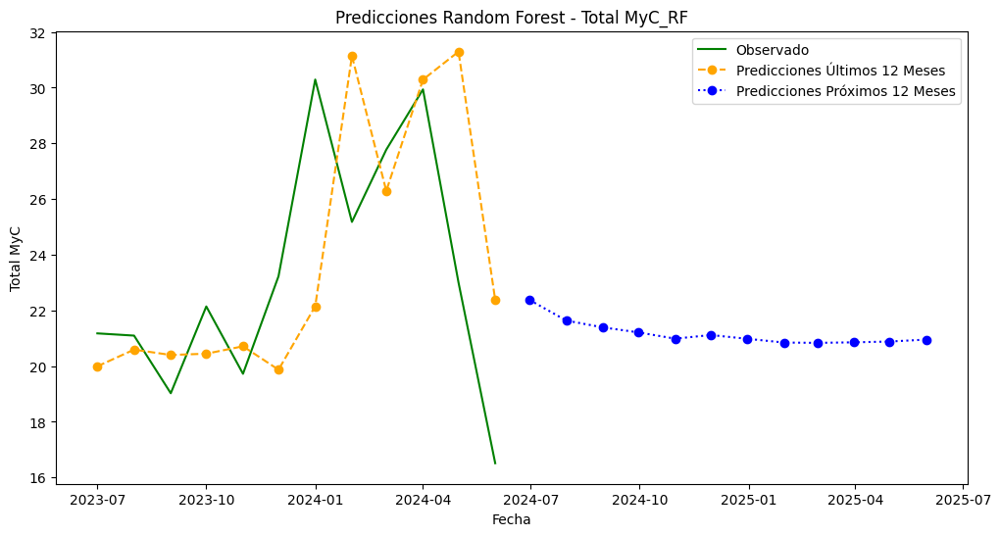


Procesando variable: Total M
Total M_RF - MAE: 2.90, MSE: 12.94, RMSE: 3.60, MAPE: 18.94%


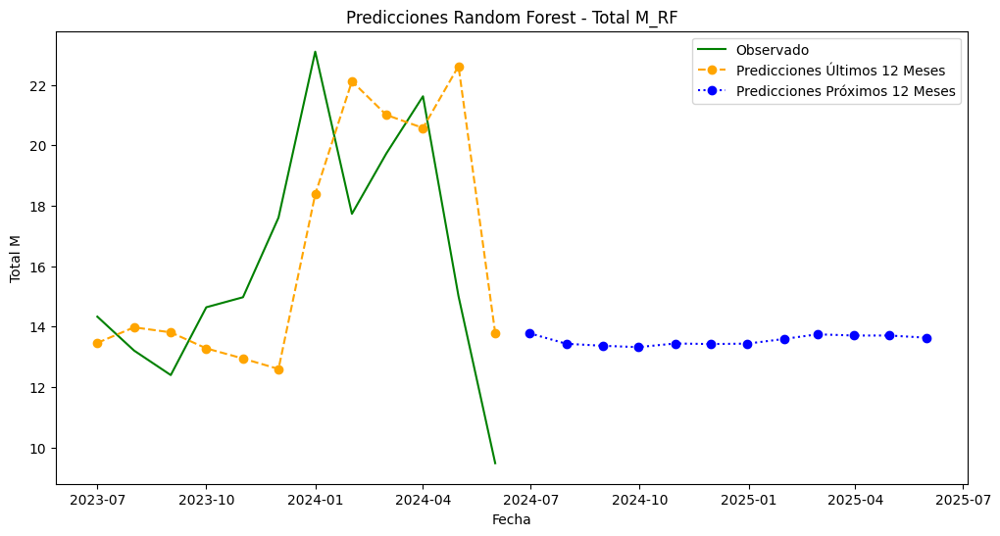


Procesando variable: Total C
Total C_RF - MAE: 0.83, MSE: 0.96, RMSE: 0.98, MAPE: 12.32%


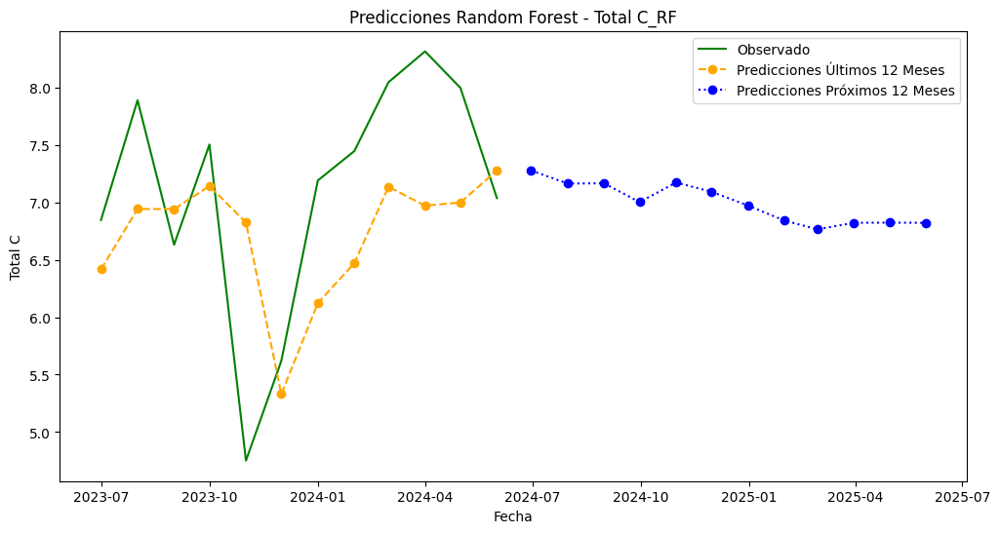

                   MAE        MSE      RMSE       MAPE
Total MyC_RF  3.266180  18.828456  4.339177  14.244899
Total M_RF    2.901528  12.940616  3.597307  18.943411
Total C_RF    0.828587   0.955158  0.977322  12.319066


In [182]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Número de ejecuciones para promediar
num_runs = 5

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    def create_sequences(data, seq_length):
        xs, ys = [], []
        for i in range(len(data) - seq_length):
            x = data[i:i + seq_length]
            y = data[i + seq_length]
            xs.append(x)
            ys.append(y)
        return np.array(xs), np.array(ys)

    # Longitud de la secuencia
    SEQ_LENGTH = 12
    
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        set_seeds(run)
        
        # Construir y entrenar el modelo Random Forest
        model = RandomForestRegressor(n_estimators=100, random_state=run)
        model.fit(X_train.reshape(X_train.shape[0], -1), y_train)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test.reshape(X_test.shape[0], -1))
        predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses con todo el conjunto de datos
        X_full, y_full = X, y  # Usar todo el dataset para el futuro
        future_predictions = []
        last_sequence = X_full[-1]
        
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, -1))
            next_prediction = scaler.inverse_transform(next_prediction.reshape(-1, 1))
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
            X_full = np.append(X_full, last_sequence.reshape(1, SEQ_LENGTH, 1), axis=0)
            y_full = np.append(y_full, scaler.transform(next_prediction).reshape(-1, 1), axis=0)
            model.fit(X_full.reshape(X_full.shape[0], -1), y_full)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
    future_predictions_avg = np.mean(all_future_predictions, axis=0)
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_RF"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12_avg
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones Random Forest - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)


### Modelo 6 RFR


Procesando variable: Total MyC
Total MyC_RF - MAE: 3.25, MSE: 16.85, RMSE: 4.11, MAPE: 14.50%, AIC: 33.90, BIC: 33.90


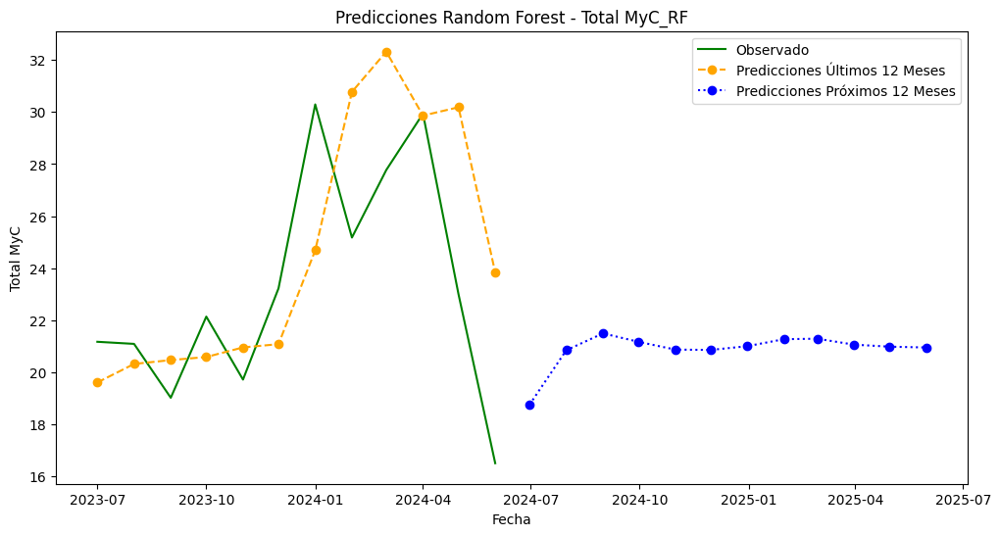


Procesando variable: Total M
Total M_RF - MAE: 3.03, MSE: 15.15, RMSE: 3.89, MAPE: 20.52%, AIC: 32.61, BIC: 32.61


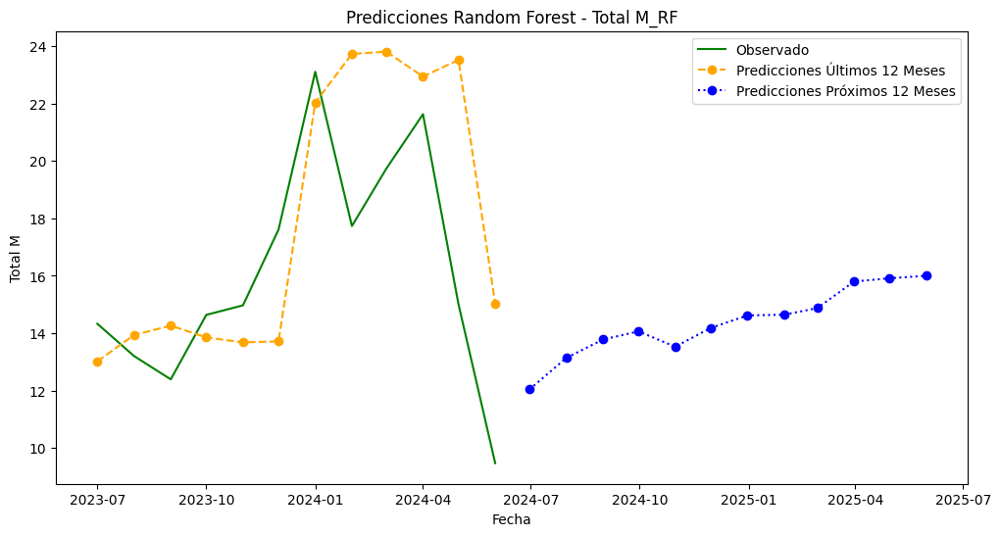


Procesando variable: Total C
Total C_RF - MAE: 0.66, MSE: 0.87, RMSE: 0.94, MAPE: 10.30%, AIC: -1.61, BIC: -1.61


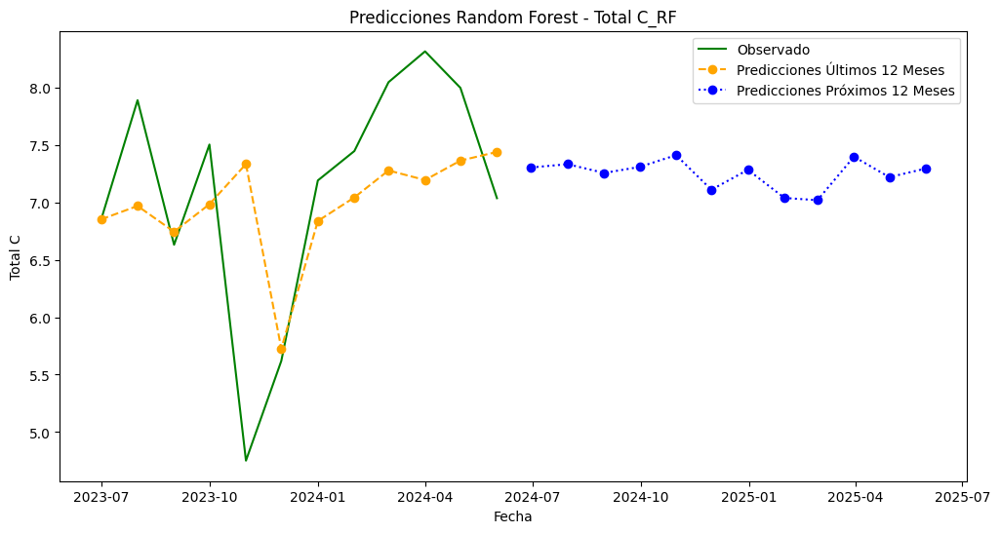

                   MAE        MSE      RMSE       MAPE        AIC        BIC
Total MyC_RF  3.253015  16.854235  4.105391  14.504402  33.895224  33.895224
Total M_RF    3.032180  15.145382  3.891707  20.522655  32.612348  32.612348
Total C_RF    0.660410   0.874736  0.935273  10.296320  -1.606001  -1.606001


In [183]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 48

# Número de ejecuciones para promediar
num_runs = 5

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        set_seeds(run)
        
        # Construir y entrenar el modelo Random Forest Regressor
        model = RandomForestRegressor(n_estimators=100, random_state=run)
        model.fit(X_train.reshape(X_train.shape[0], -1), y_train)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test.reshape(X_test.shape[0], -1))
        predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses con el último dato real observado
        last_observed = scaled_data[-1]  # Último dato real observado
        last_sequence = np.append(X_test[-1][1:], last_observed).reshape(SEQ_LENGTH, 1)
        
        future_predictions = []
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, -1))
            next_prediction = scaler.inverse_transform(next_prediction.reshape(-1, 1))
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
    future_predictions_avg = np.mean(all_future_predictions, axis=0)
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Calcular el número de parámetros en el modelo (Random Forest no tiene "parámetros" tradicionales, así que se omite k)
    n = len(y_test)
    
    # Calcular la log-verosimilitud aproximada
    log_likelihood = -n / 2 * np.log(mse)
    
    # Calcular AIC y BIC
    aic = 2 * 0 - 2 * log_likelihood  # En lugar de 2k, aquí se usa 0 porque Random Forest no tiene un conteo de parámetros tradicional
    bic = 0 * np.log(n) - 2 * log_likelihood  # Lo mismo para BIC
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_RF"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12_avg
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones Random Forest - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)


### Modelo 7 RFR

Se realiza modelo con ventanas temporales de [6, 12, 18, 24, 36, 48] meses


Procesando variable: Total MyC

  Longitud de ventana: 6 meses
Total MyC_RF_6m - MAE: 4.12, MSE: 29.09, RMSE: 5.39, MAPE: 17.47%, AIC: 40.44, BIC: 40.44


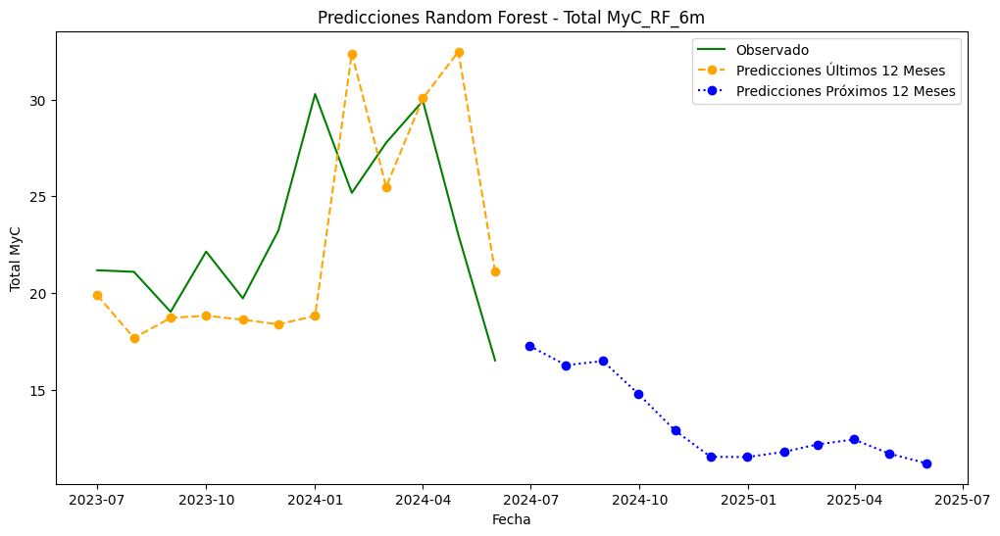


  Longitud de ventana: 12 meses
Total MyC_RF_12m - MAE: 3.27, MSE: 18.83, RMSE: 4.34, MAPE: 14.24%, AIC: 35.22, BIC: 35.22


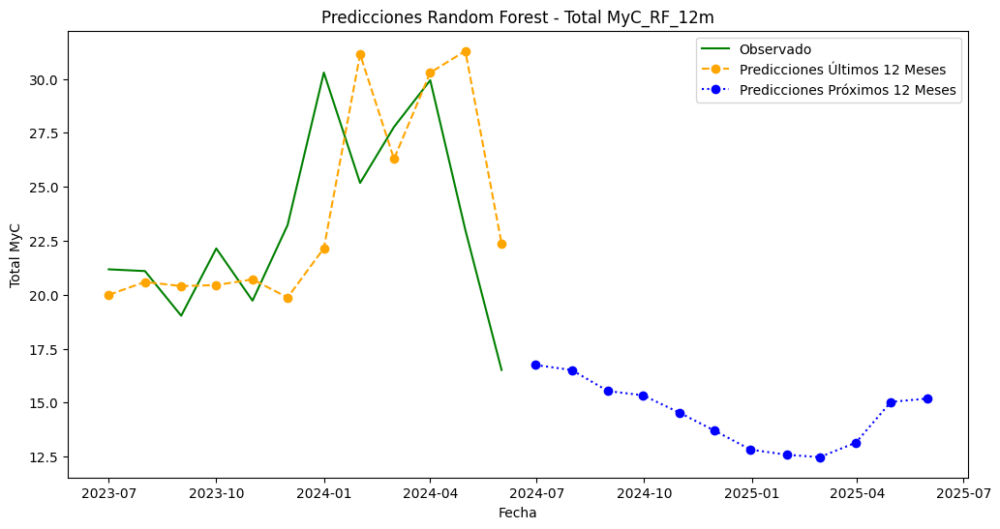


  Longitud de ventana: 18 meses
Total MyC_RF_18m - MAE: 3.04, MSE: 14.31, RMSE: 3.78, MAPE: 13.06%, AIC: 31.93, BIC: 31.93


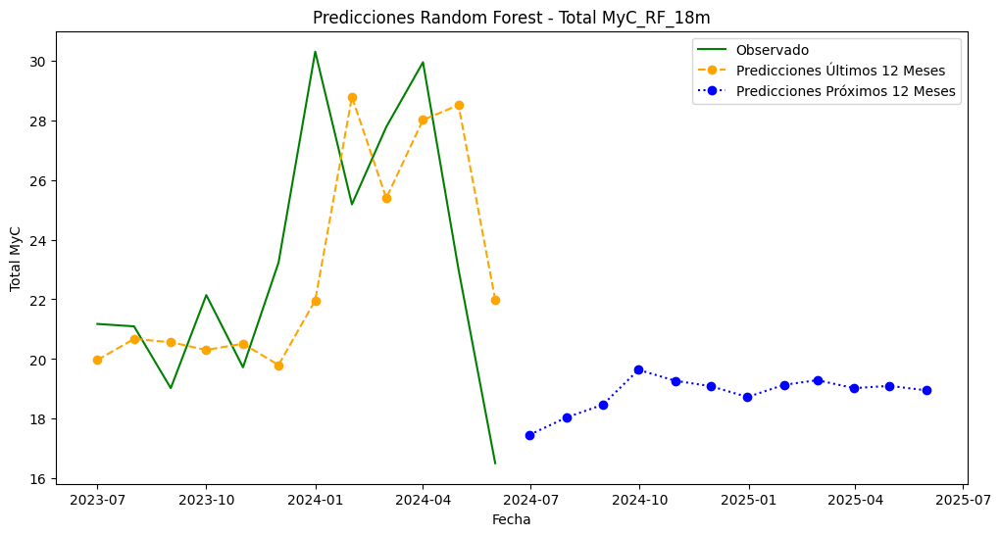


  Longitud de ventana: 24 meses
Total MyC_RF_24m - MAE: 3.36, MSE: 19.37, RMSE: 4.40, MAPE: 14.90%, AIC: 35.56, BIC: 35.56


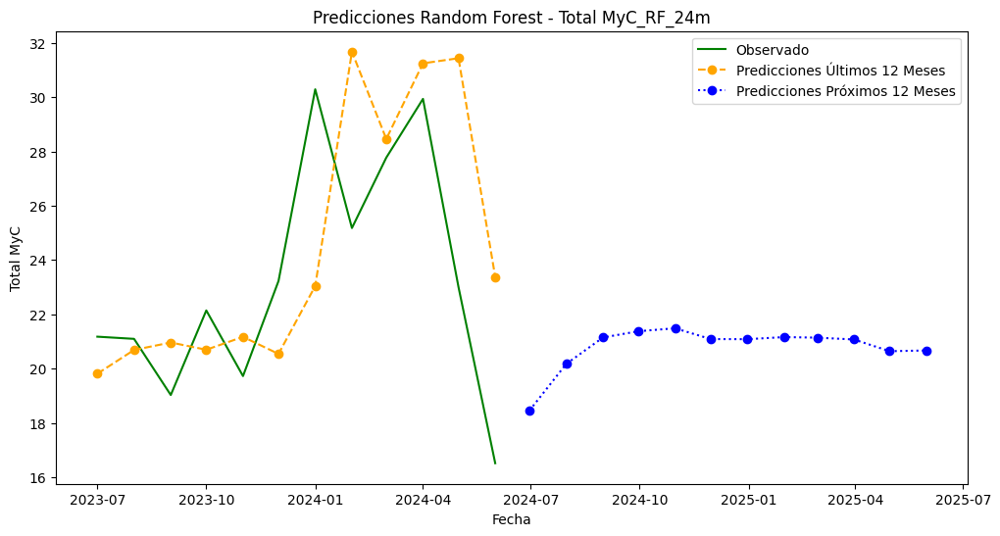


  Longitud de ventana: 36 meses
Total MyC_RF_36m - MAE: 3.41, MSE: 19.52, RMSE: 4.42, MAPE: 15.19%, AIC: 35.66, BIC: 35.66


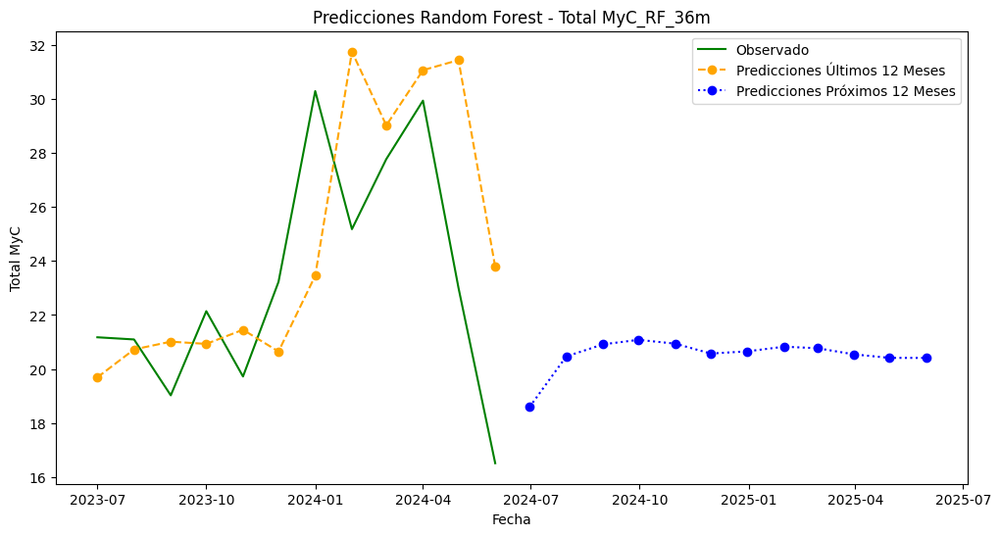


  Longitud de ventana: 48 meses
Total MyC_RF_48m - MAE: 3.25, MSE: 16.85, RMSE: 4.11, MAPE: 14.50%, AIC: 33.90, BIC: 33.90


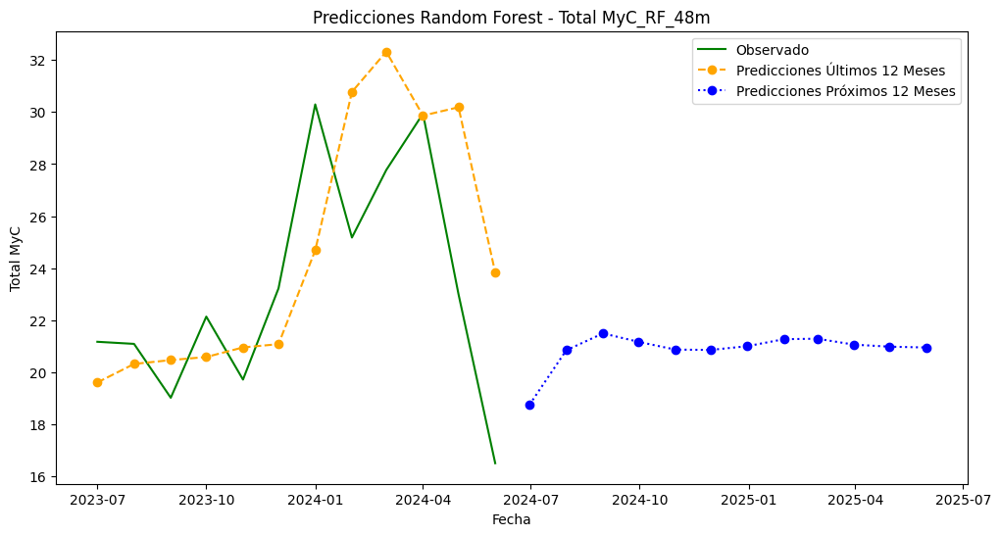


Procesando variable: Total M

  Longitud de ventana: 6 meses
Total M_RF_6m - MAE: 3.37, MSE: 16.46, RMSE: 4.06, MAPE: 21.52%, AIC: 33.61, BIC: 33.61


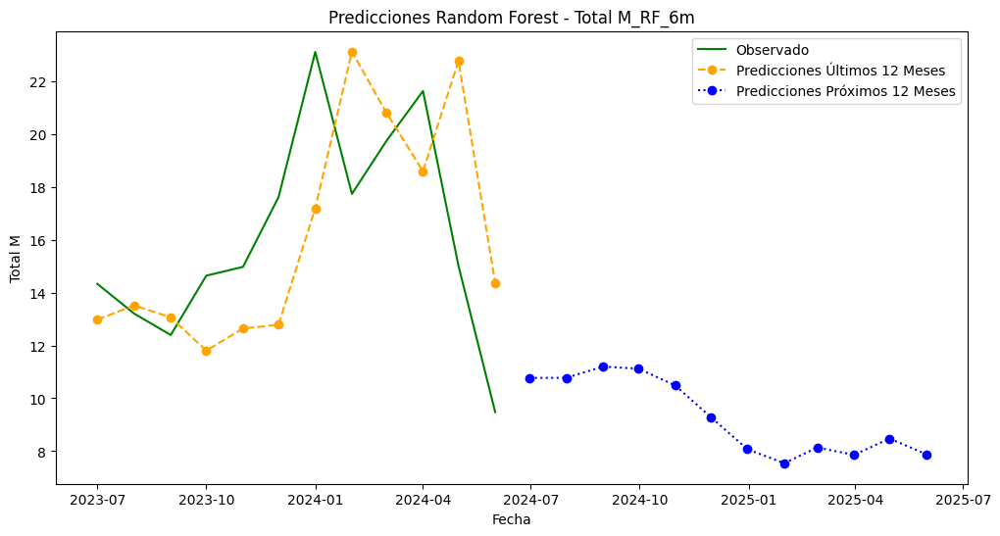


  Longitud de ventana: 12 meses
Total M_RF_12m - MAE: 2.90, MSE: 12.94, RMSE: 3.60, MAPE: 18.94%, AIC: 30.72, BIC: 30.72


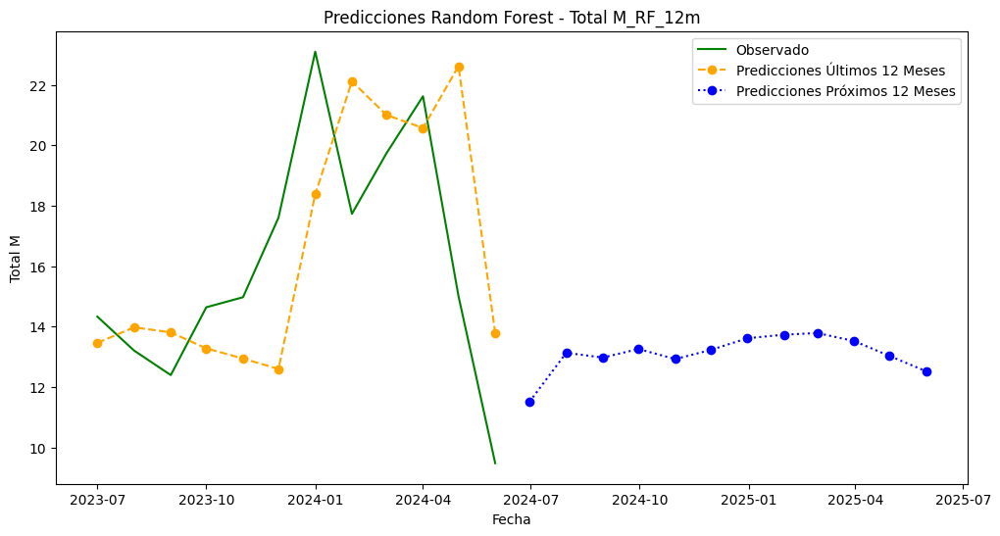


  Longitud de ventana: 18 meses
Total M_RF_18m - MAE: 2.63, MSE: 10.95, RMSE: 3.31, MAPE: 17.74%, AIC: 28.71, BIC: 28.71


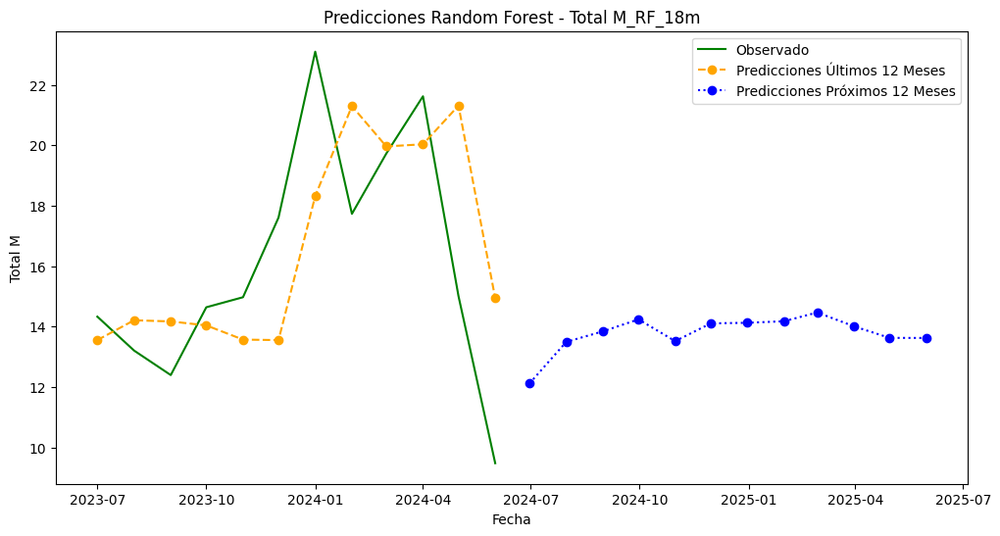


  Longitud de ventana: 24 meses
Total M_RF_24m - MAE: 3.07, MSE: 16.09, RMSE: 4.01, MAPE: 20.84%, AIC: 33.34, BIC: 33.34


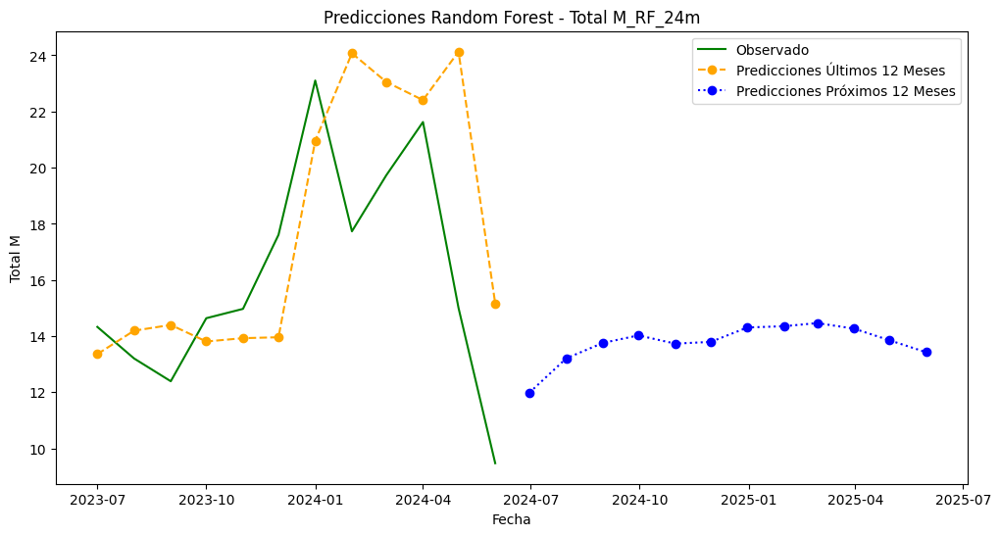


  Longitud de ventana: 36 meses
Total M_RF_36m - MAE: 3.28, MSE: 17.90, RMSE: 4.23, MAPE: 22.18%, AIC: 34.62, BIC: 34.62


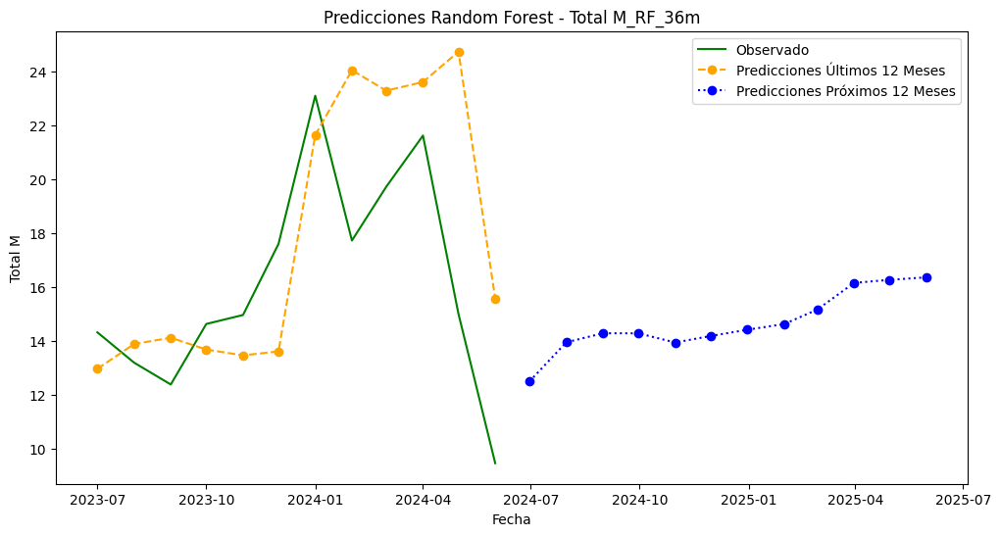


  Longitud de ventana: 48 meses
Total M_RF_48m - MAE: 3.03, MSE: 15.15, RMSE: 3.89, MAPE: 20.52%, AIC: 32.61, BIC: 32.61


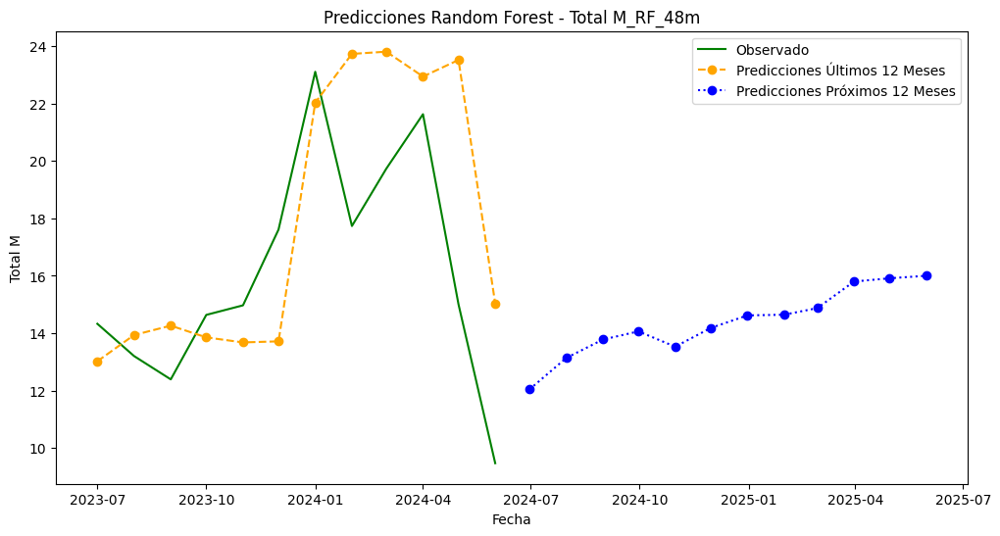


Procesando variable: Total C

  Longitud de ventana: 6 meses
Total C_RF_6m - MAE: 0.90, MSE: 1.27, RMSE: 1.13, MAPE: 13.24%, AIC: 2.84, BIC: 2.84


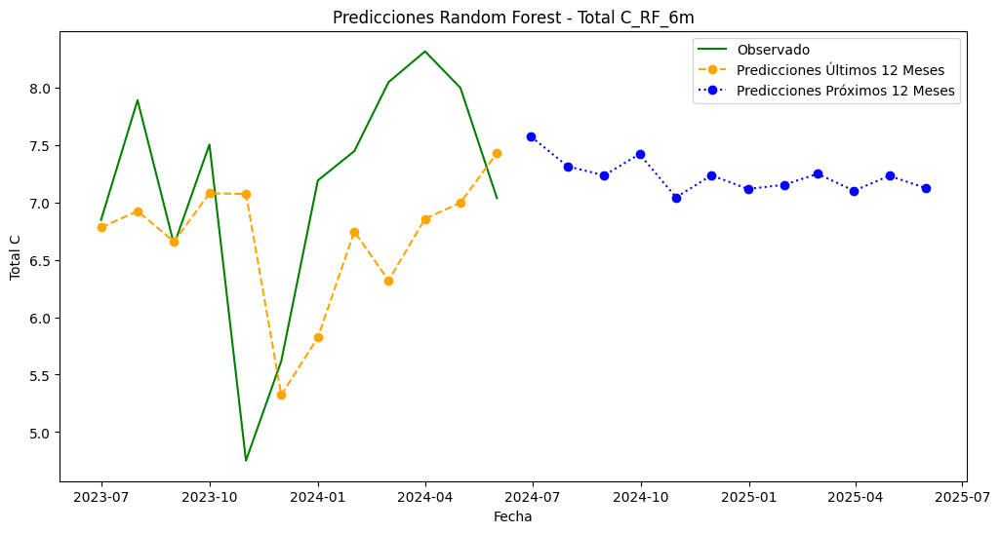


  Longitud de ventana: 12 meses
Total C_RF_12m - MAE: 0.83, MSE: 0.96, RMSE: 0.98, MAPE: 12.32%, AIC: -0.55, BIC: -0.55


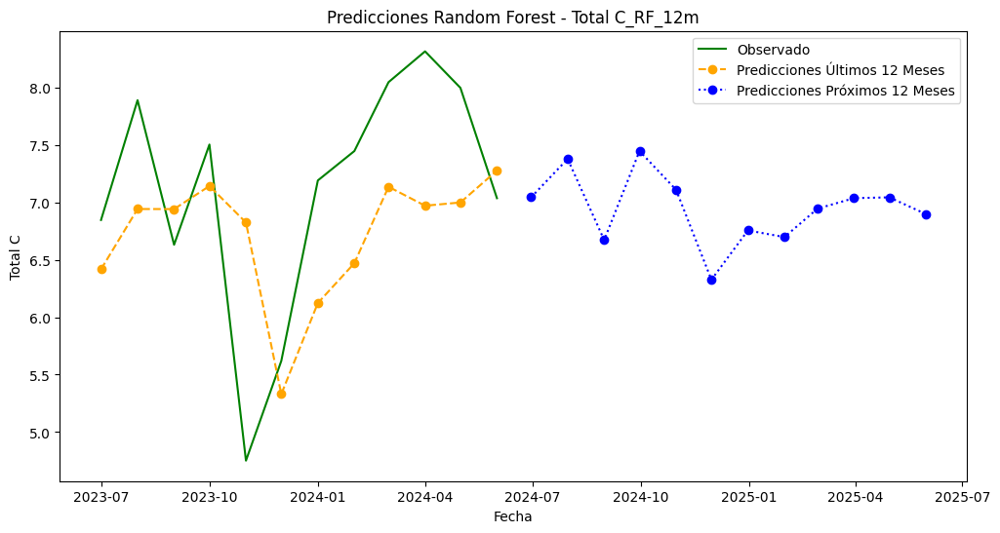


  Longitud de ventana: 18 meses
Total C_RF_18m - MAE: 0.80, MSE: 0.93, RMSE: 0.96, MAPE: 12.03%, AIC: -0.88, BIC: -0.88


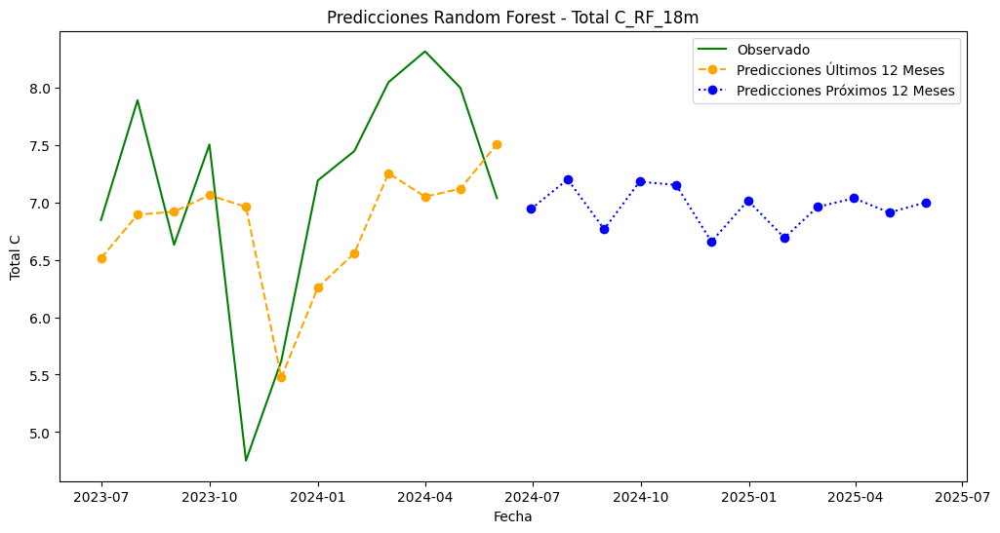


  Longitud de ventana: 24 meses
Total C_RF_24m - MAE: 0.68, MSE: 0.78, RMSE: 0.88, MAPE: 10.46%, AIC: -3.02, BIC: -3.02


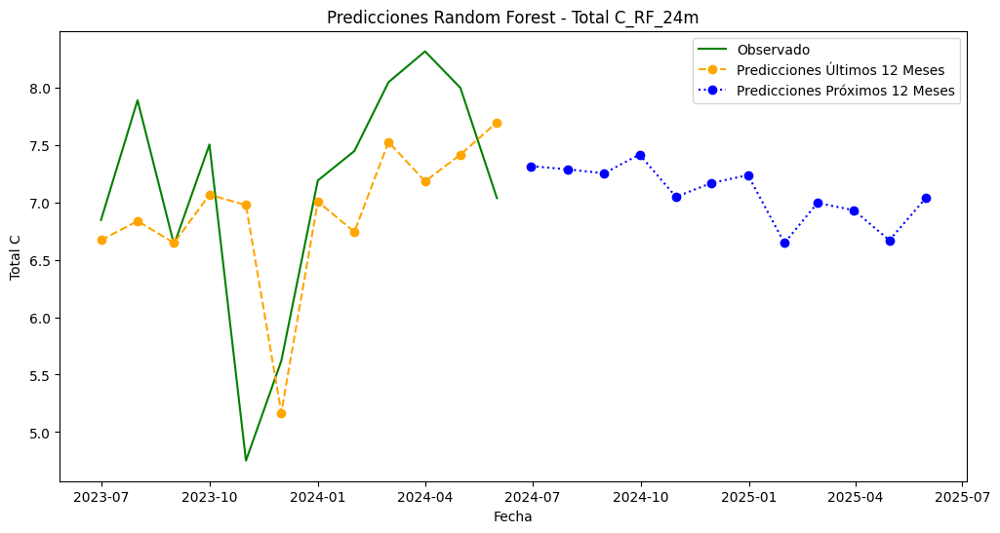


  Longitud de ventana: 36 meses
Total C_RF_36m - MAE: 0.69, MSE: 0.93, RMSE: 0.96, MAPE: 10.83%, AIC: -0.92, BIC: -0.92


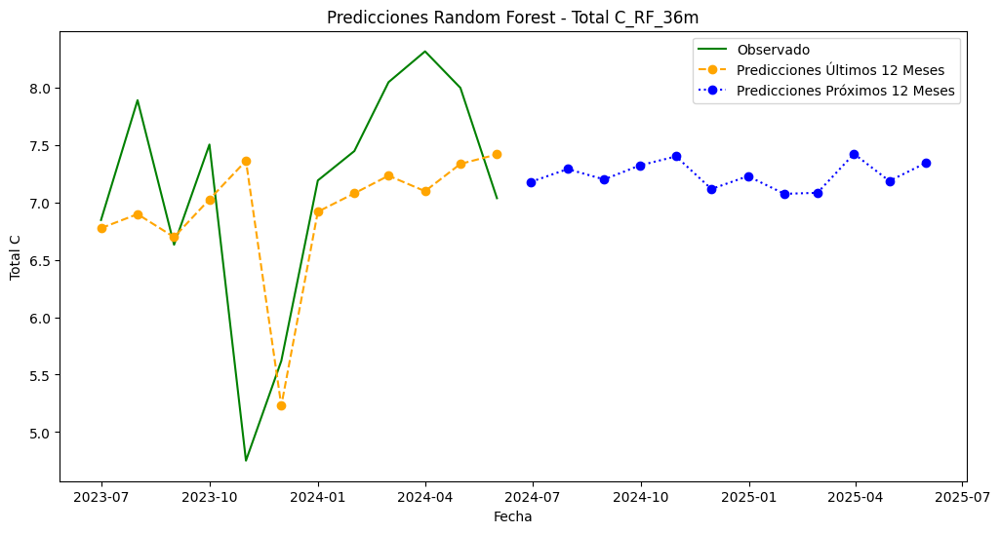


  Longitud de ventana: 48 meses
Total C_RF_48m - MAE: 0.66, MSE: 0.87, RMSE: 0.94, MAPE: 10.30%, AIC: -1.61, BIC: -1.61


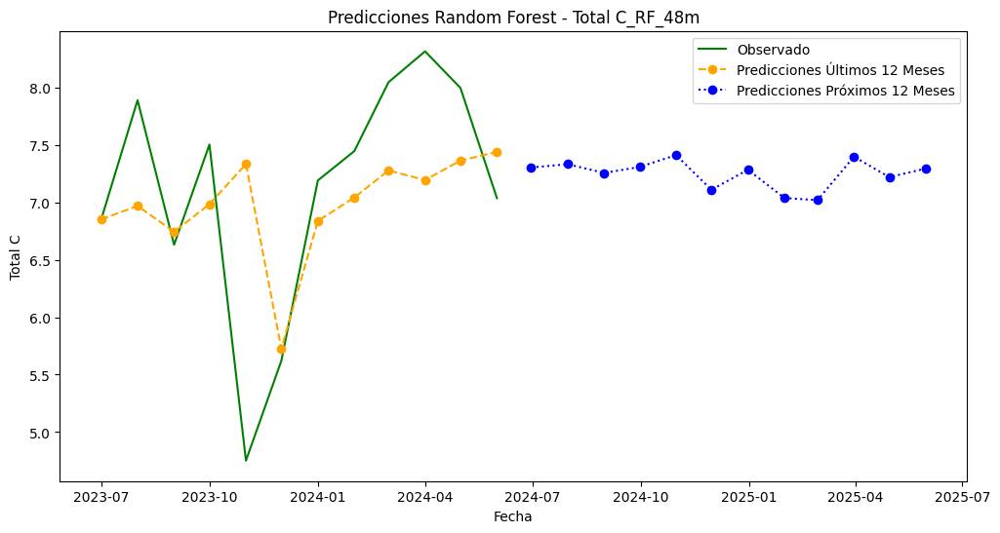

                       MAE        MSE      RMSE       MAPE        AIC  \
Total MyC_RF_6m   4.122413  29.087322  5.393266  17.466041  40.443629   
Total MyC_RF_12m  3.266180  18.828456  4.339177  14.244899  35.224432   
Total MyC_RF_18m  3.037007  14.309911  3.782844  13.062494  31.931429   
Total MyC_RF_24m  3.361260  19.367640  4.400868  14.901929  35.563243   
Total MyC_RF_36m  3.405289  19.523481  4.418538  15.186019  35.659415   
Total MyC_RF_48m  3.253015  16.854235  4.105391  14.504402  33.895224   
Total M_RF_6m     3.365709  16.464652  4.057666  21.524005  33.614589   
Total M_RF_12m    2.901528  12.940616  3.597307  18.943411  30.724451   
Total M_RF_18m    2.630052  10.945308  3.308369  17.739928  28.714930   
Total M_RF_24m    3.073540  16.088448  4.011041  20.839572  33.337218   
Total M_RF_36m    3.279658  17.901211  4.230982  22.175586  34.618420   
Total M_RF_48m    3.032180  15.145382  3.891707  20.522655  32.612348   
Total C_RF_6m     0.895293   1.267431  1.125802  13

In [184]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Lista de longitudes de ventana para probar
window_lengths = [6, 12, 18, 24, 36, 48]

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Número de ejecuciones para promediar
num_runs = 5

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    for SEQ_LENGTH in window_lengths:
        print(f'\n  Longitud de ventana: {SEQ_LENGTH} meses')
        
        # Crear secuencias de entrada y salida
        X, y = create_sequences(scaled_data, SEQ_LENGTH)
        
        # Determinar el índice para los últimos 12 meses de datos
        test_start_index = len(X) - 12
        
        # Dividir los datos en entrenamiento y prueba
        X_train, X_test = X[:test_start_index], X[test_start_index:]
        y_train, y_test = y[:test_start_index], y[test_start_index:]
        
        all_predictions_last_12 = []
        all_future_predictions = []
        
        for run in range(num_runs):
            # Fijar la semilla para esta ejecución
            set_seeds(run)
            
            # Construir y entrenar el modelo Random Forest Regressor
            model = RandomForestRegressor(n_estimators=100, random_state=run)
            model.fit(X_train.reshape(X_train.shape[0], -1), y_train)
            
            # Predicciones sobre los últimos 12 meses
            predictions_last_12 = model.predict(X_test.reshape(X_test.shape[0], -1))
            predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
            all_predictions_last_12.append(predictions_last_12)
            
            # Predicciones sobre los siguientes 12 meses con el último dato real observado
            last_observed = scaled_data[-1]  # Último dato real observado
            last_sequence = np.append(X_test[-1][1:], last_observed).reshape(SEQ_LENGTH, 1)
            
            future_predictions = []
            for i in range(12):
                next_prediction = model.predict(last_sequence.reshape(1, -1))
                next_prediction = scaler.inverse_transform(next_prediction.reshape(-1, 1))
                future_predictions.append(next_prediction[0, 0])
                last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
            
            all_future_predictions.append(future_predictions)
        
        # Promediar las predicciones
        predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
        future_predictions_avg = np.mean(all_future_predictions, axis=0)
        
        # Desnormalizar los datos reales de prueba
        y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
        
        # Calcular métricas de rendimiento para los últimos 12 meses
        mae = mean_absolute_error(y_test, predictions_last_12_avg)
        mse = mean_squared_error(y_test, predictions_last_12_avg)
        rmse = np.sqrt(mse)
        mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
        
        # Calcular el número de parámetros en el modelo (Random Forest no tiene "parámetros" tradicionales, así que se omite k)
        n = len(y_test)
        
        # Calcular la log-verosimilitud aproximada
        log_likelihood = -n / 2 * np.log(mse)
        
        # Calcular AIC y BIC
        aic = 2 * 0 - 2 * log_likelihood  # En lugar de 2k, aquí se usa 0 porque Random Forest no tiene un conteo de parámetros tradicional
        bic = 0 * np.log(n) - 2 * log_likelihood  # Lo mismo para BIC
        
        # Nombre ajustado para la variable
        adjusted_var_name = f"{var}_RF_{SEQ_LENGTH}m"
        
        # Almacenar las predicciones y métricas en los diccionarios
        predictions_dict[adjusted_var_name] = predictions_last_12_avg
        predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
        metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
        
        # Imprimir métricas para los últimos 12 meses
        print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
        
        # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
        plt.figure(figsize=(12, 6))
        plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
        plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
        plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
        plt.xlabel('Fecha')
        plt.ylabel(var)
        plt.title(f'Predicciones Random Forest - {adjusted_var_name}')
        plt.legend()
        plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)


### Prueba guardado


Procesando variable: Total MyC

  Longitud de ventana: 6 meses
Total MyC_RF_6m - MAE: 4.12, MSE: 29.09, RMSE: 5.39, MAPE: 17.47%, AIC: 40.44, BIC: 40.44


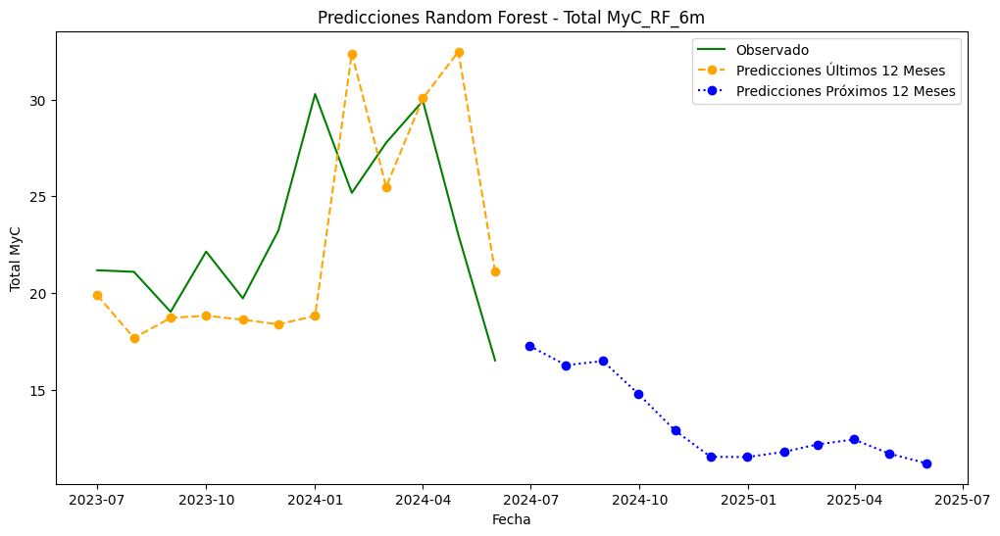


  Longitud de ventana: 12 meses
Total MyC_RF_12m - MAE: 3.27, MSE: 18.83, RMSE: 4.34, MAPE: 14.24%, AIC: 35.22, BIC: 35.22


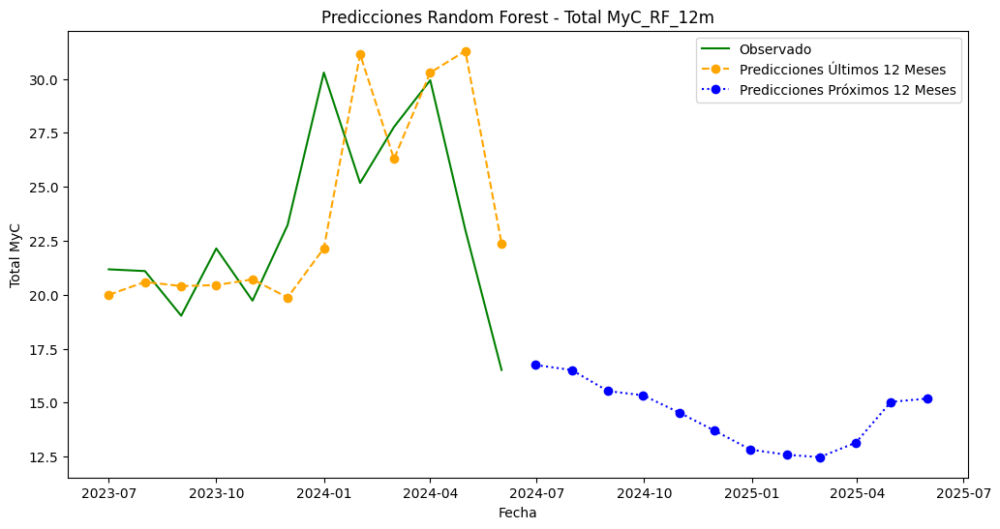


  Longitud de ventana: 18 meses
Total MyC_RF_18m - MAE: 3.04, MSE: 14.31, RMSE: 3.78, MAPE: 13.06%, AIC: 31.93, BIC: 31.93


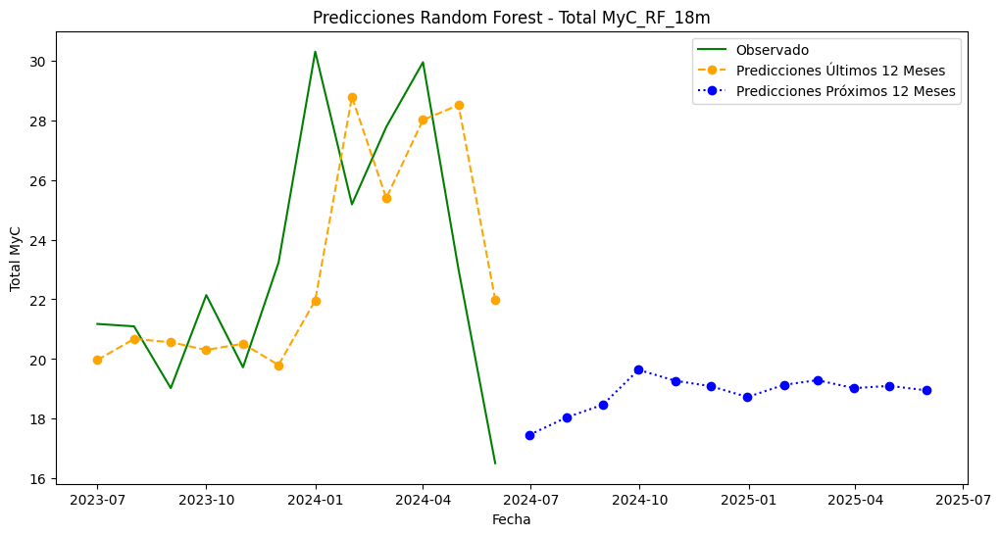


  Longitud de ventana: 24 meses
Total MyC_RF_24m - MAE: 3.36, MSE: 19.37, RMSE: 4.40, MAPE: 14.90%, AIC: 35.56, BIC: 35.56


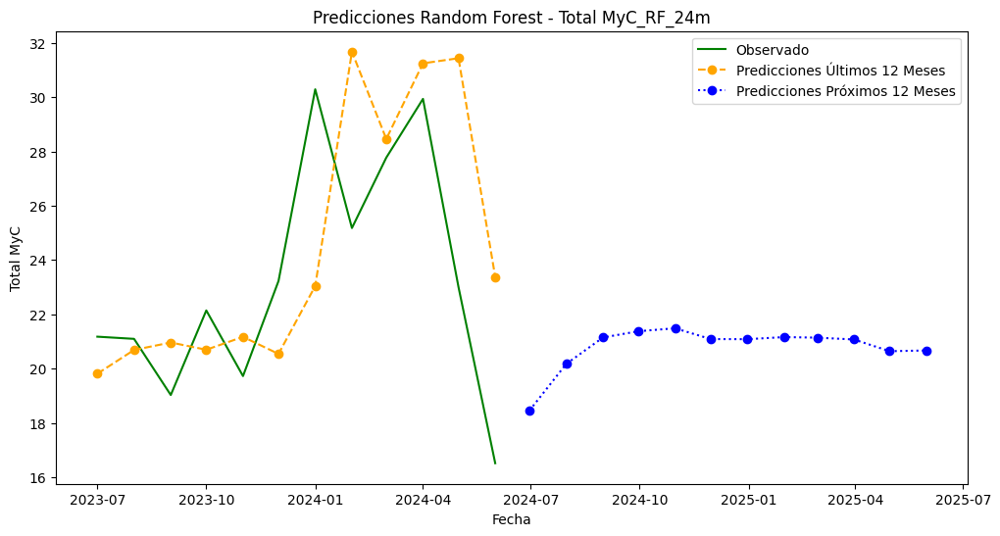


  Longitud de ventana: 36 meses
Total MyC_RF_36m - MAE: 3.41, MSE: 19.52, RMSE: 4.42, MAPE: 15.19%, AIC: 35.66, BIC: 35.66


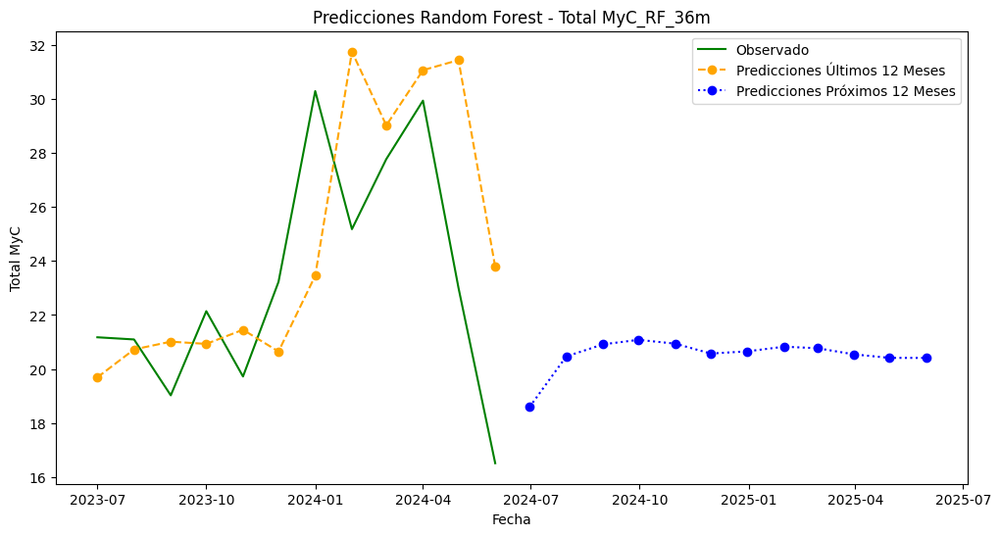


  Longitud de ventana: 48 meses
Total MyC_RF_48m - MAE: 3.25, MSE: 16.85, RMSE: 4.11, MAPE: 14.50%, AIC: 33.90, BIC: 33.90


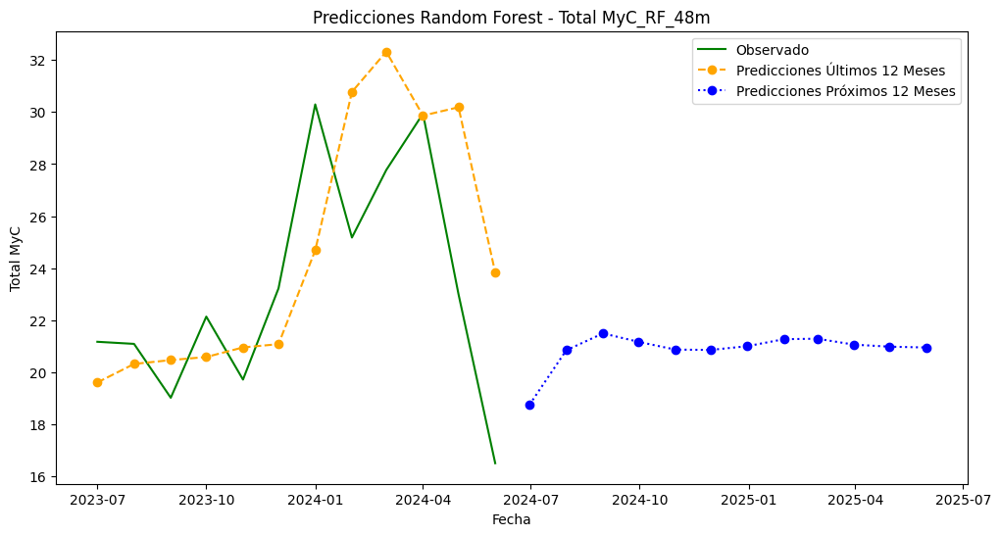


Procesando variable: Total M

  Longitud de ventana: 6 meses
Total M_RF_6m - MAE: 3.37, MSE: 16.46, RMSE: 4.06, MAPE: 21.52%, AIC: 33.61, BIC: 33.61


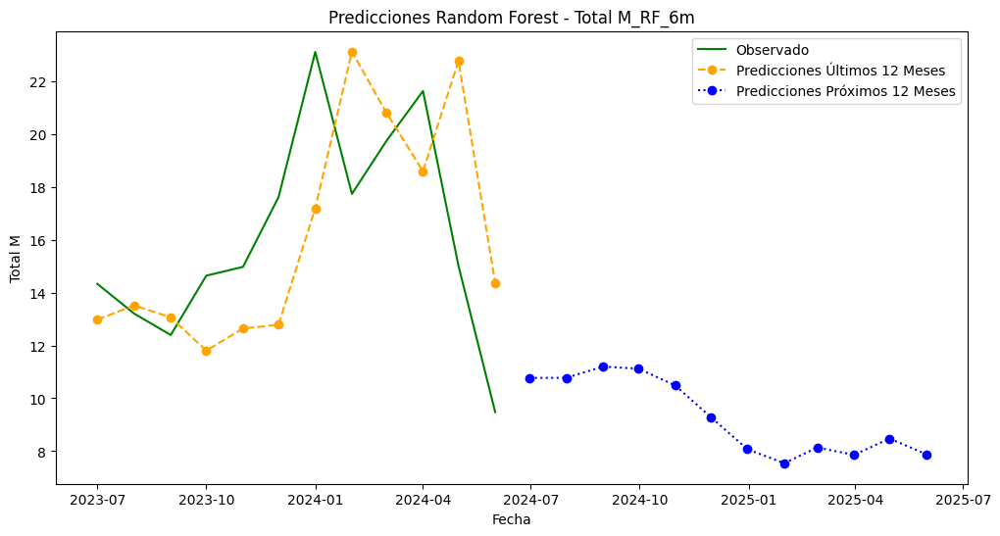


  Longitud de ventana: 12 meses
Total M_RF_12m - MAE: 2.90, MSE: 12.94, RMSE: 3.60, MAPE: 18.94%, AIC: 30.72, BIC: 30.72


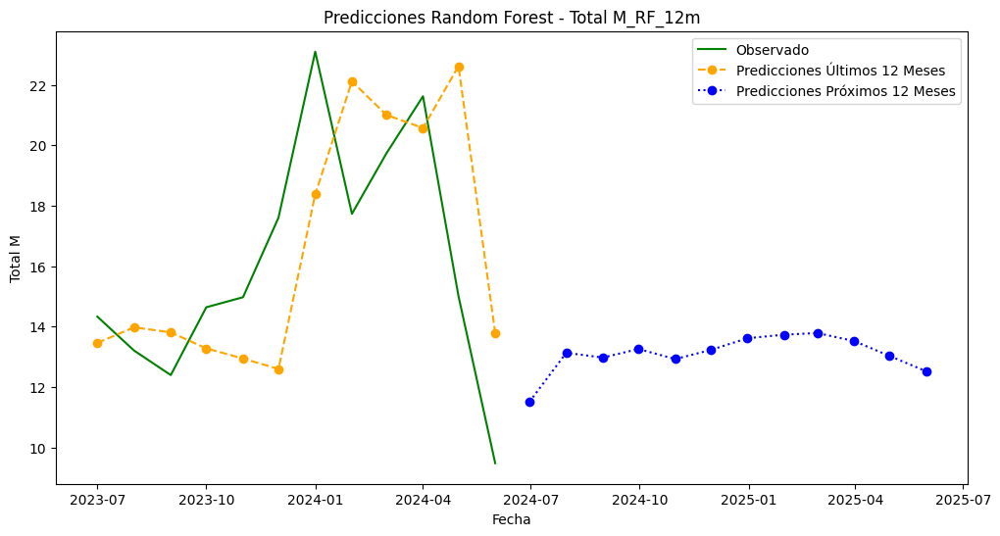


  Longitud de ventana: 18 meses
Total M_RF_18m - MAE: 2.63, MSE: 10.95, RMSE: 3.31, MAPE: 17.74%, AIC: 28.71, BIC: 28.71


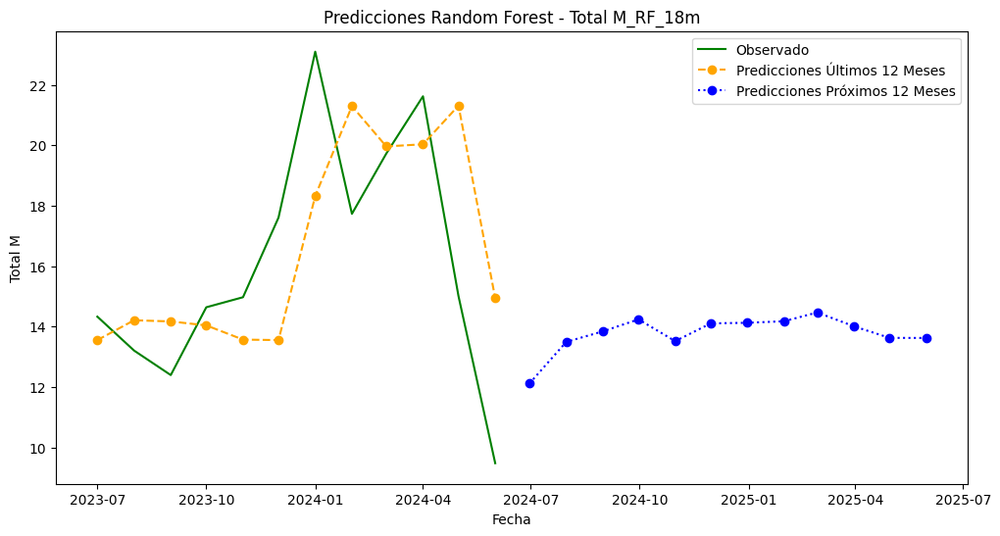


  Longitud de ventana: 24 meses
Total M_RF_24m - MAE: 3.07, MSE: 16.09, RMSE: 4.01, MAPE: 20.84%, AIC: 33.34, BIC: 33.34


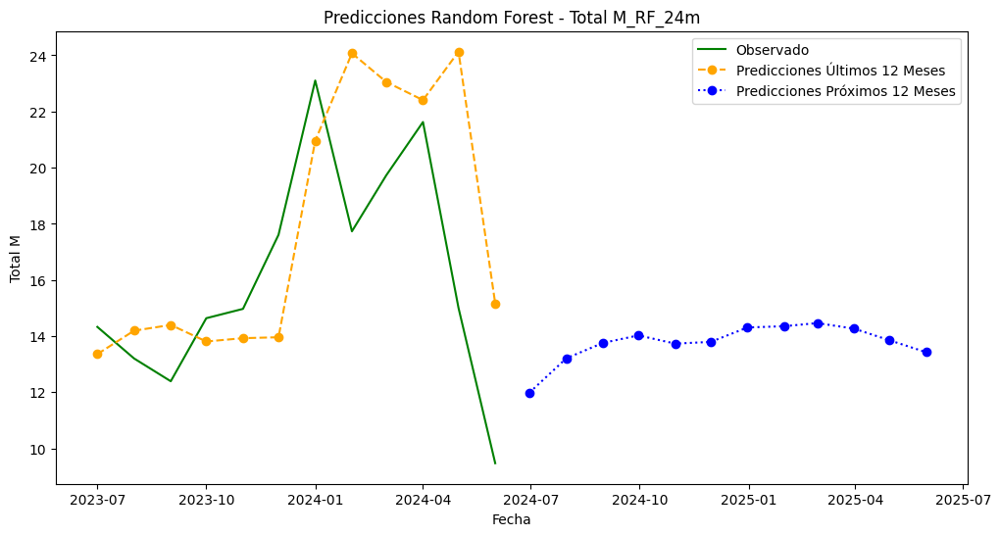


  Longitud de ventana: 36 meses
Total M_RF_36m - MAE: 3.28, MSE: 17.90, RMSE: 4.23, MAPE: 22.18%, AIC: 34.62, BIC: 34.62


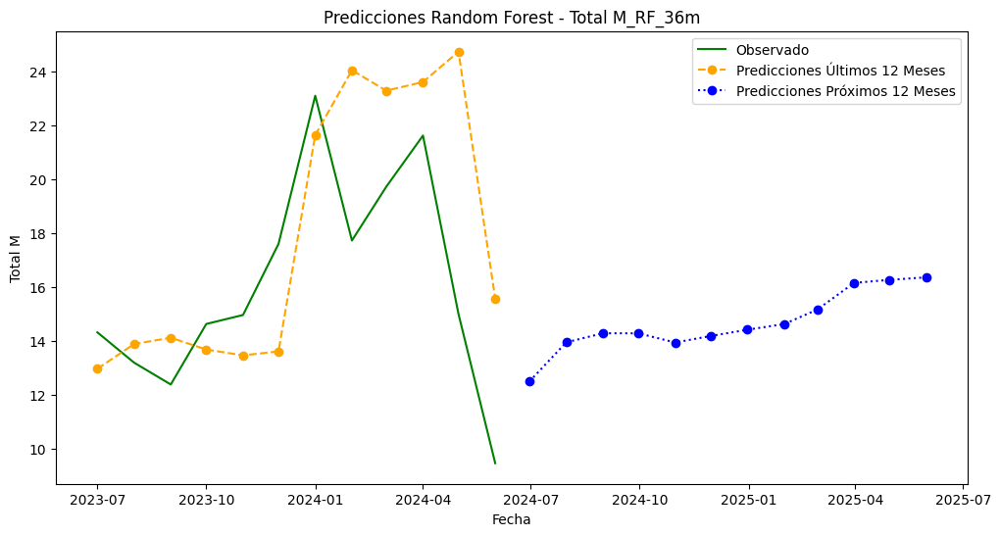


  Longitud de ventana: 48 meses
Total M_RF_48m - MAE: 3.03, MSE: 15.15, RMSE: 3.89, MAPE: 20.52%, AIC: 32.61, BIC: 32.61


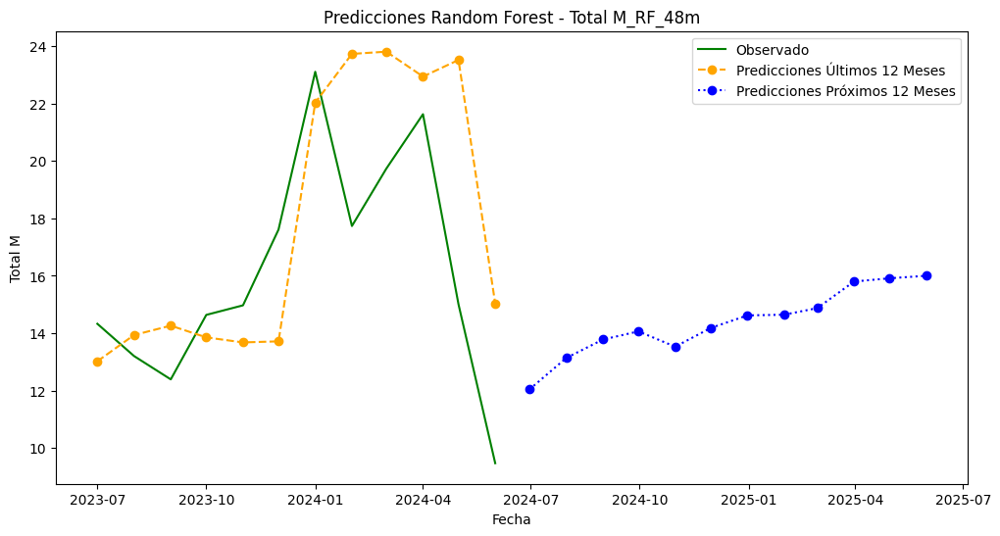


Procesando variable: Total C

  Longitud de ventana: 6 meses
Total C_RF_6m - MAE: 0.90, MSE: 1.27, RMSE: 1.13, MAPE: 13.24%, AIC: 2.84, BIC: 2.84


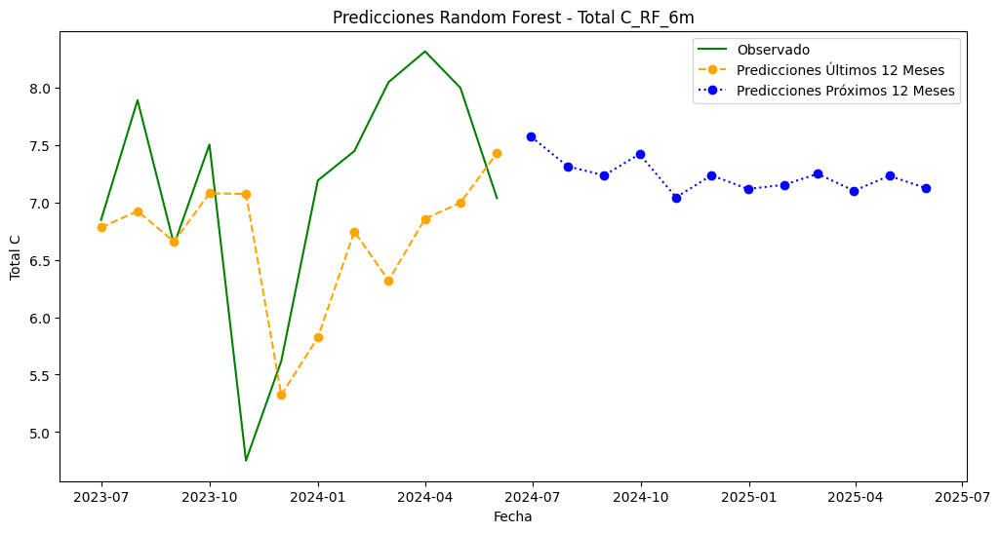


  Longitud de ventana: 12 meses
Total C_RF_12m - MAE: 0.83, MSE: 0.96, RMSE: 0.98, MAPE: 12.32%, AIC: -0.55, BIC: -0.55


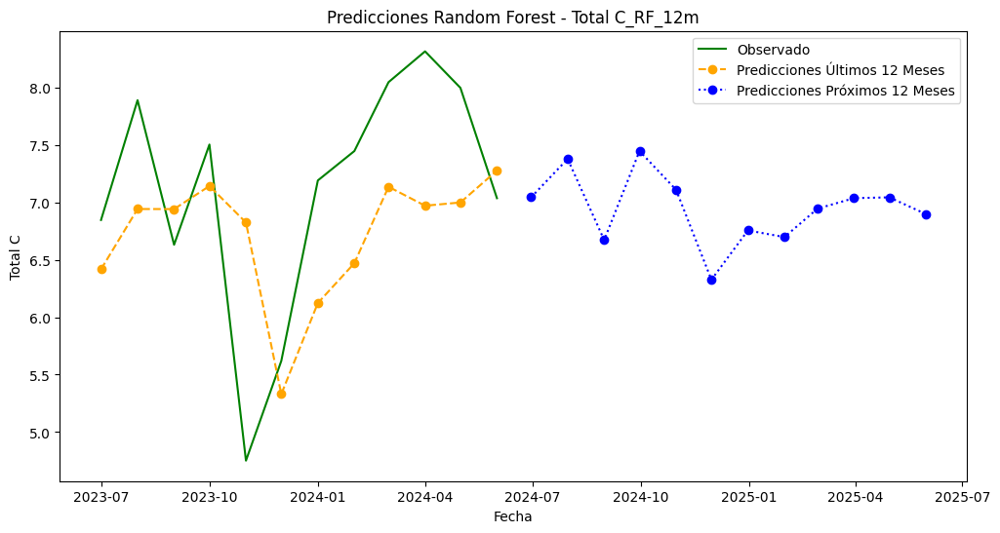


  Longitud de ventana: 18 meses
Total C_RF_18m - MAE: 0.80, MSE: 0.93, RMSE: 0.96, MAPE: 12.03%, AIC: -0.88, BIC: -0.88


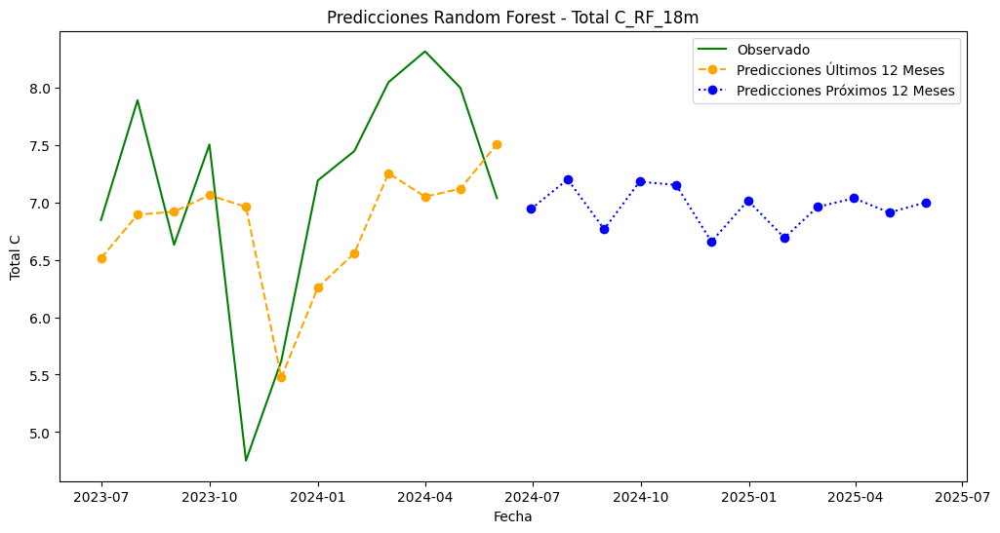


  Longitud de ventana: 24 meses
Total C_RF_24m - MAE: 0.68, MSE: 0.78, RMSE: 0.88, MAPE: 10.46%, AIC: -3.02, BIC: -3.02


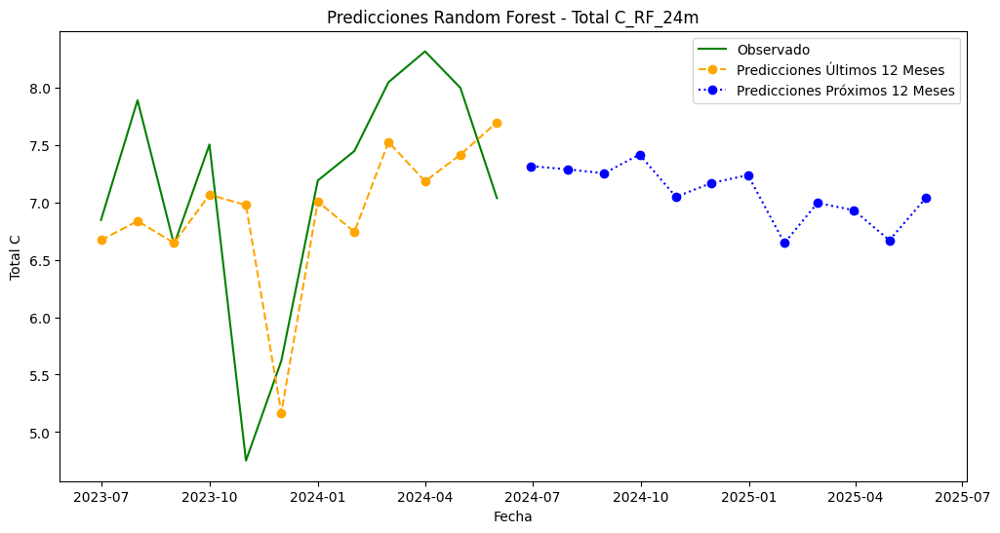


  Longitud de ventana: 36 meses
Total C_RF_36m - MAE: 0.69, MSE: 0.93, RMSE: 0.96, MAPE: 10.83%, AIC: -0.92, BIC: -0.92


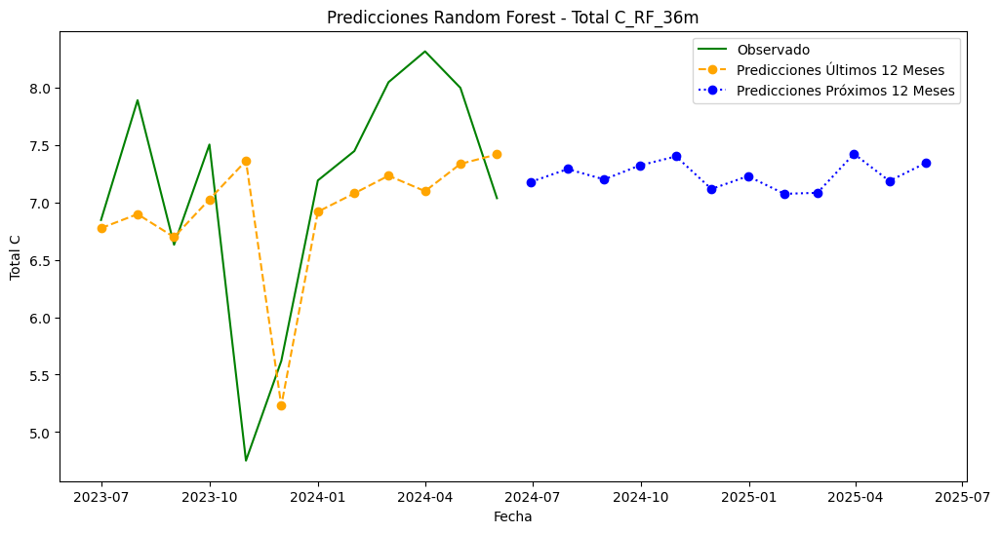


  Longitud de ventana: 48 meses
Total C_RF_48m - MAE: 0.66, MSE: 0.87, RMSE: 0.94, MAPE: 10.30%, AIC: -1.61, BIC: -1.61


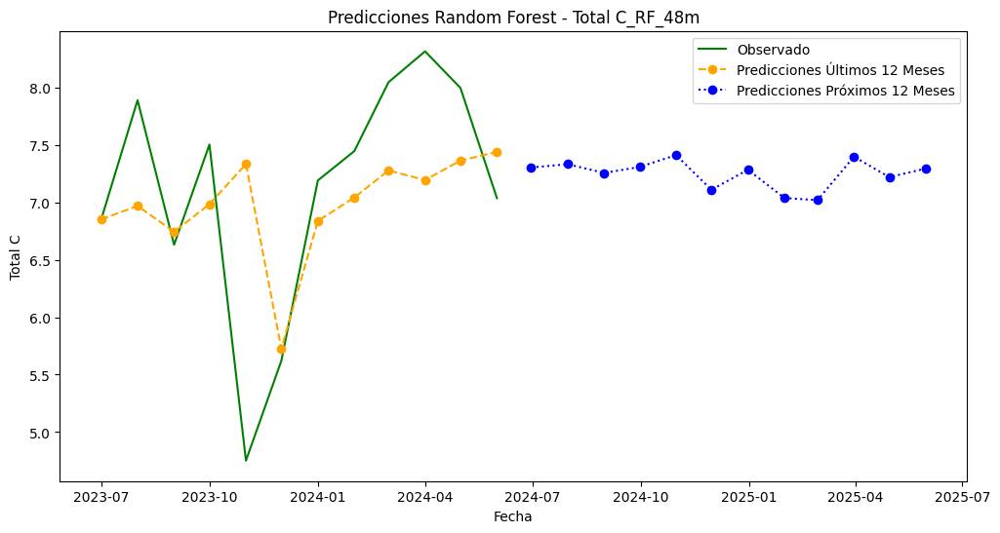

                       MAE        MSE      RMSE       MAPE        AIC  \
Total MyC_RF_6m   4.122413  29.087322  5.393266  17.466041  40.443629   
Total MyC_RF_12m  3.266180  18.828456  4.339177  14.244899  35.224432   
Total MyC_RF_18m  3.037007  14.309911  3.782844  13.062494  31.931429   
Total MyC_RF_24m  3.361260  19.367640  4.400868  14.901929  35.563243   
Total MyC_RF_36m  3.405289  19.523481  4.418538  15.186019  35.659415   
Total MyC_RF_48m  3.253015  16.854235  4.105391  14.504402  33.895224   
Total M_RF_6m     3.365709  16.464652  4.057666  21.524005  33.614589   
Total M_RF_12m    2.901528  12.940616  3.597307  18.943411  30.724451   
Total M_RF_18m    2.630052  10.945308  3.308369  17.739928  28.714930   
Total M_RF_24m    3.073540  16.088448  4.011041  20.839572  33.337218   
Total M_RF_36m    3.279658  17.901211  4.230982  22.175586  34.618420   
Total M_RF_48m    3.032180  15.145382  3.891707  20.522655  32.612348   
Total C_RF_6m     0.895293   1.267431  1.125802  13

In [185]:
# Importar las librerías necesarias
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import MinMaxScaler
import random
import warnings

warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = load_data()  # Asumiendo que tienes una función load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Lista de longitudes de ventana para probar
window_lengths = [6, 12, 18, 24, 36, 48]

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Crear un DataFrame para almacenar todas las predicciones
all_predictions_df = pd.DataFrame()

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Número de ejecuciones para promediar
num_runs = 5

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    for SEQ_LENGTH in window_lengths:
        print(f'\n  Longitud de ventana: {SEQ_LENGTH} meses')
        
        # Crear secuencias de entrada y salida
        X, y = create_sequences(scaled_data, SEQ_LENGTH)
        
        # Determinar el índice para los últimos 12 meses de datos
        test_start_index = len(X) - 12
        
        # Dividir los datos en entrenamiento y prueba
        X_train, X_test = X[:test_start_index], X[test_start_index:]
        y_train, y_test = y[:test_start_index], y[test_start_index:]
        
        all_predictions_last_12 = []
        all_future_predictions = []
        
        for run in range(num_runs):
            # Fijar la semilla para esta ejecución
            set_seeds(run)
            
            # Construir y entrenar el modelo Random Forest Regressor
            model = RandomForestRegressor(n_estimators=100, random_state=run)
            model.fit(X_train.reshape(X_train.shape[0], -1), y_train)
            
            # Predicciones sobre los últimos 12 meses
            predictions_last_12 = model.predict(X_test.reshape(X_test.shape[0], -1))
            predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
            all_predictions_last_12.append(predictions_last_12)
            
            # Predicciones sobre los siguientes 12 meses con el último dato real observado
            last_observed = scaled_data[-1]  # Último dato real observado
            last_sequence = np.append(X_test[-1][1:], last_observed).reshape(SEQ_LENGTH, 1)
            
            future_predictions = []
            for i in range(12):
                next_prediction = model.predict(last_sequence.reshape(1, -1))
                next_prediction = scaler.inverse_transform(next_prediction.reshape(-1, 1))
                future_predictions.append(next_prediction[0, 0])
                last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
            
            all_future_predictions.append(future_predictions)
        
        # Promediar las predicciones
        predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
        future_predictions_avg = np.mean(all_future_predictions, axis=0)
        
        # Guardar las predicciones en el DataFrame
        all_predictions_df[f'{var}_RF_{SEQ_LENGTH}m_Last12'] = predictions_last_12_avg.flatten()
        all_predictions_df[f'{var}_RF_{SEQ_LENGTH}m_Future12'] = future_predictions_avg.flatten()
        
        # Desnormalizar los datos reales de prueba
        y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
        
        # Calcular métricas de rendimiento para los últimos 12 meses
        mae = mean_absolute_error(y_test, predictions_last_12_avg)
        mse = mean_squared_error(y_test, predictions_last_12_avg)
        rmse = np.sqrt(mse)
        mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
        
        # Calcular el número de parámetros en el modelo (Random Forest no tiene "parámetros" tradicionales, así que se omite k)
        n = len(y_test)
        
        # Calcular la log-verosimilitud aproximada
        log_likelihood = -n / 2 * np.log(mse)
        
        # Calcular AIC y BIC
        aic = 2 * 0 - 2 * log_likelihood  # En lugar de 2k, aquí se usa 0 porque Random Forest no tiene un conteo de parámetros tradicional
        bic = 0 * np.log(n) - 2 * log_likelihood  # Lo mismo para BIC
        
        # Nombre ajustado para la variable
        adjusted_var_name = f"{var}_RF_{SEQ_LENGTH}m"
        
        # Almacenar las métricas en el diccionario
        metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
        
        # Imprimir métricas para los últimos 12 meses
        print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
        
        # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
        plt.figure(figsize=(12, 6))
        plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
        plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
        plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
        plt.xlabel('Fecha')
        plt.ylabel(var)
        plt.title(f'Predicciones Random Forest - {adjusted_var_name}')
        plt.legend()
        plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)

# Imprimir las predicciones guardadas en el DataFrame
print("\nPredicciones almacenadas en el DataFrame:")
print(all_predictions_df)


In [186]:
# Suponiendo que metrics_df ya está cargado con los datos proporcionados

# Crear una función para filtrar el DataFrame por un prefijo
def filter_dataframe(df, prefix):
    return df[df.index.str.contains(prefix)]

# Filtrar el DataFrame para cada variable y conservar los datos originales
total_MyC_df = filter_dataframe(metrics_df, 'Total MyC')
total_M_df = filter_dataframe(metrics_df, 'Total M')
total_C_df = filter_dataframe(metrics_df, 'Total C')

# Definir la función para resaltar la mejor métrica en cada columna
def highlight_best_row(df):
    styles = pd.DataFrame('', index=df.index, columns=df.columns)
    
    # Define las columnas que deben ser minimizadas
    minimize_columns = ['MAE', 'MSE', 'RMSE', 'MAPE', 'AIC', 'BIC']
    
    # Resaltar la mejor métrica en cada columna
    for col in df.columns:
        if col in minimize_columns:
            # Encuentra el índice del valor mínimo en la columna actual
            best_idx = df[col].idxmin()
            styles.loc[best_idx, col] = 'font-weight: bold; color: green;'
        else:
            # Para columnas que no deben ser minimizadas (si las hubiera)
            # Encuentra el índice del valor máximo en la columna actual
            best_idx = df[col].idxmax()
            styles.loc[best_idx, col] = 'font-weight: bold; color: green;'
    
    return styles

# Aplicar la función de resaltado a cada DataFrame
styled_total_MyC_df = total_MyC_df.style.apply(highlight_best_row, axis=None)
styled_total_M_df = total_M_df.style.apply(highlight_best_row, axis=None)
styled_total_C_df = total_C_df.style.apply(highlight_best_row, axis=None)

# Mostrar los DataFrames con el estilo aplicado usando HTML
def display_styled_df(styled_df):
    html = styled_df.to_html()  # Convierte el DataFrame estilizado a HTML
    display(HTML(html))  # Muestra el HTML en la salida

# Mostrar los DataFrames estilizados
display_styled_df(styled_total_MyC_df)
display_styled_df(styled_total_M_df)
display_styled_df(styled_total_C_df)

,MAE,MSE,RMSE,MAPE,AIC,BIC
Total MyC_RF_6m,4.122413,29.087322,5.393266,17.466041,40.443629,40.443629
Total MyC_RF_12m,3.266180,18.828456,4.339177,14.244899,35.224432,35.224432
Total MyC_RF_18m,3.037007,14.309911,3.782844,13.062494,31.931429,31.931429
Total MyC_RF_24m,3.361260,19.367640,4.400868,14.901929,35.563243,35.563243
Total MyC_RF_36m,3.405289,19.523481,4.418538,15.186019,35.659415,35.659415
Total MyC_RF_48m,3.253015,16.854235,4.105391,14.504402,33.895224,33.895224


,MAE,MSE,RMSE,MAPE,AIC,BIC
Total MyC_RF_6m,4.122413,29.087322,5.393266,17.466041,40.443629,40.443629
Total MyC_RF_12m,3.266180,18.828456,4.339177,14.244899,35.224432,35.224432
Total MyC_RF_18m,3.037007,14.309911,3.782844,13.062494,31.931429,31.931429
Total MyC_RF_24m,3.361260,19.367640,4.400868,14.901929,35.563243,35.563243
Total MyC_RF_36m,3.405289,19.523481,4.418538,15.186019,35.659415,35.659415
Total MyC_RF_48m,3.253015,16.854235,4.105391,14.504402,33.895224,33.895224
Total M_RF_6m,3.365709,16.464652,4.057666,21.524005,33.614589,33.614589
Total M_RF_12m,2.901528,12.940616,3.597307,18.943411,30.724451,30.724451
Total M_RF_18m,2.630052,10.945308,3.308369,17.739928,28.714930,28.714930
Total M_RF_24m,3.073540,16.088448,4.011041,20.839572,33.337218,33.337218


,MAE,MSE,RMSE,MAPE,AIC,BIC
Total C_RF_6m,0.895293,1.267431,1.125802,13.239703,2.843904,2.843904
Total C_RF_12m,0.828587,0.955158,0.977322,12.319066,-0.550547,-0.550547
Total C_RF_18m,0.802914,0.929447,0.964078,12.029091,-0.877989,-0.877989
Total C_RF_24m,0.677842,0.777499,0.881759,10.458378,-3.020071,-3.020071
Total C_RF_36m,0.693241,0.926381,0.962487,10.832426,-0.917639,-0.917639
Total C_RF_48m,0.660410,0.874736,0.935273,10.296320,-1.606001,-1.606001


### Modelo 7 RFR  con ventanas más largas
Ventanas de [48, 60, 72, 84, 96, 108] meses
Se ve que se sobreajustan los modelos y no generalizan bien


Procesando variable: Total MyC

  Longitud de ventana: 48 meses
Total MyC_RF_48m - MAE: 3.25, MSE: 16.85, RMSE: 4.11, MAPE: 14.50%, AIC: 33.90, BIC: 33.90


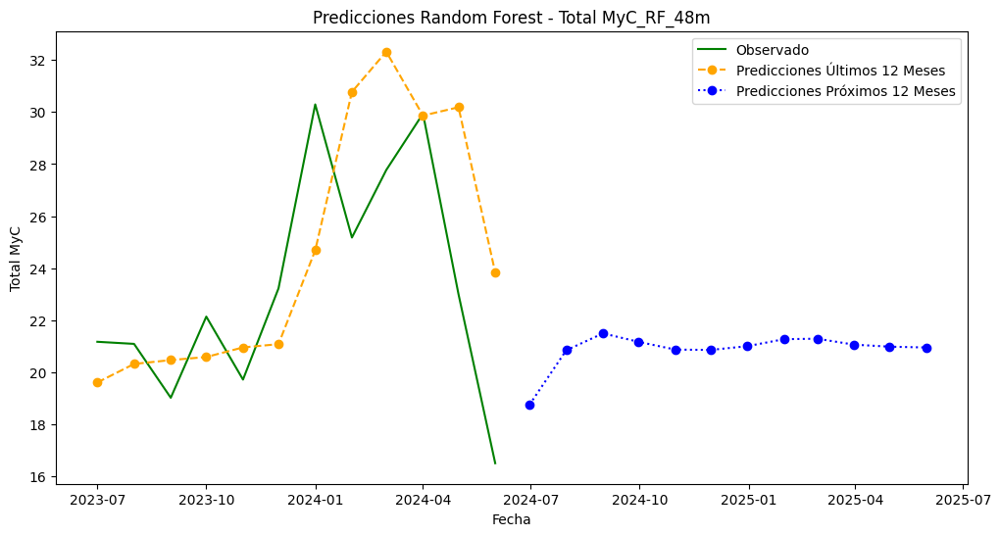


  Longitud de ventana: 60 meses
Total MyC_RF_60m - MAE: 3.23, MSE: 16.33, RMSE: 4.04, MAPE: 14.37%, AIC: 33.52, BIC: 33.52


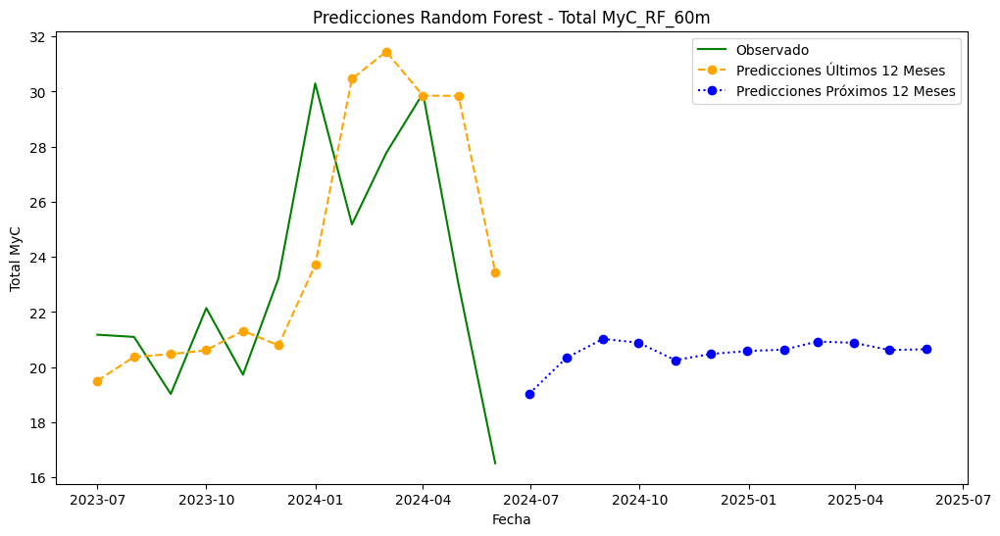


  Longitud de ventana: 72 meses
Total MyC_RF_72m - MAE: 3.02, MSE: 13.65, RMSE: 3.69, MAPE: 13.37%, AIC: 31.36, BIC: 31.36


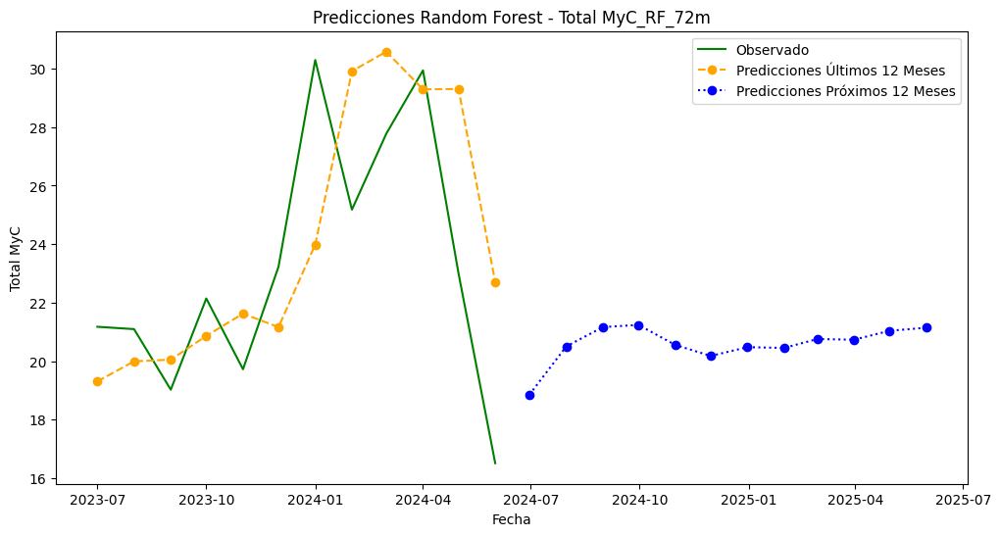


  Longitud de ventana: 84 meses
Total MyC_RF_84m - MAE: 3.01, MSE: 12.91, RMSE: 3.59, MAPE: 13.26%, AIC: 30.69, BIC: 30.69


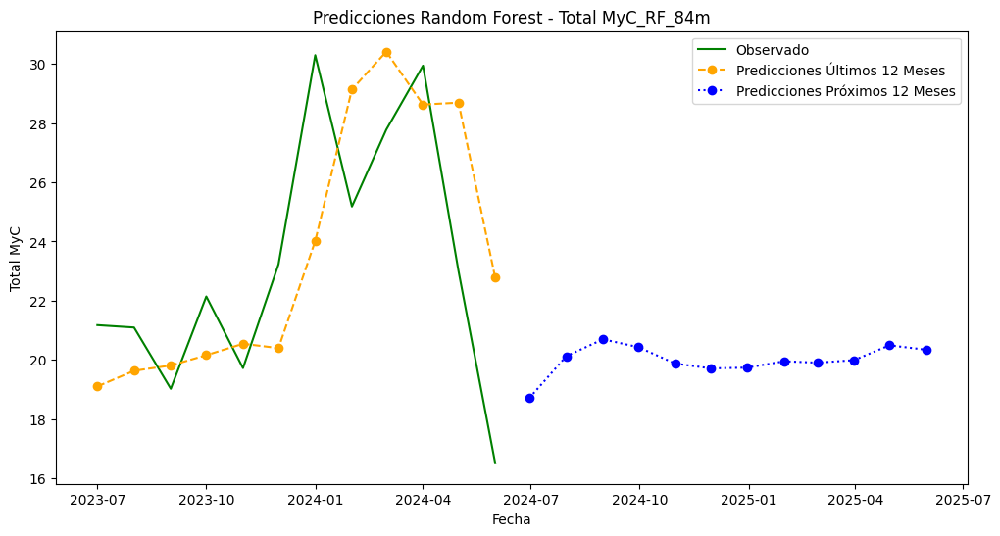


  Longitud de ventana: 96 meses
Total MyC_RF_96m - MAE: 3.05, MSE: 14.11, RMSE: 3.76, MAPE: 13.32%, AIC: 31.76, BIC: 31.76


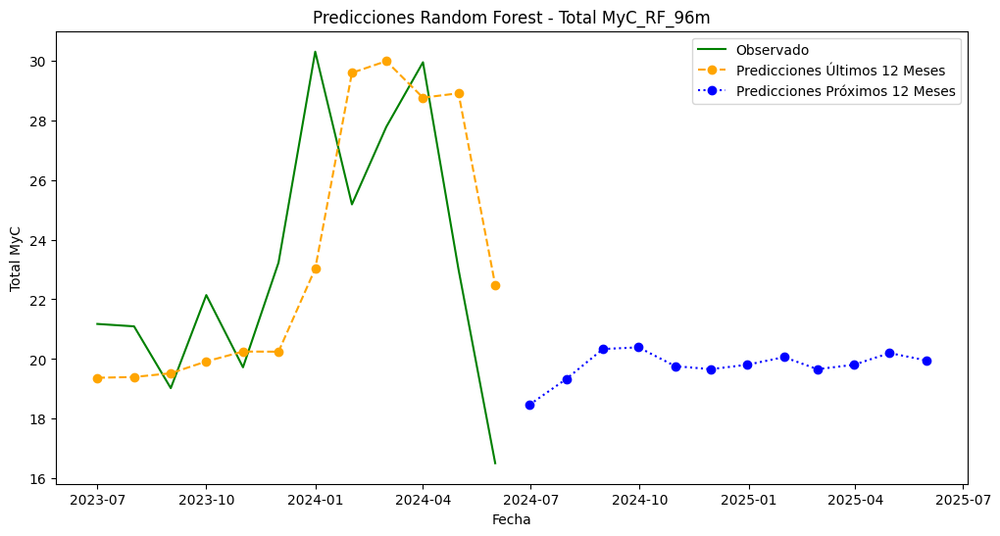


  Longitud de ventana: 108 meses
Total MyC_RF_108m - MAE: 2.80, MSE: 12.52, RMSE: 3.54, MAPE: 12.23%, AIC: 30.33, BIC: 30.33


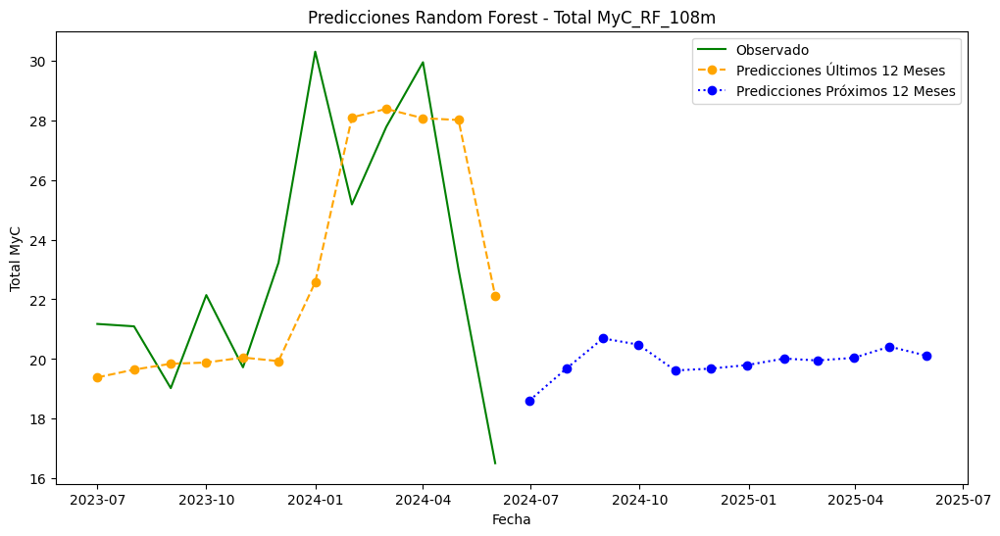


Procesando variable: Total M

  Longitud de ventana: 48 meses
Total M_RF_48m - MAE: 3.03, MSE: 15.15, RMSE: 3.89, MAPE: 20.52%, AIC: 32.61, BIC: 32.61


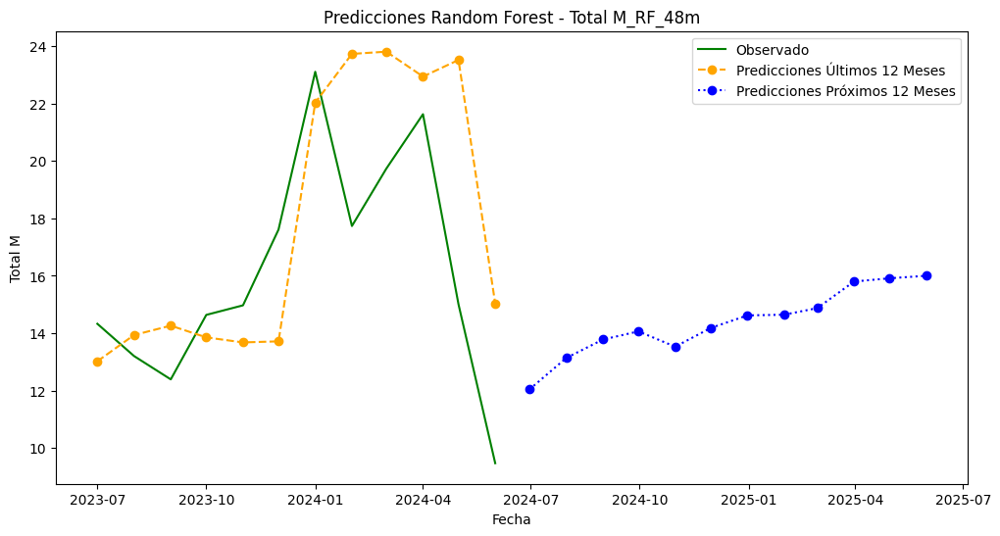


  Longitud de ventana: 60 meses
Total M_RF_60m - MAE: 3.04, MSE: 15.19, RMSE: 3.90, MAPE: 20.48%, AIC: 32.64, BIC: 32.64


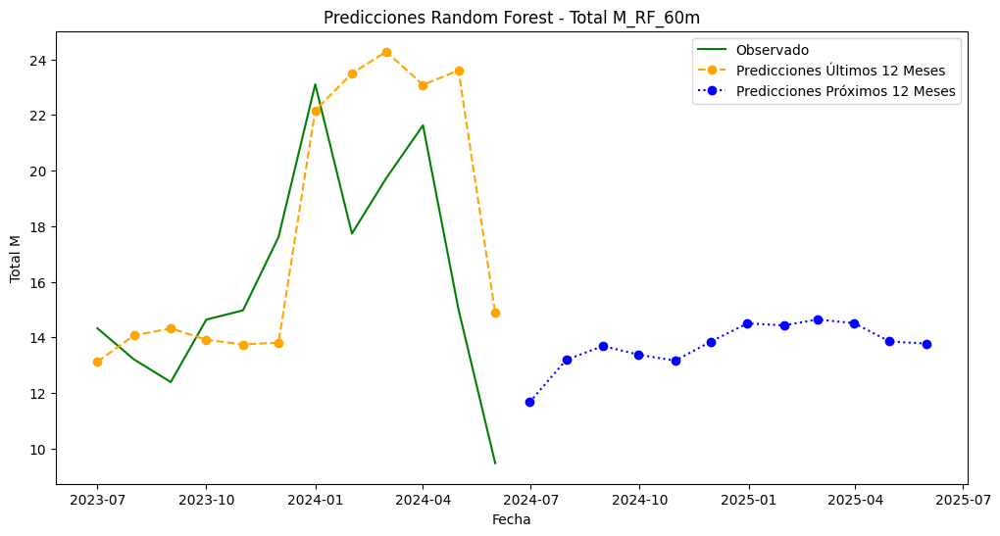


  Longitud de ventana: 72 meses
Total M_RF_72m - MAE: 2.91, MSE: 14.16, RMSE: 3.76, MAPE: 19.33%, AIC: 31.81, BIC: 31.81


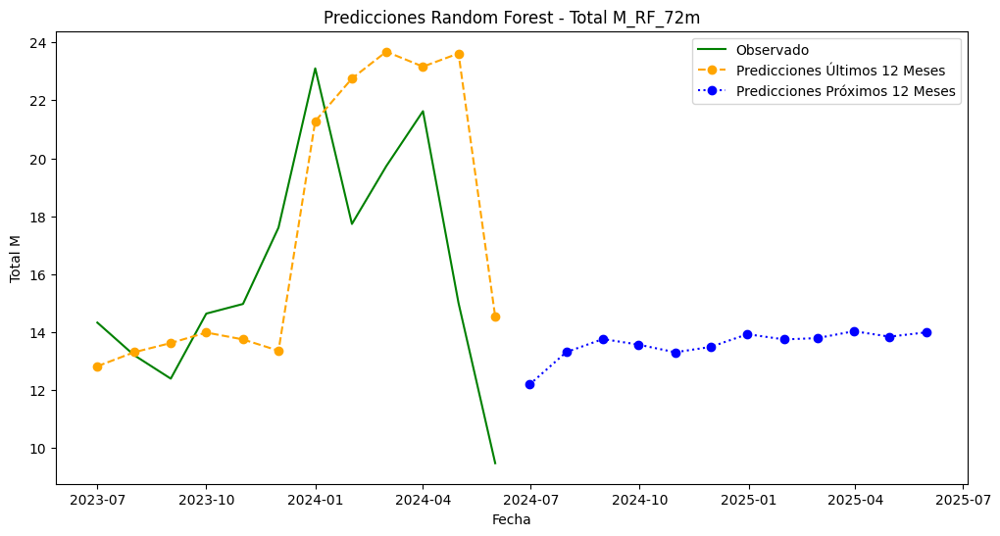


  Longitud de ventana: 84 meses
Total M_RF_84m - MAE: 2.79, MSE: 13.67, RMSE: 3.70, MAPE: 18.94%, AIC: 31.38, BIC: 31.38


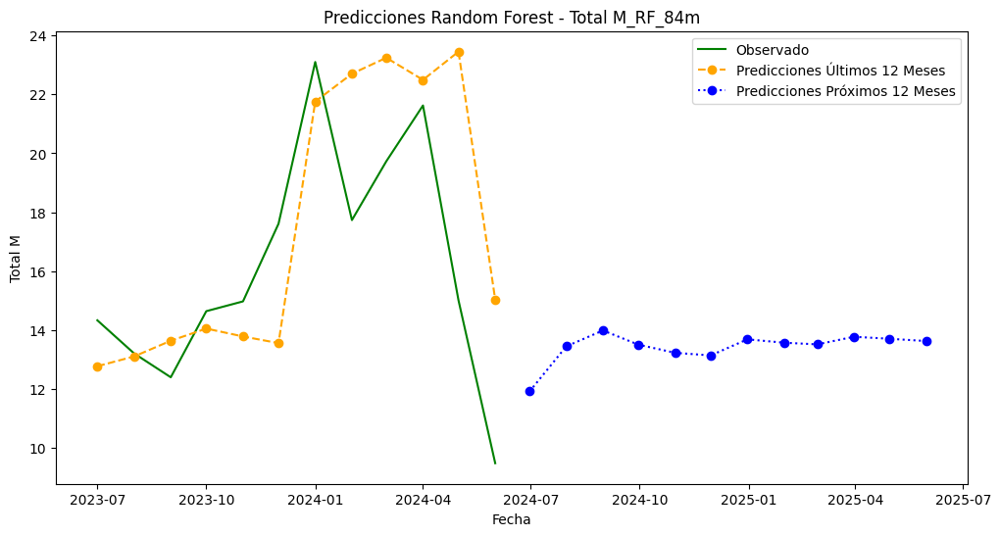


  Longitud de ventana: 96 meses
Total M_RF_96m - MAE: 2.62, MSE: 11.20, RMSE: 3.35, MAPE: 17.72%, AIC: 28.99, BIC: 28.99


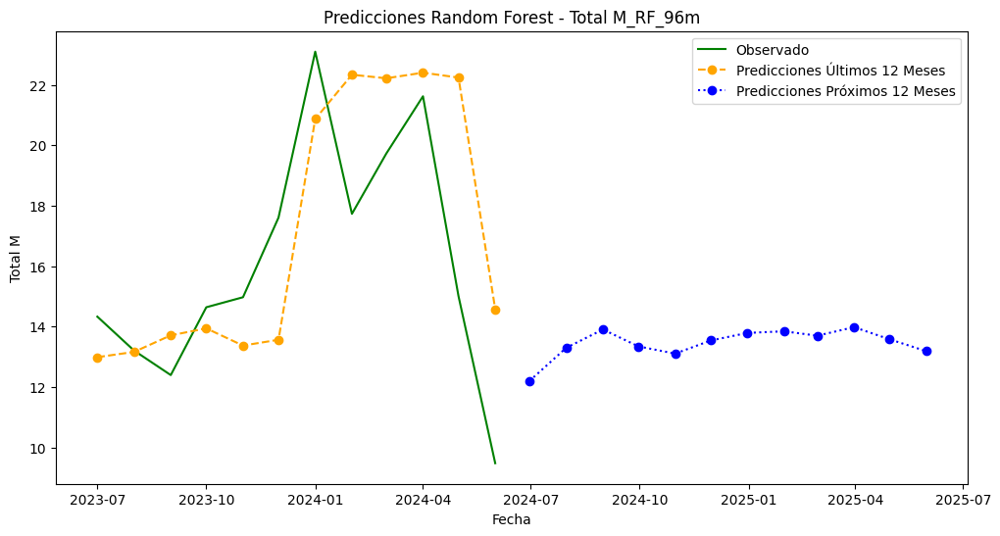


  Longitud de ventana: 108 meses
Total M_RF_108m - MAE: 2.49, MSE: 10.18, RMSE: 3.19, MAPE: 16.90%, AIC: 27.85, BIC: 27.85


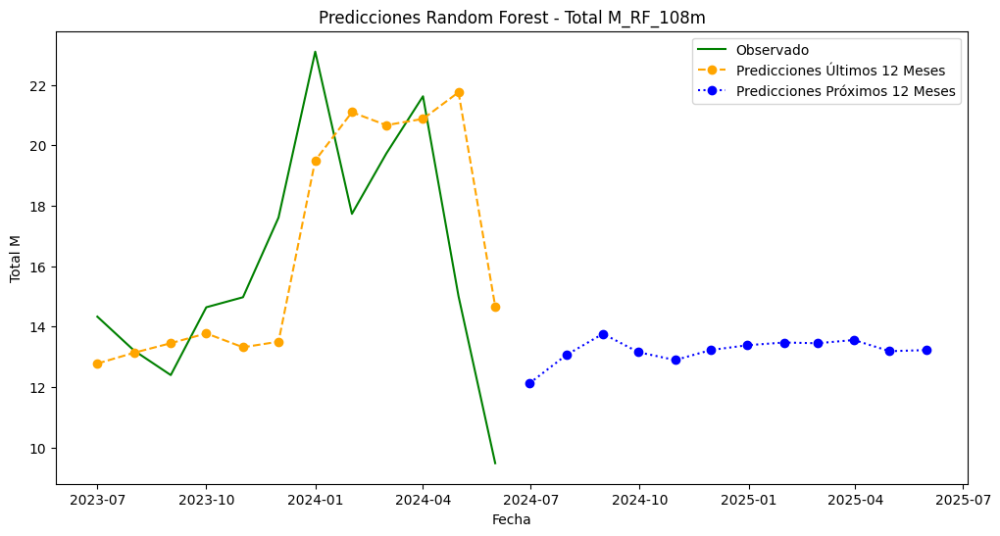


Procesando variable: Total C

  Longitud de ventana: 48 meses
Total C_RF_48m - MAE: 0.66, MSE: 0.87, RMSE: 0.94, MAPE: 10.30%, AIC: -1.61, BIC: -1.61


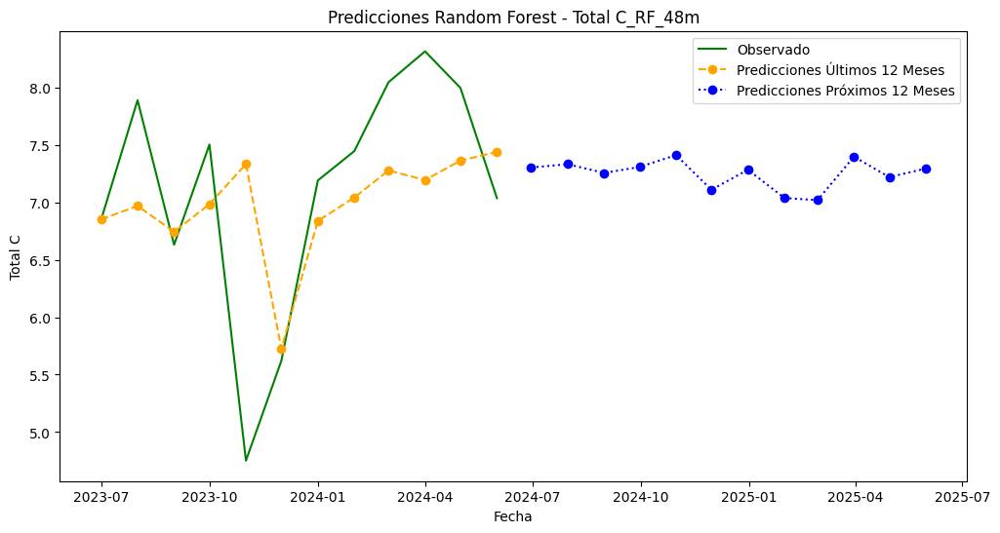


  Longitud de ventana: 60 meses
Total C_RF_60m - MAE: 0.67, MSE: 0.87, RMSE: 0.93, MAPE: 10.67%, AIC: -1.61, BIC: -1.61


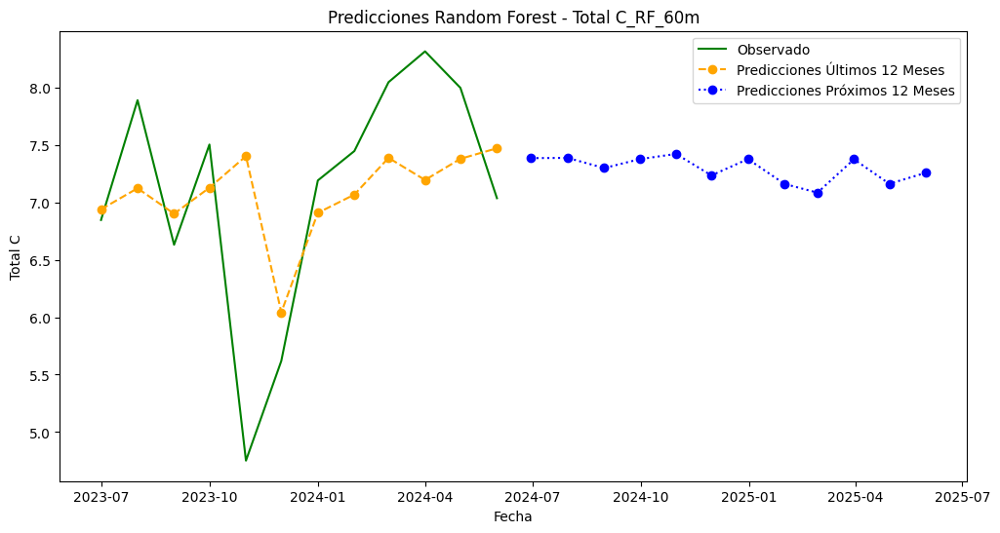


  Longitud de ventana: 72 meses
Total C_RF_72m - MAE: 0.66, MSE: 0.84, RMSE: 0.92, MAPE: 10.60%, AIC: -2.09, BIC: -2.09


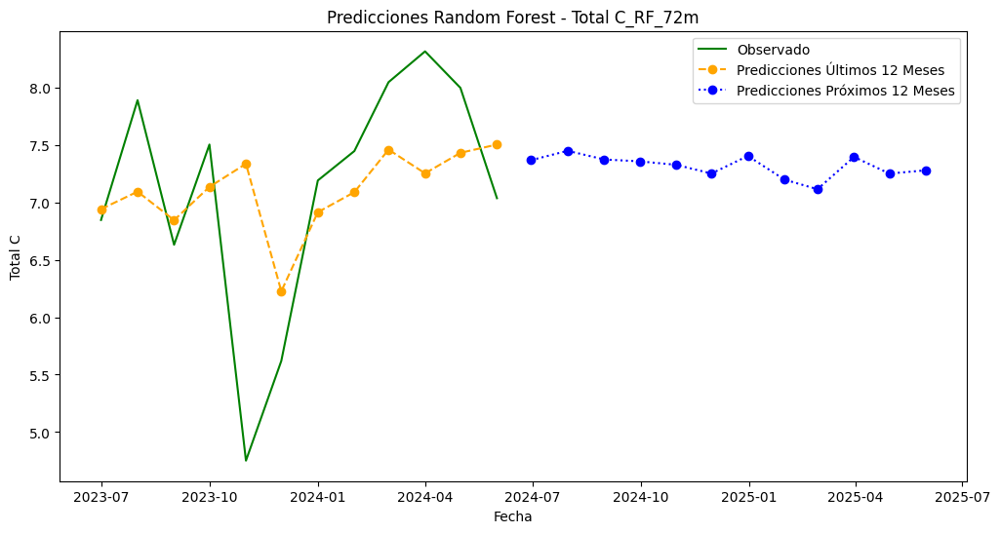


  Longitud de ventana: 84 meses
Total C_RF_84m - MAE: 0.69, MSE: 0.90, RMSE: 0.95, MAPE: 11.05%, AIC: -1.32, BIC: -1.32


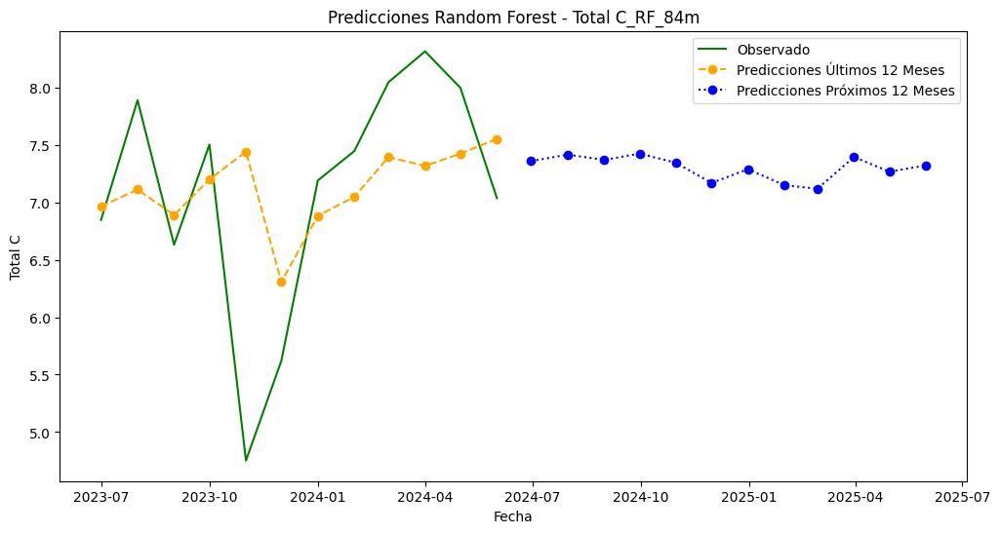


  Longitud de ventana: 96 meses
Total C_RF_96m - MAE: 0.72, MSE: 0.94, RMSE: 0.97, MAPE: 11.46%, AIC: -0.77, BIC: -0.77


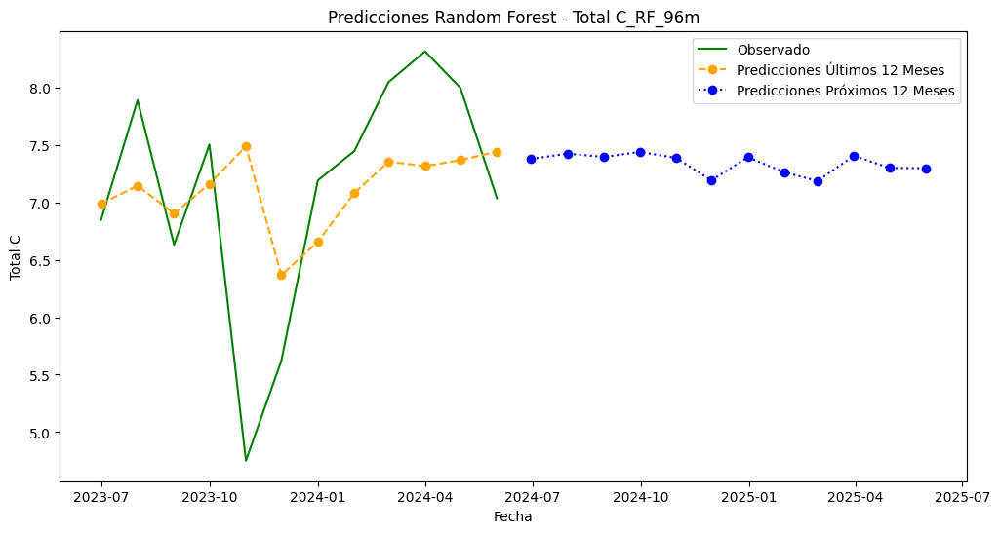


  Longitud de ventana: 108 meses
Total C_RF_108m - MAE: 0.71, MSE: 0.92, RMSE: 0.96, MAPE: 11.46%, AIC: -1.04, BIC: -1.04


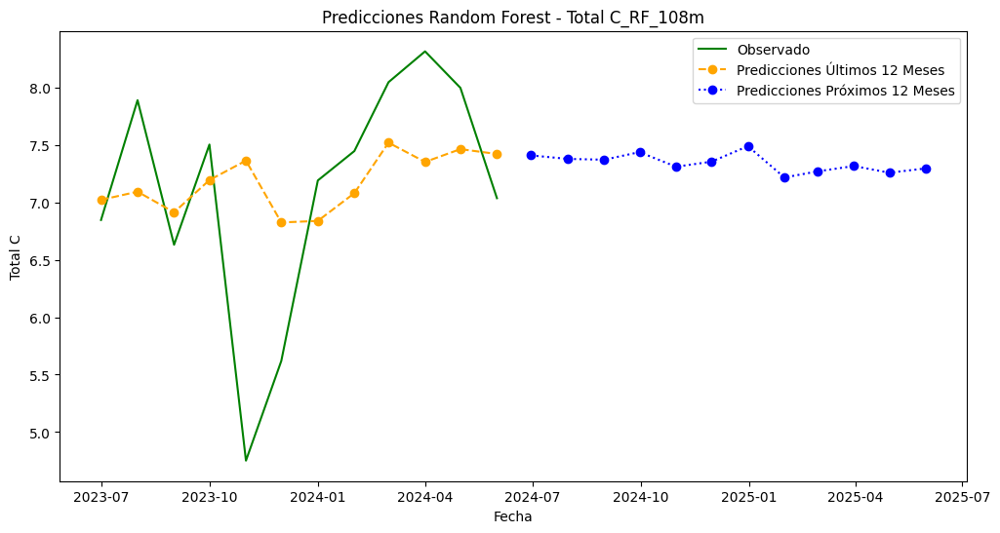

In [187]:
warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Lista de longitudes de ventana para probar
window_lengths = [48, 60, 72, 84, 96, 108]

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Número de ejecuciones para promediar
num_runs = 5

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    for SEQ_LENGTH in window_lengths:
        print(f'\n  Longitud de ventana: {SEQ_LENGTH} meses')
        
        # Crear secuencias de entrada y salida
        X, y = create_sequences(scaled_data, SEQ_LENGTH)
        
        # Determinar el índice para los últimos 12 meses de datos
        test_start_index = len(X) - 12
        
        # Dividir los datos en entrenamiento y prueba
        X_train, X_test = X[:test_start_index], X[test_start_index:]
        y_train, y_test = y[:test_start_index], y[test_start_index:]
        
        all_predictions_last_12 = []
        all_future_predictions = []
        
        for run in range(num_runs):
            # Fijar la semilla para esta ejecución
            set_seeds(run)
            
            # Construir y entrenar el modelo Random Forest Regressor
            model = RandomForestRegressor(n_estimators=100, random_state=run)
            model.fit(X_train.reshape(X_train.shape[0], -1), y_train)
            
            # Predicciones sobre los últimos 12 meses
            predictions_last_12 = model.predict(X_test.reshape(X_test.shape[0], -1))
            predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
            all_predictions_last_12.append(predictions_last_12)
            
            # Predicciones sobre los siguientes 12 meses con el último dato real observado
            last_observed = scaled_data[-1]  # Último dato real observado
            last_sequence = np.append(X_test[-1][1:], last_observed).reshape(SEQ_LENGTH, 1)
            
            future_predictions = []
            for i in range(12):
                next_prediction = model.predict(last_sequence.reshape(1, -1))
                next_prediction = scaler.inverse_transform(next_prediction.reshape(-1, 1))
                future_predictions.append(next_prediction[0, 0])
                last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
            
            all_future_predictions.append(future_predictions)
        
        # Promediar las predicciones
        predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
        future_predictions_avg = np.mean(all_future_predictions, axis=0)
        
        # Desnormalizar los datos reales de prueba
        y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
        
        # Calcular métricas de rendimiento para los últimos 12 meses
        mae = mean_absolute_error(y_test, predictions_last_12_avg)
        mse = mean_squared_error(y_test, predictions_last_12_avg)
        rmse = np.sqrt(mse)
        mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
        
        # Calcular el número de parámetros en el modelo (Random Forest no tiene "parámetros" tradicionales, así que se omite k)
        n = len(y_test)
        
        # Calcular la log-verosimilitud aproximada
        log_likelihood = -n / 2 * np.log(mse)
        
        # Calcular AIC y BIC
        aic = 2 * 0 - 2 * log_likelihood  # En lugar de 2k, aquí se usa 0 porque Random Forest no tiene un conteo de parámetros tradicional
        bic = 0 * np.log(n) - 2 * log_likelihood  # Lo mismo para BIC
        
        # Nombre ajustado para la variable
        adjusted_var_name = f"{var}_RF_{SEQ_LENGTH}m"
        
        # Almacenar las predicciones y métricas en los diccionarios
        predictions_dict[adjusted_var_name] = predictions_last_12_avg
        predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
        metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
        
        # Imprimir métricas para los últimos 12 meses
        print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
        
        # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
        plt.figure(figsize=(12, 6))
        plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
        plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
        plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
        plt.xlabel('Fecha')
        plt.ylabel(var)
        plt.title(f'Predicciones Random Forest - {adjusted_var_name}')
        plt.legend()
        plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df_bis = pd.DataFrame(metrics_dict).T


In [188]:
# Suponiendo que metrics_df ya está cargado con los datos proporcionados

# Crear una función para filtrar el DataFrame por un prefijo
def filter_dataframe(df, prefix):
    return df[df.index.str.contains(prefix)]

# Filtrar el DataFrame para cada variable y conservar los datos originales
total_MyC_df_bis = filter_dataframe(metrics_df_bis, 'Total MyC')
total_M_df_bis = filter_dataframe(metrics_df_bis, 'Total M')
total_C_df_bis = filter_dataframe(metrics_df_bis, 'Total C')

# Definir la función para resaltar la mejor métrica en cada columna
def highlight_best_row(df):
    styles = pd.DataFrame('', index=df.index, columns=df.columns)
    
    # Define las columnas que deben ser minimizadas
    minimize_columns = ['MAE', 'MSE', 'RMSE', 'MAPE', 'AIC', 'BIC']
    
    # Resaltar la mejor métrica en cada columna
    for col in df.columns:
        if col in minimize_columns:
            # Encuentra el índice del valor mínimo en la columna actual
            best_idx = df[col].idxmin()
            styles.loc[best_idx, col] = 'font-weight: bold; color: green;'
        else:
            # Para columnas que no deben ser minimizadas (si las hubiera)
            # Encuentra el índice del valor máximo en la columna actual
            best_idx = df[col].idxmax()
            styles.loc[best_idx, col] = 'font-weight: bold; color: green;'
    
    return styles

# Aplicar la función de resaltado a cada DataFrame
styled_total_MyC_df_bis = total_MyC_df_bis.style.apply(highlight_best_row, axis=None)
styled_total_M_df_bis = total_M_df_bis.style.apply(highlight_best_row, axis=None)
styled_total_C_df_bis = total_C_df_bis.style.apply(highlight_best_row, axis=None)

# Mostrar los DataFrames con el estilo aplicado usando HTML
def display_styled_df(styled_df):
    html = styled_df.to_html()  # Convierte el DataFrame estilizado a HTML
    display(HTML(html))  # Muestra el HTML en la salida

# Mostrar los DataFrames estilizados
display_styled_df(styled_total_MyC_df_bis)
display_styled_df(styled_total_M_df_bis)
display_styled_df(styled_total_C_df_bis)

,MAE,MSE,RMSE,MAPE,AIC,BIC
Total MyC_RF_48m,3.253015,16.854235,4.105391,14.504402,33.895224,33.895224
Total MyC_RF_60m,3.234039,16.328670,4.040875,14.366437,33.515069,33.515069
Total MyC_RF_72m,3.018448,13.646779,3.694155,13.374321,31.362043,31.362043
Total MyC_RF_84m,3.006956,12.907432,3.592691,13.258331,30.693639,30.693639
Total MyC_RF_96m,3.054541,14.110968,3.756457,13.322804,31.763428,31.763428
Total MyC_RF_108m,2.803481,12.524319,3.538971,12.230463,30.332067,30.332067


,MAE,MSE,RMSE,MAPE,AIC,BIC
Total MyC_RF_48m,3.253015,16.854235,4.105391,14.504402,33.895224,33.895224
Total MyC_RF_60m,3.234039,16.328670,4.040875,14.366437,33.515069,33.515069
Total MyC_RF_72m,3.018448,13.646779,3.694155,13.374321,31.362043,31.362043
Total MyC_RF_84m,3.006956,12.907432,3.592691,13.258331,30.693639,30.693639
Total MyC_RF_96m,3.054541,14.110968,3.756457,13.322804,31.763428,31.763428
Total MyC_RF_108m,2.803481,12.524319,3.538971,12.230463,30.332067,30.332067
Total M_RF_48m,3.032180,15.145382,3.891707,20.522655,32.612348,32.612348
Total M_RF_60m,3.036228,15.186559,3.896994,20.479717,32.644929,32.644929
Total M_RF_72m,2.912949,14.161878,3.763227,19.331495,31.806644,31.806644
Total M_RF_84m,2.786848,13.667116,3.696906,18.940420,31.379912,31.379912


,MAE,MSE,RMSE,MAPE,AIC,BIC
Total C_RF_48m,0.660410,0.874736,0.935273,10.296320,-1.606001,-1.606001
Total C_RF_60m,0.672299,0.874158,0.934964,10.665496,-1.613929,-1.613929
Total C_RF_72m,0.664749,0.839860,0.916439,10.598061,-2.094240,-2.094240
Total C_RF_84m,0.689709,0.895609,0.946366,11.045857,-1.323014,-1.323014
Total C_RF_96m,0.716541,0.937684,0.968341,11.456440,-0.772107,-0.772107
Total C_RF_108m,0.708617,0.916844,0.957520,11.457008,-1.041811,-1.041811


### Prueba de guardado predicciones RFR


Procesando variable: Total MyC

  Longitud de ventana: 48 meses
Total MyC_RF_48m - MAE: 3.25, MSE: 16.85, RMSE: 4.11, MAPE: 14.50%, AIC: 33.90, BIC: 33.90


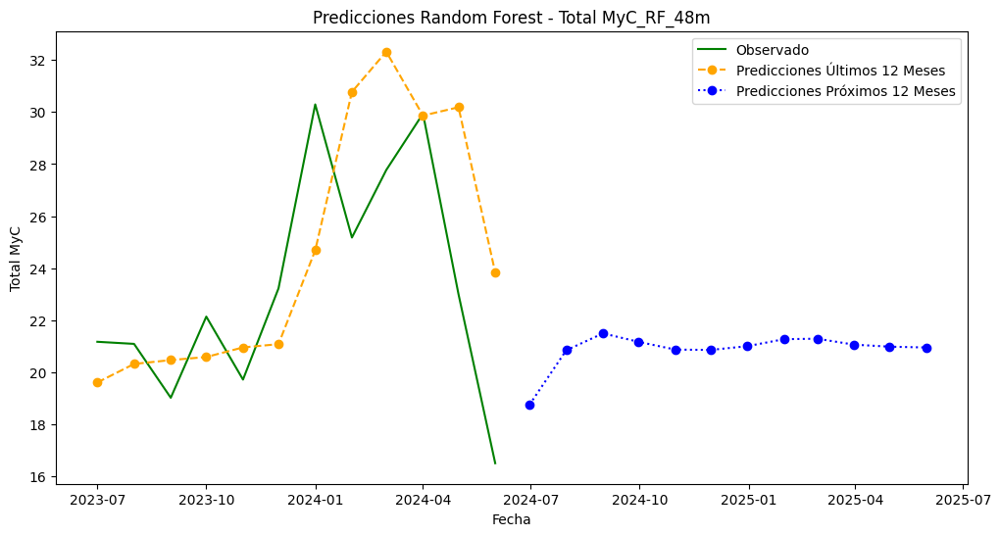


  Longitud de ventana: 60 meses
Total MyC_RF_60m - MAE: 3.23, MSE: 16.33, RMSE: 4.04, MAPE: 14.37%, AIC: 33.52, BIC: 33.52


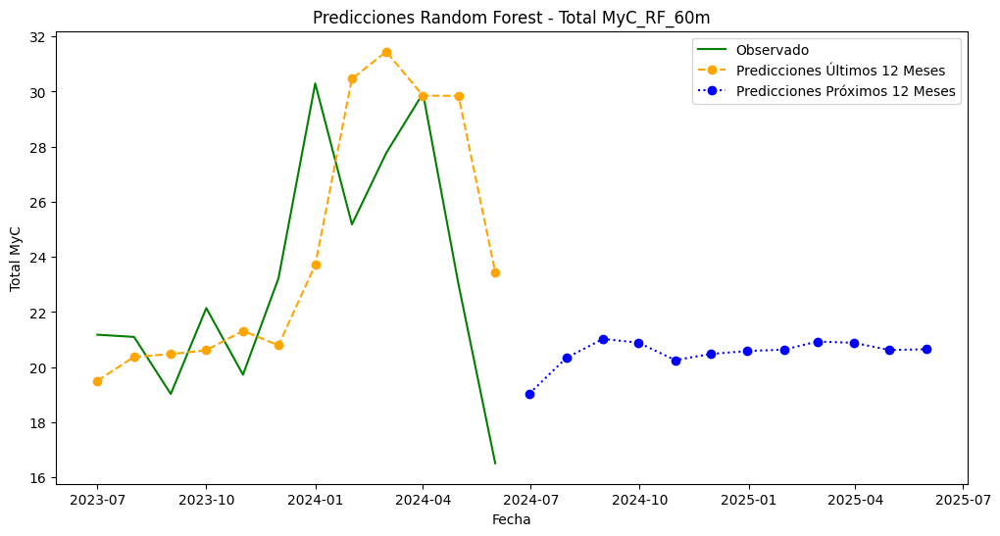


  Longitud de ventana: 72 meses
Total MyC_RF_72m - MAE: 3.02, MSE: 13.65, RMSE: 3.69, MAPE: 13.37%, AIC: 31.36, BIC: 31.36


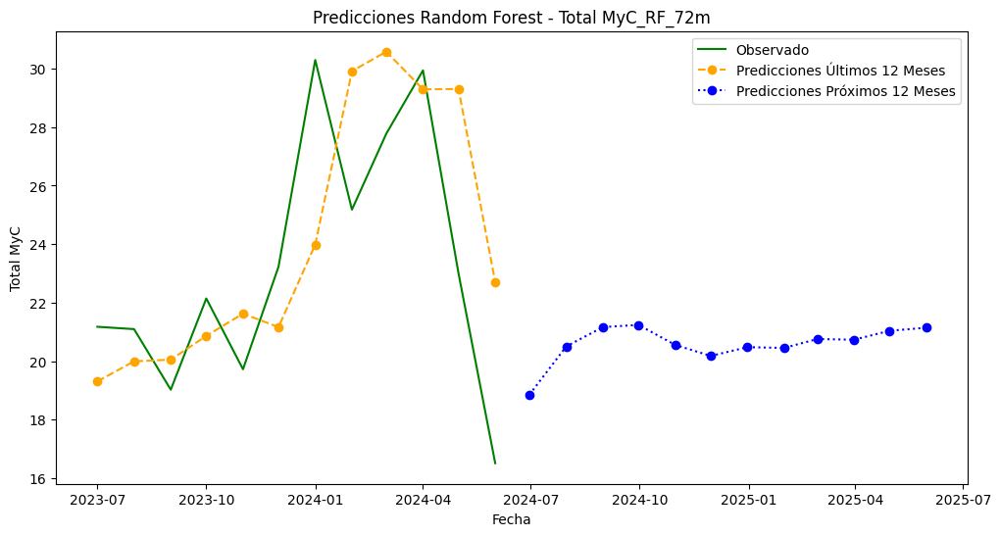


  Longitud de ventana: 84 meses
Total MyC_RF_84m - MAE: 3.01, MSE: 12.91, RMSE: 3.59, MAPE: 13.26%, AIC: 30.69, BIC: 30.69


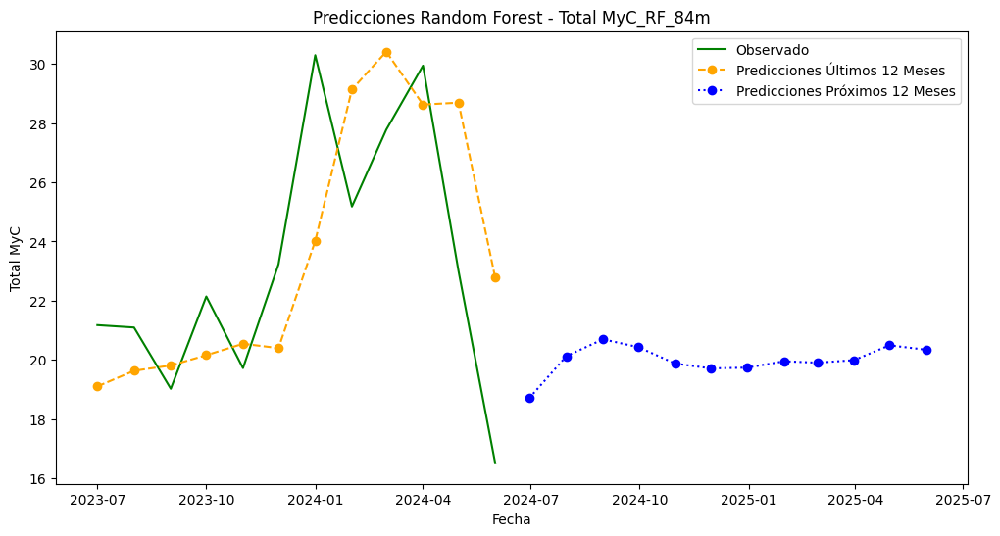


  Longitud de ventana: 96 meses
Total MyC_RF_96m - MAE: 3.05, MSE: 14.11, RMSE: 3.76, MAPE: 13.32%, AIC: 31.76, BIC: 31.76


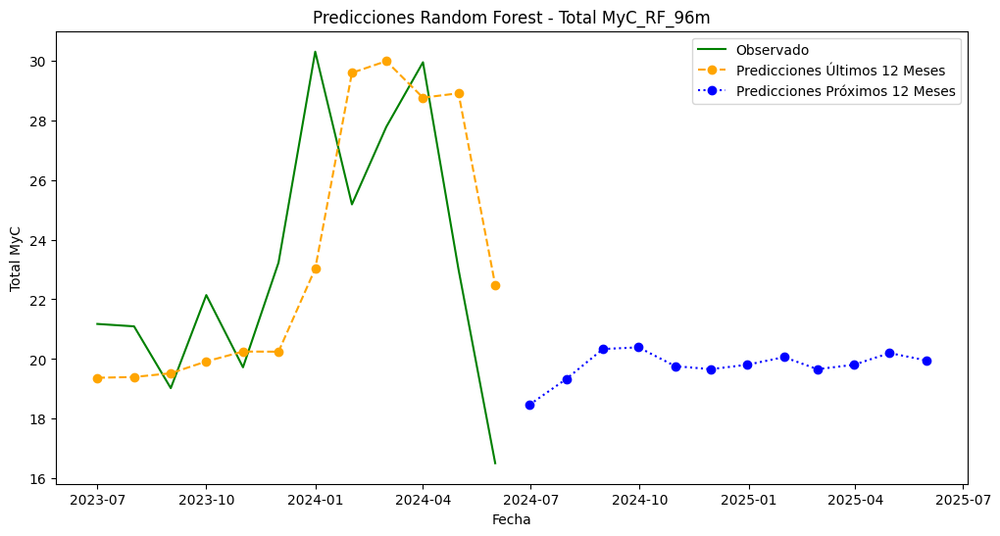


  Longitud de ventana: 108 meses
Total MyC_RF_108m - MAE: 2.80, MSE: 12.52, RMSE: 3.54, MAPE: 12.23%, AIC: 30.33, BIC: 30.33


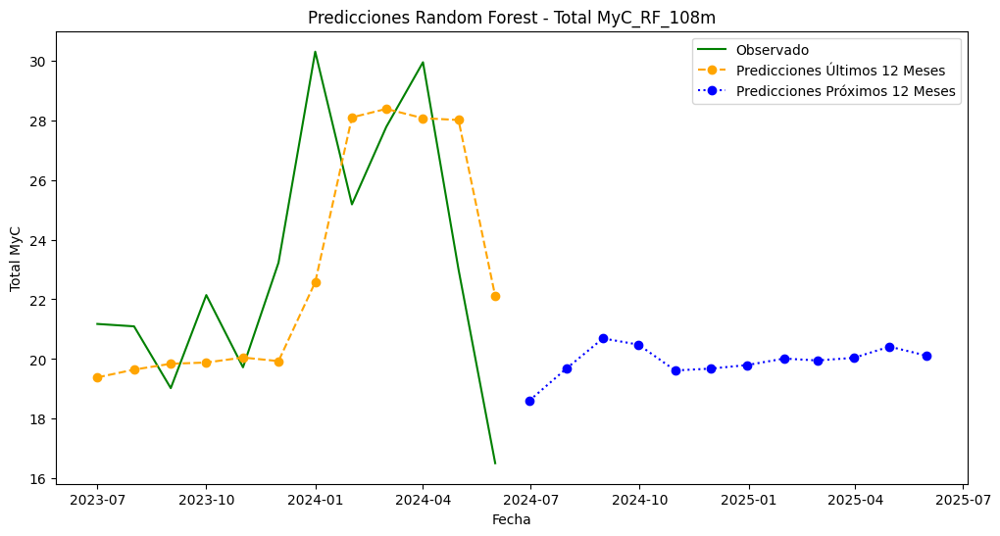


Procesando variable: Total M

  Longitud de ventana: 48 meses
Total M_RF_48m - MAE: 3.03, MSE: 15.15, RMSE: 3.89, MAPE: 20.52%, AIC: 32.61, BIC: 32.61


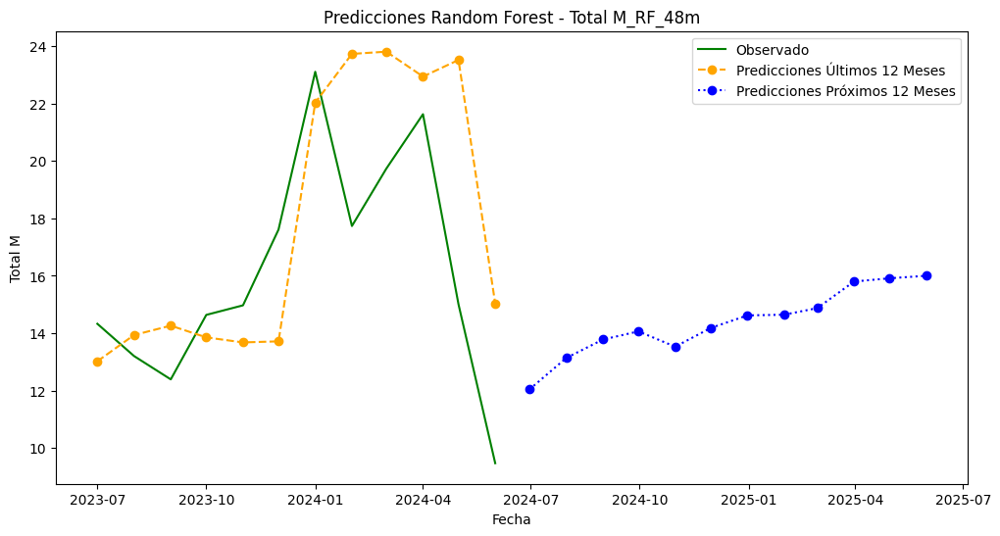


  Longitud de ventana: 60 meses
Total M_RF_60m - MAE: 3.04, MSE: 15.19, RMSE: 3.90, MAPE: 20.48%, AIC: 32.64, BIC: 32.64


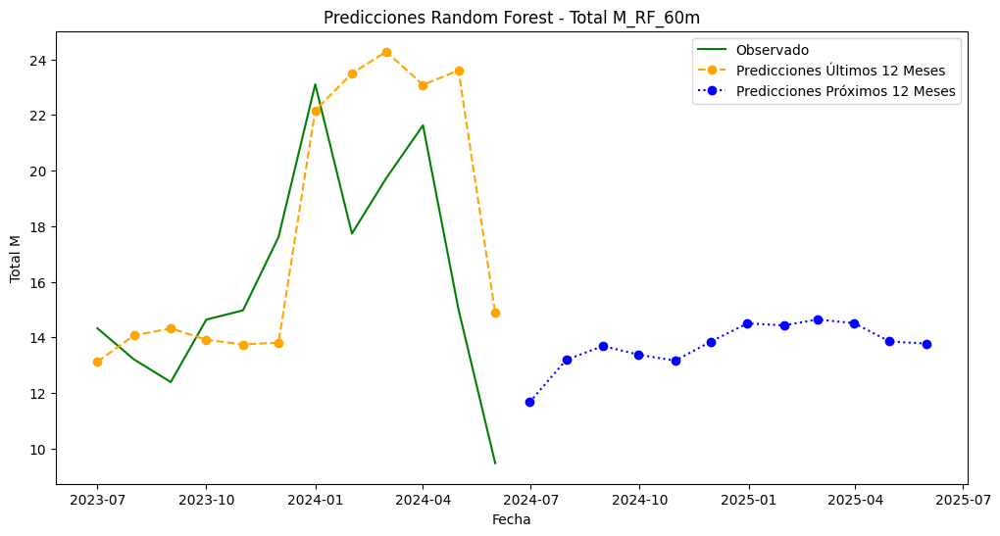


  Longitud de ventana: 72 meses
Total M_RF_72m - MAE: 2.91, MSE: 14.16, RMSE: 3.76, MAPE: 19.33%, AIC: 31.81, BIC: 31.81


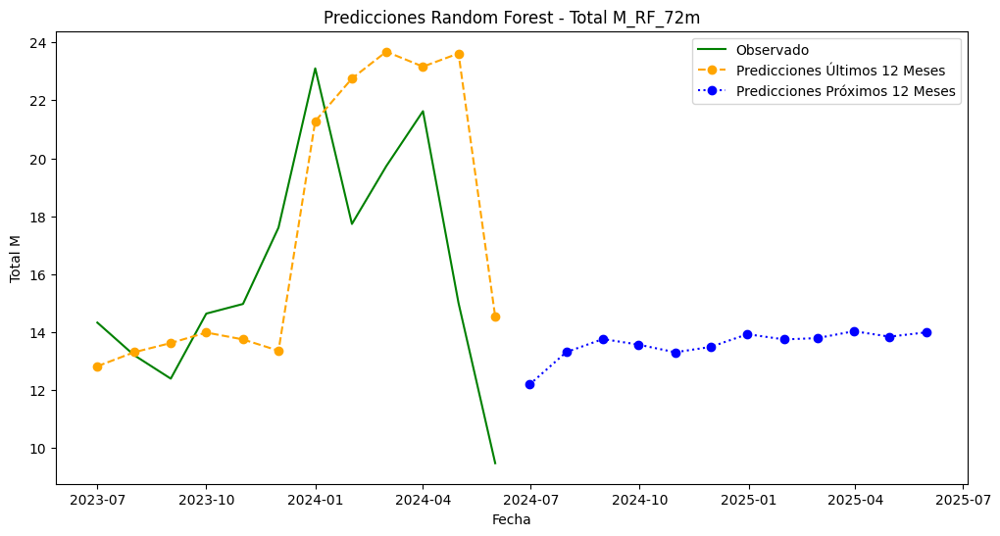


  Longitud de ventana: 84 meses
Total M_RF_84m - MAE: 2.79, MSE: 13.67, RMSE: 3.70, MAPE: 18.94%, AIC: 31.38, BIC: 31.38


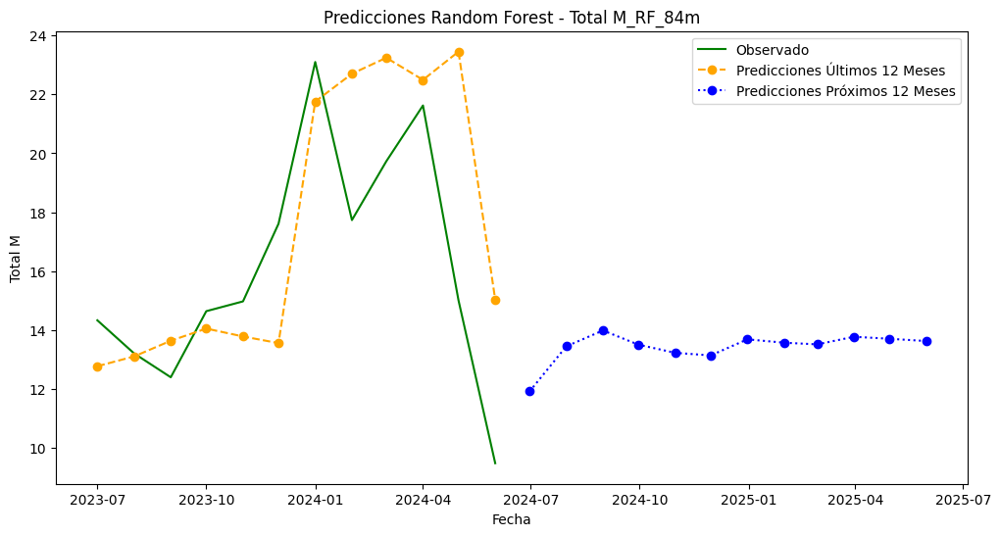


  Longitud de ventana: 96 meses
Total M_RF_96m - MAE: 2.62, MSE: 11.20, RMSE: 3.35, MAPE: 17.72%, AIC: 28.99, BIC: 28.99


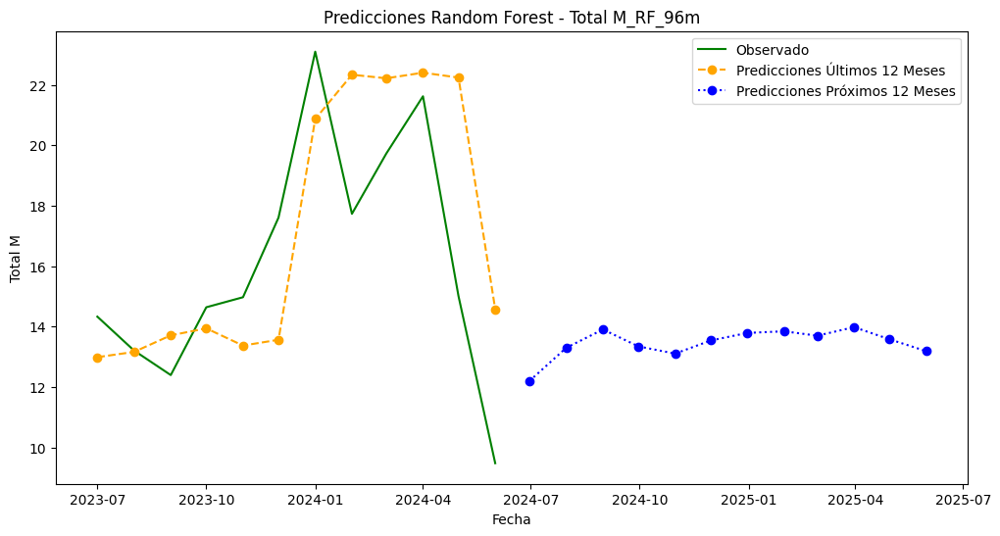


  Longitud de ventana: 108 meses
Total M_RF_108m - MAE: 2.49, MSE: 10.18, RMSE: 3.19, MAPE: 16.90%, AIC: 27.85, BIC: 27.85


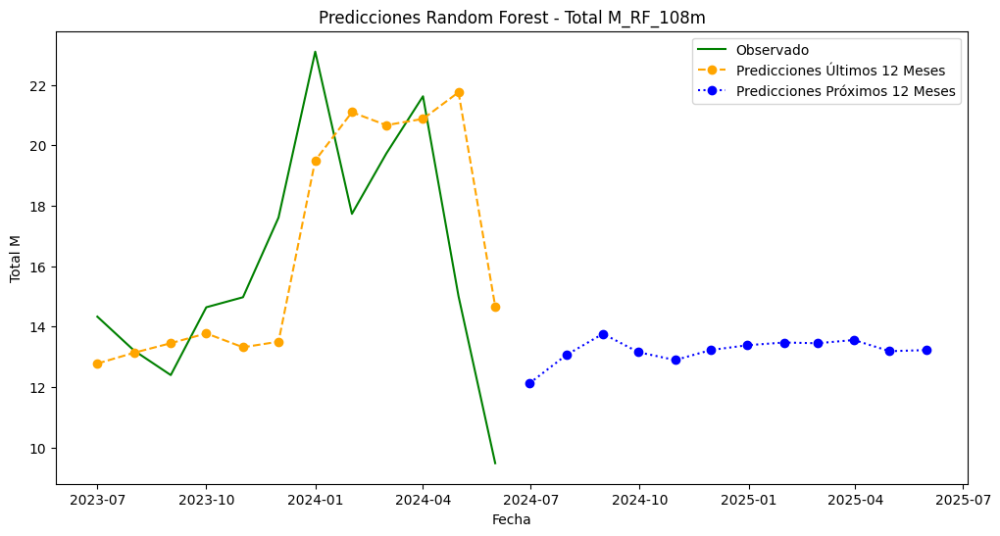


Procesando variable: Total C

  Longitud de ventana: 48 meses
Total C_RF_48m - MAE: 0.66, MSE: 0.87, RMSE: 0.94, MAPE: 10.30%, AIC: -1.61, BIC: -1.61


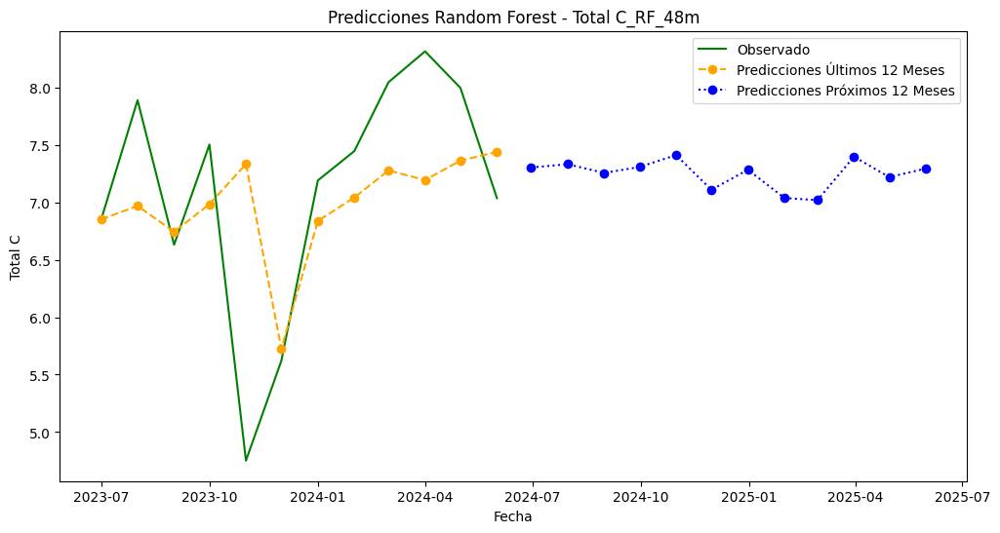


  Longitud de ventana: 60 meses
Total C_RF_60m - MAE: 0.67, MSE: 0.87, RMSE: 0.93, MAPE: 10.67%, AIC: -1.61, BIC: -1.61


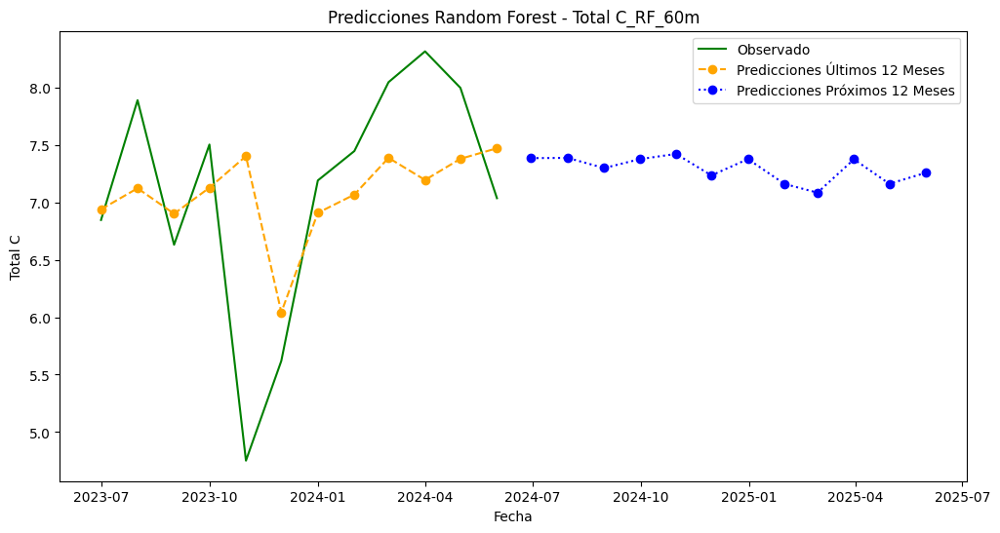


  Longitud de ventana: 72 meses
Total C_RF_72m - MAE: 0.66, MSE: 0.84, RMSE: 0.92, MAPE: 10.60%, AIC: -2.09, BIC: -2.09


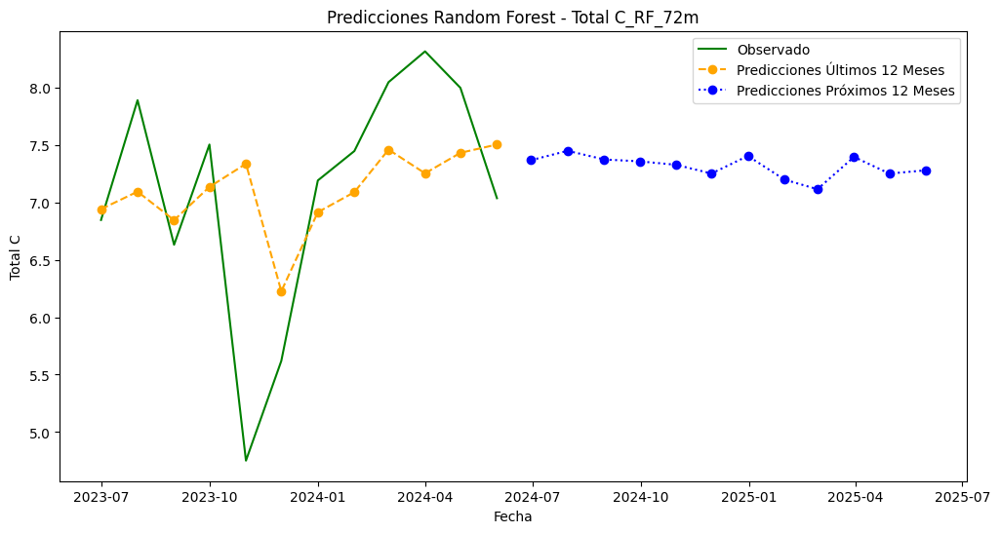


  Longitud de ventana: 84 meses
Total C_RF_84m - MAE: 0.69, MSE: 0.90, RMSE: 0.95, MAPE: 11.05%, AIC: -1.32, BIC: -1.32


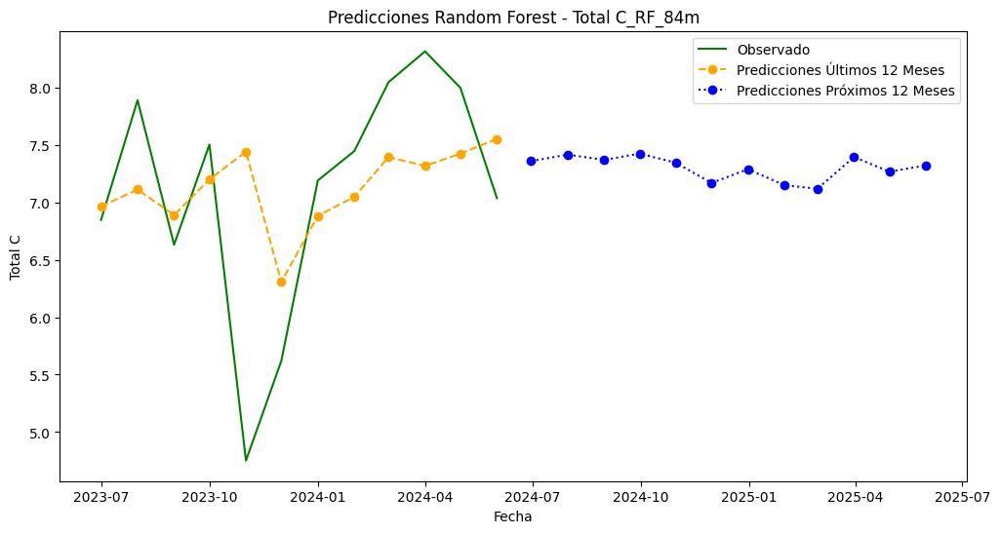


  Longitud de ventana: 96 meses
Total C_RF_96m - MAE: 0.72, MSE: 0.94, RMSE: 0.97, MAPE: 11.46%, AIC: -0.77, BIC: -0.77


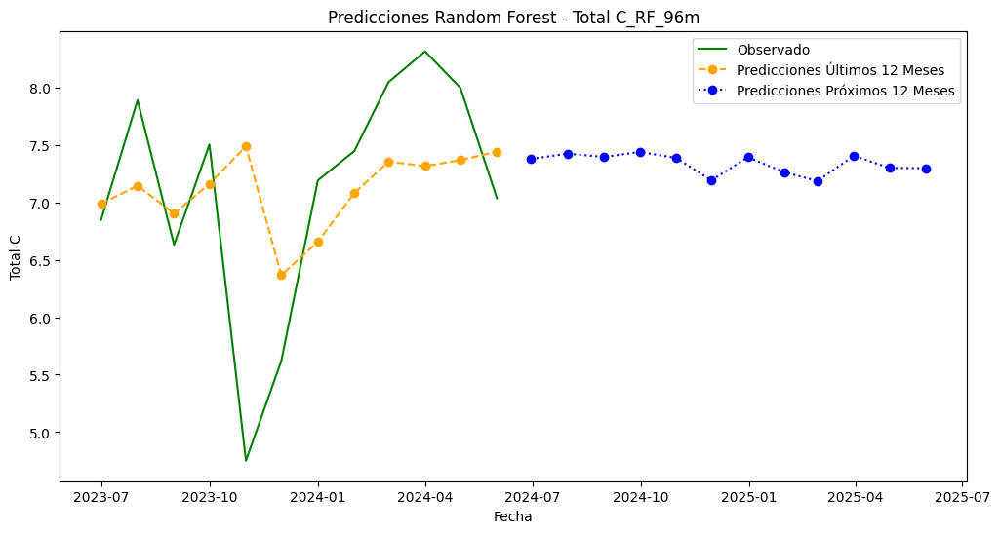


  Longitud de ventana: 108 meses
Total C_RF_108m - MAE: 0.71, MSE: 0.92, RMSE: 0.96, MAPE: 11.46%, AIC: -1.04, BIC: -1.04


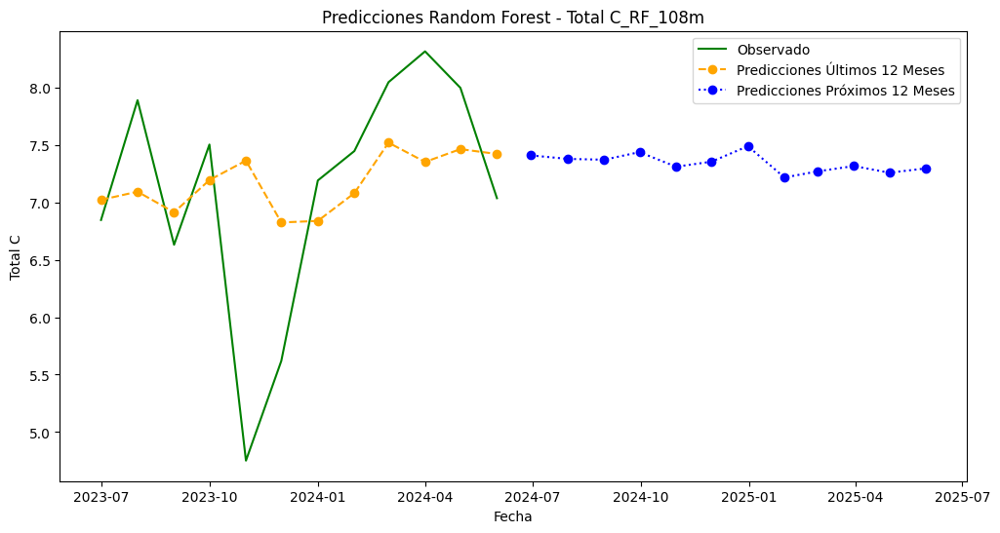

                        MAE        MSE      RMSE       MAPE        AIC  \
Total MyC_RF_48m   3.253015  16.854235  4.105391  14.504402  33.895224   
Total MyC_RF_60m   3.234039  16.328670  4.040875  14.366437  33.515069   
Total MyC_RF_72m   3.018448  13.646779  3.694155  13.374321  31.362043   
Total MyC_RF_84m   3.006956  12.907432  3.592691  13.258331  30.693639   
Total MyC_RF_96m   3.054541  14.110968  3.756457  13.322804  31.763428   
Total MyC_RF_108m  2.803481  12.524319  3.538971  12.230463  30.332067   
Total M_RF_48m     3.032180  15.145382  3.891707  20.522655  32.612348   
Total M_RF_60m     3.036228  15.186559  3.896994  20.479717  32.644929   
Total M_RF_72m     2.912949  14.161878  3.763227  19.331495  31.806644   
Total M_RF_84m     2.786848  13.667116  3.696906  18.940420  31.379912   
Total M_RF_96m     2.624555  11.196134  3.346062  17.722872  28.986823   
Total M_RF_108m    2.492343  10.180670  3.190716  16.897091  27.845890   
Total C_RF_48m     0.660410   0.874736

In [189]:
# Importar las librerías necesarias
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import MinMaxScaler
import random
import warnings

warnings.filterwarnings("ignore")

# Fijar las semillas
def set_seeds(seed):
    np.random.seed(seed)
    random.seed(seed)

# Leer el archivo Excel y establecer el índice
df = load_data()  # Asumiendo que tienes una función load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Lista de longitudes de ventana para probar
window_lengths = [48, 60, 72, 84, 96, 108]

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Crear un DataFrame para almacenar todas las predicciones
all_predictions_df = pd.DataFrame()

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Número de ejecuciones para promediar
num_runs = 5

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    for SEQ_LENGTH in window_lengths:
        print(f'\n  Longitud de ventana: {SEQ_LENGTH} meses')
        
        # Crear secuencias de entrada y salida
        X, y = create_sequences(scaled_data, SEQ_LENGTH)
        
        # Determinar el índice para los últimos 12 meses de datos
        test_start_index = len(X) - 12
        
        # Dividir los datos en entrenamiento y prueba
        X_train, X_test = X[:test_start_index], X[test_start_index:]
        y_train, y_test = y[:test_start_index], y[test_start_index:]
        
        all_predictions_last_12 = []
        all_future_predictions = []
        
        for run in range(num_runs):
            # Fijar la semilla para esta ejecución
            set_seeds(run)
            
            # Construir y entrenar el modelo Random Forest Regressor
            model = RandomForestRegressor(n_estimators=100, random_state=run)
            model.fit(X_train.reshape(X_train.shape[0], -1), y_train)
            
            # Predicciones sobre los últimos 12 meses
            predictions_last_12 = model.predict(X_test.reshape(X_test.shape[0], -1))
            predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
            all_predictions_last_12.append(predictions_last_12)
            
            # Predicciones sobre los siguientes 12 meses con el último dato real observado
            last_observed = scaled_data[-1]  # Último dato real observado
            last_sequence = np.append(X_test[-1][1:], last_observed).reshape(SEQ_LENGTH, 1)
            
            future_predictions = []
            for i in range(12):
                next_prediction = model.predict(last_sequence.reshape(1, -1))
                next_prediction = scaler.inverse_transform(next_prediction.reshape(-1, 1))
                future_predictions.append(next_prediction[0, 0])
                last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
            
            all_future_predictions.append(future_predictions)
        
        # Promediar las predicciones
        predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0)
        future_predictions_avg = np.mean(all_future_predictions, axis=0)
        
        # Guardar las predicciones en el DataFrame
        all_predictions_df[f'{var}_RF_{SEQ_LENGTH}m_Last12'] = predictions_last_12_avg.flatten()
        all_predictions_df[f'{var}_RF_{SEQ_LENGTH}m_Future12'] = future_predictions_avg.flatten()
        
        # Desnormalizar los datos reales de prueba
        y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
        
        # Calcular métricas de rendimiento para los últimos 12 meses
        mae = mean_absolute_error(y_test, predictions_last_12_avg)
        mse = mean_squared_error(y_test, predictions_last_12_avg)
        rmse = np.sqrt(mse)
        mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
        
        # Calcular el número de parámetros en el modelo (Random Forest no tiene "parámetros" tradicionales, así que se omite k)
        n = len(y_test)
        
        # Calcular la log-verosimilitud aproximada
        log_likelihood = -n / 2 * np.log(mse)
        
        # Calcular AIC y BIC
        aic = 2 * 0 - 2 * log_likelihood  # En lugar de 2k, aquí se usa 0 porque Random Forest no tiene un conteo de parámetros tradicional
        bic = 0 * np.log(n) - 2 * log_likelihood  # Lo mismo para BIC
        
        # Nombre ajustado para la variable
        adjusted_var_name = f"{var}_RF_{SEQ_LENGTH}m"
        
        # Almacenar las métricas en el diccionario
        metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape, 'AIC': aic, 'BIC': bic}
        
        # Imprimir métricas para los últimos 12 meses
        print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%, AIC: {aic:.2f}, BIC: {bic:.2f}')
        
        # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
        plt.figure(figsize=(12, 6))
        plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
        plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
        plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
        plt.xlabel('Fecha')
        plt.ylabel(var)
        plt.title(f'Predicciones Random Forest - {adjusted_var_name}')
        plt.legend()
        plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)

# Imprimir las predicciones guardadas en el DataFrame
print("\nPredicciones almacenadas en el DataFrame:")
print(all_predictions_df)


## Xgboost

### Modelo 1 Xgboost


Procesando variable: Total MyC
Total MyC_LSTM - Predicciones Últimos 12 Meses:
            Total MyC_LSTM_Observed  Total MyC_LSTM_Last_12_Months
2023-07-31                21.175622                      16.771301
2023-08-31                21.095133                      16.771301
2023-09-30                19.025496                      16.984850
2023-10-31                22.142541                      16.984850
2023-11-30                19.723840                      16.984850
2023-12-31                23.228727                      16.984850
2024-01-31                30.292845                      16.791527
2024-02-29                25.179372                      23.405106
2024-03-31                27.773655                      23.405106
2024-04-30                29.938865                      23.405106
2024-05-31                23.003551                      19.485342
2024-06-30                16.511880                      18.897181
Total MyC_LSTM - Predicciones Próximos 12 Meses:


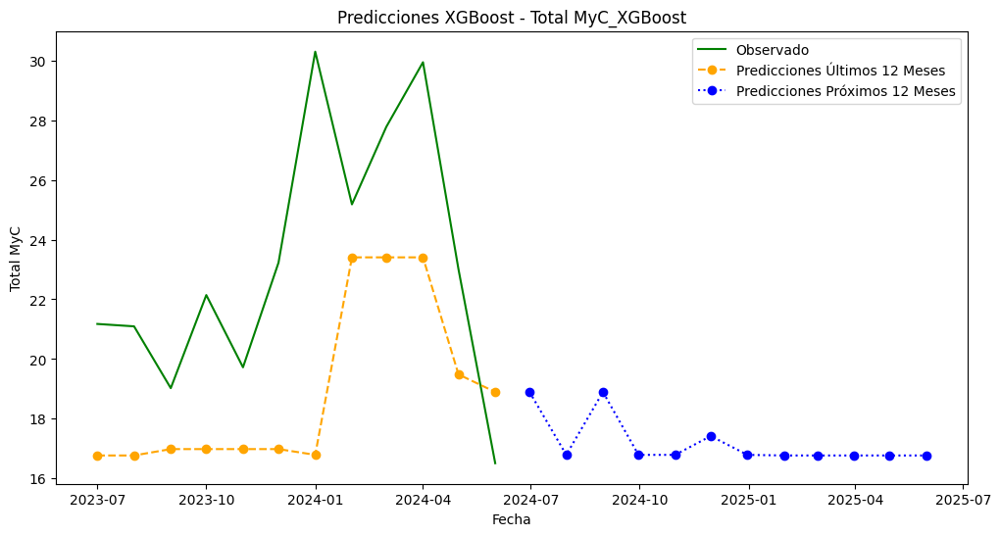


Procesando variable: Total M
Total M_LSTM - Predicciones Últimos 12 Meses:
            Total M_LSTM_Observed  Total M_LSTM_Last_12_Months
2023-07-31              14.329553                    12.280761
2023-08-31              13.206623                    13.341034
2023-09-30              12.394769                    12.398179
2023-10-31              14.639732                    13.284620
2023-11-30              14.972020                    13.186664
2023-12-31              17.609161                    13.186664
2024-01-31              23.102782                    14.917219
2024-02-29              17.733368                    14.917219
2024-03-31              19.728187                    13.752069
2024-04-30              21.625382                    13.669988
2024-05-31              15.007609                    13.669988
2024-06-30               9.476160                    12.448865
Total M_LSTM - Predicciones Próximos 12 Meses:
            Total M_LSTM_Future_12_Months
2024-07-31      

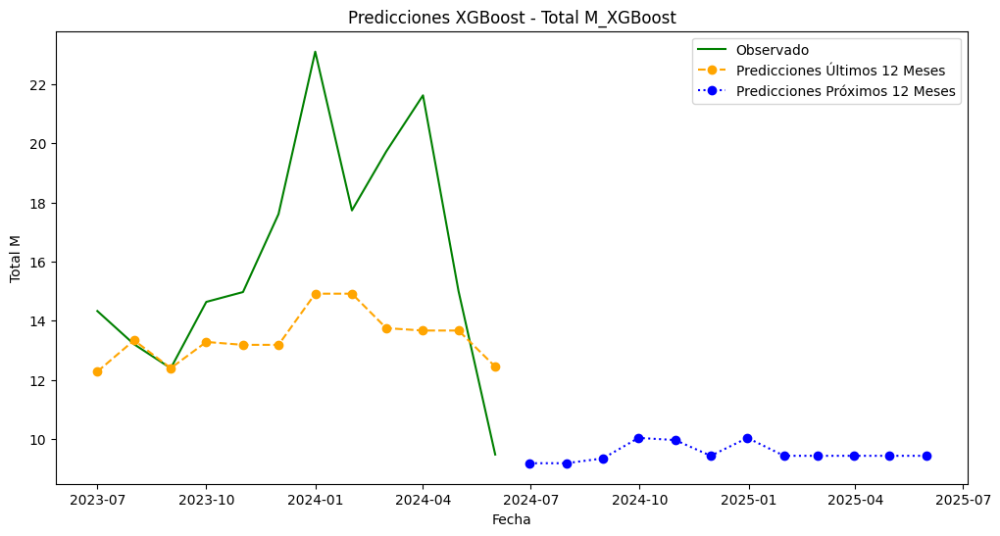


Procesando variable: Total C
Total C_LSTM - Predicciones Últimos 12 Meses:
            Total C_LSTM_Observed  Total C_LSTM_Last_12_Months
2023-07-31               6.846068                     6.066104
2023-08-31               7.888509                     6.052988
2023-09-30               6.630726                     6.189897
2023-10-31               7.502810                     6.410921
2023-11-30               4.751820                     6.353688
2023-12-31               5.619567                     5.449414
2024-01-31               7.190063                     6.447619
2024-02-29               7.446003                     6.178510
2024-03-31               8.045468                     6.565711
2024-04-30               8.313483                     6.263306
2024-05-31               7.995942                     6.496290
2024-06-30               7.035720                     6.529075
Total C_LSTM - Predicciones Próximos 12 Meses:
            Total C_LSTM_Future_12_Months
2024-07-31      

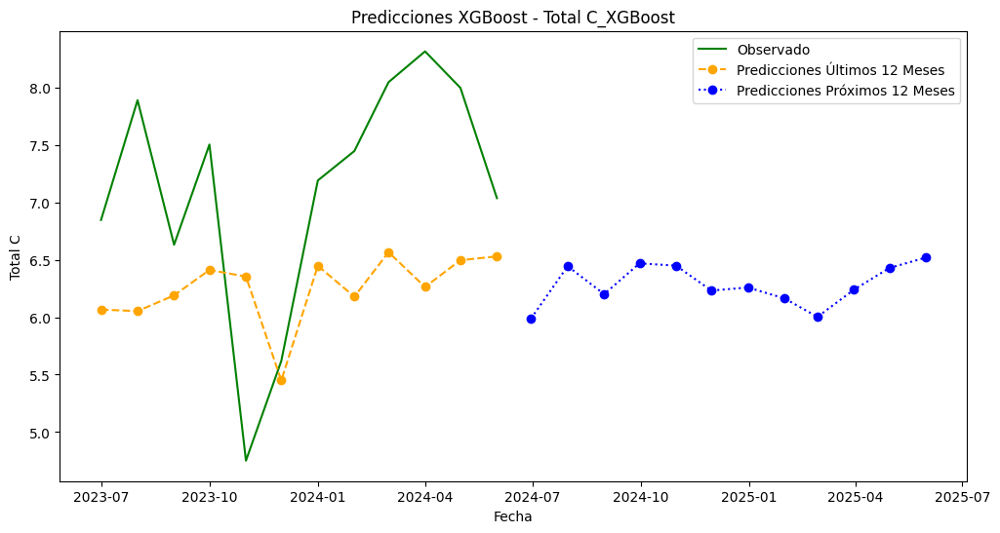

                        MAE        MSE      RMSE       MAPE
Total MyC_XGBoost  4.749230  31.718578  5.631925  19.582523
Total M_XGBoost    3.249427  17.780045  4.216639  18.359430
Total C_XGBoost    1.122200   1.584607  1.258812  15.746580


In [190]:
# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 48

# Número de ejecuciones para promediar
num_runs = 5

# Crear un DataFrame para almacenar todas las predicciones
all_predictions_df = pd.DataFrame(index=pd.date_range(start=df.index[-len(y_test):][0].to_timestamp(), periods=24, freq='M'))

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        np.random.seed(run)
        
        # Construir y entrenar el modelo XGBoost
        model = xgb.XGBRegressor(objective='reg:squarederror', n_estimators=100, learning_rate=0.01, max_depth=5, seed=run)
        model.fit(X_train.reshape(X_train.shape[0], -1), y_train)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = model.predict(X_test.reshape(X_test.shape[0], -1))
        predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses con el último dato real observado
        last_observed = scaled_data[-1]  # Último dato real observado
        last_sequence = np.append(X_test[-1][1:], last_observed).reshape(SEQ_LENGTH, 1)
        
        future_predictions = []
        for i in range(12):
            next_prediction = model.predict(last_sequence.reshape(1, SEQ_LENGTH))
            next_prediction = scaler.inverse_transform(next_prediction.reshape(-1, 1))
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0).flatten()
    future_predictions_avg = np.mean(all_future_predictions, axis=0).flatten()
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    
    # Almacenar las predicciones en el DataFrame
    adjusted_var_name = f"{var}_LSTM"
    all_predictions_df[f'{adjusted_var_name}_Observed'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Observed'].iloc[:len(y_test)] = y_test
    all_predictions_df[f'{adjusted_var_name}_Last_12_Months'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Last_12_Months'].iloc[:len(predictions_last_12_avg)] = predictions_last_12_avg
    all_predictions_df[f'{adjusted_var_name}_Future_12_Months'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Future_12_Months'].iloc[len(predictions_last_12_avg):] = future_predictions_avg
    
    # Imprimir las predicciones para revisión
    print(f'{adjusted_var_name} - Predicciones Últimos 12 Meses:')
    print(all_predictions_df[[f'{adjusted_var_name}_Observed', f'{adjusted_var_name}_Last_12_Months']].dropna())
    
    print(f'{adjusted_var_name} - Predicciones Próximos 12 Meses:')
    print(all_predictions_df[[f'{adjusted_var_name}_Future_12_Months']].dropna())

    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_XGBoost"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12_avg
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones XGBoost - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df_xgb_1 = pd.DataFrame(metrics_dict).T
print(metrics_df_xgb_1)


### Modelo 2 Xgboost 


Procesando variable: Total MyC
Fitting 3 folds for each of 6561 candidates, totalling 19683 fits
Mejores parámetros: {'alpha': 0, 'colsample_bytree': 0.7, 'lambda': 0, 'learning_rate': 0.2, 'max_depth': 7, 'min_child_weight': 1, 'n_estimators': 50, 'subsample': 0.7}
CV Mean Squared Error: 0.017827101515202202
Total MyC_LSTM - Predicciones Últimos 12 Meses:
            Total MyC_LSTM_Observed  Total MyC_LSTM_Last_12_Months
2023-07-31                21.175622                      20.048595
2023-08-31                21.095133                      22.140833
2023-09-30                19.025496                      22.684092
2023-10-31                22.142541                      22.264303
2023-11-30                19.723840                      23.568750
2023-12-31                23.228727                      23.167721
2024-01-31                30.292845                      21.485319
2024-02-29                25.179372                      28.629559
2024-03-31                27.773655  

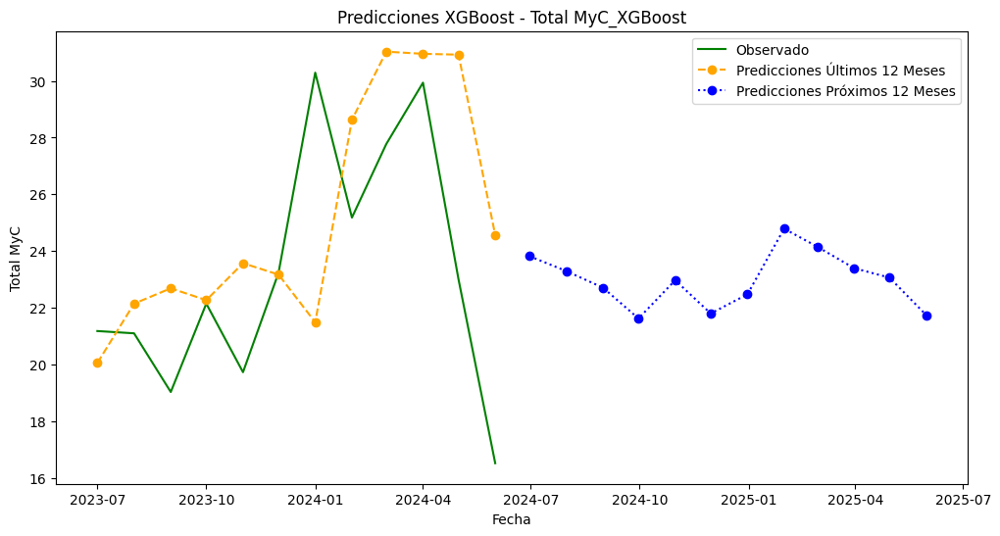


Procesando variable: Total M
Fitting 3 folds for each of 6561 candidates, totalling 19683 fits
Mejores parámetros: {'alpha': 0, 'colsample_bytree': 0.9, 'lambda': 2, 'learning_rate': 0.2, 'max_depth': 7, 'min_child_weight': 5, 'n_estimators': 200, 'subsample': 0.9}
CV Mean Squared Error: 0.026249040122411322
Total M_LSTM - Predicciones Últimos 12 Meses:
            Total M_LSTM_Observed  Total M_LSTM_Last_12_Months
2023-07-31              14.329553                    13.823870
2023-08-31              13.206623                    15.456897
2023-09-30              12.394769                    15.615237
2023-10-31              14.639732                    15.835968
2023-11-30              14.972020                    16.219351
2023-12-31              17.609161                    16.203501
2024-01-31              23.102782                    19.807163
2024-02-29              17.733368                    23.922598
2024-03-31              19.728187                    20.539106
2024-04-30   

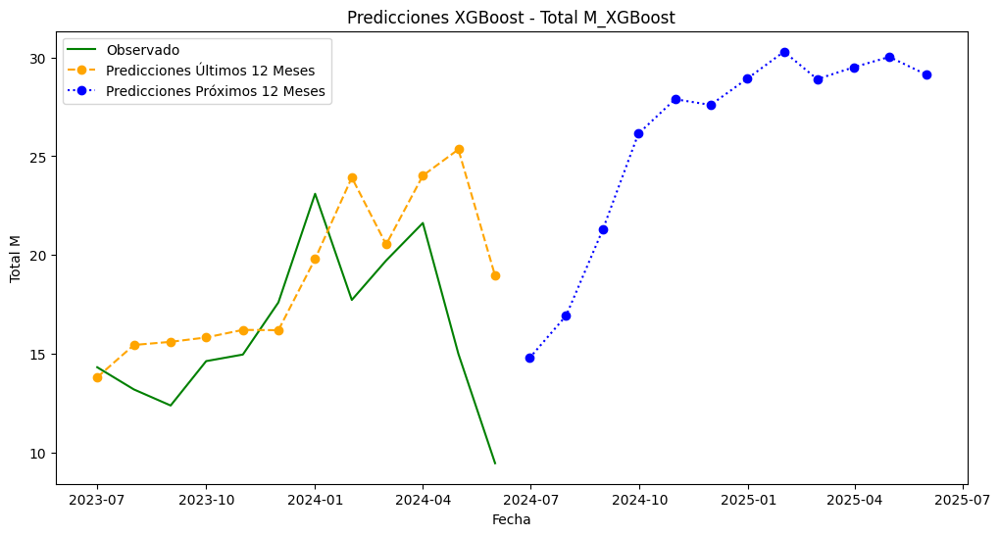


Procesando variable: Total C
Fitting 3 folds for each of 6561 candidates, totalling 19683 fits
Mejores parámetros: {'alpha': 0, 'colsample_bytree': 0.8, 'lambda': 0, 'learning_rate': 0.1, 'max_depth': 7, 'min_child_weight': 5, 'n_estimators': 200, 'subsample': 0.7}
CV Mean Squared Error: 0.002620185117318315
Total C_LSTM - Predicciones Últimos 12 Meses:
            Total C_LSTM_Observed  Total C_LSTM_Last_12_Months
2023-07-31               6.846068                     6.269183
2023-08-31               7.888509                     6.880723
2023-09-30               6.630726                     6.674516
2023-10-31               7.502810                     6.796100
2023-11-30               4.751820                     7.304580
2023-12-31               5.619567                     5.694876
2024-01-31               7.190063                     7.008824
2024-02-29               7.446003                     6.832309
2024-03-31               8.045468                     7.591549
2024-04-30   

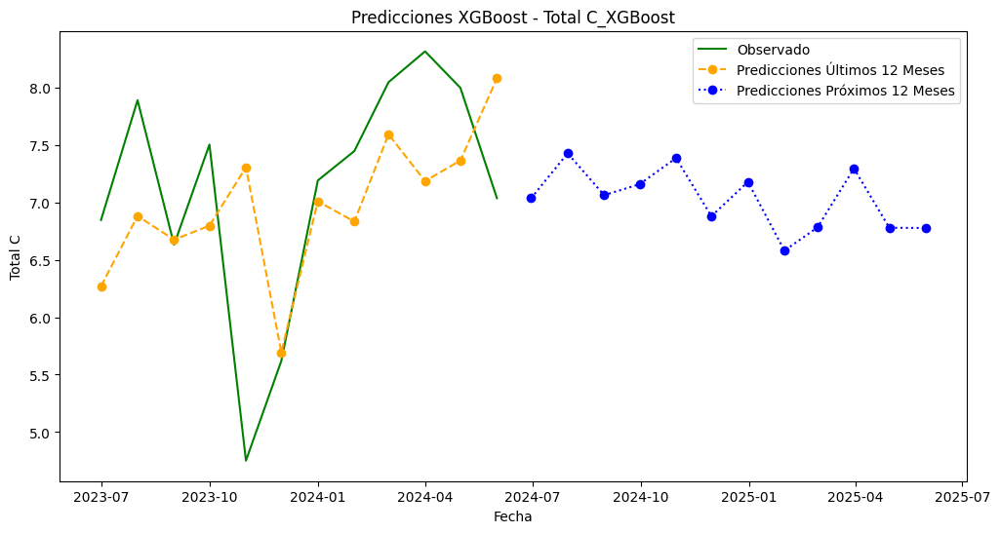

                        MAE        MSE      RMSE       MAPE
Total MyC_XGBoost  3.530839  21.608832  4.648530  15.911562
Total M_XGBoost    3.528223  22.749415  4.769635  25.361285
Total C_XGBoost    0.751311   0.979064  0.989477  11.587653
Stacking - MAE: 0.86, MSE: 1.59, RMSE: 1.26, MAPE: 14.19%


In [191]:
# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar predicciones y métricas de rendimiento
predictions_dict = {}
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 48

# Número de ejecuciones para promediar
num_runs = 5

# Crear un DataFrame para almacenar todas las predicciones
all_predictions_df = pd.DataFrame(index=pd.date_range(start=df.index[-len(y_test):][0].to_timestamp(), periods=24, freq='M'))

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    # Definir los parámetros para el grid search
    param_grid = {
        'n_estimators': [50, 100, 200],
        'learning_rate': [0.01, 0.1, 0.2],
        'max_depth': [3, 5, 7],
        'min_child_weight': [1, 5, 10],
        'subsample': [0.7, 0.8, 0.9],
        'colsample_bytree': [0.7, 0.8, 0.9],
        'lambda': [0, 1, 2],
        'alpha': [0, 1, 2]
    }
    
    # Crear el modelo XGBoost
    model = xgb.XGBRegressor(objective='reg:squarederror', seed=0)
    
    # Crear el GridSearchCV
    grid_search = GridSearchCV(estimator=model, param_grid=param_grid, cv=3, scoring='neg_mean_squared_error', n_jobs=-1, verbose=1)
    
    # Ajustar el modelo con los datos de entrenamiento
    grid_search.fit(X_train.reshape(X_train.shape[0], -1), y_train)
    
    # Obtener los mejores parámetros
    best_params = grid_search.best_params_
    print(f"Mejores parámetros: {best_params}")

    # Usar los mejores parámetros para crear el modelo final
    best_model = xgb.XGBRegressor(**best_params, objective='reg:squarederror', seed=0)
    
    # Validación cruzada
    cv_scores = cross_val_score(best_model, X_train.reshape(X_train.shape[0], -1), y_train, cv=3, scoring='neg_mean_squared_error')
    print(f"CV Mean Squared Error: {-cv_scores.mean()}")
    
    # Entrenamiento del modelo con los mejores parámetros
    best_model.fit(X_train.reshape(X_train.shape[0], -1), y_train)
    
    all_predictions_last_12 = []
    all_future_predictions = []
    
    for run in range(num_runs):
        # Fijar la semilla para esta ejecución
        np.random.seed(run)
        
        # Predicciones sobre los últimos 12 meses
        predictions_last_12 = best_model.predict(X_test.reshape(X_test.shape[0], -1))
        predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
        all_predictions_last_12.append(predictions_last_12)
        
        # Predicciones sobre los siguientes 12 meses con el último dato real observado
        last_observed = scaled_data[-1]  # Último dato real observado
        last_sequence = np.append(X_test[-1][1:], last_observed).reshape(SEQ_LENGTH, 1)
        
        future_predictions = []
        for i in range(12):
            next_prediction = best_model.predict(last_sequence.reshape(1, SEQ_LENGTH))
            next_prediction = scaler.inverse_transform(next_prediction.reshape(-1, 1))
            future_predictions.append(next_prediction[0, 0])
            last_sequence = np.append(last_sequence[1:], scaler.transform(next_prediction)).reshape(SEQ_LENGTH, 1)
        
        all_future_predictions.append(future_predictions)
    
    # Promediar las predicciones
    predictions_last_12_avg = np.mean(all_predictions_last_12, axis=0).flatten()
    future_predictions_avg = np.mean(all_future_predictions, axis=0).flatten()
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()
    
    # Almacenar las predicciones en el DataFrame
    adjusted_var_name = f"{var}_LSTM"
    all_predictions_df[f'{adjusted_var_name}_Observed'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Observed'].iloc[:len(y_test)] = y_test
    all_predictions_df[f'{adjusted_var_name}_Last_12_Months'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Last_12_Months'].iloc[:len(predictions_last_12_avg)] = predictions_last_12_avg
    all_predictions_df[f'{adjusted_var_name}_Future_12_Months'] = np.nan
    all_predictions_df[f'{adjusted_var_name}_Future_12_Months'].iloc[len(predictions_last_12_avg):] = future_predictions_avg
    
    # Imprimir las predicciones para revisión
    print(f'{adjusted_var_name} - Predicciones Últimos 12 Meses:')
    print(all_predictions_df[[f'{adjusted_var_name}_Observed', f'{adjusted_var_name}_Last_12_Months']].dropna())
    
    print(f'{adjusted_var_name} - Predicciones Próximos 12 Meses:')
    print(all_predictions_df[[f'{adjusted_var_name}_Future_12_Months']].dropna())
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12_avg)
    mse = mean_squared_error(y_test, predictions_last_12_avg)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12_avg) / y_test)) * 100
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_XGBoost"
    
    # Almacenar las predicciones y métricas en los diccionarios
    predictions_dict[adjusted_var_name] = predictions_last_12_avg
    predictions_dict[f'{adjusted_var_name}_Future'] = np.array(future_predictions_avg).reshape(-1, 1)
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%')
    
    # Visualizar las predicciones para los últimos 12 meses y los próximos 12 meses
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Observado', color='green')
    plt.plot(df.index[-len(predictions_last_12_avg):].to_timestamp(), predictions_last_12_avg, label='Predicciones Últimos 12 Meses', linestyle='dashed', marker='o', color='orange')
    plt.plot(pd.date_range(df.index[-1].to_timestamp(), periods=12, freq='M'), future_predictions_avg, label='Predicciones Próximos 12 Meses', linestyle='dotted', marker='o', color='blue')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.title(f'Predicciones XGBoost - {adjusted_var_name}')
    plt.legend()
    plt.show()

# Guardar las métricas de rendimiento en un DataFrame para su análisis posterior
metrics_df = pd.DataFrame(metrics_dict).T
print(metrics_df)

# Ejemplo de ensemble de modelos (opcional)
base_models = [
    ('xgb', best_model)
    # Puedes agregar más modelos aquí
]

stacking_model = StackingRegressor(estimators=base_models, final_estimator=xgb.XGBRegressor(objective='reg:squarederror', seed=0))
stacking_model.fit(X_train.reshape(X_train.shape[0], -1), y_train)
stacking_predictions = stacking_model.predict(X_test.reshape(X_test.shape[0], -1))
stacking_predictions = scaler.inverse_transform(stacking_predictions.reshape(-1, 1))

# Calcular métricas de rendimiento para el modelo de stacking
stacking_mae = mean_absolute_error(y_test, stacking_predictions)
stacking_mse = mean_squared_error(y_test, stacking_predictions)
stacking_rmse = np.sqrt(stacking_mse)
stacking_mape = np.mean(np.abs((y_test - stacking_predictions) / y_test)) * 100

print(f'Stacking - MAE: {stacking_mae:.2f}, MSE: {stacking_mse:.2f}, RMSE: {stacking_rmse:.2f}, MAPE: {stacking_mape:.2f}%')


### Dataframe para comparar métricas de performance de los Xgboost

In [192]:
# Datos para Total MyC
data_MyC_xgb = {
    'Modelo': [
        'Modelo 1', 'Modelo 2'
    ],
    'MAE': [14.912581, 11.086836],
    'MSE': [312.732493, 213.054428],
    'RMSE': [17.684244, 14.596384],
    'MAPE': [19.582522, 15.911562]
}

# Datos para Total M
data_M_xgb = {
    'Modelo': [
        'Modelo 1', 'Modelo 2'
    ],
    'MAE': [10.203201, 11.078619],
    'MSE': [175.304115, 224.300107],
    'RMSE': [13.240246, 14.976652],
    'MAPE': [18.359429, 25.361285]
}

# Datos para Total C
data_C_xgb = {
    'Modelo': [
        'Modelo 1', 'Modelo 2'
    ],
    'MAE': [3.523707, 2.359117],
    'MSE': [15.623595, 9.653176],
    'RMSE': [3.952669, 3.106956],
    'MAPE': [15.746580, 11.587650]
}

# Función para resaltar la mejor métrica en negrita y verde
def highlight_best(s):
    is_best = s == s.min()
    return ['font-weight: bold; color: green' if v else '' for v in is_best]

# Creación de los DataFrames
df_MyC_xgb = pd.DataFrame(data_MyC_xgb)
df_M_xgb = pd.DataFrame(data_M_xgb)
df_C_xgb = pd.DataFrame(data_C_xgb)

# Aplicar estilo a los DataFrames y mostrar
styled_df_MyC_xgb = df_MyC_xgb.style.apply(highlight_best, subset=['MAE', 'MSE', 'RMSE', 'MAPE'])
styled_df_M_xgb = df_M_xgb.style.apply(highlight_best, subset=['MAE', 'MSE', 'RMSE', 'MAPE'])
styled_df_C_xgb = df_C_xgb.style.apply(highlight_best, subset=['MAE', 'MSE', 'RMSE', 'MAPE'])

print("DataFrame para Total MyC:")
display(styled_df_MyC_xgb)

print("\nDataFrame para Total M:")
display(styled_df_M_xgb)

print("\nDataFrame para Total C:")
display(styled_df_C_xgb)


DataFrame para Total MyC:


,Modelo,MAE,MSE,RMSE,MAPE
0,Modelo 1,14.912581,312.732493,17.684244,19.582522
1,Modelo 2,11.086836,213.054428,14.596384,15.911562



DataFrame para Total M:


,Modelo,MAE,MSE,RMSE,MAPE
0,Modelo 1,10.203201,175.304115,13.240246,18.359429
1,Modelo 2,11.078619,224.300107,14.976652,25.361285



DataFrame para Total C:


,Modelo,MAE,MSE,RMSE,MAPE
0,Modelo 1,3.523707,15.623595,3.952669,15.746580
1,Modelo 2,2.359117,9.653176,3.106956,11.587650


## FBprophet

### Prueba con FBprophet

11:24:09 - cmdstanpy - INFO - Chain [1] start processing
11:24:09 - cmdstanpy - INFO - Chain [1] done processing


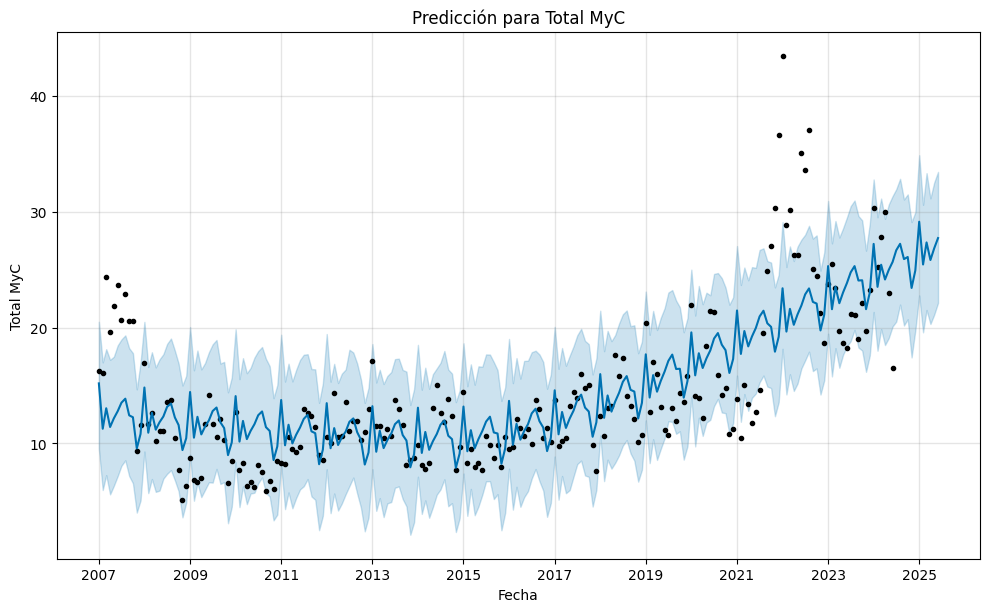

11:24:11 - cmdstanpy - INFO - Chain [1] start processing
11:24:11 - cmdstanpy - INFO - Chain [1] done processing


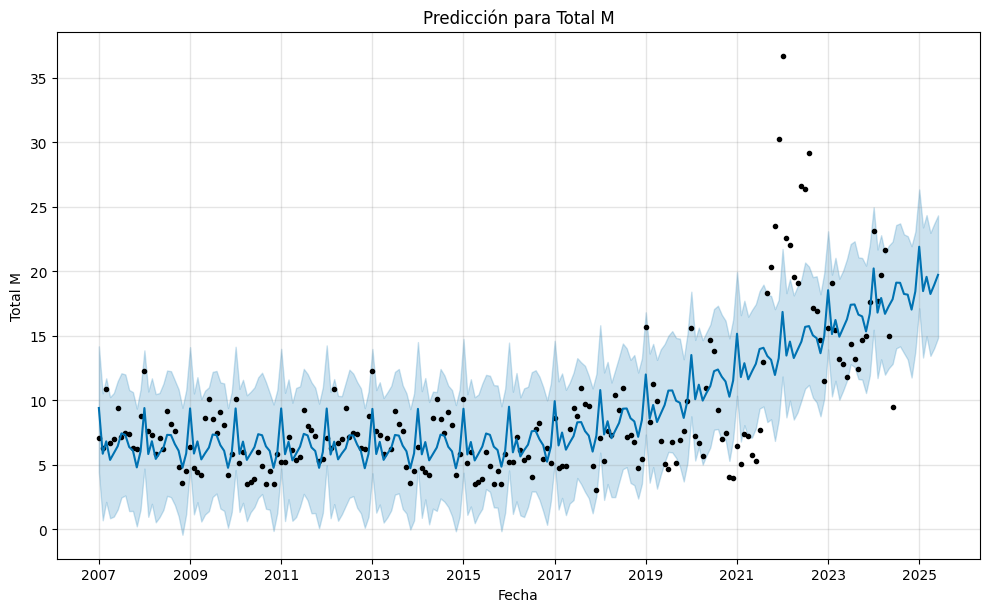

11:24:12 - cmdstanpy - INFO - Chain [1] start processing
11:24:12 - cmdstanpy - INFO - Chain [1] done processing


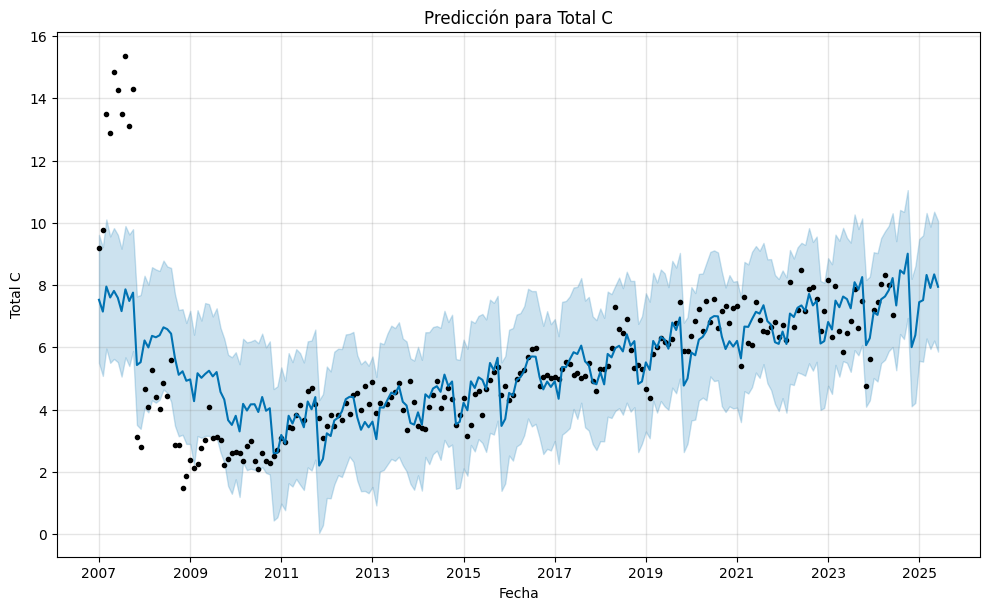

In [193]:
# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Crear un diccionario para almacenar los modelos y las predicciones
modelos_prophet = {}
predicciones = {}

for var in variables:
    # Preparar los datos para Prophet
    df_prophet = df[[var]].reset_index()
    df_prophet.columns = ['ds', 'y']  # Renombrar columnas según los requisitos de Prophet
    df_prophet['ds'] = df_prophet['ds'].dt.to_timestamp()  # Convertir el índice de periodo a timestamp

    # Instanciar y entrenar el modelo Prophet
    modelo = Prophet()
    modelo.fit(df_prophet)

    # Guardar el modelo en el diccionario
    modelos_prophet[var] = modelo

    # Realizar predicciones
    futuro = modelo.make_future_dataframe(periods=12, freq='M')  # Predecir los próximos 12 meses
    pronostico = modelo.predict(futuro)

    # Guardar las predicciones
    predicciones[var] = pronostico[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]

    # Graficar los resultados
    modelo.plot(pronostico)
    plt.title(f'Predicción para {var}')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.show()

# Puedes acceder a las predicciones individuales usando predicciones['Total MyC'], predicciones['Total M'], etc.


11:24:16 - cmdstanpy - INFO - Chain [1] start processing
11:24:16 - cmdstanpy - INFO - Chain [1] done processing


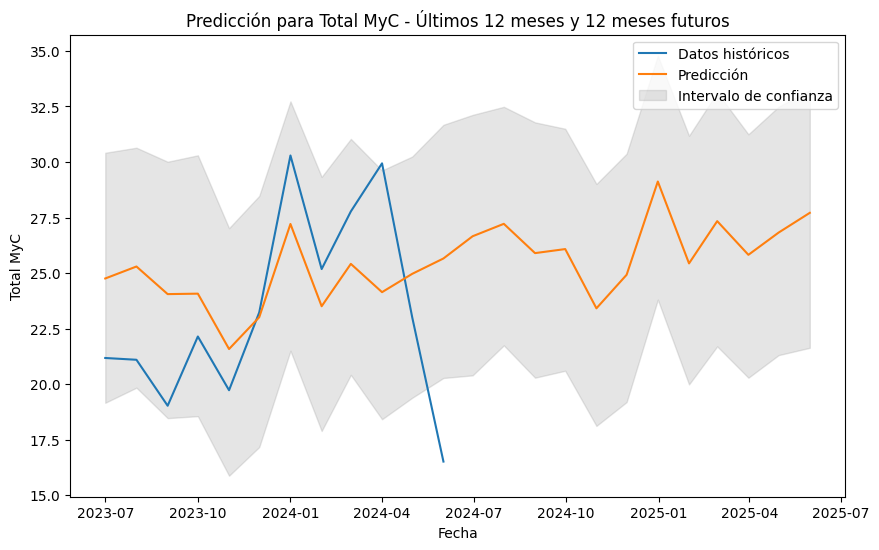

11:24:17 - cmdstanpy - INFO - Chain [1] start processing
11:24:17 - cmdstanpy - INFO - Chain [1] done processing


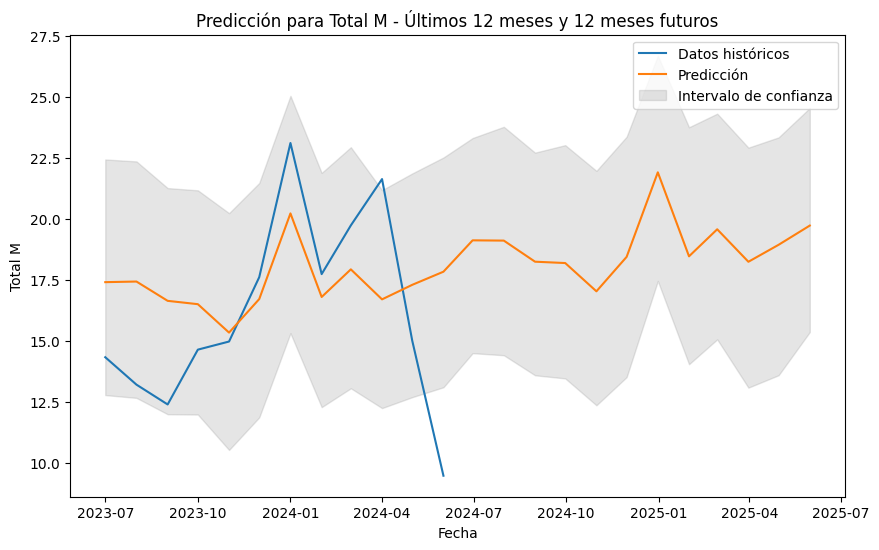

11:24:18 - cmdstanpy - INFO - Chain [1] start processing
11:24:19 - cmdstanpy - INFO - Chain [1] done processing


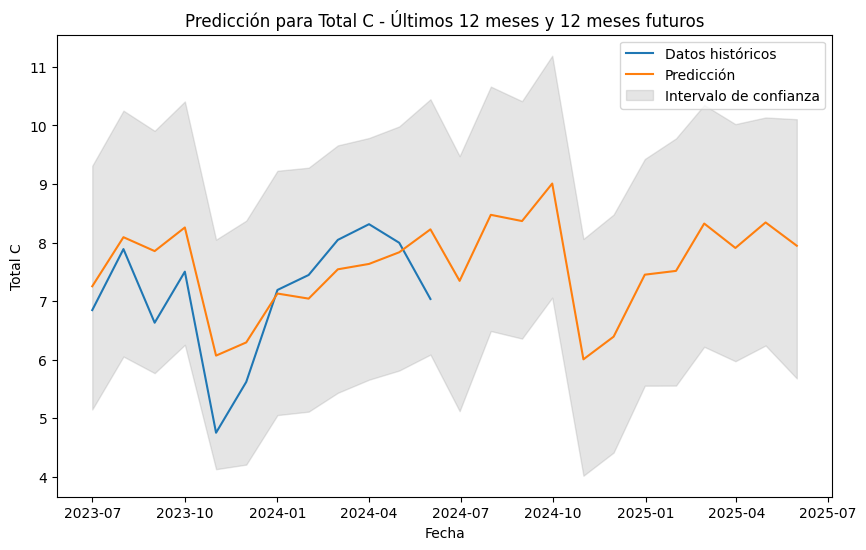

In [194]:
# Leer el archivo Excel y establecer el índice
df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Crear un diccionario para almacenar los modelos y las predicciones
modelos_prophet = {}
predicciones = {}

for var in variables:
    # Preparar los datos para Prophet
    df_prophet = df[[var]].reset_index()
    df_prophet.columns = ['ds', 'y']  # Renombrar columnas según los requisitos de Prophet
    df_prophet['ds'] = df_prophet['ds'].dt.to_timestamp()  # Convertir el índice de periodo a timestamp

    # Instanciar y entrenar el modelo Prophet
    modelo = Prophet()
    modelo.fit(df_prophet)

    # Guardar el modelo en el diccionario
    modelos_prophet[var] = modelo

    # Realizar predicciones
    futuro = modelo.make_future_dataframe(periods=12, freq='M')  # Predecir los próximos 12 meses
    pronostico = modelo.predict(futuro)

    # Guardar las predicciones
    predicciones[var] = pronostico[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]

    # Filtrar los últimos 12 meses de datos reales y los 12 meses de predicciones
    start_date = df_prophet['ds'].max() - pd.DateOffset(months=11)  # Primer mes de los últimos 12 meses
    end_date = futuro['ds'].max()  # Último mes de las predicciones

    # Filtrar datos históricos y predicciones dentro del rango deseado
    df_filtered = df_prophet[(df_prophet['ds'] >= start_date) & (df_prophet['ds'] <= end_date)]
    pred_filtered = pronostico[(pronostico['ds'] >= start_date) & (pronostico['ds'] <= end_date)]

    # Graficar los resultados para los últimos 12 meses de datos históricos y 12 meses de predicciones
    plt.figure(figsize=(10, 6))
    plt.plot(df_filtered['ds'], df_filtered['y'], label='Datos históricos')
    plt.plot(pred_filtered['ds'], pred_filtered['yhat'], label='Predicción')
    plt.fill_between(pred_filtered['ds'], 
                     pred_filtered['yhat_lower'], 
                     pred_filtered['yhat_upper'], 
                     color='gray', alpha=0.2, label='Intervalo de confianza')
    plt.title(f'Predicción para {var} - Últimos 12 meses y 12 meses futuros')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.legend()
    plt.show()

# Puedes acceder a las predicciones individuales usando predicciones['Total MyC'], predicciones['Total M'], etc.


11:24:21 - cmdstanpy - INFO - Chain [1] start processing
11:24:21 - cmdstanpy - INFO - Chain [1] done processing
11:24:22 - cmdstanpy - INFO - Chain [1] start processing
11:24:22 - cmdstanpy - INFO - Chain [1] done processing
11:24:22 - cmdstanpy - INFO - Chain [1] start processing
11:24:22 - cmdstanpy - INFO - Chain [1] done processing
11:24:22 - cmdstanpy - INFO - Chain [1] start processing
11:24:22 - cmdstanpy - INFO - Chain [1] done processing


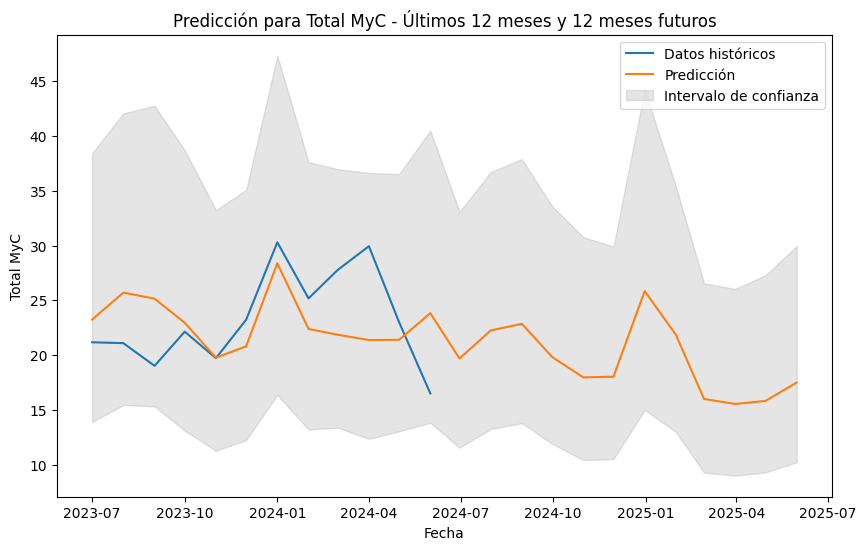

11:24:23 - cmdstanpy - INFO - Chain [1] start processing
11:24:23 - cmdstanpy - INFO - Chain [1] done processing
11:24:24 - cmdstanpy - INFO - Chain [1] start processing
11:24:24 - cmdstanpy - INFO - Chain [1] done processing
11:24:24 - cmdstanpy - INFO - Chain [1] start processing
11:24:24 - cmdstanpy - INFO - Chain [1] done processing
11:24:24 - cmdstanpy - INFO - Chain [1] start processing
11:24:24 - cmdstanpy - INFO - Chain [1] done processing


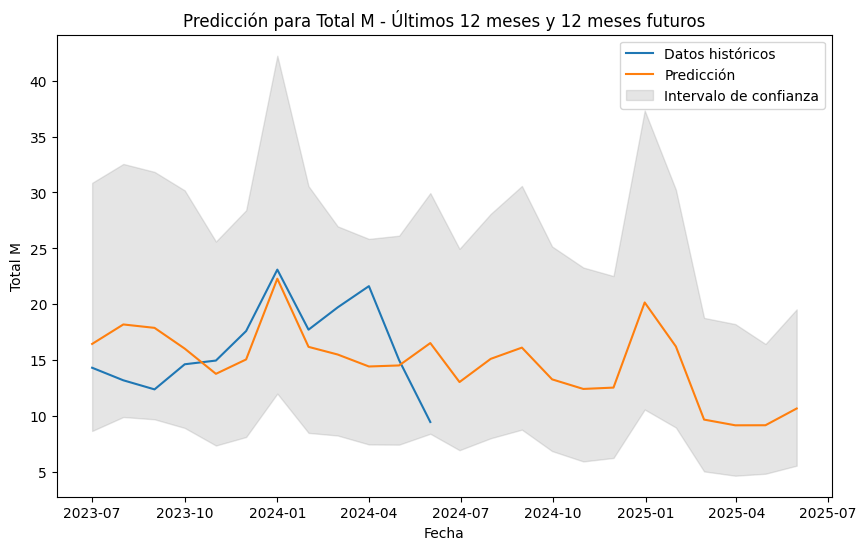

11:24:25 - cmdstanpy - INFO - Chain [1] start processing
11:24:25 - cmdstanpy - INFO - Chain [1] done processing
11:24:26 - cmdstanpy - INFO - Chain [1] start processing
11:24:26 - cmdstanpy - INFO - Chain [1] done processing
11:24:26 - cmdstanpy - INFO - Chain [1] start processing
11:24:26 - cmdstanpy - INFO - Chain [1] done processing
11:24:26 - cmdstanpy - INFO - Chain [1] start processing
11:24:26 - cmdstanpy - INFO - Chain [1] done processing


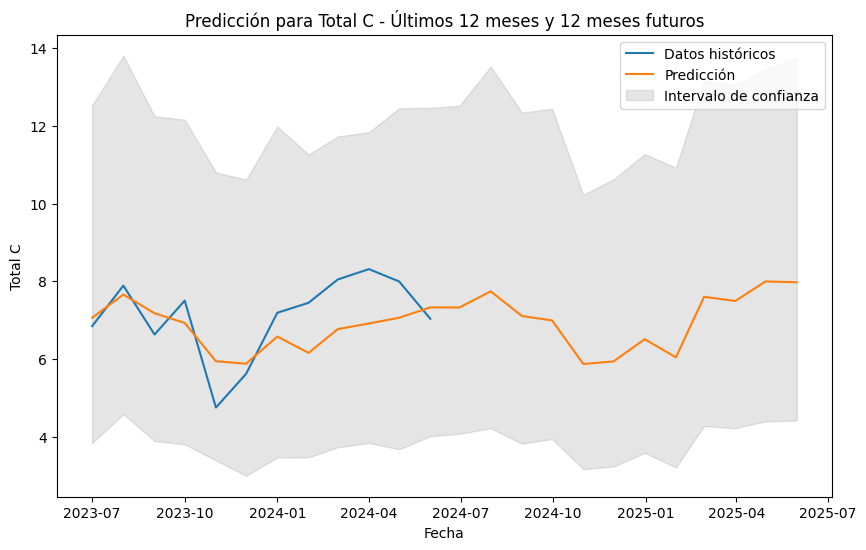

In [195]:
from sklearn.model_selection import ParameterGrid
from sklearn.metrics import mean_absolute_error
import numpy as np

# Leer el archivo Excel y establecer el índice
df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Crear un diccionario para almacenar los mejores modelos y las predicciones
mejores_modelos_prophet = {}
mejores_predicciones = {}

# Definir el grid de hiperparámetros
param_grid = {
    'seasonality_mode': ['additive'],              # Usar solo modo aditivo para mayor estabilidad
    'changepoint_prior_scale': [0.01, 0.05],       # Escala conservadora para cambios de tendencia
    'seasonality_prior_scale': [1.0, 5.0],         # Escala conservadora para estacionalidad
    'yearly_seasonality': [True],
    'weekly_seasonality': [False],
    'daily_seasonality': [False],
    'interval_width': [0.95]
}

# Crear una grilla de combinaciones de parámetros
grid = ParameterGrid(param_grid)

# Loop a través de cada variable
for var in variables:
    # Preparar los datos para Prophet
    df_prophet = df[[var]].reset_index()
    df_prophet.columns = ['ds', 'y']
    df_prophet['ds'] = df_prophet['ds'].dt.to_timestamp()

    # Evitar predicciones negativas - Log Transform
    df_prophet['y'] = np.log(df_prophet['y'] + 1)

    mejor_modelo = None
    mejor_error = float('inf')
    mejor_prediccion = None

    # Probar cada combinación de parámetros
    for params in grid:
        # Instanciar el modelo con los parámetros actuales
        modelo = Prophet(**params)
        modelo.add_seasonality(name='mensual', period=30.5, fourier_order=5)

        # Establecer el límite superior para crecimiento logístico (en log transformado)
        df_prophet['cap'] = df_prophet['y'].max() * 1.1
        modelo.growth = 'logistic'

        # Entrenar el modelo
        modelo.fit(df_prophet)

        # Realizar predicciones
        futuro = modelo.make_future_dataframe(periods=12, freq='M')
        futuro['cap'] = df_prophet['cap'].iloc[0]
        pronostico = modelo.predict(futuro)

        # Invertir la transformación logarítmica
        pronostico['yhat'] = np.exp(pronostico['yhat']) - 1
        pronostico['yhat_lower'] = np.exp(pronostico['yhat_lower']) - 1
        pronostico['yhat_upper'] = np.exp(pronostico['yhat_upper']) - 1

        # Calcular el error para los últimos 12 meses de datos reales
        y_real = np.exp(df_prophet['y'].values[-12:]) - 1
        y_pred = pronostico['yhat'].values[:len(y_real)]
        error = mean_absolute_error(y_real, y_pred)

        # Guardar el mejor modelo
        if error < mejor_error:
            mejor_error = error
            mejor_modelo = modelo
            mejor_prediccion = pronostico

    # Guardar el mejor modelo y sus predicciones
    mejores_modelos_prophet[var] = mejor_modelo
    mejores_predicciones[var] = mejor_prediccion[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]

    # Filtrar los últimos 12 meses de datos reales y 12 meses de predicciones
    start_date = df_prophet['ds'].max() - pd.DateOffset(months=11)
    end_date = mejor_prediccion['ds'].max()

    df_filtered = df_prophet[(df_prophet['ds'] >= start_date) & (df_prophet['ds'] <= end_date)]
    pred_filtered = mejor_prediccion[(mejor_prediccion['ds'] >= start_date) & (mejor_prediccion['ds'] <= end_date)]

    # Graficar los resultados para los últimos 12 meses de datos históricos y 12 meses de predicciones
    plt.figure(figsize=(10, 6))
    plt.plot(df_filtered['ds'], np.exp(df_filtered['y']) - 1, label='Datos históricos')
    plt.plot(pred_filtered['ds'], pred_filtered['yhat'], label='Predicción')
    plt.fill_between(pred_filtered['ds'], 
                     pred_filtered['yhat_lower'], 
                     pred_filtered['yhat_upper'], 
                     color='gray', alpha=0.2, label='Intervalo de confianza')
    plt.title(f'Predicción para {var} - Últimos 12 meses y 12 meses futuros')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.legend()
    plt.show()

# Puedes acceder a las mejores predicciones individuales usando mejores_predicciones['Total MyC'], mejores_predicciones['Total M'], etc.


### Modelo 1 FBprophet

11:24:29 - cmdstanpy - INFO - Chain [1] start processing
11:24:29 - cmdstanpy - INFO - Chain [1] done processing


Métricas para Total MyC:
MAE: 3.06
MSE: 18.81
RMSE: 4.34
MAPE: 22.17%
---


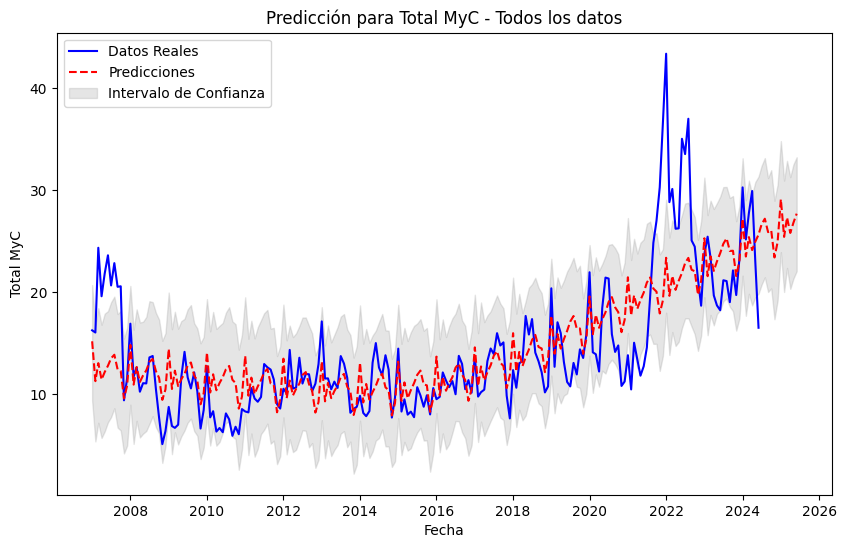

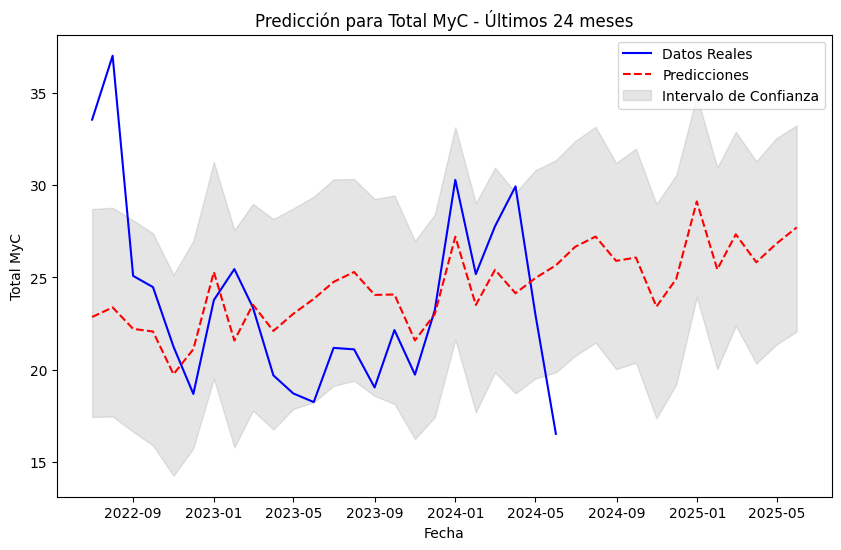

11:24:30 - cmdstanpy - INFO - Chain [1] start processing
11:24:30 - cmdstanpy - INFO - Chain [1] done processing


Métricas para Total M:
MAE: 2.52
MSE: 13.88
RMSE: 3.73
MAPE: 31.15%
---


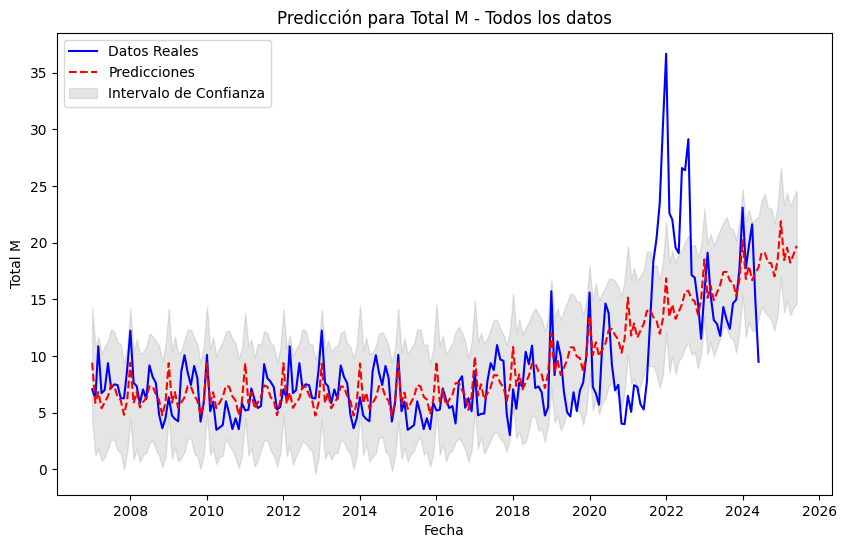

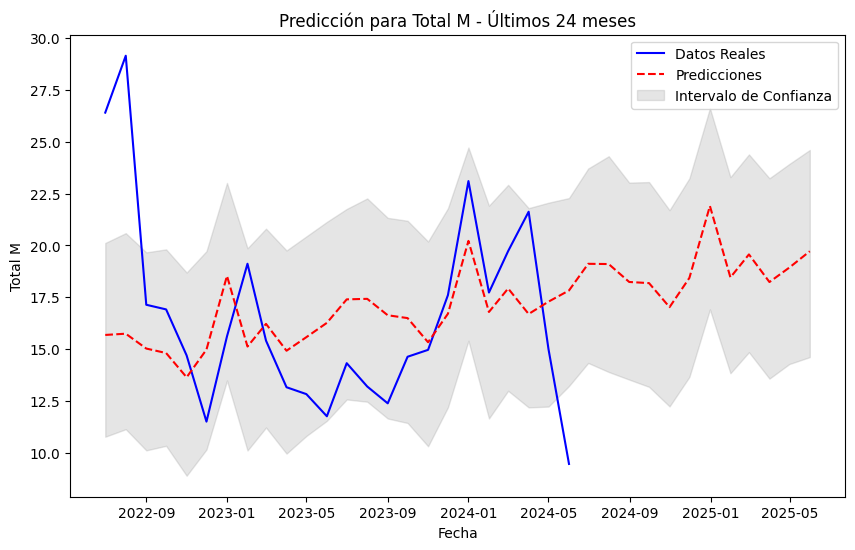

11:24:32 - cmdstanpy - INFO - Chain [1] start processing
11:24:32 - cmdstanpy - INFO - Chain [1] done processing


Métricas para Total C:
MAE: 0.97
MSE: 2.59
RMSE: 1.61
MAPE: 21.35%
---


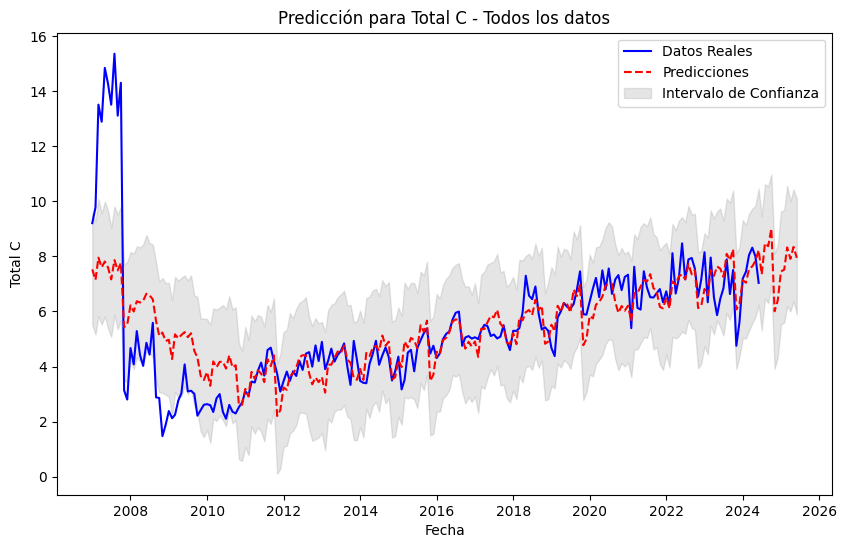

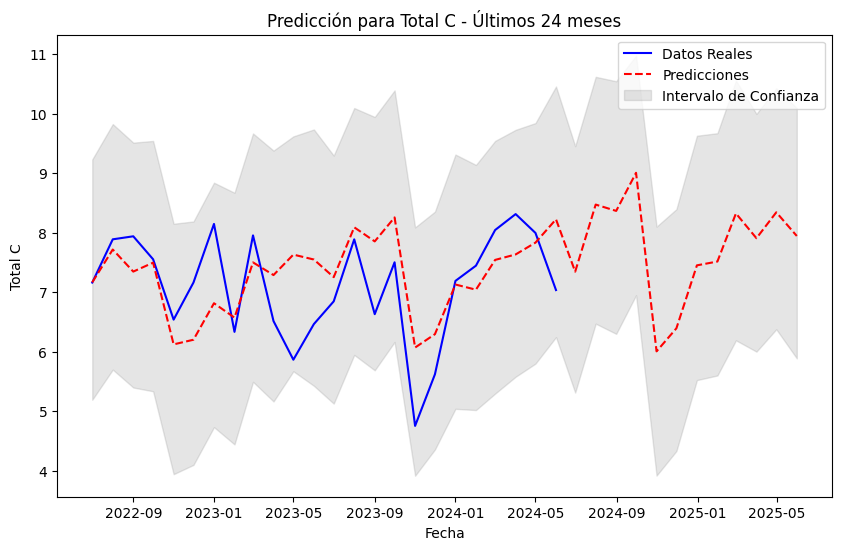

In [196]:
# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Crear un diccionario para almacenar los modelos, las predicciones y las métricas
modelos_prophet = {}
predicciones = {}
metricas = {}

for var in variables:
    # Preparar los datos para Prophet
    df_prophet = df[[var]].reset_index()
    df_prophet.columns = ['ds', 'y']  # Renombrar columnas según los requisitos de Prophet
    df_prophet['ds'] = df_prophet['ds'].dt.to_timestamp()  # Convertir el índice de periodo a timestamp

    # Instanciar y entrenar el modelo Prophet
    modelo = Prophet()
    modelo.fit(df_prophet)

    # Guardar el modelo en el diccionario
    modelos_prophet[var] = modelo

    # Realizar predicciones
    futuro = modelo.make_future_dataframe(periods=12, freq='M')  # Predecir los próximos 12 meses
    pronostico = modelo.predict(futuro)

    # Guardar las predicciones
    predicciones[var] = pronostico[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]

    # Filtrar el pronóstico para solo los períodos observados
    pronostico_observado = pronostico[pronostico['ds'] <= df_prophet['ds'].max()]

    # Calcular métricas de rendimiento
    y_true = df_prophet['y']
    y_pred = pronostico_observado['yhat']

    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    # Guardar las métricas
    metricas[var] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape}

    # Mostrar las métricas
    print(f'Métricas para {var}:')
    print(f'MAE: {mae:.2f}')
    print(f'MSE: {mse:.2f}')
    print(f'RMSE: {rmse:.2f}')
    print(f'MAPE: {mape:.2%}')
    print('---')

    # Graficar todos los datos con las predicciones
    plt.figure(figsize=(10, 6))
    
    # Graficar los datos reales
    plt.plot(df_prophet['ds'], df_prophet['y'], label='Datos Reales', color='blue')
    
    # Graficar las predicciones
    plt.plot(pronostico['ds'], pronostico['yhat'], label='Predicciones', color='red', linestyle='--')
    
    plt.fill_between(pronostico['ds'], pronostico['yhat_lower'], pronostico['yhat_upper'], color='gray', alpha=0.2, label='Intervalo de Confianza')
    
    plt.title(f'Predicción para {var} - Todos los datos')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.legend()
    plt.show()

    # Graficar solo los últimos 24 meses (12 meses reales + 12 meses predicción)
    plt.figure(figsize=(10, 6))

    # Definir el rango de fechas para los últimos 24 meses
    fecha_inicio = df_prophet['ds'].max() - pd.DateOffset(months=23)

    # Graficar los datos reales de los últimos 12 meses
    plt.plot(df_prophet[df_prophet['ds'] >= fecha_inicio]['ds'], 
             df_prophet[df_prophet['ds'] >= fecha_inicio]['y'], 
             label='Datos Reales', color='blue')
    
    # Graficar las predicciones para los próximos 12 meses
    plt.plot(pronostico[pronostico['ds'] >= fecha_inicio]['ds'], 
             pronostico[pronostico['ds'] >= fecha_inicio]['yhat'], 
             label='Predicciones', color='red', linestyle='--')
    
    plt.fill_between(pronostico[pronostico['ds'] >= fecha_inicio]['ds'], 
                     pronostico[pronostico['ds'] >= fecha_inicio]['yhat_lower'], 
                     pronostico[pronostico['ds'] >= fecha_inicio]['yhat_upper'], 
                     color='gray', alpha=0.2, label='Intervalo de Confianza')

    plt.title(f'Predicción para {var} - Últimos 24 meses')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.legend()
    plt.show()

# Las métricas de rendimiento para cada variable están almacenadas en el diccionario `metricas`


### Modelo 2 FBprophet

11:24:35 - cmdstanpy - INFO - Chain [1] start processing
11:24:35 - cmdstanpy - INFO - Chain [1] done processing


Métricas para Total MyC:
MAE: 3.06
MSE: 18.84
RMSE: 4.34
MAPE: 22.62%
---


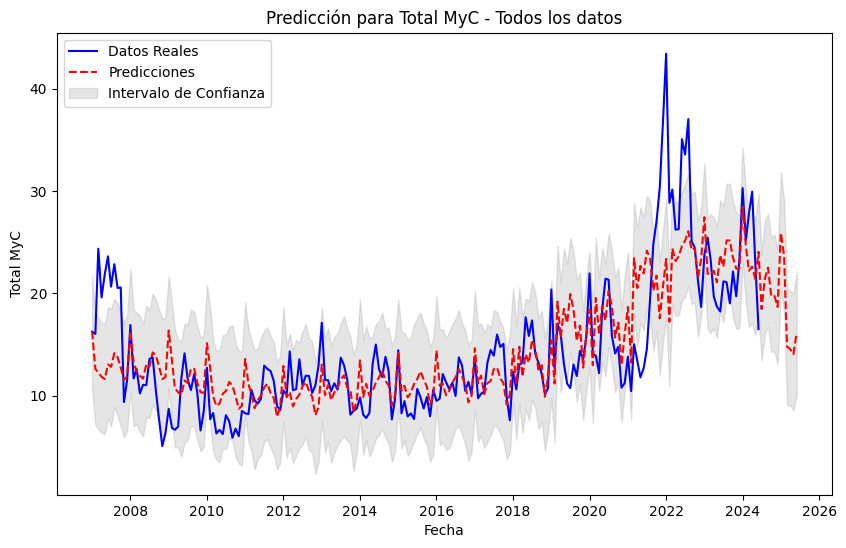

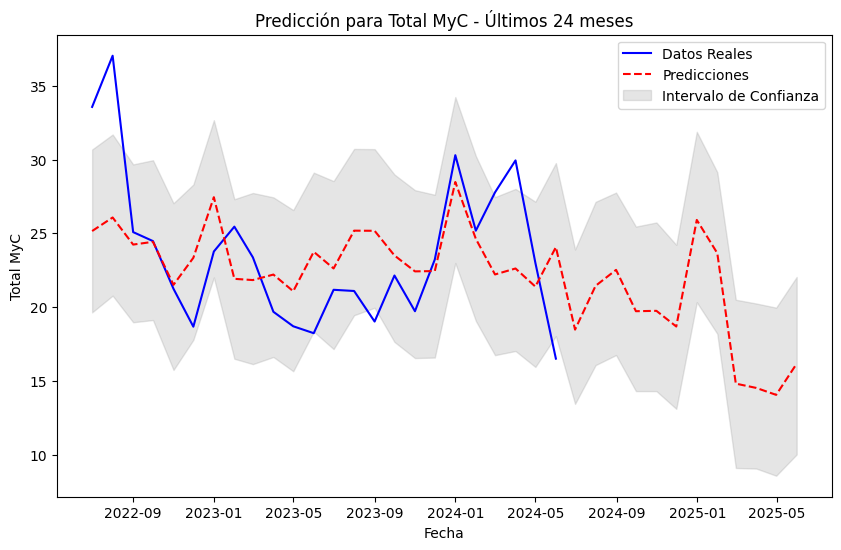

  0%|          | 0/15 [00:00<?, ?it/s]

11:24:37 - cmdstanpy - INFO - Chain [1] start processing
11:25:01 - cmdstanpy - INFO - Chain [1] done processing
11:25:01 - cmdstanpy - INFO - Chain [1] start processing
11:25:02 - cmdstanpy - INFO - Chain [1] done processing
11:25:02 - cmdstanpy - INFO - Chain [1] start processing
11:25:02 - cmdstanpy - INFO - Chain [1] done processing
11:25:03 - cmdstanpy - INFO - Chain [1] start processing
11:25:03 - cmdstanpy - INFO - Chain [1] done processing
11:25:03 - cmdstanpy - INFO - Chain [1] start processing
11:25:04 - cmdstanpy - INFO - Chain [1] done processing
11:25:04 - cmdstanpy - INFO - Chain [1] start processing
11:25:05 - cmdstanpy - INFO - Chain [1] done processing
11:25:05 - cmdstanpy - INFO - Chain [1] start processing
11:25:05 - cmdstanpy - INFO - Chain [1] done processing
11:25:05 - cmdstanpy - INFO - Chain [1] start processing
11:25:05 - cmdstanpy - INFO - Chain [1] done processing
11:25:06 - cmdstanpy - INFO - Chain [1] start processing
11:25:06 - cmdstanpy - INFO - Chain [1]

Métricas de validación cruzada para Total MyC:
horizon    219 days 19:00:00
mae                 5.440377
mse                93.996912
rmse                 8.81447
mape                0.457483
dtype: object
---


11:45:35 - cmdstanpy - INFO - Chain [1] start processing
11:45:35 - cmdstanpy - INFO - Chain [1] done processing


Métricas para Total M:
MAE: 2.48
MSE: 13.50
RMSE: 3.67
MAPE: 30.73%
---


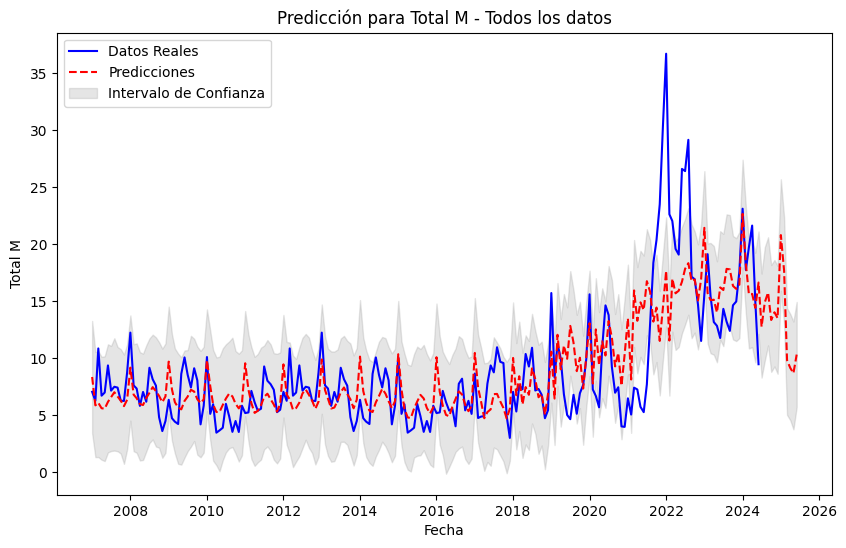

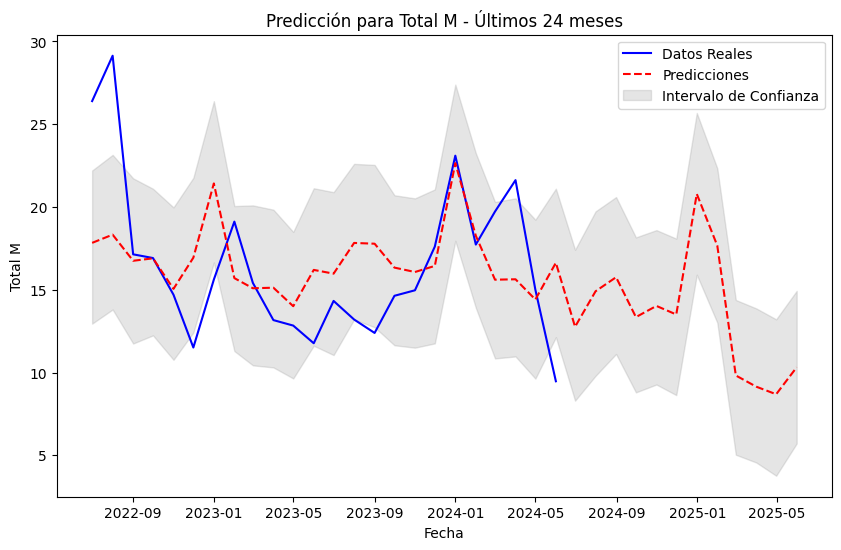

  0%|          | 0/15 [00:00<?, ?it/s]

11:45:37 - cmdstanpy - INFO - Chain [1] start processing
11:45:37 - cmdstanpy - INFO - Chain [1] done processing
11:45:37 - cmdstanpy - INFO - Chain [1] start processing
11:45:37 - cmdstanpy - INFO - Chain [1] done processing
11:45:37 - cmdstanpy - INFO - Chain [1] start processing
11:45:38 - cmdstanpy - INFO - Chain [1] done processing
11:45:38 - cmdstanpy - INFO - Chain [1] start processing
11:45:38 - cmdstanpy - INFO - Chain [1] done processing
11:45:39 - cmdstanpy - INFO - Chain [1] start processing
11:45:39 - cmdstanpy - INFO - Chain [1] done processing
11:45:40 - cmdstanpy - INFO - Chain [1] start processing
11:45:40 - cmdstanpy - INFO - Chain [1] done processing
11:45:41 - cmdstanpy - INFO - Chain [1] start processing
11:45:41 - cmdstanpy - INFO - Chain [1] done processing
11:45:41 - cmdstanpy - INFO - Chain [1] start processing
11:45:41 - cmdstanpy - INFO - Chain [1] done processing
11:45:42 - cmdstanpy - INFO - Chain [1] start processing
11:45:42 - cmdstanpy - INFO - Chain [1]

Métricas de validación cruzada para Total M:
horizon    219 days 19:00:00
mae                 3.463794
mse                28.019721
rmse                5.109672
mape                0.372598
dtype: object
---


11:45:44 - cmdstanpy - INFO - Chain [1] done processing


Métricas para Total C:
MAE: 1.17
MSE: 3.67
RMSE: 1.91
MAPE: 25.87%
---


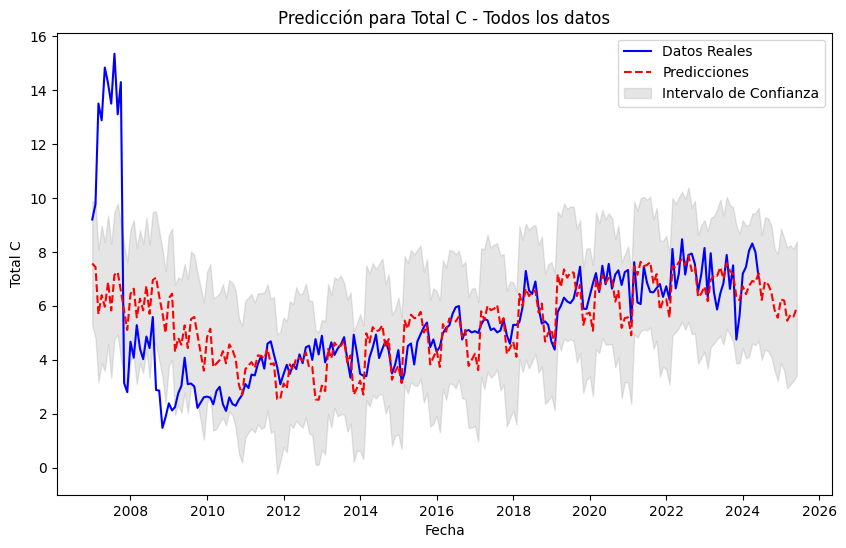

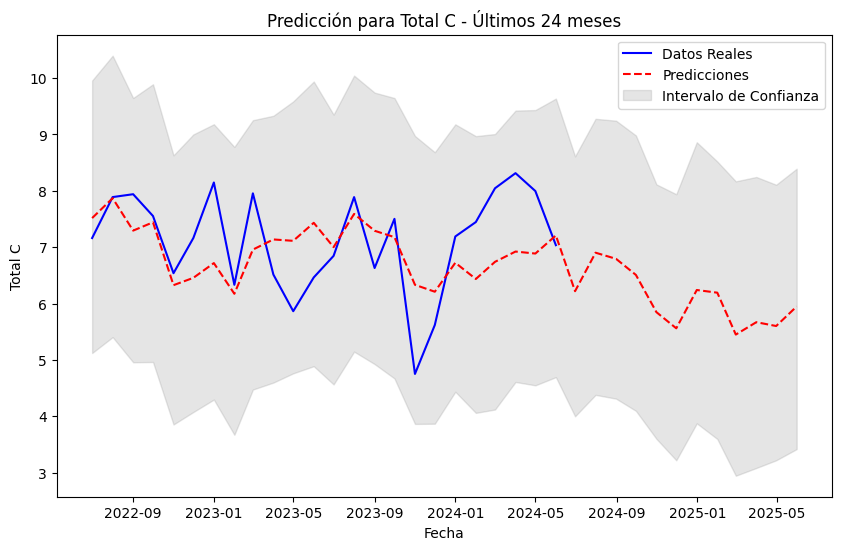

  0%|          | 0/15 [00:00<?, ?it/s]

11:45:46 - cmdstanpy - INFO - Chain [1] start processing
11:46:14 - cmdstanpy - INFO - Chain [1] done processing
11:46:14 - cmdstanpy - INFO - Chain [1] start processing
11:46:14 - cmdstanpy - INFO - Chain [1] done processing
11:46:14 - cmdstanpy - INFO - Chain [1] start processing
11:46:15 - cmdstanpy - INFO - Chain [1] done processing
11:46:15 - cmdstanpy - INFO - Chain [1] start processing
11:46:15 - cmdstanpy - INFO - Chain [1] done processing
11:46:15 - cmdstanpy - INFO - Chain [1] start processing
11:46:16 - cmdstanpy - INFO - Chain [1] done processing
11:46:16 - cmdstanpy - INFO - Chain [1] start processing
11:46:17 - cmdstanpy - INFO - Chain [1] done processing
11:46:17 - cmdstanpy - INFO - Chain [1] start processing
11:46:17 - cmdstanpy - INFO - Chain [1] done processing
11:46:17 - cmdstanpy - INFO - Chain [1] start processing
11:46:17 - cmdstanpy - INFO - Chain [1] done processing
11:46:18 - cmdstanpy - INFO - Chain [1] start processing
11:46:18 - cmdstanpy - INFO - Chain [1]

Métricas de validación cruzada para Total C:
horizon    219 days 19:00:00
mae                 2.981925
mse                47.261725
rmse                5.539356
mape                0.720538
dtype: object
---


In [197]:
# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Crear un diccionario para almacenar los modelos, las predicciones y las métricas
modelos_prophet = {}
predicciones = {}
metricas = {}

for var in variables:
    # Preparar los datos para Prophet
    df_prophet = df[[var]].reset_index()
    df_prophet.columns = ['ds', 'y']  # Renombrar columnas según los requisitos de Prophet
    df_prophet['ds'] = df_prophet['ds'].dt.to_timestamp()  # Convertir el índice de periodo a timestamp

    # Instanciar y entrenar el modelo Prophet con ajustes
    modelo = Prophet(
        growth='linear',
        yearly_seasonality=True,  # Desactivar la estacionalidad anual por defecto
        weekly_seasonality=False,  # Desactivar la estacionalidad semanal por defecto
        daily_seasonality=False,  # Desactivar la estacionalidad diaria por defecto
        seasonality_mode='multiplicative',  # Usar multiplicativa para estacionalidad
        seasonality_prior_scale=10.0#,  # Ajuste de la estacionalidad
        #changepoint_prior_scale=0.5  # Ajuste de la flexibilidad de la tendencia
    )

    # Agregar estacionalidad mensual personalizada
    modelo.add_seasonality(name='monthly', period=30.5, fourier_order=5)

    # Entrenar el modelo
    modelo.fit(df_prophet)

    # Guardar el modelo en el diccionario
    modelos_prophet[var] = modelo

    # Realizar predicciones
    futuro = modelo.make_future_dataframe(periods=12, freq='M')  # Predecir los próximos 12 meses
    pronostico = modelo.predict(futuro)

    # Guardar las predicciones
    predicciones[var] = pronostico[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]

    # Filtrar el pronóstico para solo los períodos observados
    pronostico_observado = pronostico[pronostico['ds'] <= df_prophet['ds'].max()]

    # Calcular métricas de rendimiento
    y_true = df_prophet.set_index('ds').reindex(pronostico_observado['ds'])['y']
    y_pred = pronostico_observado['yhat']

    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    # Guardar las métricas
    metricas[var] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape}

    # Mostrar las métricas
    print(f'Métricas para {var}:')
    print(f'MAE: {mae:.2f}')
    print(f'MSE: {mse:.2f}')
    print(f'RMSE: {rmse:.2f}')
    print(f'MAPE: {mape:.2%}')
    print('---')

    # Graficar todos los datos con las predicciones
    plt.figure(figsize=(10, 6))
    
    # Graficar los datos reales
    plt.plot(df_prophet['ds'], df_prophet['y'], label='Datos Reales', color='blue')
    
    # Graficar las predicciones
    plt.plot(pronostico['ds'], pronostico['yhat'], label='Predicciones', color='red', linestyle='--')
    
    plt.fill_between(pronostico['ds'], pronostico['yhat_lower'], pronostico['yhat_upper'], color='gray', alpha=0.2, label='Intervalo de Confianza')
    
    plt.title(f'Predicción para {var} - Todos los datos')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.legend()
    plt.show()

    # Graficar solo los últimos 24 meses (12 meses reales + 12 meses predicción)
    plt.figure(figsize=(10, 6))

    # Definir el rango de fechas para los últimos 24 meses
    fecha_inicio = df_prophet['ds'].max() - pd.DateOffset(months=23)

    # Graficar los datos reales de los últimos 12 meses
    plt.plot(df_prophet[df_prophet['ds'] >= fecha_inicio]['ds'], 
             df_prophet[df_prophet['ds'] >= fecha_inicio]['y'], 
             label='Datos Reales', color='blue')
    
    # Graficar las predicciones para los próximos 12 meses
    plt.plot(pronostico[pronostico['ds'] >= fecha_inicio]['ds'], 
             pronostico[pronostico['ds'] >= fecha_inicio]['yhat'], 
             label='Predicciones', color='red', linestyle='--')
    
    plt.fill_between(pronostico[pronostico['ds'] >= fecha_inicio]['ds'], 
                     pronostico[pronostico['ds'] >= fecha_inicio]['yhat_lower'], 
                     pronostico[pronostico['ds'] >= fecha_inicio]['yhat_upper'], 
                     color='gray', alpha=0.2, label='Intervalo de Confianza')

    plt.title(f'Predicción para {var} - Últimos 24 meses')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.legend()
    plt.show()

    # Validación cruzada
    df_cv = cross_validation(
        modelo,
        initial='730 days',  # Aproximadamente 2 años
        period='365 days',  # Aproximadamente 1 año
        horizon='365 days'  # Aproximadamente 1 año
    )
    df_p = performance_metrics(df_cv)
    
    print(f'Métricas de validación cruzada para {var}:')
    print(df_p[['horizon', 'mae', 'mse', 'rmse', 'mape']].mean())
    print('---')


### Modelo 3 FBprophet

11:46:23 - cmdstanpy - INFO - Chain [1] start processing
11:46:23 - cmdstanpy - INFO - Chain [1] done processing


Métricas para Total MyC:
MAE: 3.08
MSE: 19.10
RMSE: 4.37
MAPE: 22.66%
---


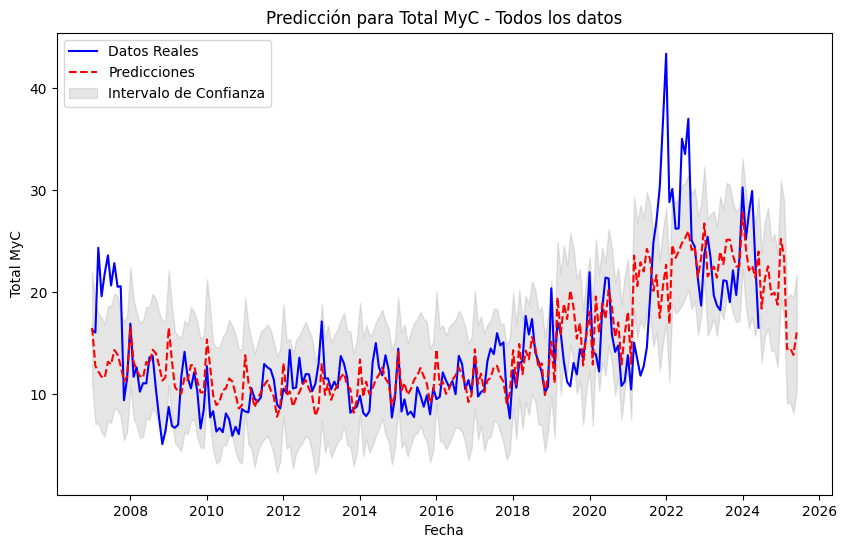

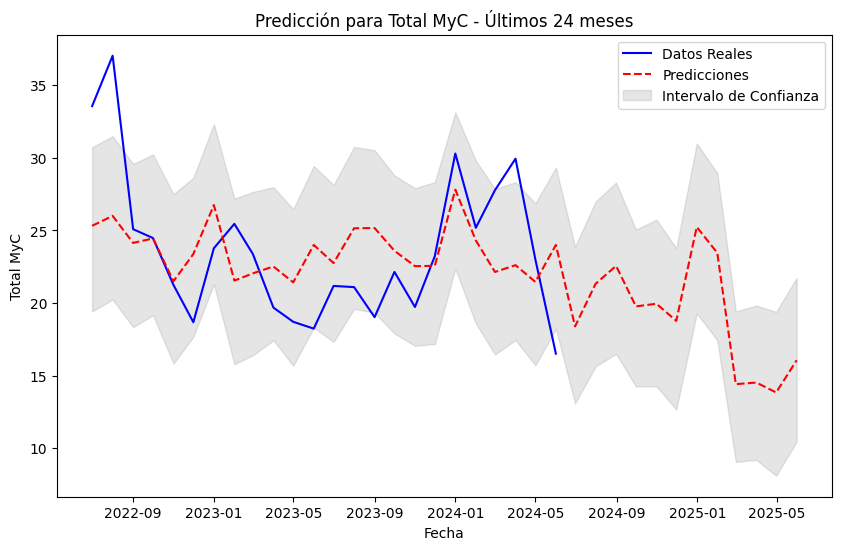

11:46:24 - cmdstanpy - INFO - Chain [1] start processing
11:46:24 - cmdstanpy - INFO - Chain [1] done processing


Métricas para Total M:
MAE: 2.47
MSE: 13.72
RMSE: 3.70
MAPE: 30.61%
---


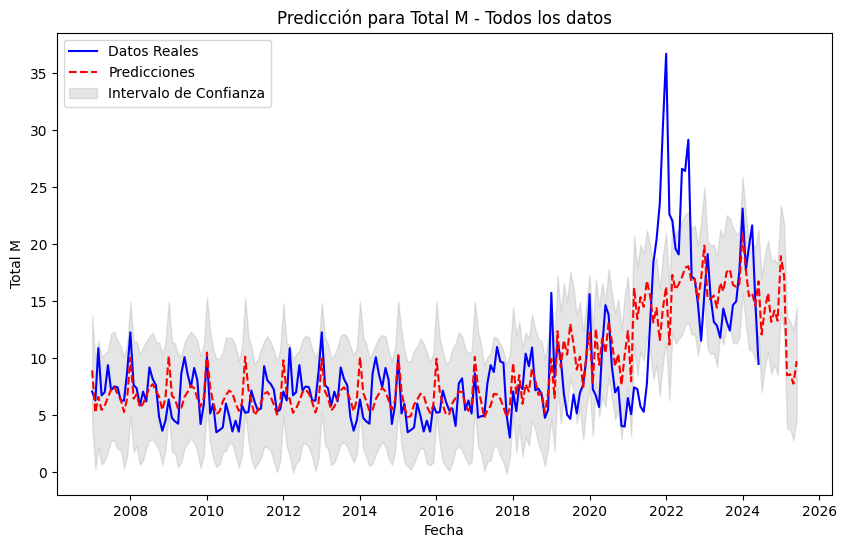

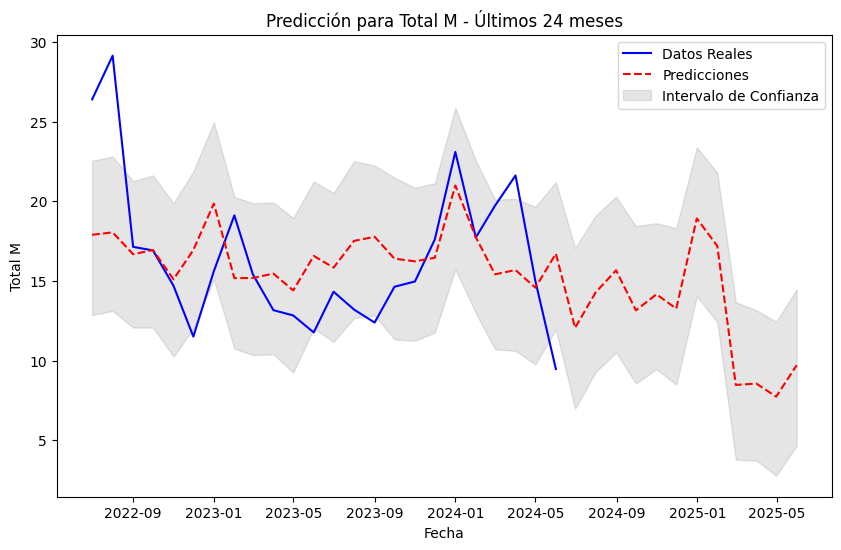

11:46:26 - cmdstanpy - INFO - Chain [1] start processing
11:46:26 - cmdstanpy - INFO - Chain [1] done processing


Métricas para Total C:
MAE: 1.15
MSE: 3.72
RMSE: 1.93
MAPE: 25.38%
---


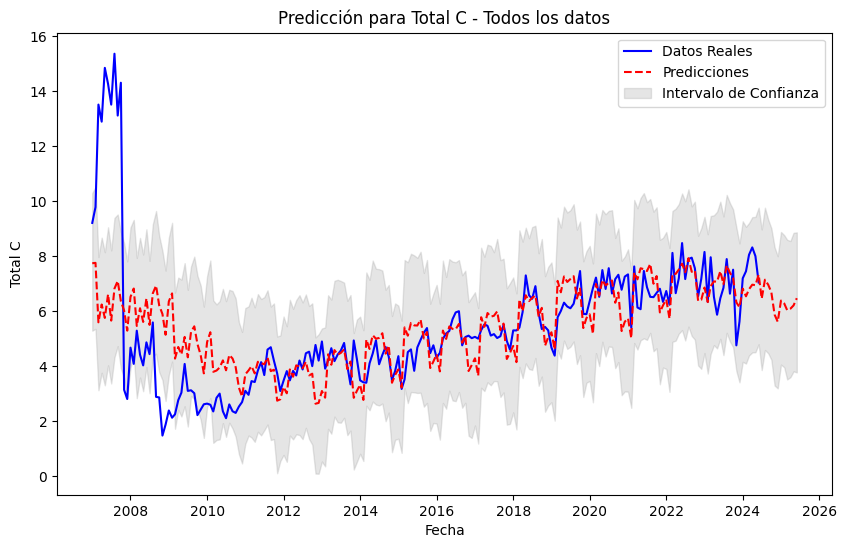

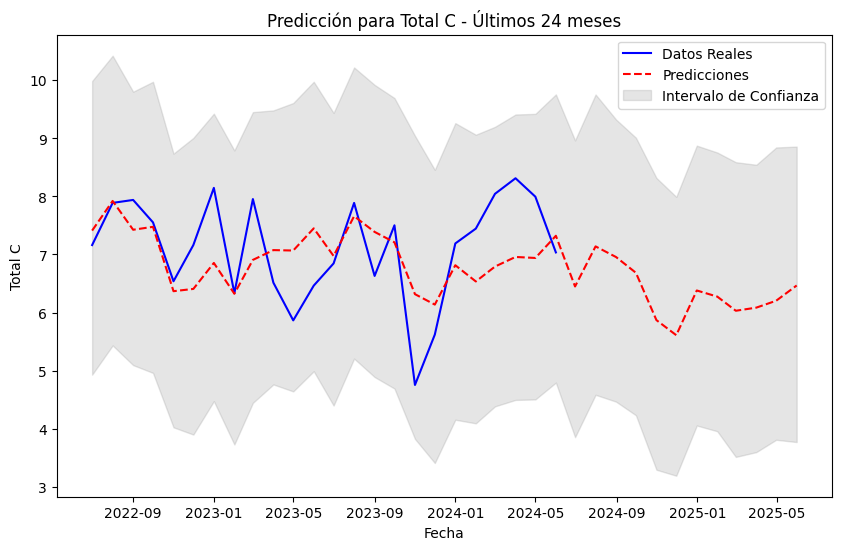

In [198]:
# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Crear un diccionario para almacenar los modelos, las predicciones y las métricas
modelos_prophet = {}
predicciones = {}
metricas = {}

for var in variables:
    # Preparar los datos para Prophet
    df_prophet = df[[var]].reset_index()
    df_prophet.columns = ['ds', 'y']  # Renombrar columnas según los requisitos de Prophet
    df_prophet['ds'] = df_prophet['ds'].dt.to_timestamp()  # Convertir el índice de periodo a timestamp

    # Instanciar y entrenar el modelo Prophet
    modelo = Prophet(
        growth='linear',  # O ajustar según el comportamiento de los datos
        yearly_seasonality=True,  # Activar la estacionalidad anual si es relevante
        weekly_seasonality=False, 
        daily_seasonality=False
    )
    
    # Agregar estacionalidad mensual si es relevante para tus datos
    modelo.add_seasonality(name='monthly', period=30.5, fourier_order=5)

    modelo.fit(df_prophet)

    # Guardar el modelo en el diccionario
    modelos_prophet[var] = modelo

    # Realizar predicciones
    futuro = modelo.make_future_dataframe(periods=12, freq='M')  # Predecir los próximos 12 meses
    pronostico = modelo.predict(futuro)

    # Guardar las predicciones
    predicciones[var] = pronostico[['ds', 'yhat', 'yhat_lower', 'yhat_upper']]

    # Filtrar el pronóstico para solo los períodos observados
    pronostico_observado = pronostico[pronostico['ds'] <= df_prophet['ds'].max()]

    # Calcular métricas de rendimiento
    y_true = df_prophet.set_index('ds').reindex(pronostico_observado['ds'])['y']
    y_pred = pronostico_observado['yhat']

    mae = mean_absolute_error(y_true, y_pred)
    mse = mean_squared_error(y_true, y_pred)
    rmse = np.sqrt(mse)
    mape = mean_absolute_percentage_error(y_true, y_pred)

    # Guardar las métricas
    metricas[var] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape}

    # Mostrar las métricas
    print(f'Métricas para {var}:')
    print(f'MAE: {mae:.2f}')
    print(f'MSE: {mse:.2f}')
    print(f'RMSE: {rmse:.2f}')
    print(f'MAPE: {mape:.2%}')
    print('---')

    # Graficar todos los datos con las predicciones
    plt.figure(figsize=(10, 6))
    
    # Graficar los datos reales
    plt.plot(df_prophet['ds'], df_prophet['y'], label='Datos Reales', color='blue')
    
    # Graficar las predicciones
    plt.plot(pronostico['ds'], pronostico['yhat'], label='Predicciones', color='red', linestyle='--')
    
    plt.fill_between(pronostico['ds'], pronostico['yhat_lower'], pronostico['yhat_upper'], color='gray', alpha=0.2, label='Intervalo de Confianza')
    
    plt.title(f'Predicción para {var} - Todos los datos')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.legend()
    plt.show()

    # Graficar solo los últimos 24 meses (12 meses reales + 12 meses predicción)
    plt.figure(figsize=(10, 6))

    # Definir el rango de fechas para los últimos 24 meses
    fecha_inicio = df_prophet['ds'].max() - pd.DateOffset(months=23)

    # Graficar los datos reales de los últimos 12 meses
    plt.plot(df_prophet[df_prophet['ds'] >= fecha_inicio]['ds'], 
             df_prophet[df_prophet['ds'] >= fecha_inicio]['y'], 
             label='Datos Reales', color='blue')
    
    # Graficar las predicciones para los próximos 12 meses
    plt.plot(pronostico[pronostico['ds'] >= fecha_inicio]['ds'], 
             pronostico[pronostico['ds'] >= fecha_inicio]['yhat'], 
             label='Predicciones', color='red', linestyle='--')
    
    plt.fill_between(pronostico[pronostico['ds'] >= fecha_inicio]['ds'], 
                     pronostico[pronostico['ds'] >= fecha_inicio]['yhat_lower'], 
                     pronostico[pronostico['ds'] >= fecha_inicio]['yhat_upper'], 
                     color='gray', alpha=0.2, label='Intervalo de Confianza')

    plt.title(f'Predicción para {var} - Últimos 24 meses')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.legend()
    plt.show()

# Las métricas de rendimiento para cada variable están almacenadas en el diccionario `metricas`


### Modelo 4 FBprophet

11:46:29 - cmdstanpy - INFO - Chain [1] start processing
11:46:29 - cmdstanpy - INFO - Chain [1] done processing
11:46:30 - cmdstanpy - INFO - Chain [1] start processing
11:46:30 - cmdstanpy - INFO - Chain [1] done processing
11:46:30 - cmdstanpy - INFO - Chain [1] start processing
11:46:30 - cmdstanpy - INFO - Chain [1] done processing
11:46:31 - cmdstanpy - INFO - Chain [1] start processing
11:46:31 - cmdstanpy - INFO - Chain [1] done processing
11:46:31 - cmdstanpy - INFO - Chain [1] start processing
11:46:31 - cmdstanpy - INFO - Chain [1] done processing
11:46:31 - cmdstanpy - INFO - Chain [1] start processing
11:46:31 - cmdstanpy - INFO - Chain [1] done processing
11:46:32 - cmdstanpy - INFO - Chain [1] start processing
11:46:32 - cmdstanpy - INFO - Chain [1] done processing
11:46:32 - cmdstanpy - INFO - Chain [1] start processing
11:46:32 - cmdstanpy - INFO - Chain [1] done processing
11:46:32 - cmdstanpy - INFO - Chain [1] start processing
11:46:33 - cmdstanpy - INFO - Chain [1]

Métricas para Total MyC con los mejores parámetros {'changepoint_prior_scale': 50.0, 'seasonality_prior_scale': 30.0, 'yearly_seasonality': True}:
MAE: 2.40
MSE: 15.24
RMSE: 3.90
MAPE: 18.30%
---


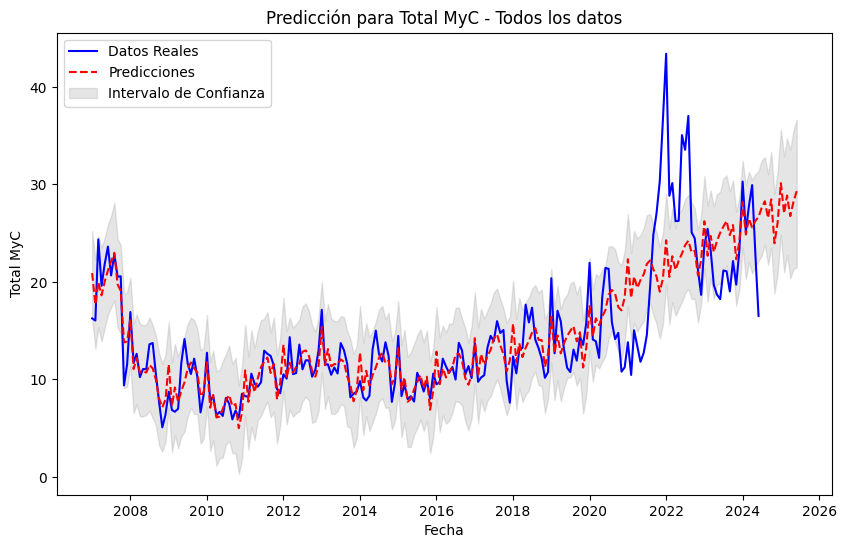

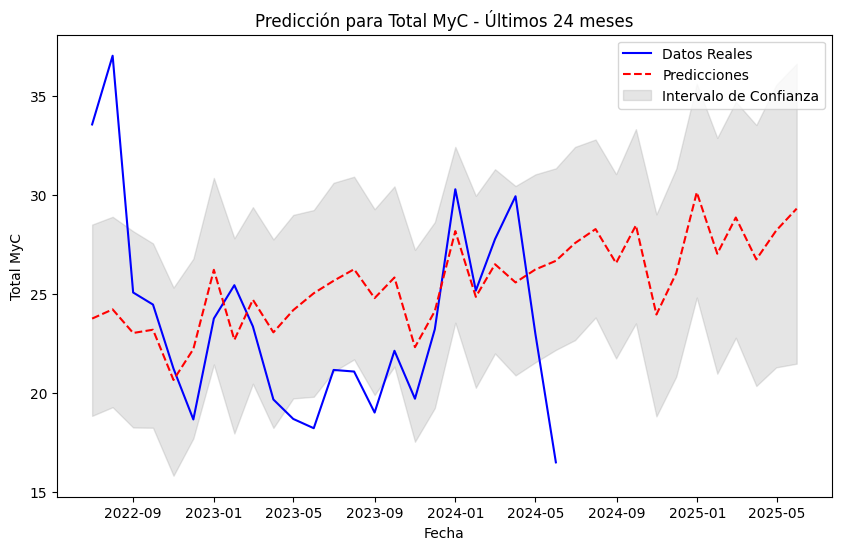

11:46:57 - cmdstanpy - INFO - Chain [1] start processing
11:46:57 - cmdstanpy - INFO - Chain [1] done processing
11:46:57 - cmdstanpy - INFO - Chain [1] start processing
11:46:57 - cmdstanpy - INFO - Chain [1] done processing
11:46:57 - cmdstanpy - INFO - Chain [1] start processing
11:46:57 - cmdstanpy - INFO - Chain [1] done processing
11:46:58 - cmdstanpy - INFO - Chain [1] start processing
11:46:58 - cmdstanpy - INFO - Chain [1] done processing
11:46:58 - cmdstanpy - INFO - Chain [1] start processing
11:46:58 - cmdstanpy - INFO - Chain [1] done processing
11:46:58 - cmdstanpy - INFO - Chain [1] start processing
11:46:58 - cmdstanpy - INFO - Chain [1] done processing
11:46:59 - cmdstanpy - INFO - Chain [1] start processing
11:46:59 - cmdstanpy - INFO - Chain [1] done processing
11:46:59 - cmdstanpy - INFO - Chain [1] start processing
11:46:59 - cmdstanpy - INFO - Chain [1] done processing
11:46:59 - cmdstanpy - INFO - Chain [1] start processing
11:46:59 - cmdstanpy - INFO - Chain [1]

Métricas para Total M con los mejores parámetros {'changepoint_prior_scale': 50.0, 'seasonality_prior_scale': 24.0, 'yearly_seasonality': True}:
MAE: 2.22
MSE: 13.80
RMSE: 3.71
MAPE: 28.84%
---


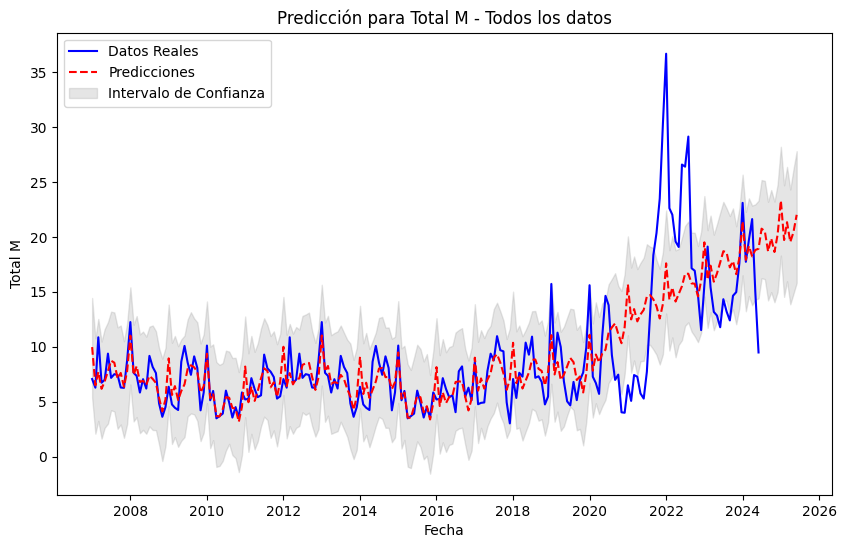

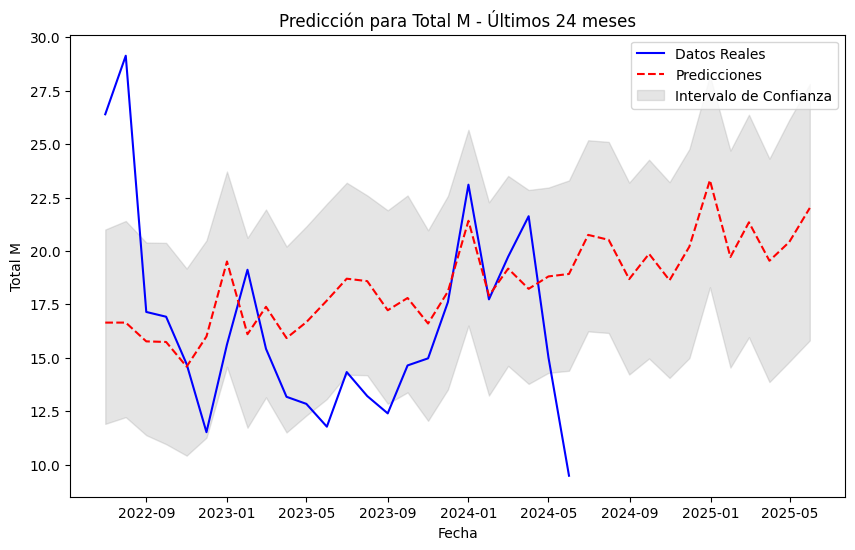

11:47:23 - cmdstanpy - INFO - Chain [1] start processing
11:47:23 - cmdstanpy - INFO - Chain [1] done processing
11:47:23 - cmdstanpy - INFO - Chain [1] start processing
11:47:23 - cmdstanpy - INFO - Chain [1] done processing
11:47:23 - cmdstanpy - INFO - Chain [1] start processing
11:47:24 - cmdstanpy - INFO - Chain [1] done processing
11:47:24 - cmdstanpy - INFO - Chain [1] start processing
11:47:24 - cmdstanpy - INFO - Chain [1] done processing
11:47:24 - cmdstanpy - INFO - Chain [1] start processing
11:47:24 - cmdstanpy - INFO - Chain [1] done processing
11:47:25 - cmdstanpy - INFO - Chain [1] start processing
11:47:25 - cmdstanpy - INFO - Chain [1] done processing
11:47:25 - cmdstanpy - INFO - Chain [1] start processing
11:47:25 - cmdstanpy - INFO - Chain [1] done processing
11:47:25 - cmdstanpy - INFO - Chain [1] start processing
11:47:25 - cmdstanpy - INFO - Chain [1] done processing
11:47:26 - cmdstanpy - INFO - Chain [1] start processing
11:47:26 - cmdstanpy - INFO - Chain [1]

Métricas para Total C con los mejores parámetros {'changepoint_prior_scale': 50.0, 'seasonality_prior_scale': 30.0, 'yearly_seasonality': True}:
MAE: 0.50
MSE: 0.74
RMSE: 0.86
MAPE: 12.21%
---


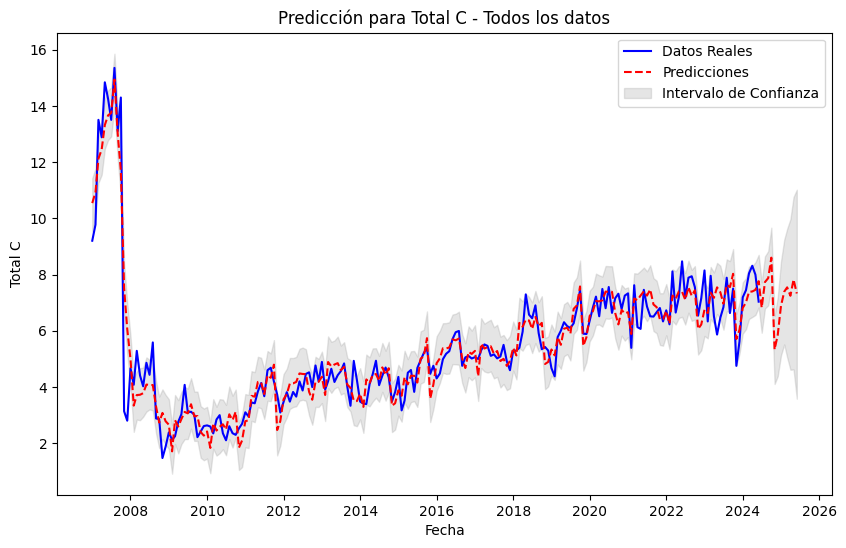

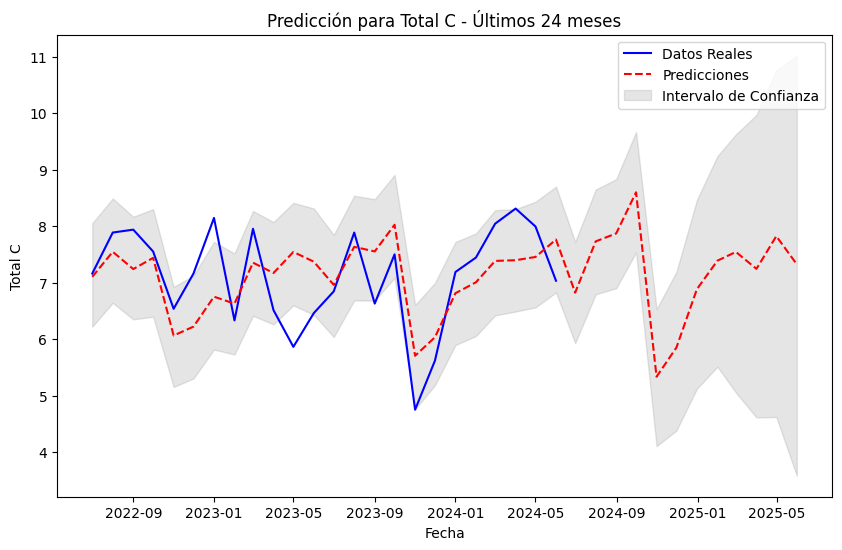

In [199]:
# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Definir el grid de parámetros para la búsqueda
param_grid = {
    'seasonality_prior_scale': [1.0, 2.0, 12.0, 24.0, 30.0, 36.0, 60.0],
    'changepoint_prior_scale': [4.0, 10.0, 20.0, 30.0, 50.0],
    'yearly_seasonality': [True, False]
}

# Crear un diccionario para almacenar los mejores modelos y sus métricas
mejores_modelos = {}
metricas = {}

for var in variables:
    # Preparar los datos para Prophet
    df_prophet = df[[var]].reset_index()
    df_prophet.columns = ['ds', 'y']  # Renombrar columnas según los requisitos de Prophet
    df_prophet['ds'] = df_prophet['ds'].dt.to_timestamp()  # Convertir el índice de periodo a timestamp

    mejor_mae = float('inf')
    mejor_modelo = None
    mejor_parametros = None

    for params in ParameterGrid(param_grid):
        modelo = Prophet(**params)
        modelo.fit(df_prophet)

        # Realizar predicciones
        futuro = modelo.make_future_dataframe(periods=12, freq='M')  # Predecir los próximos 12 meses
        pronostico = modelo.predict(futuro)

        # Filtrar el pronóstico para solo los períodos observados
        pronostico_observado = pronostico[pronostico['ds'] <= df_prophet['ds'].max()]

        # Calcular métricas de rendimiento
        y_true = df_prophet['y']
        y_pred = pronostico_observado['yhat']

        mae = mean_absolute_error(y_true, y_pred)
        mse = mean_squared_error(y_true, y_pred)
        rmse = np.sqrt(mse)
        mape = mean_absolute_percentage_error(y_true, y_pred)

        # Guardar el mejor modelo
        if mae < mejor_mae:
            mejor_mae = mae
            mejor_modelo = modelo
            mejor_parametros = params

    # Guardar el mejor modelo para la variable
    mejores_modelos[var] = {
        'modelo': mejor_modelo,
        'parametros': mejor_parametros,
        'metricas': {
            'MAE': mejor_mae,
            'MSE': mse,
            'RMSE': rmse,
            'MAPE': mape
        }
    }

    # Mostrar las métricas
    print(f'Métricas para {var} con los mejores parámetros {mejor_parametros}:')
    print(f'MAE: {mejor_mae:.2f}')
    print(f'MSE: {mse:.2f}')
    print(f'RMSE: {rmse:.2f}')
    print(f'MAPE: {mape:.2%}')
    print('---')

    # Graficar todos los datos con las predicciones
    modelo = mejores_modelos[var]['modelo']
    futuro = modelo.make_future_dataframe(periods=12, freq='M')  # Predecir los próximos 12 meses
    pronostico = modelo.predict(futuro)

    plt.figure(figsize=(10, 6))
    
    # Graficar los datos reales
    plt.plot(df_prophet['ds'], df_prophet['y'], label='Datos Reales', color='blue')
    
    # Graficar las predicciones
    plt.plot(pronostico['ds'], pronostico['yhat'], label='Predicciones', color='red', linestyle='--')
    
    plt.fill_between(pronostico['ds'], pronostico['yhat_lower'], pronostico['yhat_upper'], color='gray', alpha=0.2, label='Intervalo de Confianza')
    
    plt.title(f'Predicción para {var} - Todos los datos')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.legend()
    plt.show()

    # Graficar solo los últimos 24 meses (12 meses reales + 12 meses predicción)
    plt.figure(figsize=(10, 6))

    # Definir el rango de fechas para los últimos 24 meses
    fecha_inicio = df_prophet['ds'].max() - pd.DateOffset(months=23)

    # Graficar los datos reales de los últimos 12 meses
    plt.plot(df_prophet[df_prophet['ds'] >= fecha_inicio]['ds'], 
             df_prophet[df_prophet['ds'] >= fecha_inicio]['y'], 
             label='Datos Reales', color='blue')
    
    # Graficar las predicciones para los próximos 12 meses
    plt.plot(pronostico[pronostico['ds'] >= fecha_inicio]['ds'], 
             pronostico[pronostico['ds'] >= fecha_inicio]['yhat'], 
             label='Predicciones', color='red', linestyle='--')
    
    plt.fill_between(pronostico[pronostico['ds'] >= fecha_inicio]['ds'], 
                     pronostico[pronostico['ds'] >= fecha_inicio]['yhat_lower'], 
                     pronostico[pronostico['ds'] >= fecha_inicio]['yhat_upper'], 
                     color='gray', alpha=0.2, label='Intervalo de Confianza')

    plt.title(f'Predicción para {var} - Últimos 24 meses')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.legend()
    plt.show()


### Dataframe para comparar métricas de performance

In [200]:
import pandas as pd

# Datos para Total MyC_Prophet
data_MyC_prophet = {
    'Modelo': ['Modelo 1', 'Modelo 2', 'Modelo 3', 'Modelo 4'],
    'MAE': [9.59, 9.63, 9.66, 7.53],
    'MSE': [185.57, 185.81, 188.35, 150.29],
    'RMSE': [13.62, 13.63, 13.72, 12.26],
    'MAPE': [22.17, 22.65, 22.66, 18.29]
}

# Datos para Total M_Prophet
data_M_prophet = {
    'Modelo': ['Modelo 1', 'Modelo 2', 'Modelo 3', 'Modelo 4'],
    'MAE': [7.89, 7.76, 7.75, 6.97],
    'MSE': [137.08, 133.00, 135.28, 136.04],
    'RMSE': [11.71, 11.53, 11.63, 11.66],
    'MAPE': [31.16, 30.69, 30.61, 28.81]
}

# Datos para Total C_Prophet
data_C_prophet = {
    'Modelo': ['Modelo 1', 'Modelo 2', 'Modelo 3', 'Modelo 4'],
    'MAE': [3.16, 3.68, 3.60, 1.56],
    'MSE': [28.68, 36.21, 36.68, 7.34],
    'RMSE': [5.36, 6.02, 6.06, 2.71],
    'MAPE': [22.14, 26.02, 25.38, 12.19]
}

# Función para resaltar la mejor métrica en negrita y verde
def highlight_best(s):
    is_best = s == s.min()
    return ['font-weight: bold; color: green' if v else '' for v in is_best]

# Creación de los DataFrames
df_MyC_prophet = pd.DataFrame(data_MyC_prophet)
df_M_prophet = pd.DataFrame(data_M_prophet)
df_C_prophet = pd.DataFrame(data_C_prophet)

# Aplicar estilo a los DataFrames y mostrar
styled_df_MyC_prophet = df_MyC_prophet.style.apply(highlight_best, subset=['MAE', 'MSE', 'RMSE', 'MAPE'])
styled_df_M_prophet = df_M_prophet.style.apply(highlight_best, subset=['MAE', 'MSE', 'RMSE', 'MAPE'])
styled_df_C_prophet = df_C_prophet.style.apply(highlight_best, subset=['MAE', 'MSE', 'RMSE', 'MAPE'])

print("DataFrame para Total MyC_Prophet:")
display(styled_df_MyC_prophet)

print("\nDataFrame para Total M_Prophet:")
display(styled_df_M_prophet)

print("\nDataFrame para Total C_Prophet:")
display(styled_df_C_prophet)


DataFrame para Total MyC_Prophet:


,Modelo,MAE,MSE,RMSE,MAPE
0,Modelo 1,9.590000,185.570000,13.620000,22.170000
1,Modelo 2,9.630000,185.810000,13.630000,22.650000
2,Modelo 3,9.660000,188.350000,13.720000,22.660000
3,Modelo 4,7.530000,150.290000,12.260000,18.290000



DataFrame para Total M_Prophet:


,Modelo,MAE,MSE,RMSE,MAPE
0,Modelo 1,7.890000,137.080000,11.710000,31.160000
1,Modelo 2,7.760000,133.000000,11.530000,30.690000
2,Modelo 3,7.750000,135.280000,11.630000,30.610000
3,Modelo 4,6.970000,136.040000,11.660000,28.810000



DataFrame para Total C_Prophet:


,Modelo,MAE,MSE,RMSE,MAPE
0,Modelo 1,3.160000,28.680000,5.360000,22.140000
1,Modelo 2,3.680000,36.210000,6.020000,26.020000
2,Modelo 3,3.600000,36.680000,6.060000,25.380000
3,Modelo 4,1.560000,7.340000,2.710000,12.190000


## Modelos automáticos

In [201]:
# Leer el archivo Excel y establecer el índice
df = df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar métricas
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 48

# Número de ejecuciones para promediar
num_runs = 5

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    # Crear el modelo TPOT
    tpot = TPOTRegressor(verbosity=2, generations=5, population_size=20, random_state=42)
    tpot.fit(X_train.reshape(X_train.shape[0], -1), y_train)
    
    # Predicciones sobre los últimos 12 meses
    predictions_last_12 = tpot.predict(X_test.reshape(X_test.shape[0], -1))
    predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12)
    mse = mean_squared_error(y_test, predictions_last_12)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12) / y_test)) * 100
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_TPOT"
    
    # Almacenar las métricas en el diccionario
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%')



Procesando variable: Total MyC


Version 0.12.2 of tpot is outdated. Version 1.0.0 was released Wednesday February 26, 2025.


Optimization Progress:   0%|          | 0/120 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: -0.011615720360175347

Generation 2 - Current best internal CV score: -0.011107421442417966

Generation 3 - Current best internal CV score: -0.010881235845415674

Generation 4 - Current best internal CV score: -0.010881235845415674

Generation 5 - Current best internal CV score: -0.009726536644250489

Best pipeline: ElasticNetCV(SelectPercentile(input_matrix, percentile=3), l1_ratio=0.5, tol=1e-05)
Total MyC_TPOT - MAE: 3.59, MSE: 17.53, RMSE: 4.19, MAPE: 15.57%

Procesando variable: Total M


Version 0.12.2 of tpot is outdated. Version 1.0.0 was released Wednesday February 26, 2025.


Optimization Progress:   0%|          | 0/120 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: -0.01522639155917376

Generation 2 - Current best internal CV score: -0.01522639155917376

Generation 3 - Current best internal CV score: -0.015097397663046064

Generation 4 - Current best internal CV score: -0.015054842800666246

Generation 5 - Current best internal CV score: -0.01496527952442842

Best pipeline: ElasticNetCV(input_matrix, l1_ratio=1.0, tol=0.01)
Total M_TPOT - MAE: 4.08, MSE: 33.08, RMSE: 5.75, MAPE: 31.19%

Procesando variable: Total C


Version 0.12.2 of tpot is outdated. Version 1.0.0 was released Wednesday February 26, 2025.


Optimization Progress:   0%|          | 0/120 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: -0.0026804549767516376

Generation 2 - Current best internal CV score: -0.0026316558405811577

Generation 3 - Current best internal CV score: -0.002579547858119296

Generation 4 - Current best internal CV score: -0.002575288364123529

Generation 5 - Current best internal CV score: -0.002575288364123529

Best pipeline: RandomForestRegressor(input_matrix, bootstrap=True, max_features=0.55, min_samples_leaf=3, min_samples_split=15, n_estimators=100)
Total C_TPOT - MAE: 0.70, MSE: 0.87, RMSE: 0.93, MAPE: 10.93%



Procesando variable: Total MyC


Version 0.12.2 of tpot is outdated. Version 1.0.0 was released Wednesday February 26, 2025.


Optimization Progress:   0%|          | 0/120 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: -0.011615720360175347

Generation 2 - Current best internal CV score: -0.011107421442417966

Generation 3 - Current best internal CV score: -0.010881235845415674

Generation 4 - Current best internal CV score: -0.010881235845415674

Generation 5 - Current best internal CV score: -0.009726536644250489

Best pipeline: ElasticNetCV(SelectPercentile(input_matrix, percentile=3), l1_ratio=0.5, tol=1e-05)
Total MyC_TPOT - MAE: 3.59, MSE: 17.53, RMSE: 4.19, MAPE: 15.57%


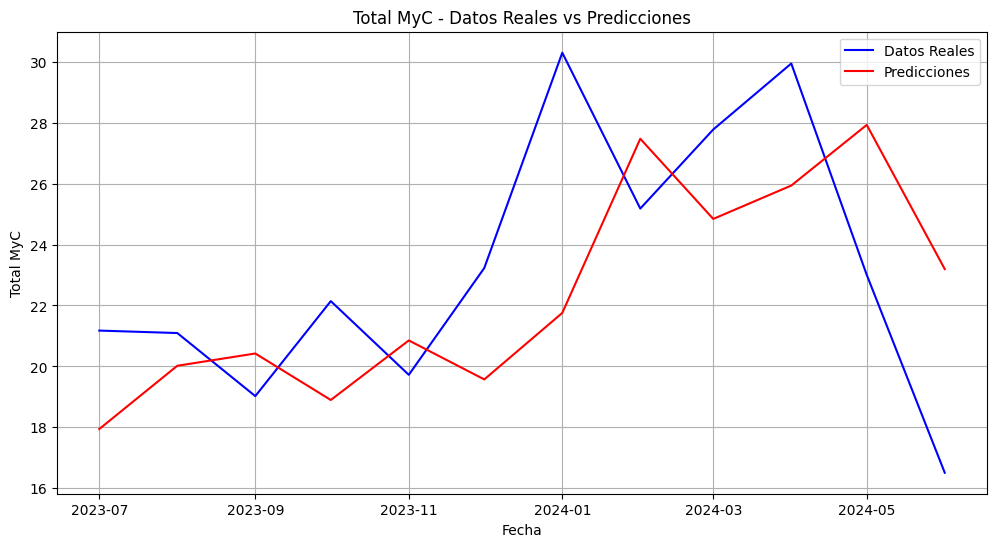


Procesando variable: Total M


Version 0.12.2 of tpot is outdated. Version 1.0.0 was released Wednesday February 26, 2025.


Optimization Progress:   0%|          | 0/120 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: -0.01522639155917376

Generation 2 - Current best internal CV score: -0.01522639155917376

Generation 3 - Current best internal CV score: -0.015097397663046064

Generation 4 - Current best internal CV score: -0.015054842800666246

Generation 5 - Current best internal CV score: -0.01496527952442842

Best pipeline: ElasticNetCV(input_matrix, l1_ratio=1.0, tol=0.01)
Total M_TPOT - MAE: 4.08, MSE: 33.08, RMSE: 5.75, MAPE: 31.19%


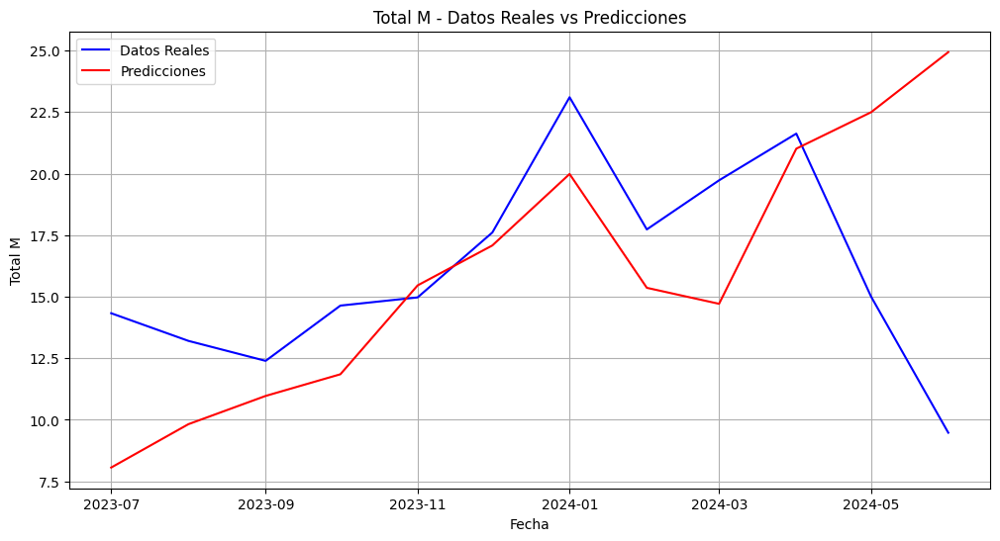


Procesando variable: Total C


Version 0.12.2 of tpot is outdated. Version 1.0.0 was released Wednesday February 26, 2025.


Optimization Progress:   0%|          | 0/120 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: -0.0026804549767516376

Generation 2 - Current best internal CV score: -0.0026316558405811577

Generation 3 - Current best internal CV score: -0.002579547858119296

Generation 4 - Current best internal CV score: -0.002575288364123529

Generation 5 - Current best internal CV score: -0.002575288364123529

Best pipeline: RandomForestRegressor(input_matrix, bootstrap=True, max_features=0.55, min_samples_leaf=3, min_samples_split=15, n_estimators=100)
Total C_TPOT - MAE: 0.70, MSE: 0.87, RMSE: 0.93, MAPE: 10.93%


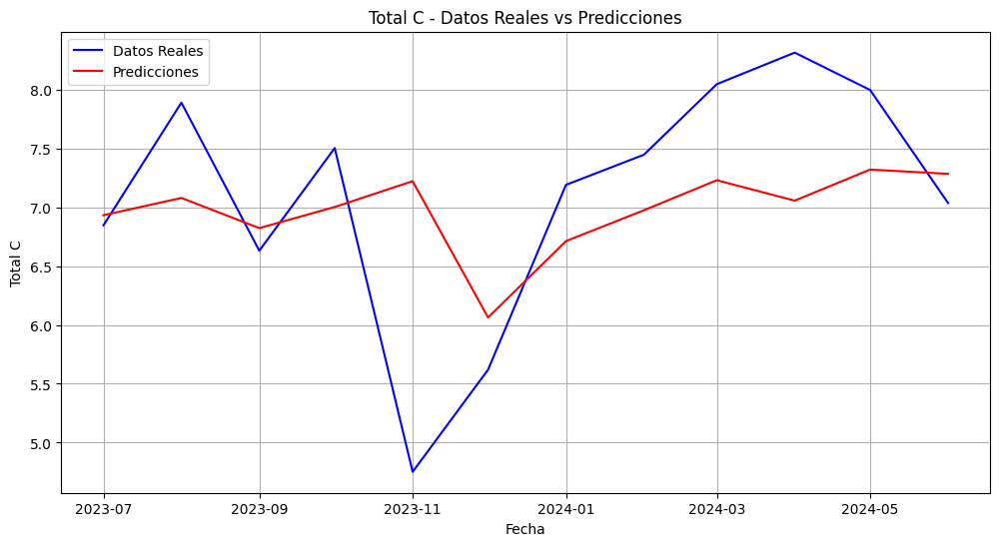

In [202]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
from tpot import TPOTRegressor
import matplotlib.pyplot as plt

# Leer el archivo Excel y establecer el índice
df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar métricas
metrics_dict = {}

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 48

# Número de ejecuciones para promediar
num_runs = 5

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    # Crear el modelo TPOT
    tpot = TPOTRegressor(verbosity=2, generations=5, population_size=20, random_state=42)
    tpot.fit(X_train.reshape(X_train.shape[0], -1), y_train)
    
    # Predicciones sobre los últimos 12 meses
    predictions_last_12 = tpot.predict(X_test.reshape(X_test.shape[0], -1))
    predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12)
    mse = mean_squared_error(y_test, predictions_last_12)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12) / y_test)) * 100
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_TPOT"
    
    # Almacenar las métricas en el diccionario
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%')

    # Graficar los datos reales y las predicciones
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Datos Reales', color='blue')
    plt.plot(df.index[-len(predictions_last_12):].to_timestamp(), predictions_last_12, label='Predicciones', color='red')
    plt.title(f'{var} - Datos Reales vs Predicciones')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.legend()
    plt.grid(True)
    plt.show()


### Prueba de guardado predicciones


Procesando variable: Total MyC


Version 0.12.2 of tpot is outdated. Version 1.0.0 was released Wednesday February 26, 2025.


Optimization Progress:   0%|          | 0/120 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: -0.011615720360175347

Generation 2 - Current best internal CV score: -0.011107421442417966

Generation 3 - Current best internal CV score: -0.010881235845415674

Generation 4 - Current best internal CV score: -0.010881235845415674

Generation 5 - Current best internal CV score: -0.009726536644250489

Best pipeline: ElasticNetCV(SelectPercentile(input_matrix, percentile=3), l1_ratio=0.5, tol=1e-05)
Total MyC_TPOT - MAE: 3.59, MSE: 17.53, RMSE: 4.19, MAPE: 15.57%


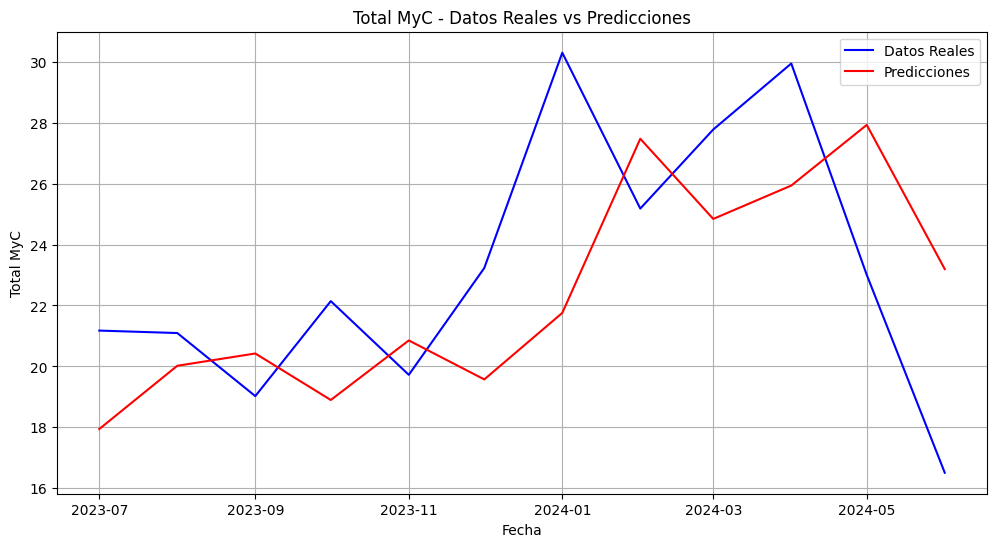


Procesando variable: Total M


Version 0.12.2 of tpot is outdated. Version 1.0.0 was released Wednesday February 26, 2025.


Optimization Progress:   0%|          | 0/120 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: -0.01522639155917376

Generation 2 - Current best internal CV score: -0.01522639155917376

Generation 3 - Current best internal CV score: -0.015097397663046064

Generation 4 - Current best internal CV score: -0.015054842800666246

Generation 5 - Current best internal CV score: -0.01496527952442842

Best pipeline: ElasticNetCV(input_matrix, l1_ratio=1.0, tol=0.01)
Total M_TPOT - MAE: 4.08, MSE: 33.08, RMSE: 5.75, MAPE: 31.19%


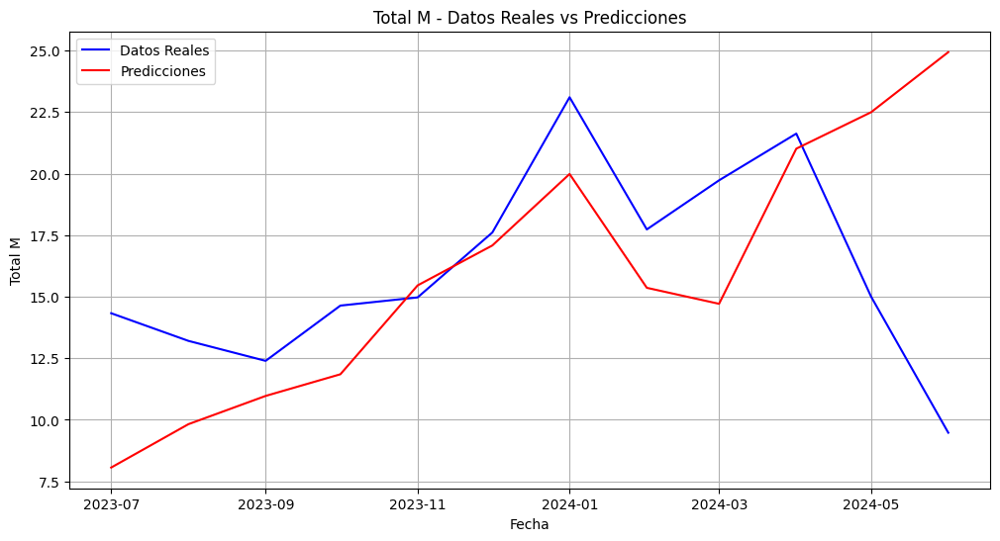


Procesando variable: Total C


Version 0.12.2 of tpot is outdated. Version 1.0.0 was released Wednesday February 26, 2025.


Optimization Progress:   0%|          | 0/120 [00:00<?, ?pipeline/s]


Generation 1 - Current best internal CV score: -0.0026804549767516376

Generation 2 - Current best internal CV score: -0.0026316558405811577

Generation 3 - Current best internal CV score: -0.002579547858119296

Generation 4 - Current best internal CV score: -0.002575288364123529

Generation 5 - Current best internal CV score: -0.002575288364123529

Best pipeline: RandomForestRegressor(input_matrix, bootstrap=True, max_features=0.55, min_samples_leaf=3, min_samples_split=15, n_estimators=100)
Total C_TPOT - MAE: 0.70, MSE: 0.87, RMSE: 0.93, MAPE: 10.93%


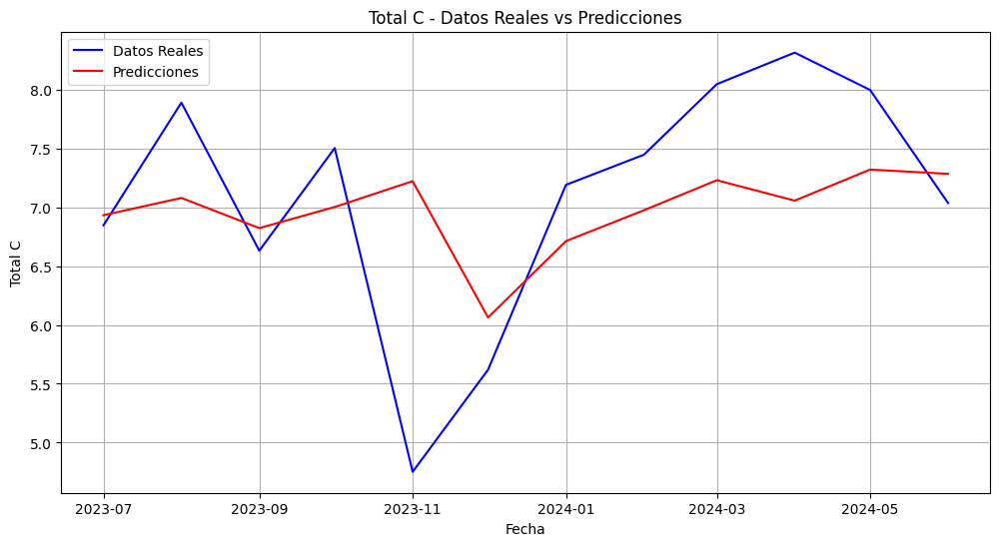

            Total MyC    Total M   Total C
Month                                     
2023-07-01  17.945988   8.061930  6.931991
2023-08-01  20.021664   9.822839  7.079005
2023-09-01  20.423890  10.970780  6.822773
2023-10-01  18.898225  11.850522  7.002015
2023-11-01  20.852392  15.460026  7.221343
2023-12-01  19.573035  17.082711  6.063304
2024-01-01  21.755993  19.984926  6.712060
2024-02-01  27.470036  15.361991  6.974310
2024-03-01  24.839679  14.712116  7.229334
2024-04-01  25.934279  21.013904  7.055922
2024-05-01  27.924077  22.492870  7.320129
2024-06-01  23.193492  24.934228  7.283714


In [203]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
from tpot import TPOTRegressor
import matplotlib.pyplot as plt

# Leer el archivo Excel y establecer el índice
df = load_data()
df.set_index('Month', inplace=True)
df.index = pd.to_datetime(df.index, format='%Y-%m').to_period('M')

# Lista de variables para modelar
variables = ['Total MyC', 'Total M', 'Total C']

# Diccionario para almacenar métricas
metrics_dict = {}

# DataFrame para almacenar predicciones
predictions_df = pd.DataFrame()

# Función para crear secuencias de entrada y salida
def create_sequences(data, seq_length):
    xs, ys = [], []
    for i in range(len(data) - seq_length):
        x = data[i:i + seq_length]
        y = data[i + seq_length]
        xs.append(x)
        ys.append(y)
    return np.array(xs), np.array(ys)

# Longitud de la secuencia
SEQ_LENGTH = 48

# Número de ejecuciones para promediar
num_runs = 5

# Loop para cada variable
for var in variables:
    print(f'\nProcesando variable: {var}')
    
    # Normalizar los datos
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled_data = scaler.fit_transform(df[[var]])
    
    # Crear secuencias de entrada y salida
    X, y = create_sequences(scaled_data, SEQ_LENGTH)
    
    # Determinar el índice para los últimos 12 meses de datos
    test_start_index = len(X) - 12
    
    # Dividir los datos en entrenamiento y prueba
    X_train, X_test = X[:test_start_index], X[test_start_index:]
    y_train, y_test = y[:test_start_index], y[test_start_index:]
    
    # Crear el modelo TPOT
    tpot = TPOTRegressor(verbosity=2, generations=5, population_size=20, random_state=42)
    tpot.fit(X_train.reshape(X_train.shape[0], -1), y_train)
    
    # Predicciones sobre los últimos 12 meses
    predictions_last_12 = tpot.predict(X_test.reshape(X_test.shape[0], -1))
    predictions_last_12 = scaler.inverse_transform(predictions_last_12.reshape(-1, 1))
    
    # Desnormalizar los datos reales de prueba
    y_test = scaler.inverse_transform(y_test.reshape(-1, 1))
    
    # Guardar las predicciones en el DataFrame
    predictions_df[var] = predictions_last_12.flatten()
    
    # Calcular métricas de rendimiento para los últimos 12 meses
    mae = mean_absolute_error(y_test, predictions_last_12)
    mse = mean_squared_error(y_test, predictions_last_12)
    rmse = np.sqrt(mse)
    mape = np.mean(np.abs((y_test - predictions_last_12) / y_test)) * 100
    
    # Nombre ajustado para la variable
    adjusted_var_name = f"{var}_TPOT"
    
    # Almacenar las métricas en el diccionario
    metrics_dict[adjusted_var_name] = {'MAE': mae, 'MSE': mse, 'RMSE': rmse, 'MAPE': mape}
    
    # Imprimir métricas para los últimos 12 meses
    print(f'{adjusted_var_name} - MAE: {mae:.2f}, MSE: {mse:.2f}, RMSE: {rmse:.2f}, MAPE: {mape:.2f}%')

    # Graficar los datos reales y las predicciones
    plt.figure(figsize=(12, 6))
    plt.plot(df.index[-len(y_test):].to_timestamp(), y_test, label='Datos Reales', color='blue')
    plt.plot(df.index[-len(predictions_last_12):].to_timestamp(), predictions_last_12, label='Predicciones', color='red')
    plt.title(f'{var} - Datos Reales vs Predicciones')
    plt.xlabel('Fecha')
    plt.ylabel(var)
    plt.legend()
    plt.grid(True)
    plt.show()

# Establecer las fechas como índice en el DataFrame de predicciones
predictions_df.index = df.index[-12:].to_timestamp()

# Mostrar el DataFrame de predicciones
print(predictions_df)


## Modelos multivariados


### Random Forest Multivariado V1

MAE: 4.07
MSE: 26.90
RMSE: 5.19
MAPE: 16.31%


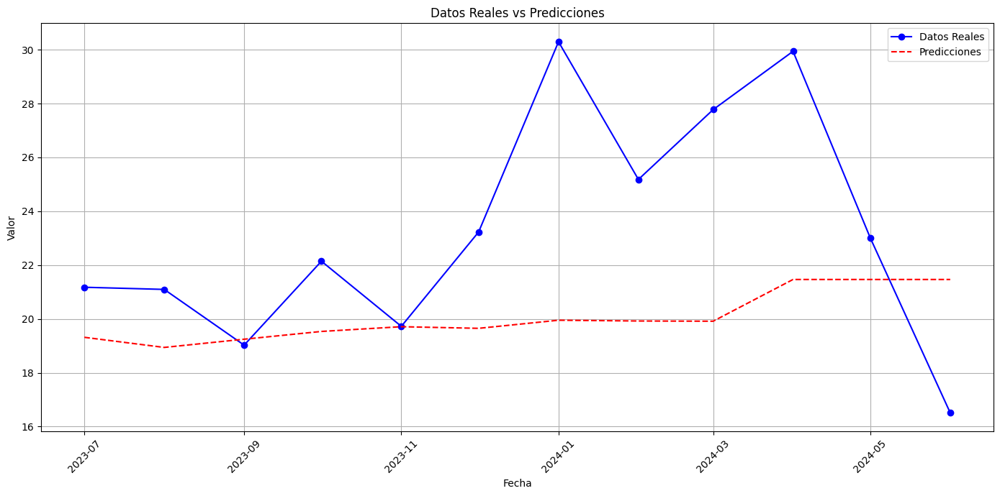

In [204]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
import numpy as np
import matplotlib.pyplot as plt

# Función para cargar los datos desde un archivo Excel
def load_data():
    return pd.read_excel('C:/Users/cdibono/OneDrive - Ternium/Austral/Materias/Tesis/Datos Tesis Mensualizados.xlsx', header=1)

# Cargar datos
df = load_data()
df.set_index('Month', inplace=True)

# Definir variables
target_variable = 'Total MyC'
excluded_variables = ["Año", "Mes", "Trimestre", "Año-Trimestre", 'Total M', "Total C"]

# Seleccionar variables explicativas y objetivo
X = df.drop(columns=[target_variable] + excluded_variables)
y = df[target_variable]

# Dividir los datos en conjunto de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.055, shuffle=False)

# Crear y ajustar el modelo
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Realizar predicciones
y_pred = model.predict(X_test)

# Calcular y mostrar métricas
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mape = np.mean(np.abs((y_test - y_pred) / y_test)) * 100

print(f'MAE: {mae:.2f}')
print(f'MSE: {mse:.2f}')
print(f'RMSE: {rmse:.2f}')
print(f'MAPE: {mape:.2f}%')

# Graficar datos reales vs predicciones
plt.figure(figsize=(14, 7))
plt.plot(y_test.index, y_test, label='Datos Reales', color='blue', marker='o')
plt.plot(y_test.index, y_pred, label='Predicciones', color='red', linestyle='--')
plt.xlabel('Fecha')
plt.ylabel('Valor')
plt.title('Datos Reales vs Predicciones')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('datos_vs_predicciones.pdf')
plt.show()


### Random Forest Multivariado V2

MAE: 2.85
MSE: 13.26
RMSE: 3.64
MAPE: 12.58%


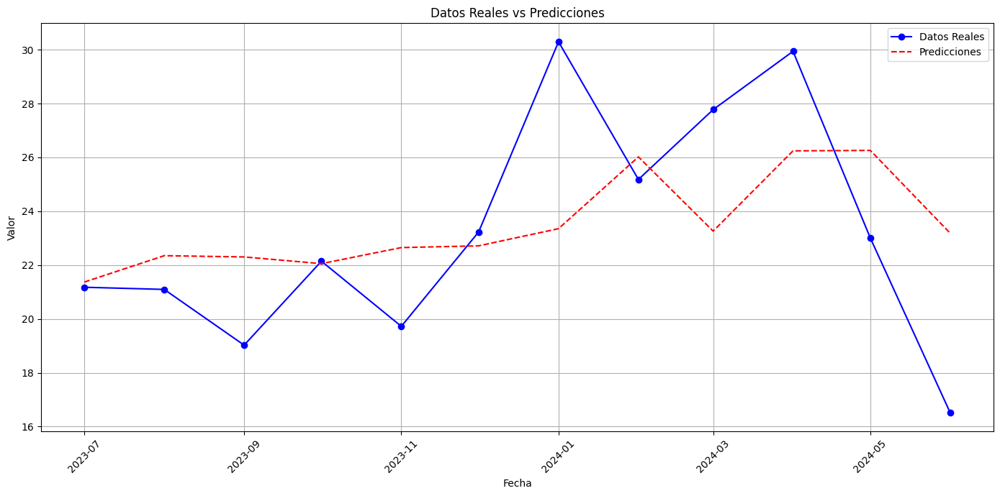

In [205]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt

# Función para cargar los datos desde un archivo Excel
def load_data():
    return pd.read_excel('C:/Users/cdibono/OneDrive - Ternium/Austral/Materias/Tesis/Datos Tesis Mensualizados.xlsx', header=1)

# Cargar datos
df = load_data()
df.set_index('Month', inplace=True)

# Agregar características temporales
df['Month'] = pd.to_datetime(df.index, format='%Y-%m')
df['Year'] = df['Month'].dt.year
df['Month_num'] = df['Month'].dt.month

# Definir variables
target_variable = 'Total MyC'
excluded_variables = ["Año", "Mes", "Trimestre", "Año-Trimestre", 'Total M', "Total C"]

# Crear características de rezago (lag) y media móvil
df['Lag_1'] = df[target_variable].shift(1)
df['Lag_2'] = df[target_variable].shift(2)
df['Rolling_Mean_3'] = df[target_variable].rolling(window=3).mean()

# Eliminar filas con valores NaN (debido a las nuevas características)
df = df.dropna()

# Seleccionar variables explicativas y objetivo
X = df.drop(columns=[target_variable] + excluded_variables)
y = df[target_variable]

# Convertir características a numéricas
X = X.select_dtypes(include=[np.number])  # Mantener solo columnas numéricas

# Escalar las características
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Dividir los datos en conjunto de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.055, shuffle=False)

# Crear y ajustar el modelo
model = RandomForestRegressor(n_estimators=100, random_state=42)
model.fit(X_train, y_train)

# Realizar predicciones
y_pred = model.predict(X_test)

# Calcular y mostrar métricas
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mape = np.mean(np.abs((y_test - y_pred) / y_test)) * 100

print(f'MAE: {mae:.2f}')
print(f'MSE: {mse:.2f}')
print(f'RMSE: {rmse:.2f}')
print(f'MAPE: {mape:.2f}%')

# Graficar datos reales vs predicciones
plt.figure(figsize=(14, 7))
plt.plot(y_test.index, y_test, label='Datos Reales', color='blue', marker='o')
plt.plot(y_test.index, y_pred, label='Predicciones', color='red', linestyle='--')
plt.xlabel('Fecha')
plt.ylabel('Valor')
plt.title('Datos Reales vs Predicciones')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('datos_vs_predicciones.pdf')
plt.show()


### Gradient Boosting Regressor Multivariado V1

MAE: 2.76
MSE: 14.31
RMSE: 3.78
MAPE: 12.31%


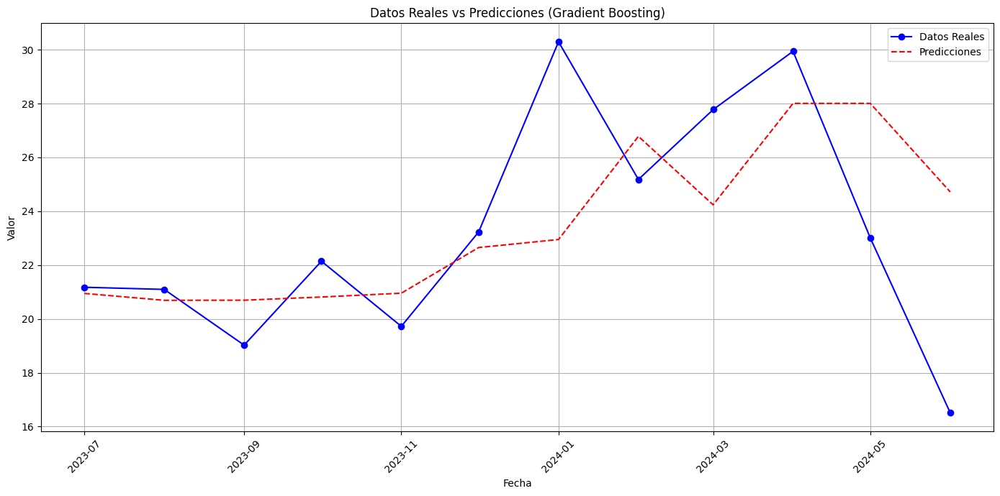

In [206]:
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt

# Función para cargar los datos desde un archivo Excel
def load_data():
    return pd.read_excel('C:/Users/cdibono/OneDrive - Ternium/Austral/Materias/Tesis/Datos Tesis Mensualizados.xlsx', header=1)

# Cargar datos
df = load_data()
df.set_index('Month', inplace=True)

# Agregar características temporales
df['Month'] = pd.to_datetime(df.index, format='%Y-%m')
df['Year'] = df['Month'].dt.year
df['Month_num'] = df['Month'].dt.month

# Definir variables
target_variable = 'Total MyC'
excluded_variables = ["Año", "Mes", "Trimestre", "Año-Trimestre", 'Total M', "Total C"]

# Crear características de rezago (lag) y media móvil
df['Lag_1'] = df[target_variable].shift(1)
df['Lag_2'] = df[target_variable].shift(2)
df['Rolling_Mean_3'] = df[target_variable].rolling(window=3).mean()

# Eliminar filas con valores NaN (debido a las nuevas características)
df = df.dropna()

# Seleccionar variables explicativas y objetivo
X = df.drop(columns=[target_variable] + excluded_variables)
y = df[target_variable]

# Convertir características a numéricas
X = X.select_dtypes(include=[np.number])  # Mantener solo columnas numéricas

# Escalar las características
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Dividir los datos en conjunto de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.055, shuffle=False)

# Crear y ajustar el modelo de Gradient Boosting
model = GradientBoostingRegressor(n_estimators=100, learning_rate=0.1, max_depth=3, random_state=42)
model.fit(X_train, y_train)

# Realizar predicciones
y_pred = model.predict(X_test)

# Calcular y mostrar métricas
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mape = np.mean(np.abs((y_test - y_pred) / y_test)) * 100

print(f'MAE: {mae:.2f}')
print(f'MSE: {mse:.2f}')
print(f'RMSE: {rmse:.2f}')
print(f'MAPE: {mape:.2f}%')

# Graficar datos reales vs predicciones
plt.figure(figsize=(14, 7))
plt.plot(y_test.index, y_test, label='Datos Reales', color='blue', marker='o')
plt.plot(y_test.index, y_pred, label='Predicciones', color='red', linestyle='--')
plt.xlabel('Fecha')
plt.ylabel('Valor')
plt.title('Datos Reales vs Predicciones (Gradient Boosting)')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('datos_vs_predicciones_gradient_boosting.pdf')
plt.show()


### Gradient Boosting Regressor Multivariado V2

MAE: 3.02
MSE: 11.14
RMSE: 3.34
MAPE: 13.86%


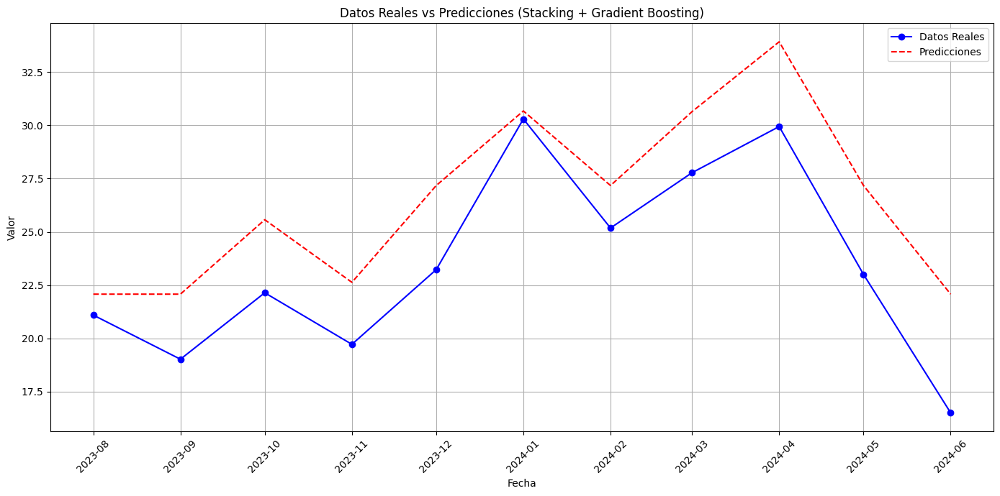

In [208]:
import pandas as pd
from sklearn.model_selection import train_test_split, TimeSeriesSplit, GridSearchCV
from sklearn.ensemble import GradientBoostingRegressor, StackingRegressor
from sklearn.linear_model import Ridge
from sklearn.metrics import mean_absolute_error, mean_squared_error
from sklearn.preprocessing import StandardScaler
import numpy as np
import matplotlib.pyplot as plt

# Función para cargar los datos desde un archivo Excel
def load_data():
    return pd.read_excel('C:/Users/cdibono/OneDrive - Ternium/Austral/Materias/Tesis/Datos Tesis Mensualizados.xlsx', header=1)

# Cargar datos
df = load_data()
df.set_index('Month', inplace=True)

# Agregar características temporales
df['Month'] = pd.to_datetime(df.index, format='%Y-%m')
df['Year'] = df['Month'].dt.year
df['Month_num'] = df['Month'].dt.month

# Definir variables
target_variable = 'Total MyC'
excluded_variables = ["Año", "Mes", "Trimestre", "Año-Trimestre", 'Total M', "Total C"]

# Crear características de rezago (lag) y medias móviles
df['Lag_1'] = df[target_variable].shift(1)
df['Lag_3'] = df[target_variable].shift(3)
df['Lag_12'] = df[target_variable].shift(12)
df['Rolling_Mean_3'] = df[target_variable].rolling(window=3).mean()
df['Rolling_Mean_6'] = df[target_variable].rolling(window=6).mean()
df['Seasonal_Diff'] = df[target_variable] - df[target_variable].shift(12)

# Eliminar filas con valores NaN (debido a las nuevas características)
df = df.dropna()

# Seleccionar variables explicativas y objetivo
X = df.drop(columns=[target_variable] + excluded_variables)
y = df[target_variable]

# Convertir características a numéricas
X = X.select_dtypes(include=[np.number])  # Mantener solo columnas numéricas

# Escalar las características
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Validación cruzada con series temporales
tscv = TimeSeriesSplit(n_splits=5)

# Grid Search para optimización de hiperparámetros
param_grid = {
    'n_estimators': [100, 200, 300],
    'learning_rate': [0.01, 0.05, 0.1],
    'max_depth': [3, 4, 5],
    'min_samples_leaf': [1, 2, 4]
}

grid_search = GridSearchCV(estimator=GradientBoostingRegressor(random_state=42),
                           param_grid=param_grid, cv=tscv, scoring='neg_mean_squared_error')
grid_search.fit(X_scaled, y)

best_model = grid_search.best_estimator_

# Stacking de modelos
stacked_model = StackingRegressor(
    estimators=[
        ('ridge', Ridge()),
        ('gb', best_model)
    ],
    final_estimator=GradientBoostingRegressor(n_estimators=200, random_state=42)
)

# Dividir los datos en conjunto de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_scaled, y, test_size=0.055, shuffle=False)

# Ajustar el modelo de stacking
stacked_model.fit(X_train, y_train)

# Realizar predicciones
y_pred = stacked_model.predict(X_test)

# Calcular y mostrar métricas
mae = mean_absolute_error(y_test, y_pred)
mse = mean_squared_error(y_test, y_pred)
rmse = np.sqrt(mse)
mape = np.mean(np.abs((y_test - y_pred) / y_test)) * 100

print(f'MAE: {mae:.2f}')
print(f'MSE: {mse:.2f}')
print(f'RMSE: {rmse:.2f}')
print(f'MAPE: {mape:.2f}%')

# Graficar datos reales vs predicciones
plt.figure(figsize=(14, 7))
plt.plot(y_test.index, y_test, label='Datos Reales', color='blue', marker='o')
plt.plot(y_test.index, y_pred, label='Predicciones', color='red', linestyle='--')
plt.xlabel('Fecha')
plt.ylabel('Valor')
plt.title('Datos Reales vs Predicciones (Stacking + Gradient Boosting)')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('datos_vs_predicciones_stacking_gradient_boosting.pdf')
plt.show()


### LSTM Multivariado

Epoch 1/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 56s 222ms/step - loss: 0.0922 - val_loss: 0.1226
Epoch 2/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 38ms/step - loss: 0.0152 - val_loss: 0.1766
Epoch 3/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 32ms/step - loss: 0.0141 - val_loss: 0.1116
Epoch 4/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 43ms/step - loss: 0.0149 - val_loss: 0.1280
Epoch 5/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 36ms/step - loss: 0.0110 - val_loss: 0.1330
Epoch 6/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 26ms/step - loss: 0.0109 - val_loss: 0.0813
Epoch 7/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0127 - val_loss: 0.1101
Epoch 8/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 27ms/step - loss: 0.0122 - val_loss: 0.0829
Epoch 9/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0104 - val_loss: 0.0663
Epoch 10/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 30ms/step - loss: 0.0105 - val_loss: 0.0698
Epoch 11/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 33ms/step - loss: 0.0091 - val_loss: 0.0583
Epoch 12/100
9/9 ━━━━━━━━━━━━━━━━━━━━ 0s 37ms/step - loss: 0.0095 - val_

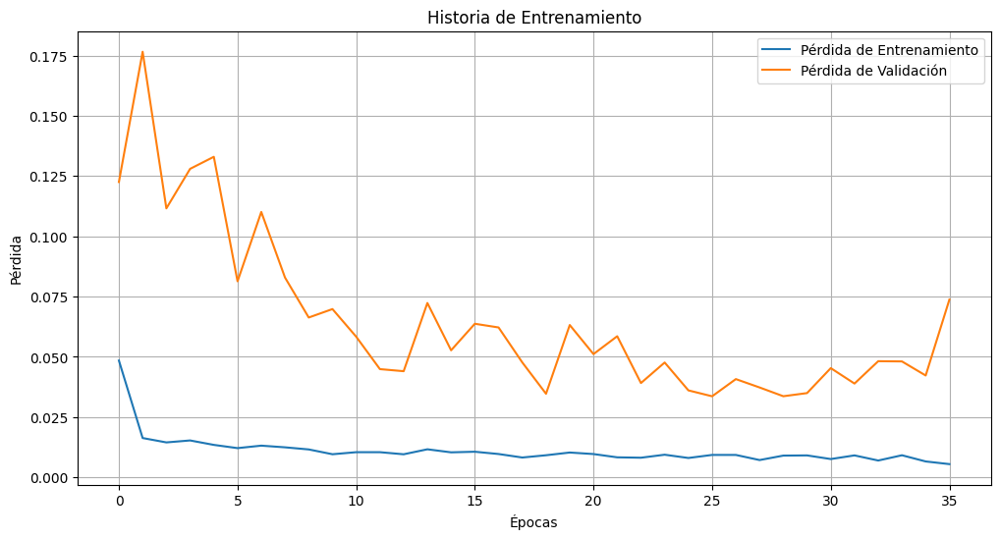

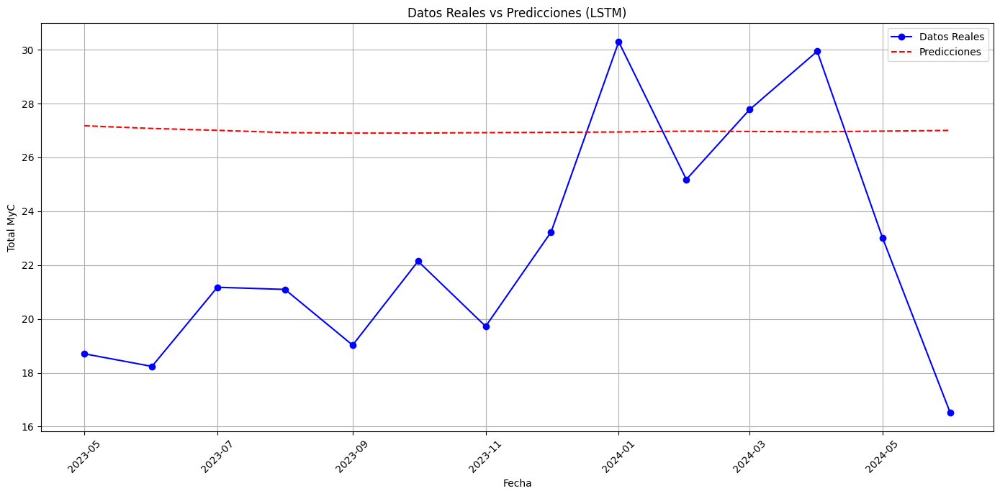

In [209]:
import pandas as pd
import numpy as np
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import Dense, LSTM, Dropout
from keras.callbacks import EarlyStopping
import warnings

# Ignorar advertencias
warnings.filterwarnings('ignore')

# Función para cargar los datos desde un archivo Excel
def load_data():
    return pd.read_excel('C:/Users/cdibono/OneDrive - Ternium/Austral/Materias/Tesis/Datos Tesis Mensualizados.xlsx', header=1)

# Cargar datos
df = load_data()

# Convertir 'Month' a datetime
df['Month'] = pd.to_datetime(df['Month'], format='%Y-%m')

# Crear características temporales
df['Year'] = df['Month'].dt.year
df['Month_num'] = df['Month'].dt.month

# Establecer 'Month' como índice
df.set_index('Month', inplace=True)

# Definir variables
target_variable = 'Total MyC'
excluded_variables = ["Año", "Mes", "Trimestre", "Año-Trimestre", 'Total M', 'Planos M', 
                      "LAC (Mtons)", "LAF (Mtons)", "Pintados (Mtons)", "Galvanizados (Mtons)", 
                      "Largos y Tubos M", "Tubos y Perfiles (Mtons)", "Largos (Mtons)", 
                      "Total C", "1era C", "Pintados 1era C (Mtons)", 
                      "Galvanizados 1era C (Mtons)", "2da C", "Pintados 2da C (Mtons)", 
                      "Galvanizados 2da C (Mtons)"]

# Filtrar variables que existen en el DataFrame
excluded_variables = [var for var in excluded_variables if var in df.columns]

# Crear características de rezago (lag) y medias móviles
df['Lag_1'] = df[target_variable].shift(1)
df['Lag_3'] = df[target_variable].shift(3)
df['Lag_12'] = df[target_variable].shift(12)
df['Rolling_Mean_3'] = df[target_variable].rolling(window=3).mean()
df['Rolling_Mean_6'] = df[target_variable].rolling(window=6).mean()
df['Seasonal_Diff'] = df[target_variable] - df[target_variable].shift(12)

# Eliminar filas con valores NaN (debido a las nuevas características)
df.dropna(inplace=True)

# Seleccionar variables explicativas y objetivo
X = df.drop(columns=[target_variable] + excluded_variables)

# Verificar tipos de datos y seleccionar solo columnas numéricas
X_numeric = X.select_dtypes(include=[np.number])

y = df[target_variable]

# Escalar las características y el objetivo
scaler_X = MinMaxScaler()
scaler_y = MinMaxScaler()
X_scaled = scaler_X.fit_transform(X_numeric)
y_scaled = scaler_y.fit_transform(y.values.reshape(-1, 1))

# Crear la estructura de datos para LSTM (secuencias de tiempo)
def create_sequences(X, y, time_steps=1):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 24
X_lstm, y_lstm = create_sequences(X_scaled, y_scaled, time_steps)

# Dividir los datos en conjunto de entrenamiento y prueba
split_index = int(X_lstm.shape[0] * 0.92)
X_train, X_test = X_lstm[:split_index], X_lstm[split_index:]
y_train, y_test = y_lstm[:split_index], y_lstm[split_index:]

# Definir el modelo LSTM
model = Sequential()
model.add(LSTM(units=100, return_sequences=True, input_shape=(X_train.shape[1], X_train.shape[2])))
model.add(Dropout(0.3))
model.add(LSTM(units=50, return_sequences=False))
model.add(Dropout(0.2))
model.add(Dense(units=25, activation='relu'))
model.add(Dense(units=1))

model.compile(optimizer='adam', loss='mean_squared_error')

# Definir early stopping
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)

# Ajustar el modelo
history = model.fit(
    X_train, 
    y_train, 
    validation_split=0.1, 
    epochs=100, 
    batch_size=16, 
    callbacks=[early_stop], 
    verbose=1
)

# Realizar predicciones
y_pred_scaled = model.predict(X_test)
y_pred = scaler_y.inverse_transform(y_pred_scaled)
y_test_inv = scaler_y.inverse_transform(y_test)

# Calcular y mostrar métricas
mae = mean_absolute_error(y_test_inv, y_pred)
mse = mean_squared_error(y_test_inv, y_pred)
rmse = np.sqrt(mse)
mape = np.mean(np.abs((y_test_inv - y_pred) / y_test_inv)) * 100

print(f'MAE: {mae:.2f}')
print(f'MSE: {mse:.2f}')
print(f'RMSE: {rmse:.2f}')
print(f'MAPE: {mape:.2f}%')

# Graficar historia de entrenamiento
plt.figure(figsize=(12, 6))
plt.plot(history.history['loss'], label='Pérdida de Entrenamiento')
plt.plot(history.history['val_loss'], label='Pérdida de Validación')
plt.title('Historia de Entrenamiento')
plt.xlabel('Épocas')
plt.ylabel('Pérdida')
plt.legend()
plt.grid(True)
plt.show()

# Graficar datos reales vs predicciones
plt.figure(figsize=(14, 7))
plt.plot(df.index[-len(y_test_inv):], y_test_inv, label='Datos Reales', color='blue', marker='o')
plt.plot(df.index[-len(y_test_inv):], y_pred, label='Predicciones', color='red', linestyle='--')
plt.xlabel('Fecha')
plt.ylabel('Total MyC')
plt.title('Datos Reales vs Predicciones (LSTM)')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('datos_vs_predicciones_lstm.pdf')
plt.show()


### Modelo Multivariado e Híbrido Random Forest utilizando las predicciones de residuos de LSTM

Epoch 1/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 6s 6s/step - loss: 0.7038 - val_loss: 1.1972
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 90ms/step - loss: 0.3717 - val_loss: 0.6750
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 95ms/step - loss: 0.2244 - val_loss: 0.3882
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 80ms/step - loss: 0.1942 - val_loss: 0.3414
Epoch 5/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 74ms/step - loss: 0.2332 - val_loss: 0.4078
Epoch 6/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - loss: 0.2171 - val_loss: 0.5455
Epoch 7/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 76ms/step - loss: 0.2075 - val_loss: 0.6641
Epoch 8/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 94ms/step - loss: 0.2000 - val_loss: 0.7187
Epoch 9/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 77ms/step - loss: 0.2136 - val_loss: 0.6842
Epoch 10/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 85ms/step - loss: 0.2150 - val_loss: 0.6291
Epoch 11/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 82ms/step - loss: 0.2015 - val_loss: 0.5763
Epoch 12/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 72ms/step - loss: 0.2100 - val_loss

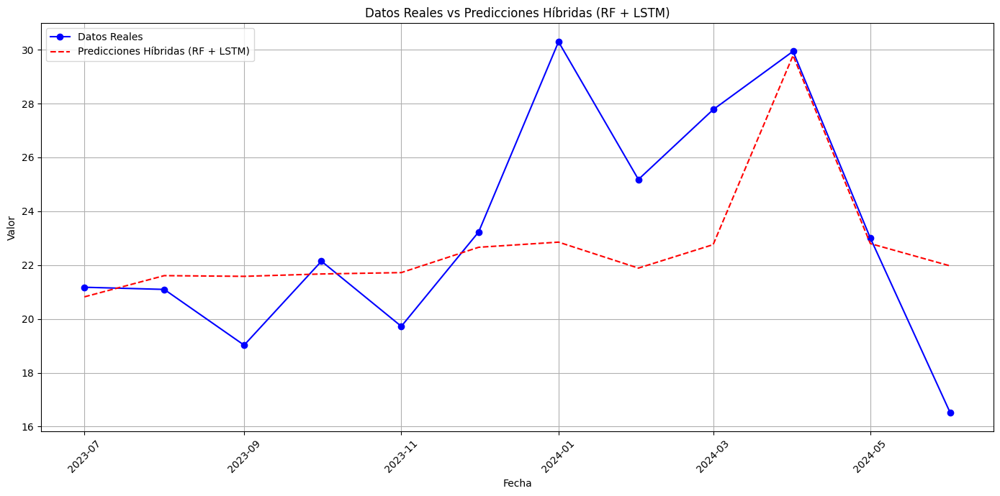

In [211]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import Dense, LSTM, Dropout
from keras.callbacks import EarlyStopping

# Cargar datos
df = load_data()

# Convertir 'Month' a datetime
df['Month'] = pd.to_datetime(df['Month'], format='%Y-%m')

# Crear características temporales
df['Year'] = df['Month'].dt.year
df['Month_num'] = df['Month'].dt.month

# Establecer 'Month' como índice
df.set_index('Month', inplace=True)

# Definir variables
target_variable = 'Total MyC'
excluded_variables = ["Año", "Mes", "Trimestre", "Año-Trimestre", 'Total M',"Total C"]

# Crear características de rezago (lag) y medias móviles
df['Lag_1'] = df[target_variable].shift(1)
df['Lag_3'] = df[target_variable].shift(3)
df['Lag_12'] = df[target_variable].shift(12)
df['Rolling_Mean_3'] = df[target_variable].rolling(window=3).mean()
df['Rolling_Mean_6'] = df[target_variable].rolling(window=6).mean()
df['Seasonal_Diff'] = df[target_variable] - df[target_variable].shift(12)

# Eliminar filas con valores NaN (debido a las nuevas características)
df = df.dropna()

# Seleccionar variables explicativas y objetivo
X = df.drop(columns=[target_variable] + excluded_variables)
y = df[target_variable]

# Escalar las características y el objetivo
scaler_X = StandardScaler()
scaler_y = StandardScaler()
X_scaled = scaler_X.fit_transform(X)
y_scaled = scaler_y.fit_transform(y.values.reshape(-1, 1))

# Dividir los datos en conjunto de entrenamiento y prueba
train_size = int(len(X_scaled) * 0.88)
X_train, X_test = X_scaled[:train_size], X_scaled[train_size:]
y_train, y_test = y_scaled[:train_size], y_scaled[train_size:]

# Entrenar un modelo Random Forest
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train.ravel())

# Predecir con el modelo Random Forest
y_pred_rf = rf_model.predict(X_test)

# Calcular los residuos
residuals = y_test.ravel() - y_pred_rf

# Crear la estructura de datos para LSTM (secuencias de tiempo)
def create_sequences(X, y, time_steps=1):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 12
X_lstm, y_lstm = create_sequences(X_test, residuals, time_steps)

# Definir el modelo LSTM para predecir los residuos
model = Sequential()
model.add(LSTM(units=200, return_sequences=True, input_shape=(X_lstm.shape[1], X_lstm.shape[2])))
model.add(Dropout(0.3))
model.add(LSTM(units=100, return_sequences=True))
model.add(Dropout(0.3))
model.add(LSTM(units=50))
model.add(Dense(units=1))

model.compile(optimizer='adam', loss='mean_squared_error')

# Ajustar el modelo
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history = model.fit(X_lstm, y_lstm, validation_split=0.1, epochs=200, batch_size=16, callbacks=[early_stop], verbose=1)

# Predecir los residuos con LSTM
residuals_pred = model.predict(X_lstm)

# Corregir las predicciones del modelo RF sumando los residuos predichos por LSTM
final_pred = y_pred_rf[-len(residuals_pred):] + residuals_pred.ravel()

# Desescalar las predicciones finales y los datos reales
y_test_inv = scaler_y.inverse_transform(y_test[-len(final_pred):].reshape(-1, 1))
final_pred_inv = scaler_y.inverse_transform(final_pred.reshape(-1, 1))

# Calcular y mostrar métricas
mae = mean_absolute_error(y_test_inv, final_pred_inv)
mse = mean_squared_error(y_test_inv, final_pred_inv)
rmse = np.sqrt(mse)
mape = np.mean(np.abs((y_test_inv - final_pred_inv) / y_test_inv)) * 100

print(f'MAE: {mae:.2f}')
print(f'MSE: {mse:.2f}')
print(f'RMSE: {rmse:.2f}')
print(f'MAPE: {mape:.2f}%')

# Graficar datos reales vs predicciones
plt.figure(figsize=(14, 7))
plt.plot(df.index[-len(y_test_inv):], y_test_inv, label='Datos Reales', color='blue', marker='o')
plt.plot(df.index[-len(final_pred_inv):], final_pred_inv, label='Predicciones Híbridas (RF + LSTM)', color='red', linestyle='--')
plt.xlabel('Fecha')
plt.ylabel('Valor')
plt.title('Datos Reales vs Predicciones Híbridas (RF + LSTM)')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('datos_vs_predicciones_hibridas_rf_lstm.pdf')
plt.show()


### Modelo multivariado Autoarima con residuos LSTM

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=171.127, Time=0.53 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=256.884, Time=0.03 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=185.873, Time=0.17 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=173.442, Time=0.19 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=252.866, Time=0.07 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=160.782, Time=0.59 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=181.126, Time=0.34 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=162.699, Time=1.64 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=162.735, Time=1.48 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=163.019, Time=1.15 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=166.522, Time=1.14 sec
 ARIMA(1,1,1)(2,1,2)[12]             : AIC=inf, Time=2.79 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=163.686, Time=0.35 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=163.748, Time=0.24 sec
 ARIMA(2,1,1)(1,1,1)[12]             

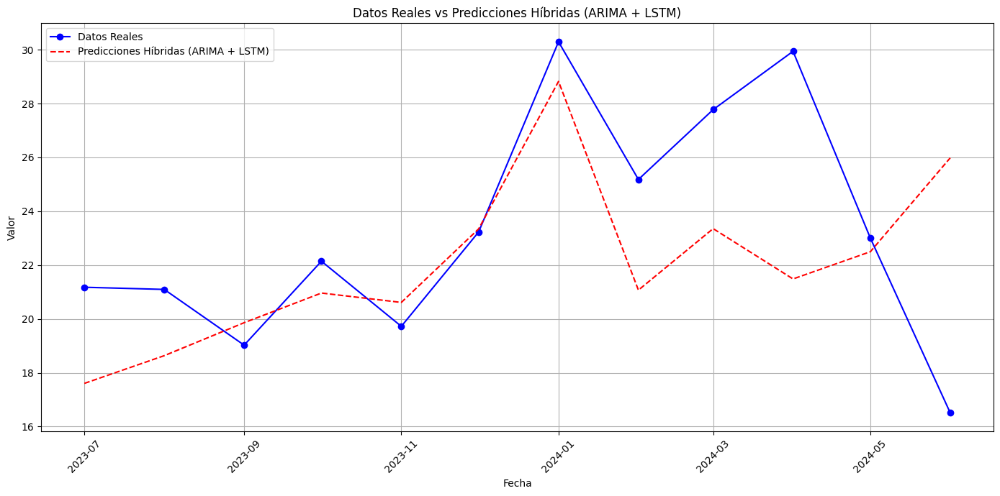

In [213]:
import pandas as pd
import numpy as np
from pmdarima import auto_arima
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import Dense, LSTM, Dropout
from keras.callbacks import EarlyStopping

# Cargar datos
df = load_data()

# Convertir 'Month' a datetime
df['Month'] = pd.to_datetime(df['Month'], format='%Y-%m')

# Crear características temporales
df['Year'] = df['Month'].dt.year
df['Month_num'] = df['Month'].dt.month

# Establecer 'Month' como índice
df.set_index('Month', inplace=True)

# Definir variables
target_variable = 'Total MyC'
excluded_variables = ["Año", "Mes", "Trimestre", "Año-Trimestre", 'Total M', "Total C"]

# Crear características de rezago (lag) y medias móviles
df['Lag_1'] = df[target_variable].shift(1)
df['Lag_3'] = df[target_variable].shift(3)
df['Lag_12'] = df[target_variable].shift(12)
df['Rolling_Mean_3'] = df[target_variable].rolling(window=3).mean()
df['Rolling_Mean_6'] = df[target_variable].rolling(window=6).mean()
df['Seasonal_Diff'] = df[target_variable] - df[target_variable].shift(12)

# Eliminar filas con valores NaN (debido a las nuevas características)
df = df.dropna()

# Seleccionar variables explicativas y objetivo
X = df.drop(columns=[target_variable] + excluded_variables)
y = df[target_variable]

# Escalar las características y el objetivo
scaler_X = StandardScaler()
scaler_y = StandardScaler()
X_scaled = scaler_X.fit_transform(X)
y_scaled = scaler_y.fit_transform(y.values.reshape(-1, 1))

# Dividir los datos en conjunto de entrenamiento y prueba
train_size = int(len(X_scaled) * 0.88)
X_train, X_test = X_scaled[:train_size], X_scaled[train_size:]
y_train, y_test = y_scaled[:train_size], y_scaled[train_size:]

# Entrenar un modelo Auto-ARIMA
arima_model = auto_arima(y_train, start_p=1, start_q=1,
                         max_p=3, max_q=3, m=12,
                         start_P=0, seasonal=True,
                         d=1, D=1, trace=True,
                         error_action='ignore',  
                         suppress_warnings=True, 
                         stepwise=True)

# Predecir con el modelo ARIMA
y_pred_arima = arima_model.predict(n_periods=len(y_test))

# Calcular los residuos
residuals = y_test.ravel() - y_pred_arima

# Crear la estructura de datos para LSTM (secuencias de tiempo)
def create_sequences(X, y, time_steps=1):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 12
X_lstm, y_lstm = create_sequences(X_test, residuals, time_steps)

# Definir el modelo LSTM para predecir los residuos
model = Sequential()
model.add(LSTM(units=200, return_sequences=True, input_shape=(X_lstm.shape[1], X_lstm.shape[2])))
model.add(Dropout(0.3))
model.add(LSTM(units=100, return_sequences=True))
model.add(Dropout(0.3))
model.add(LSTM(units=50))
model.add(Dense(units=1))

model.compile(optimizer='adam', loss='mean_squared_error')

# Ajustar el modelo
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history = model.fit(X_lstm, y_lstm, validation_split=0.1, epochs=200, batch_size=16, callbacks=[early_stop], verbose=1)

# Predecir los residuos con LSTM
residuals_pred = model.predict(X_lstm)

# Corregir las predicciones del modelo ARIMA sumando los residuos predichos por LSTM
final_pred = y_pred_arima[-len(residuals_pred):] + residuals_pred.ravel()

# Desescalar las predicciones finales y los datos reales
y_test_inv = scaler_y.inverse_transform(y_test[-len(final_pred):].reshape(-1, 1))
final_pred_inv = scaler_y.inverse_transform(final_pred.reshape(-1, 1))

# Calcular y mostrar métricas
mae = mean_absolute_error(y_test_inv, final_pred_inv)
mse = mean_squared_error(y_test_inv, final_pred_inv)
rmse = np.sqrt(mse)
mape = np.mean(np.abs((y_test_inv - final_pred_inv) / y_test_inv)) * 100

print(f'MAE: {mae:.2f}')
print(f'MSE: {mse:.2f}')
print(f'RMSE: {rmse:.2f}')
print(f'MAPE: {mape:.2f}%')

# Graficar datos reales vs predicciones
plt.figure(figsize=(14, 7))
plt.plot(df.index[-len(y_test_inv):], y_test_inv, label='Datos Reales', color='blue', marker='o')
plt.plot(df.index[-len(final_pred_inv):], final_pred_inv, label='Predicciones Híbridas (ARIMA + LSTM)', color='red', linestyle='--')
plt.xlabel('Fecha')
plt.ylabel('Valor')
plt.title('Datos Reales vs Predicciones Híbridas (ARIMA + LSTM)')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('datos_vs_predicciones_hibridas_arima_lstm.pdf')
plt.show()


### Random Feature Addition o Random Noise Injection, alias "pajaritos". 
Este método es una técnica intuitiva para identificar variables irrelevantes en un conjunto de datos y consiste en agregar una o más columnas de datos aleatorios (ruido) al dataset y observar cómo afectan el rendimiento del modelo.

In [215]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error

# Paso 1: Cargar datos
df = load_data()

# Paso 2: Convertir 'Month' a datetime
df['Month'] = pd.to_datetime(df['Month'], format='%Y-%m')

# Crear características temporales
df['Year'] = df['Month'].dt.year
df['Month_num'] = df['Month'].dt.month

# Establecer 'Month' como índice
df.set_index('Month', inplace=True)

# Paso 3: Definir variables
target_variable = 'Total MyC'
excluded_variables = ["Año", "Mes", "Trimestre", "Año-Trimestre", 'Total M',"Total C"]

# Seleccionar variables explicativas y objetivo
X = df.drop(columns=[target_variable] + excluded_variables)
y = df[target_variable]

# Paso 4: Crear variables aleatorias (pajaritos)
np.random.seed(42)
num_random_features = 5  # Número de variables aleatorias que quieres agregar
random_features = np.random.randn(X.shape[0], num_random_features)

# Nombrar las columnas aleatorias y agregarlas al DataFrame X
random_feature_names = [f'Random_Feature_{i+1}' for i in range(num_random_features)]
X_random = pd.DataFrame(random_features, columns=random_feature_names, index=X.index)
X_augmented = pd.concat([X, X_random], axis=1)

# Paso 5: Dividir los datos en conjunto de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X_augmented, y, test_size=0.2, random_state=42)

# Paso 6: Entrenar un modelo con las variables originales más las aleatorias
model_with_random = RandomForestRegressor(n_estimators=100, random_state=42)
model_with_random.fit(X_train, y_train)

# Predecir y evaluar el rendimiento del modelo con variables aleatorias
y_pred_with_random = model_with_random.predict(X_test)
mse_with_random = mean_squared_error(y_test, y_pred_with_random)
mae_with_random = mean_absolute_error(y_test, y_pred_with_random)
print(f'MSE con variables aleatorias: {mse_with_random:.4f}')
print(f'MAE con variables aleatorias: {mae_with_random:.4f}')

# Paso 7: Comparar con un modelo sin variables aleatorias
X_train_original, X_test_original, y_train_original, y_test_original = train_test_split(X, y, test_size=0.2, random_state=42)

model_witMt_random = RandomForestRegressor(n_estimators=100, random_state=42)
model_witMt_random.fit(X_train_original, y_train_original)

y_pred_witMt_random = model_witMt_random.predict(X_test_original)
mse_witMt_random = mean_squared_error(y_test_original, y_pred_witMt_random)
mae_witMt_random = mean_absolute_error(y_test_original, y_pred_witMt_random)
print(f'MSE sin variables aleatorias: {mse_witMt_random:.4f}')
print(f'MAE sin variables aleatorias: {mae_witMt_random:.4f}')

# Paso 8: Interpretar los resultados
if mse_with_random > mse_witMt_random:
    print("Las variables aleatorias han empeorado el modelo, algunas de las variables originales son relevantes.")
else:
    print("El modelo no se ve afectado por las variables aleatorias, puede haber variables originales que no aportan valor.")


MSE con variables aleatorias: 13.9520
MAE con variables aleatorias: 2.5366
MSE sin variables aleatorias: 14.6055
MAE sin variables aleatorias: 2.5059
El modelo no se ve afectado por las variables aleatorias, puede haber variables originales que no aportan valor.


### Pajaritos Parte 2

Una vez observado que con el agregado de variables aleatorias el modelo no mejora su performance, se procede a realizar una prueba eliminando variables de menor importancia 

In [217]:
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error

# Paso 1: Cargar datos
df = load_data()

# Paso 2: Convertir 'Month' a datetime
df['Month'] = pd.to_datetime(df['Month'], format='%Y-%m')

# Crear características temporales
df['Year'] = df['Month'].dt.year
df['Month_num'] = df['Month'].dt.month

# Establecer 'Month' como índice
df.set_index('Month', inplace=True)

# Paso 3: Definir variables
target_variable = 'Total MyC'
excluded_variables = ["Año", "Mes", "Trimestre", "Año-Trimestre", 'Total M',"Total C"]

# Filtrar variables predictoras
X = df.drop(columns=[target_variable] + excluded_variables)
y = df[target_variable]

# Paso 4: Dividir los datos en conjunto de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Paso 5: Inicializar el modelo y aplicar RFE
model = RandomForestRegressor(n_estimators=100, random_state=42)
selector = RFE(model, n_features_to_select=50, step=1)  # Seleccionar 50 características importantes
selector = selector.fit(X_train, y_train)

# Paso 6: Ver características seleccionadas
selected_features = X.columns[selector.support_]
print(f"Características seleccionadas: {selected_features.tolist()}")

# Paso 7: Evaluar el modelo con características seleccionadas
X_train_selected = selector.transform(X_train)
X_test_selected = selector.transform(X_test)

# Reentrenar el modelo solo con características seleccionadas
model.fit(X_train_selected, y_train)
y_pred = model.predict(X_test_selected)

# Calcular métricas
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f'MSE con características seleccionadas: {mse:.4f}')
print(f'MAE con características seleccionadas: {mae:.4f}')


Características seleccionadas: ['CPI (Commodity Price Index)', 'Iron Ore', 'Metals Price Index', 'Aluminum', 'Crude Oil', 'Natural Gas', 'FEDFUNDS', "Moody's Seasoned AAA Corporate Bond Yield", 'S&P 500', 'EUR/USD', 'Durable goods', 'Structures', 'Residential', 'Net exports of goods and services', 'Goods Imports', '            Primary metals', '            Furniture and related products', '            Federal Reserve banks, credit intermediation, and related activities', '            Funds, trusts, and other financial vehicles', '            Performing arts, spectator sports, museums, and related activities', '        Government enterprises', '    State and local', '          21 - Minería', '                    3114 - Conservación de frutas, verduras, guisos y otros alimentos preparados', '                    3116 - Matanza, empacado y procesamiento de carne de ganado, aves y otros animales comestibles', '                    3169 - Fabricación de otros productos de cuero, piel y materi

### Pajaritos parte 3 elegir las 10 mejores de las 50 elegidas previamente

In [219]:
from sklearn.feature_selection import RFE
from sklearn.ensemble import RandomForestRegressor
from sklearn.model_selection import train_test_split
from sklearn.metrics import mean_squared_error, mean_absolute_error

# Paso 1: Cargar datos
df = load_data()

# Paso 2: Convertir 'Month' a datetime
df['Month'] = pd.to_datetime(df['Month'], format='%Y-%m')

# Crear características temporales
df['Year'] = df['Month'].dt.year
df['Month_num'] = df['Month'].dt.month

# Establecer 'Month' como índice
df.set_index('Month', inplace=True)

# Paso 3: Definir variables
target_variable = 'Total MyC'
excluded_variables = ["Año", "Mes", "Trimestre", "Año-Trimestre", 'Total M',"Total C"]

# Filtrar variables predictoras
X = df.drop(columns=[target_variable] + excluded_variables)
y = df[target_variable]

# Paso 4: Dividir los datos en conjunto de entrenamiento y prueba
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Paso 5: Inicializar el modelo y aplicar RFE para seleccionar 50 características
model = RandomForestRegressor(n_estimators=100, random_state=42)
selector = RFE(model, n_features_to_select=50, step=1)  # Seleccionar 50 características importantes
selector = selector.fit(X_train, y_train)

# Paso 6: Obtener las 50 características seleccionadas
selected_features_50 = X.columns[selector.support_]
print(f"Características seleccionadas (50): {selected_features_50.tolist()}")

# Paso 7: Reentrenar el modelo con las 50 características seleccionadas
X_train_selected_50 = selector.transform(X_train)
X_test_selected_50 = selector.transform(X_test)

# Crear un nuevo DataFrame con solo las 50 características seleccionadas
X_train_selected_50_df = pd.DataFrame(X_train_selected_50, columns=selected_features_50)
X_test_selected_50_df = pd.DataFrame(X_test_selected_50, columns=selected_features_50)

# Paso 8: Aplicar RFE nuevamente para seleccionar las 10 características más importantes
selector_10 = RFE(model, n_features_to_select=10, step=1)  # Seleccionar 10 características importantes
selector_10 = selector_10.fit(X_train_selected_50_df, y_train)

# Obtener las 10 características finales
selected_features_10 = X_train_selected_50_df.columns[selector_10.support_]
print(f"Características seleccionadas (10): {selected_features_10.tolist()}")

# Paso 9: Evaluar el modelo con las 10 características seleccionadas
X_train_selected_10 = selector_10.transform(X_train_selected_50_df)
X_test_selected_10 = selector_10.transform(X_test_selected_50_df)

# Reentrenar el modelo solo con las 10 características seleccionadas
model.fit(X_train_selected_10, y_train)
y_pred = model.predict(X_test_selected_10)

# Calcular métricas
mse = mean_squared_error(y_test, y_pred)
mae = mean_absolute_error(y_test, y_pred)

print(f'MSE con 10 características seleccionadas: {mse:.4f}')
print(f'MAE con 10 características seleccionadas: {mae:.4f}')


Características seleccionadas (50): ['CPI (Commodity Price Index)', 'Iron Ore', 'Metals Price Index', 'Aluminum', 'Crude Oil', 'Natural Gas', 'FEDFUNDS', "Moody's Seasoned AAA Corporate Bond Yield", 'S&P 500', 'EUR/USD', 'Durable goods', 'Structures', 'Residential', 'Net exports of goods and services', 'Goods Imports', '            Primary metals', '            Furniture and related products', '            Federal Reserve banks, credit intermediation, and related activities', '            Funds, trusts, and other financial vehicles', '            Performing arts, spectator sports, museums, and related activities', '        Government enterprises', '    State and local', '          21 - Minería', '                    3114 - Conservación de frutas, verduras, guisos y otros alimentos preparados', '                    3116 - Matanza, empacado y procesamiento de carne de ganado, aves y otros animales comestibles', '                    3169 - Fabricación de otros productos de cuero, piel y m

#### Características seleccionadas (10): 
['Crude Oil', 
 'Residential', 
 'Goods Imports', 
 '            Primary metals', 
 '            Furniture and related products', 
 '            Funds, trusts, and other financial vehicles', 
 '                    3359 - Fabricación de otros equipos y accesorios eléctricos', 
 'Índice de volumen físico      Total      21 - Minería           211 - Extracción de petróleo y gas           212 - Minería de minerales metálicos y no metálicos, excepto petróleo y gas           213 - Servicios relacionados con la minería', 
 'Índice de volumen físico      Total      21 - Minería           211 - Extracción de petróleo y gas           212 - Minería de minerales metálicos y no metálicos, excepto petróleo y gas           213 - Servicios relacionados con la minería      22 - Generación, transmisión y distribución de energía eléctrica, suministro de agua y de gas por ductos al consumidor final           221 - Generación, transmisión y distribución de energía eléctrica           222 - Suministro de agua y suministro de gas por ductos al consumidor final      23 - Construcción           236 - Edificación           237 - Construcción de obras de ingeniería civil', 
 'Month_num']

### Se replica el modelo multivariado de Autoarima con residuos de LSTM

Performing stepwise search to minimize aic
 ARIMA(1,1,1)(0,1,1)[12]             : AIC=187.541, Time=0.49 sec
 ARIMA(0,1,0)(0,1,0)[12]             : AIC=274.998, Time=0.04 sec
 ARIMA(1,1,0)(1,1,0)[12]             : AIC=202.987, Time=0.12 sec
 ARIMA(0,1,1)(0,1,1)[12]             : AIC=190.861, Time=0.28 sec
 ARIMA(1,1,1)(0,1,0)[12]             : AIC=266.532, Time=0.07 sec
 ARIMA(1,1,1)(1,1,1)[12]             : AIC=177.450, Time=0.45 sec
 ARIMA(1,1,1)(1,1,0)[12]             : AIC=197.703, Time=0.29 sec
 ARIMA(1,1,1)(2,1,1)[12]             : AIC=179.420, Time=1.70 sec
 ARIMA(1,1,1)(1,1,2)[12]             : AIC=179.426, Time=1.70 sec
 ARIMA(1,1,1)(0,1,2)[12]             : AIC=179.036, Time=1.06 sec
 ARIMA(1,1,1)(2,1,0)[12]             : AIC=184.712, Time=1.00 sec
 ARIMA(1,1,1)(2,1,2)[12]             : AIC=inf, Time=2.13 sec
 ARIMA(0,1,1)(1,1,1)[12]             : AIC=180.146, Time=0.30 sec
 ARIMA(1,1,0)(1,1,1)[12]             : AIC=180.293, Time=0.25 sec
 ARIMA(2,1,1)(1,1,1)[12]             

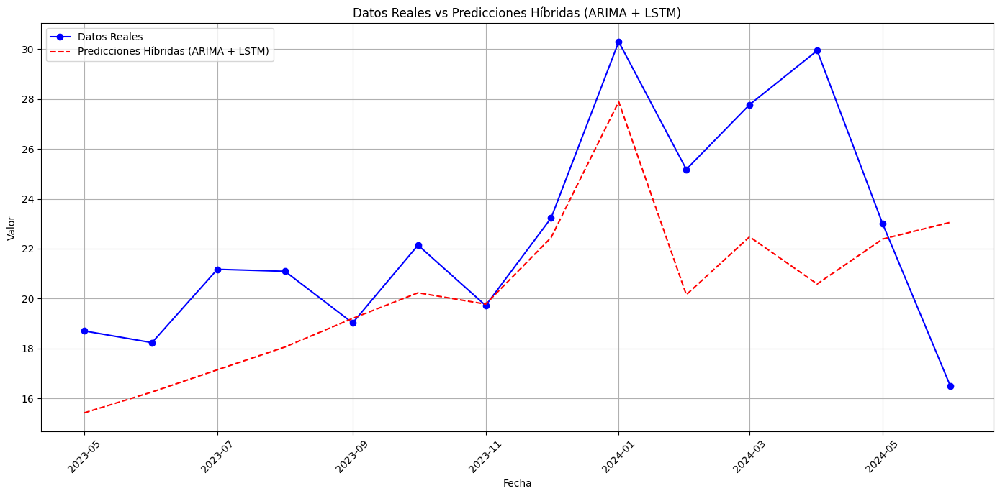

In [220]:
import pandas as pd
import numpy as np
from pmdarima import auto_arima
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import Dense, LSTM, Dropout
from keras.callbacks import EarlyStopping

# Cargar datos
df = load_data()

# Convertir 'Month' a datetime
df['Month'] = pd.to_datetime(df['Month'], format='%Y-%m')

# Crear características temporales
df['Year'] = df['Month'].dt.year
df['Month_num'] = df['Month'].dt.month

# Establecer 'Month' como índice
df.set_index('Month', inplace=True)

# Definir la variable objetivo y las variables seleccionadas
target_variable = 'Total MyC'
selected_features = ['Crude Oil', 
                     'Residential', 
                     'Goods Imports', 
                     '            Primary metals', 
                     '            Furniture and related products', 
                     '            Funds, trusts, and other financial vehicles', 
                     '                    3359 - Fabricación de otros equipos y accesorios eléctricos', 
                     'Índice de volumen físico      Total      21 - Minería           211 - Extracción de petróleo y gas           212 - Minería de minerales metálicos y no metálicos, excepto petróleo y gas           213 - Servicios relacionados con la minería', 
                     'Índice de volumen físico      Total      21 - Minería           211 - Extracción de petróleo y gas           212 - Minería de minerales metálicos y no metálicos, excepto petróleo y gas           213 - Servicios relacionados con la minería      22 - Generación, transmisión y distribución de energía eléctrica, suministro de agua y de gas por ductos al consumidor final           221 - Generación, transmisión y distribución de energía eléctrica           222 - Suministro de agua y suministro de gas por ductos al consumidor final      23 - Construcción           236 - Edificación           237 - Construcción de obras de ingeniería civil', 
                     'Month_num']

X = df[selected_features]

# Crear características de rezago (lag) y medias móviles
#X['Lag_1'] = df[target_variable].shift(1)
#X['Lag_3'] = df[target_variable].shift(3)
#X['Lag_12'] = df[target_variable].shift(12)
#X['Rolling_Mean_3'] = df[target_variable].rolling(window=3).mean()
#X['Rolling_Mean_6'] = df[target_variable].rolling(window=6).mean()
#X['Seasonal_Diff'] = df[target_variable] - df[target_variable].shift(12)

### Se probaron las diferentes combinaciones agregando lags, medias móviles y diferenciación estacional 
### pero ninguna mejoraba las predicciones ni las métricas de performance del modelo

# Eliminar filas con valores NaN (debido a las nuevas características)
X = X.dropna()

# Seleccionar variables explicativas y objetivo usando las 10 seleccionadas

y = df[target_variable]

# Escalar las características y el objetivo
scaler_X = StandardScaler()
scaler_y = StandardScaler()
X_scaled = scaler_X.fit_transform(X)
y_scaled = scaler_y.fit_transform(y.values.reshape(-1, 1))

# Dividir los datos en conjunto de entrenamiento y prueba
train_size = int(len(X_scaled) * 0.88)
X_train, X_test = X_scaled[:train_size], X_scaled[train_size:]
y_train, y_test = y_scaled[:train_size], y_scaled[train_size:]

# Entrenar un modelo Auto-ARIMA
arima_model = auto_arima(y_train, start_p=1, start_q=1,
                         max_p=3, max_q=3, m=12,
                         start_P=0, seasonal=True,
                         d=1, D=1, trace=True,
                         error_action='ignore',  
                         suppress_warnings=True, 
                         stepwise=True)

# Predecir con el modelo ARIMA
y_pred_arima = arima_model.predict(n_periods=len(y_test))

# Calcular los residuos
residuals = y_test.ravel() - y_pred_arima

# Crear la estructura de datos para LSTM (secuencias de tiempo)
def create_sequences(X, y, time_steps=1):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 12
X_lstm, y_lstm = create_sequences(X_test, residuals, time_steps)

# Definir el modelo LSTM para predecir los residuos
model = Sequential()
model.add(LSTM(units=200, return_sequences=True, input_shape=(X_lstm.shape[1], X_lstm.shape[2])))
model.add(Dropout(0.3))
model.add(LSTM(units=100, return_sequences=True))
model.add(Dropout(0.3))
model.add(LSTM(units=50))
model.add(Dense(units=1))

model.compile(optimizer='adam', loss='mean_squared_error')

# Ajustar el modelo
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history = model.fit(X_lstm, y_lstm, validation_split=0.1, epochs=200, batch_size=16, callbacks=[early_stop], verbose=1)

# Predecir los residuos con LSTM
residuals_pred = model.predict(X_lstm)

# Corregir las predicciones del modelo ARIMA sumando los residuos predichos por LSTM
final_pred = y_pred_arima[-len(residuals_pred):] + residuals_pred.ravel()

# Desescalar las predicciones finales y los datos reales
y_test_inv = scaler_y.inverse_transform(y_test[-len(final_pred):].reshape(-1, 1))
final_pred_inv = scaler_y.inverse_transform(final_pred.reshape(-1, 1))

# Calcular y mostrar métricas
mae = mean_absolute_error(y_test_inv, final_pred_inv)
mse = mean_squared_error(y_test_inv, final_pred_inv)
rmse = np.sqrt(mse)
mape = np.mean(np.abs((y_test_inv - final_pred_inv) / y_test_inv)) * 100

print(f'MAE: {mae:.2f}')
print(f'MSE: {mse:.2f}')
print(f'RMSE: {rmse:.2f}')
print(f'MAPE: {mape:.2f}%')

# Graficar datos reales vs predicciones
plt.figure(figsize=(14, 7))
plt.plot(df.index[-len(y_test_inv):], y_test_inv, label='Datos Reales', color='blue', marker='o')
plt.plot(df.index[-len(final_pred_inv):], final_pred_inv, label='Predicciones Híbridas (ARIMA + LSTM)', color='red', linestyle='--')
plt.xlabel('Fecha')
plt.ylabel('Valor')
plt.title('Datos Reales vs Predicciones Híbridas (ARIMA + LSTM)')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('datos_vs_predicciones_hibridas_arima_lstm.pdf')
plt.show()


### Se replica el modelo multivariado de RF y residuos LSTM de las 10 variables seleccionadas.

Epoch 1/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step - loss: 0.2379 - val_loss: 1.0433
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 61ms/step - loss: 0.1092 - val_loss: 0.9596
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - loss: 0.1338 - val_loss: 1.2510
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0814 - val_loss: 1.6784
Epoch 5/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 0.0663 - val_loss: 2.0962
Epoch 6/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.0638 - val_loss: 2.3305
Epoch 7/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 59ms/step - loss: 0.0735 - val_loss: 2.3833
Epoch 8/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0674 - val_loss: 2.3086
Epoch 9/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.0487 - val_loss: 2.1916
Epoch 10/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - loss: 0.0501 - val_loss: 2.0955
Epoch 11/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - loss: 0.0549 - val_loss: 2.0507
Epoch 12/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 62ms/step - loss: 0.0643 - val_loss

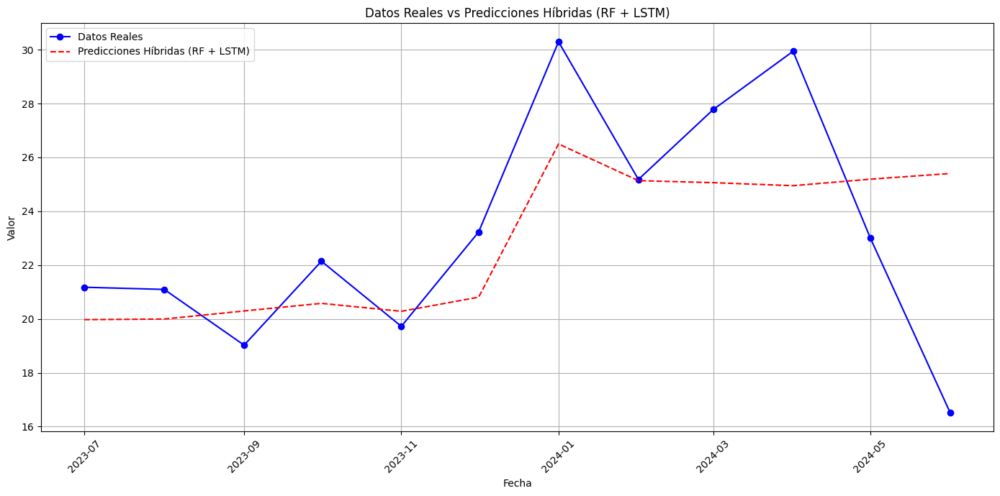

In [221]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import Dense, LSTM, Dropout
from keras.callbacks import EarlyStopping

# Cargar datos
df = load_data()

# Convertir 'Month' a datetime
df['Month'] = pd.to_datetime(df['Month'], format='%Y-%m')

# Crear características temporales
df['Year'] = df['Month'].dt.year
df['Month_num'] = df['Month'].dt.month

# Establecer 'Month' como índice
df.set_index('Month', inplace=True)

# Definir la variable objetivo y las variables seleccionadas
target_variable = 'Total MyC'
selected_features = ['Crude Oil', 
                     'Residential', 
                     'Goods Imports', 
                     '            Primary metals', 
                     '            Furniture and related products', 
                     '            Funds, trusts, and other financial vehicles', 
                     '                    3359 - Fabricación de otros equipos y accesorios eléctricos', 
                     'Índice de volumen físico      Total      21 - Minería           211 - Extracción de petróleo y gas           212 - Minería de minerales metálicos y no metálicos, excepto petróleo y gas           213 - Servicios relacionados con la minería', 
                     'Índice de volumen físico      Total      21 - Minería           211 - Extracción de petróleo y gas           212 - Minería de minerales metálicos y no metálicos, excepto petróleo y gas           213 - Servicios relacionados con la minería      22 - Generación, transmisión y distribución de energía eléctrica, suministro de agua y de gas por ductos al consumidor final           221 - Generación, transmisión y distribución de energía eléctrica           222 - Suministro de agua y suministro de gas por ductos al consumidor final      23 - Construcción           236 - Edificación           237 - Construcción de obras de ingeniería civil', 
                     'Month_num']

# Crear características de rezago (lag) y medias móviles
df['Lag_1'] = df[target_variable].shift(1)
df['Lag_3'] = df[target_variable].shift(3)
df['Lag_12'] = df[target_variable].shift(12)
df['Rolling_Mean_3'] = df[target_variable].rolling(window=3).mean()
df['Rolling_Mean_6'] = df[target_variable].rolling(window=6).mean()
df['Seasonal_Diff'] = df[target_variable] - df[target_variable].shift(12)

# Eliminar filas con valores NaN (debido a las nuevas características)
df = df.dropna()

# Seleccionar variables explicativas y objetivo
X = df[selected_features]
y = df[target_variable]

# Escalar las características y el objetivo
scaler_X = StandardScaler()
scaler_y = StandardScaler()
X_scaled = scaler_X.fit_transform(X)
y_scaled = scaler_y.fit_transform(y.values.reshape(-1, 1))

# Dividir los datos en conjunto de entrenamiento y prueba
train_size = int(len(X_scaled) * 0.88)
X_train, X_test = X_scaled[:train_size], X_scaled[train_size:]
y_train, y_test = y_scaled[:train_size], y_scaled[train_size:]

# Entrenar un modelo Random Forest
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train.ravel())

# Predecir con el modelo Random Forest
y_pred_rf = rf_model.predict(X_test)

# Calcular los residuos
residuals = y_test.ravel() - y_pred_rf

# Crear la estructura de datos para LSTM (secuencias de tiempo)
def create_sequences(X, y, time_steps=1):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 12
X_lstm, y_lstm = create_sequences(X_test, residuals, time_steps)

# Definir el modelo LSTM para predecir los residuos
model = Sequential()
model.add(LSTM(units=200, return_sequences=True, input_shape=(X_lstm.shape[1], X_lstm.shape[2])))
model.add(Dropout(0.3))
model.add(LSTM(units=100, return_sequences=True))
model.add(Dropout(0.3))
model.add(LSTM(units=50))
model.add(Dense(units=1))

model.compile(optimizer='adam', loss='mean_squared_error')

# Ajustar el modelo
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history = model.fit(X_lstm, y_lstm, validation_split=0.1, epochs=200, batch_size=16, callbacks=[early_stop], verbose=1)

# Predecir los residuos con LSTM
residuals_pred = model.predict(X_lstm)

# Corregir las predicciones del modelo RF sumando los residuos predichos por LSTM
final_pred = y_pred_rf[-len(residuals_pred):] + residuals_pred.ravel()

# Desescalar las predicciones finales y los datos reales
y_test_inv = scaler_y.inverse_transform(y_test[-len(final_pred):].reshape(-1, 1))
final_pred_inv = scaler_y.inverse_transform(final_pred.reshape(-1, 1))

# Calcular y mostrar métricas
mae = mean_absolute_error(y_test_inv, final_pred_inv)
mse = mean_squared_error(y_test_inv, final_pred_inv)
rmse = np.sqrt(mse)
mape = np.mean(np.abs((y_test_inv - final_pred_inv) / y_test_inv)) * 100

print(f'MAE: {mae:.2f}')
print(f'MSE: {mse:.2f}')
print(f'RMSE: {rmse:.2f}')
print(f'MAPE: {mape:.2f}%')

# Graficar datos reales vs predicciones
plt.figure(figsize=(14, 7))
plt.plot(df.index[-len(y_test_inv):], y_test_inv, label='Datos Reales', color='blue', marker='o')
plt.plot(df.index[-len(final_pred_inv):], final_pred_inv, label='Predicciones Híbridas (RF + LSTM)', color='red', linestyle='--')
plt.xlabel('Fecha')
plt.ylabel('Valor')
plt.title('Datos Reales vs Predicciones Híbridas (RF + LSTM)')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('datos_vs_predicciones_hibridas_rf_lstm.pdf')
plt.show()


### Agregando lags, medias móviles y diferenciaciones.

Epoch 1/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 4s 4s/step - loss: 0.6172 - val_loss: 0.4751
Epoch 2/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 70ms/step - loss: 0.1247 - val_loss: 1.1560
Epoch 3/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 65ms/step - loss: 0.2929 - val_loss: 1.0742
Epoch 4/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 57ms/step - loss: 0.2342 - val_loss: 0.7378
Epoch 5/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - loss: 0.1295 - val_loss: 0.4705
Epoch 6/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 69ms/step - loss: 0.1268 - val_loss: 0.3511
Epoch 7/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 50ms/step - loss: 0.1541 - val_loss: 0.3459
Epoch 8/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 60ms/step - loss: 0.1852 - val_loss: 0.4200
Epoch 9/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 64ms/step - loss: 0.1526 - val_loss: 0.5397
Epoch 10/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 54ms/step - loss: 0.1121 - val_loss: 0.6938
Epoch 11/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 79ms/step - loss: 0.1070 - val_loss: 0.8495
Epoch 12/200
1/1 ━━━━━━━━━━━━━━━━━━━━ 0s 66ms/step - loss: 0.0898 - val_loss

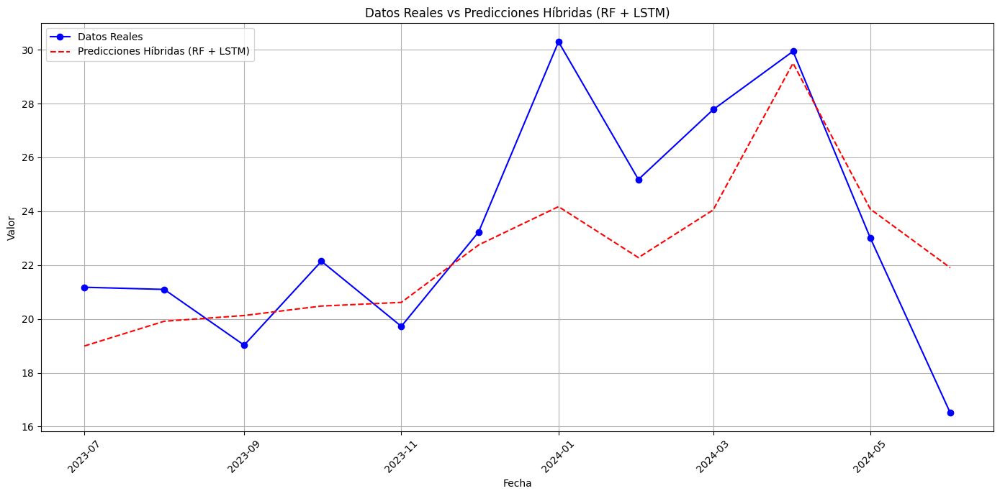

In [222]:
import pandas as pd
import numpy as np
from sklearn.ensemble import RandomForestRegressor
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.metrics import mean_absolute_error, mean_squared_error
import matplotlib.pyplot as plt
from keras.models import Sequential
from keras.layers import Dense, LSTM, Dropout
from keras.callbacks import EarlyStopping

# Cargar datos
df = load_data()

# Convertir 'Month' a datetime
df['Month'] = pd.to_datetime(df['Month'], format='%Y-%m')

# Crear características temporales
df['Year'] = df['Month'].dt.year
df['Month_num'] = df['Month'].dt.month

# Establecer 'Month' como índice
df.set_index('Month', inplace=True)

# Crear características de rezago (lag) y medias móviles
df['Lag_1'] = df[target_variable].shift(1)
df['Lag_3'] = df[target_variable].shift(3)
df['Lag_12'] = df[target_variable].shift(12)
df['Rolling_Mean_3'] = df[target_variable].rolling(window=3).mean()
df['Rolling_Mean_6'] = df[target_variable].rolling(window=6).mean()
df['Seasonal_Diff'] = df[target_variable] - df[target_variable].shift(12)

# Definir la variable objetivo y las variables seleccionadas
target_variable = 'Total MyC'
selected_features = ['Crude Oil', 
                     'Residential', 
                     'Goods Imports', 
                     '            Primary metals', 
                     '            Furniture and related products', 
                     '            Funds, trusts, and other financial vehicles', 
                     '                    3359 - Fabricación de otros equipos y accesorios eléctricos', 
                     'Índice de volumen físico      Total      21 - Minería           211 - Extracción de petróleo y gas           212 - Minería de minerales metálicos y no metálicos, excepto petróleo y gas           213 - Servicios relacionados con la minería', 
                     'Índice de volumen físico      Total      21 - Minería           211 - Extracción de petróleo y gas           212 - Minería de minerales metálicos y no metálicos, excepto petróleo y gas           213 - Servicios relacionados con la minería      22 - Generación, transmisión y distribución de energía eléctrica, suministro de agua y de gas por ductos al consumidor final           221 - Generación, transmisión y distribución de energía eléctrica           222 - Suministro de agua y suministro de gas por ductos al consumidor final      23 - Construcción           236 - Edificación           237 - Construcción de obras de ingeniería civil', 
                     'Month_num',
                     'Lag_1',
                     'Lag_3',
                     'Lag_12',
                     'Rolling_Mean_3',
                     'Rolling_Mean_6',
                     'Seasonal_Diff']

# Eliminar filas con valores NaN (debido a las nuevas características)
df = df.dropna()

# Seleccionar variables explicativas y objetivo
X = df[selected_features]
y = df[target_variable]

# Escalar las características y el objetivo
scaler_X = StandardScaler()
scaler_y = StandardScaler()
X_scaled = scaler_X.fit_transform(X)
y_scaled = scaler_y.fit_transform(y.values.reshape(-1, 1))

# Dividir los datos en conjunto de entrenamiento y prueba
train_size = int(len(X_scaled) * 0.88)
X_train, X_test = X_scaled[:train_size], X_scaled[train_size:]
y_train, y_test = y_scaled[:train_size], y_scaled[train_size:]

# Entrenar un modelo Random Forest
rf_model = RandomForestRegressor(n_estimators=100, random_state=42)
rf_model.fit(X_train, y_train.ravel())

# Predecir con el modelo Random Forest
y_pred_rf = rf_model.predict(X_test)

# Calcular los residuos
residuals = y_test.ravel() - y_pred_rf

# Crear la estructura de datos para LSTM (secuencias de tiempo)
def create_sequences(X, y, time_steps=1):
    Xs, ys = [], []
    for i in range(len(X) - time_steps):
        Xs.append(X[i:(i + time_steps)])
        ys.append(y[i + time_steps])
    return np.array(Xs), np.array(ys)

time_steps = 12
X_lstm, y_lstm = create_sequences(X_test, residuals, time_steps)

# Definir el modelo LSTM para predecir los residuos
model = Sequential()
model.add(LSTM(units=200, return_sequences=True, input_shape=(X_lstm.shape[1], X_lstm.shape[2])))
model.add(Dropout(0.3))
model.add(LSTM(units=100, return_sequences=True))
model.add(Dropout(0.3))
model.add(LSTM(units=50))
model.add(Dense(units=1))

model.compile(optimizer='adam', loss='mean_squared_error')

# Ajustar el modelo
early_stop = EarlyStopping(monitor='val_loss', patience=10, restore_best_weights=True)
history = model.fit(X_lstm, y_lstm, validation_split=0.1, epochs=200, batch_size=16, callbacks=[early_stop], verbose=1)

# Predecir los residuos con LSTM
residuals_pred = model.predict(X_lstm)

# Corregir las predicciones del modelo RF sumando los residuos predichos por LSTM
final_pred = y_pred_rf[-len(residuals_pred):] + residuals_pred.ravel()

# Desescalar las predicciones finales y los datos reales
y_test_inv = scaler_y.inverse_transform(y_test[-len(final_pred):].reshape(-1, 1))
final_pred_inv = scaler_y.inverse_transform(final_pred.reshape(-1, 1))

# Calcular y mostrar métricas
mae = mean_absolute_error(y_test_inv, final_pred_inv)
mse = mean_squared_error(y_test_inv, final_pred_inv)
rmse = np.sqrt(mse)
mape = np.mean(np.abs((y_test_inv - final_pred_inv) / y_test_inv)) * 100

print(f'MAE: {mae:.2f}')
print(f'MSE: {mse:.2f}')
print(f'RMSE: {rmse:.2f}')
print(f'MAPE: {mape:.2f}%')

# Graficar datos reales vs predicciones
plt.figure(figsize=(14, 7))
plt.plot(df.index[-len(y_test_inv):], y_test_inv, label='Datos Reales', color='blue', marker='o')
plt.plot(df.index[-len(final_pred_inv):], final_pred_inv, label='Predicciones Híbridas (RF + LSTM)', color='red', linestyle='--')
plt.xlabel('Fecha')
plt.ylabel('Valor')
plt.title('Datos Reales vs Predicciones Híbridas (RF + LSTM)')
plt.legend()
plt.grid(True)
plt.xticks(rotation=45)
plt.tight_layout()
plt.savefig('datos_vs_predicciones_hibridas_rf_lstm.pdf')
plt.show()
